In [1]:
# import 
import sys,os,glob
sys.path.append(os.path.abspath('CommonTools'))
import tifffile
import numpy as np
import matplotlib.pylab as plt
from tqdm import tqdm_notebook as tqdm
import MaxViewer_py3 as mv
import pickle
import cv2

### get median illumination

In [2]:
folder = r'D:\Data\112520_wea_rca_test4_peg'
folders = glob.glob(folder+'\H*')
folders = [fld for fld in folders if len(glob.glob(fld+r'\*.tif'))]

analysis_folder = folder+os.sep+'Analysis'
if not os.path.exists(analysis_folder): os.makedirs(analysis_folder)
cols = ['750','647','561','405']
ncols = len(cols)

im_meds_fl = analysis_folder+os.sep+'im_meds.npy'
if not os.path.exists(im_meds_fl):
    files_ = [fl for fld in folders for fl in glob.glob(fld+os.sep+'*.tif')]
    ims_meds = [np.percentile([tifffile.imread(fl, key=key) for fl in files_],25,axis=0) for key in range(ncols)]
    np.save(im_meds_fl,ims_meds)

In [122]:
### Load a single field of view and explore with the max_viewer

folder = r'D:\Data\112520_wea_rca_test4_peg'
folder = r'D:\Data\112320_wea_rca_test3_nopeg'
analysis_folder = folder+os.sep+'Analysis'
if not os.path.exists(analysis_folder): os.makedirs(analysis_folder)

folders = glob.glob(folder+'\H*')
folders = [fld for fld in folders if len(glob.glob(fld+r'\*.tif'))]
fovs = [os.path.basename(fl) for fl in glob.glob(folders[0]+r'\*.tif')]
fov = fovs[8] # the field of view to load
cols = ['750','647','561','405']
ncols = len(cols)
ims,ims_nms = [],[]
for fld in tqdm(folders):
    fl = fld+os.sep+fov
    im = tifffile.imread(fl)
    
    for icol,col in enumerate(cols):
        if col!='405':
            ims.append(im[icol::ncols].astype(np.float32)/ims_meds[icol])
            tag = os.path.basename(os.path.dirname(fl))+'_'+col
            ims_nms.append(tag)
#ims.append(im[icol::ncols].astype(np.float32)/ims_meds[icol])
#ims_nms.append('dapi')
pairs = [['H1_647', 'H3_750'],
 ['H1_750', 'H4_647'],
 ['H2_647', 'H6_647'],
 ['H2_750', 'H5_647'],
 ['H3_647', 'H6_750']]

ims = np.array(ims)
pairs_ln = [ln_ for ln in pairs for ln_ in ln]
inew = [ims_nms.index(tag) for tag in pairs_ln]
ims =ims[inew]
image_names = pairs_ln

<ipython-input-122-140738e891c8>:15: TqdmDeprecationWarning: This function will be removed in tqdm==5.0.0
Please use `tqdm.notebook.tqdm` instead of `tqdm.tqdm_notebook`
  for fld in tqdm(folders):


In [99]:
fov

'Conv_zscan_08.tif'

In [5]:
%matplotlib notebook

<IPython.core.display.Javascript object>


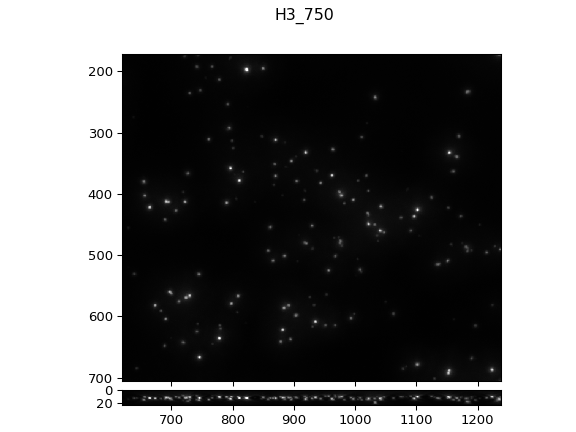

In [98]:
obj = mv.imshow_mark_3d(ims,image_names=image_names)

In [127]:
dic_drift[h2][0]

array([ 0.,  3., -5.])

<IPython.core.display.Javascript object>


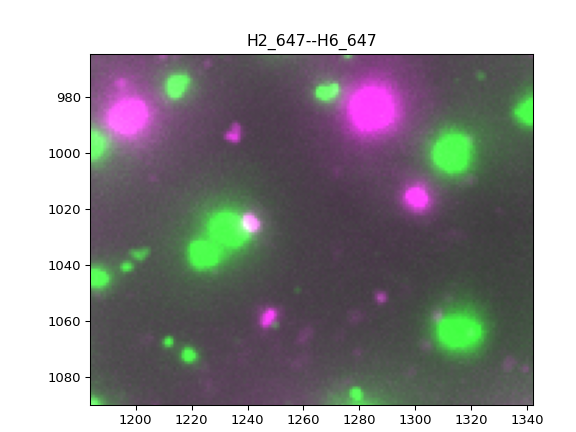

In [130]:
fov_ = fov.split('.')[0]
fl = analysis_folder+os.sep+fov_+'_final.pkl'
dic_drift,dic_fits,dic_extra = pickle.load(open(fl,'rb'))

i1,i2=0+2*2,1+2*2
h1,h2 = image_names[i1].split('_')[0],image_names[i2].split('_')[0]

im1_ = at.translate(ims[i1],dic_drift[h1][0])
im2_ = at.translate(ims[i2],dic_drift[h2][0])
im1 = np.clip(np.max(im1_,0)/np.percentile(im1_,99.),0,1)
im2 = np.clip(np.max(im2_,0)/np.percentile(im2_,99.),0,1)
imc= np.dstack([im1,im2,im1])
plt.figure()
plt.title(image_names[i1]+'--'+image_names[i2])
plt.imshow(imc)

In [104]:
#at.translate()


In [20]:
??get_local_max

<IPython.core.display.Javascript object>


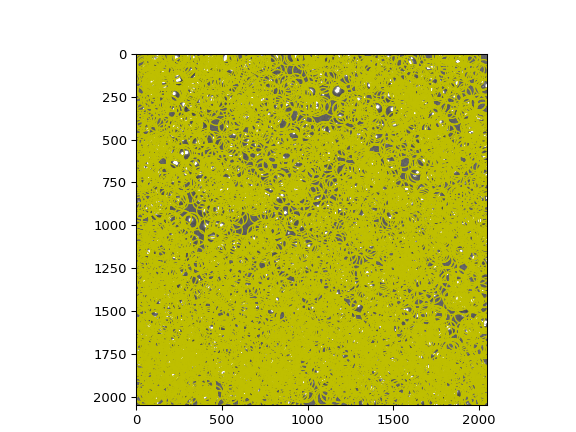

In [24]:
im = quick_norm(obj.im_sm ,s=50)
#std_ = np.std(im)
#hcut = np.median(im)+std_*5
hcut = 1.5
zxyh = get_local_max(im,hcut,dbscan=True)
plt.figure()
plt.plot(zxyh[:,2],zxyh[:,1],'o',markersize=12,markeredgewidth=1,markeredgecolor='y',markerfacecolor='None')
plt.imshow(np.max(im,axis=0),vmax=np.percentile(zxyh[:,-1],20),cmap='gray')

<IPython.core.display.Javascript object>


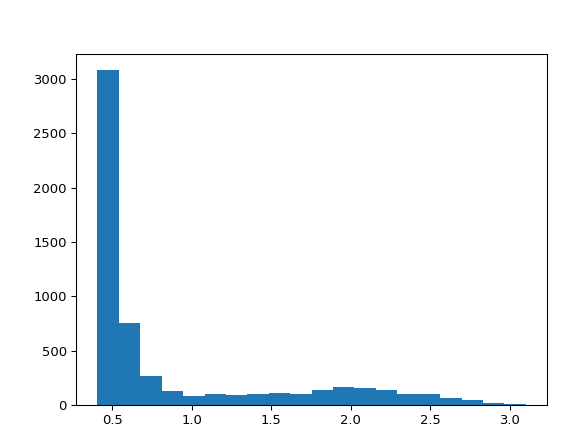

(array([3081.,  757.,  267.,  127.,   84.,  102.,   87.,   96.,  109.,
         103.,  141.,  165.,  155.,  135.,  100.,  104.,   65.,   44.,
          16.,    9.]),
 array([0.4055174 , 0.54026767, 0.67501794, 0.80976822, 0.94451849,
        1.07926876, 1.21401903, 1.34876931, 1.48351958, 1.61826985,
        1.75302012, 1.88777039, 2.02252067, 2.15727094, 2.29202121,
        2.42677148, 2.56152176, 2.69627203, 2.8310223 , 2.96577257,
        3.10052284]),
 <a list of 20 Patch objects>)

In [25]:
plt.figure()
plt.hist(np.log(zxyh[:,-1]),bins=20)

In [23]:
np.min(zxyh[:,-1])

1.5000784397125244

### Define useful functions for main analysis

In [26]:
#Useful functions
import cv2
def quick_norm(im,s=50):
    return np.array([im_/cv2.blur(im_,(s,s))for im_ in im.astype(np.float32)])
from sklearn.cluster import DBSCAN
def get_local_max(im_dif,th_fit,delta=2,delta_fit=3,dbscan=True):
    """Given a 3D image <im_dif> as numpy array, get the local maxima in cube -<delta>_to_<delta> in 3D.
    Optional a dbscan can be used to couple connected pixels with the same local maximum. 
    This is important if saturating the camera values.
    
    Returns: Xh - a list of z,x,y and brightness of the local maxima
    """
    z,x,y = np.nonzero(im_dif>th_fit)
    zmax,xmax,ymax = im_dif.shape
    in_im = im_dif[z,x,y]
    keep = np.ones(len(x))>0
    for d1 in range(-delta,delta+1):
        for d2 in range(-delta,delta+1):
            for d3 in range(-delta,delta+1):
                keep &= (in_im>=im_dif[(z+d1)%zmax,(x+d2)%xmax,(y+d3)%ymax])
    z,x,y = z[keep],x[keep],y[keep]
    h = in_im[keep]
    Xh = np.array([z,x,y,h]).T
    if dbscan:
        from sklearn.cluster import DBSCAN
        db = DBSCAN(eps=1, min_samples=1, metric='euclidean')
        X = np.array([z,x,y]).T
        db.fit(X)
        l = db.labels_
        Xh = []
        for l_ in np.unique(l):
            keep = l==l_
            imax = np.argmax(h[keep])
            Xh.append([z[keep][imax],x[keep][imax],y[keep][imax],h[keep][imax]])
        Xh = np.array(Xh)
    
    if delta_fit!=0:
        z,x,y,h = Xh.T
        z,x,y = z.astype(int),x.astype(int),y.astype(int)
        im_centers = [[],[],[],[]]
        for d1 in range(-delta_fit,delta_fit+1):
            for d2 in range(-delta_fit,delta_fit+1):
                for d3 in range(-delta_fit,delta_fit+1):
                    if (d1*d1+d2*d2+d3*d3)<=(delta_fit*delta_fit):
                        im_centers[0].append((z+d1))
                        im_centers[1].append((x+d2))
                        im_centers[2].append((y+d3))
                        im_centers[3].append(im[(z+d1)%zmax,(x+d2)%xmax,(y+d3)%ymax])

        im_centers_ = np.array(im_centers)
        im_centers_[-1] -= np.min(im_centers_[-1],axis=0)
        zc = np.sum(im_centers_[0]*im_centers_[-1],axis=0)/np.sum(im_centers_[-1],axis=0)
        xc = np.sum(im_centers_[1]*im_centers_[-1],axis=0)/np.sum(im_centers_[-1],axis=0)
        yc = np.sum(im_centers_[2]*im_centers_[-1],axis=0)/np.sum(im_centers_[-1],axis=0)
        Xh = np.array([zc,xc,yc,h]).T
    return Xh
import AlignmentTools_py3 as at
def series_align(im1,im2,s = 256,gb=30):
    """
    Given 2 3D images <im1> and <im2> this performs a fft based registration. 
    Robustness measures:
    1) Uses local gaussian correction (dividing the images by gaussian blur) with a kernel size <gb> of 30 piexels. 
    (This is to avoid the fft getting confused by global illumination and focusing on the feature at scale <gb>)
    
    2) Will tile the images <im1> and <im2> in s x s little images and compare each one. Will then use the consensus registration
    
    Returns:
    tzxy - the delta z,x and y between the images
    vecs - a list of tzxy for each subimage comparison (see point 2 above) to troubleshoot
    """
    
    sz,sx,sy = im1.shape
    vecs = []
    for ix in range(0,sx-1,s):
        for iy in range(0,sy-1,s):
            vecs.append(at.fft3d_from2d(im1[:,ix:ix+s,iy:iy+s],im2[:,ix:ix+s,iy:iy+s],gb=gb))
    tzxy = np.median(vecs,axis=0)
    #consistency = np.mean(np.abs(vecs-tzxy),axis=0)
    return tzxy,vecs

import cv2

def get_number_cells(im_dapi,min_area=5000,max_area=50000):
    """Given a binary mask with mostly correct segmentation, this estimates the number of cells and their median area.
    Returns: ncells - number of cells
    med_area - median area of each cell base on connected component analysis
    """
    retval, labels, stats, centroids=cv2.connectedComponentsWithStats(np.array(im_dapi,dtype=np.uint8))
    As = stats[:,-1]
    keep = (As>min_area)&(As<max_area)
    med_area = np.median(As[keep])
    ncells = np.sum(im_dapi)/med_area
    return ncells,med_area

In [256]:
%matplotlib inline
plt.ioff() #turn off matplotlib display. Will save to file

### Main analysis

<ipython-input-27-1886a2f7fea2>:20: TqdmDeprecationWarning: This function will be removed in tqdm==5.0.0
Please use `tqdm.notebook.tqdm` instead of `tqdm.tqdm_notebook`
  for fld in tqdm(folders):



Drift correcting H1 on fov: Conv_zscan_00.tif
Fitting H1_750 on fov: Conv_zscan_00.tif


<IPython.core.display.Javascript object>


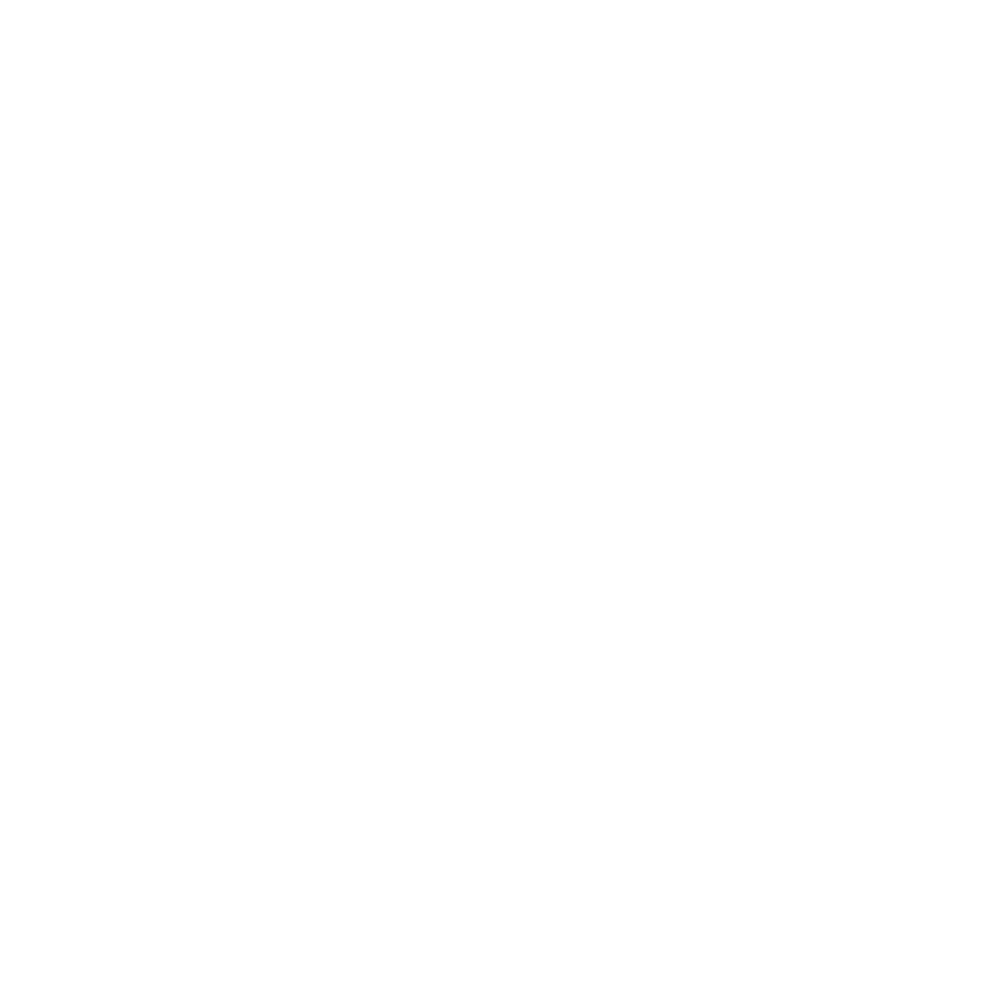

Fitting H1_647 on fov: Conv_zscan_00.tif


<IPython.core.display.Javascript object>


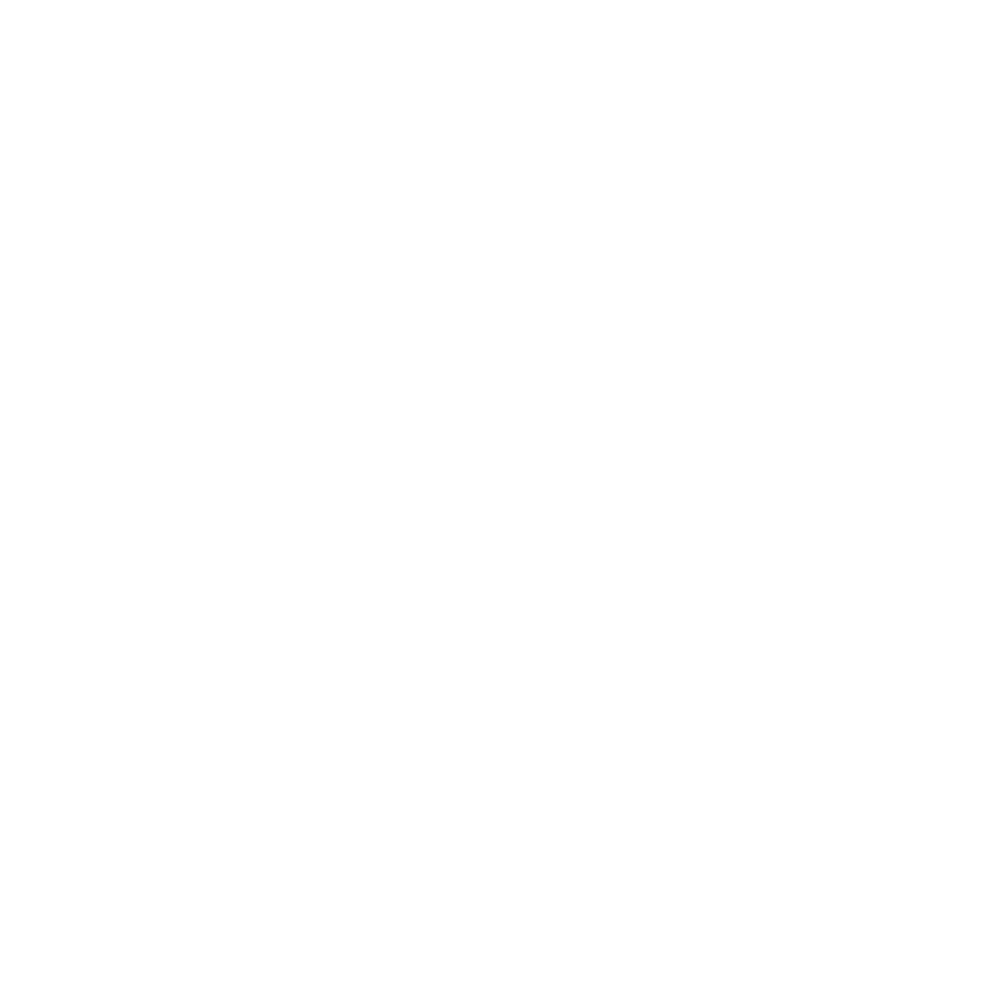

Drift correcting H2 on fov: Conv_zscan_00.tif
Fitting H2_750 on fov: Conv_zscan_00.tif


<IPython.core.display.Javascript object>


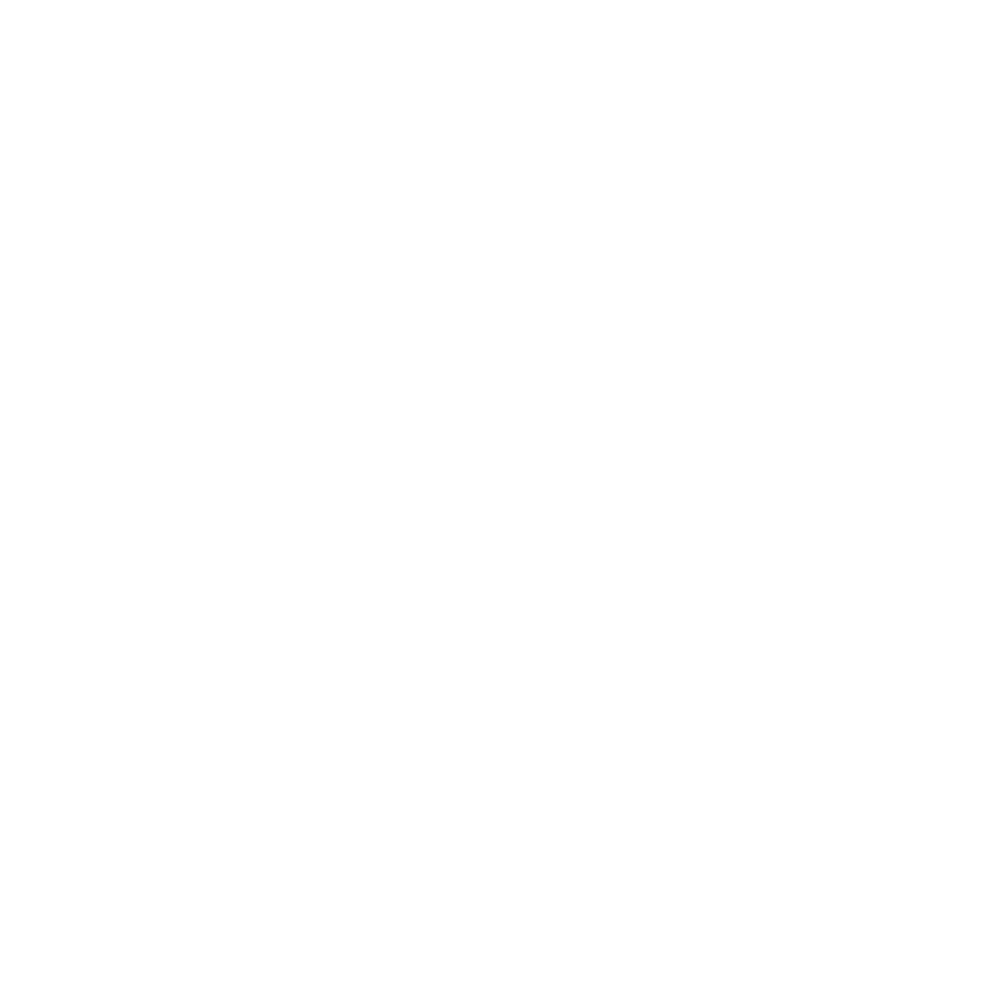

Fitting H2_647 on fov: Conv_zscan_00.tif


<IPython.core.display.Javascript object>


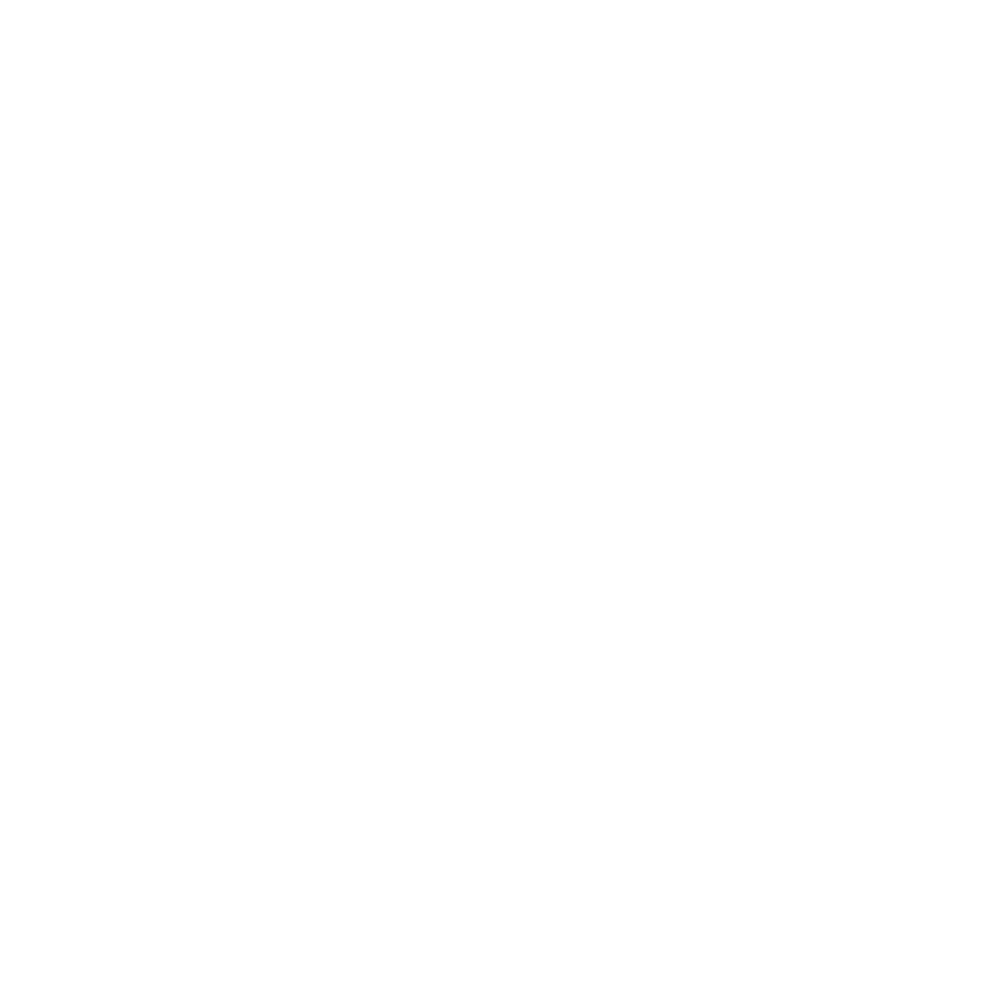

Drift correcting H3 on fov: Conv_zscan_00.tif
Fitting H3_750 on fov: Conv_zscan_00.tif


<IPython.core.display.Javascript object>


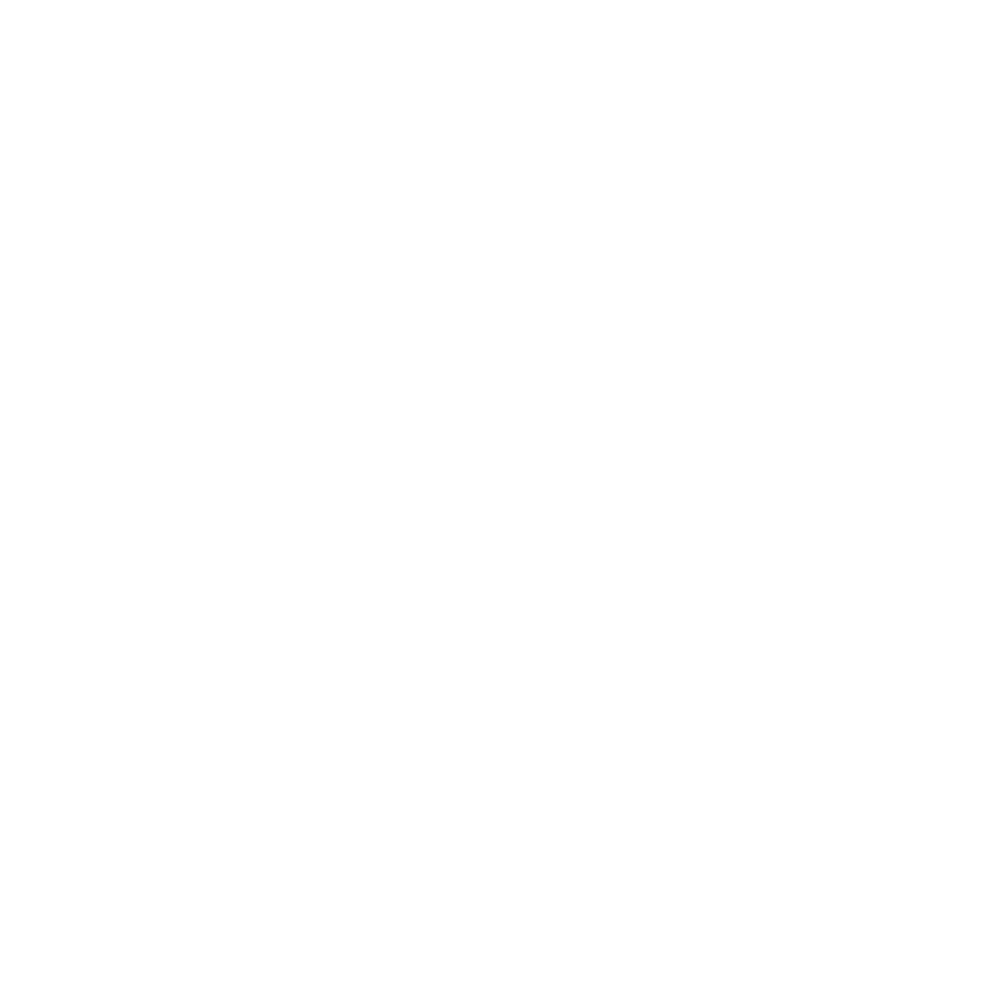

Fitting H3_647 on fov: Conv_zscan_00.tif


<IPython.core.display.Javascript object>


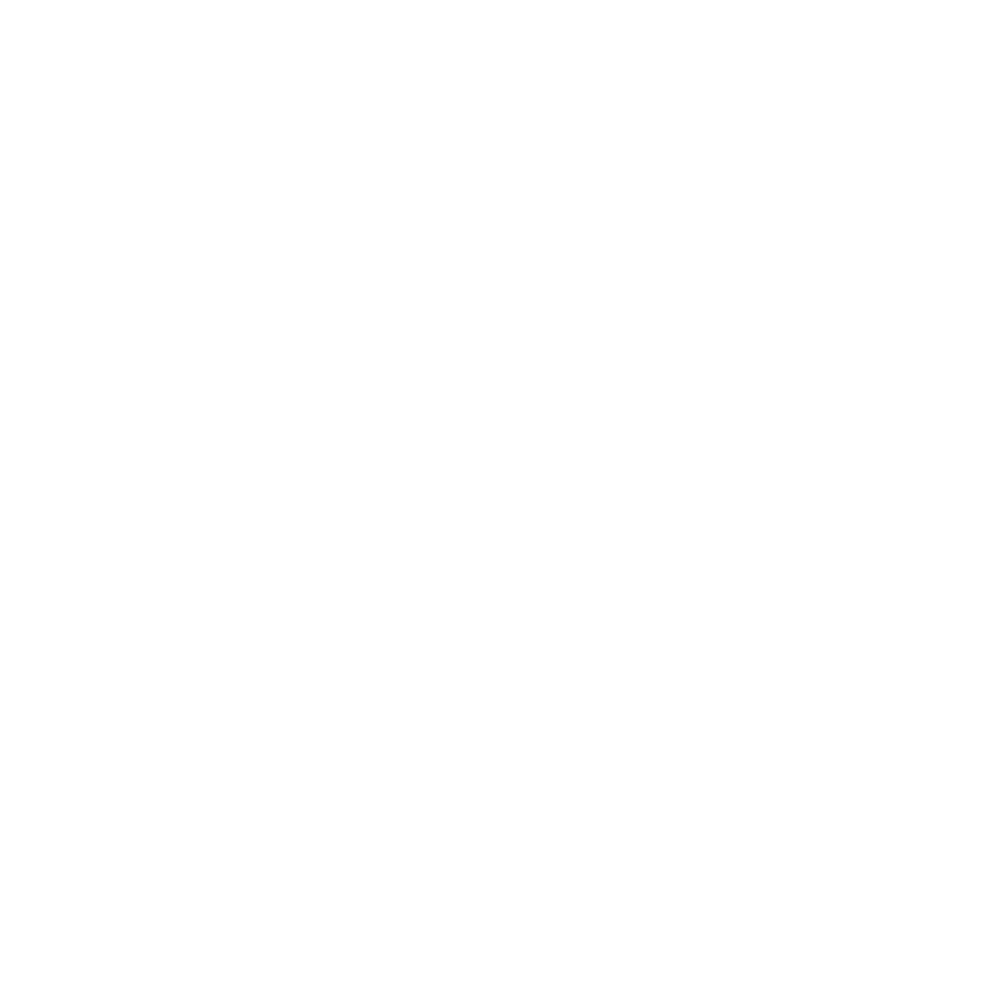

Drift correcting H4 on fov: Conv_zscan_00.tif
Fitting H4_750 on fov: Conv_zscan_00.tif


<IPython.core.display.Javascript object>


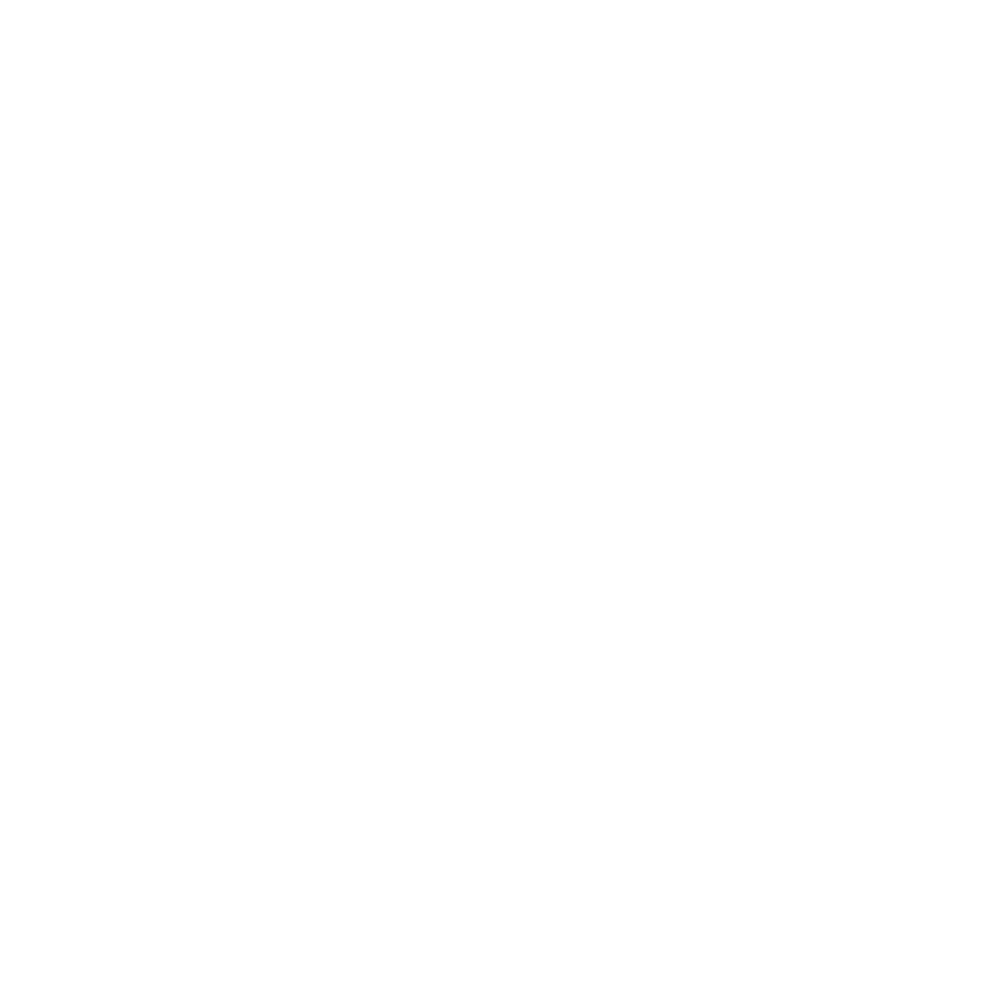

Fitting H4_647 on fov: Conv_zscan_00.tif


<IPython.core.display.Javascript object>


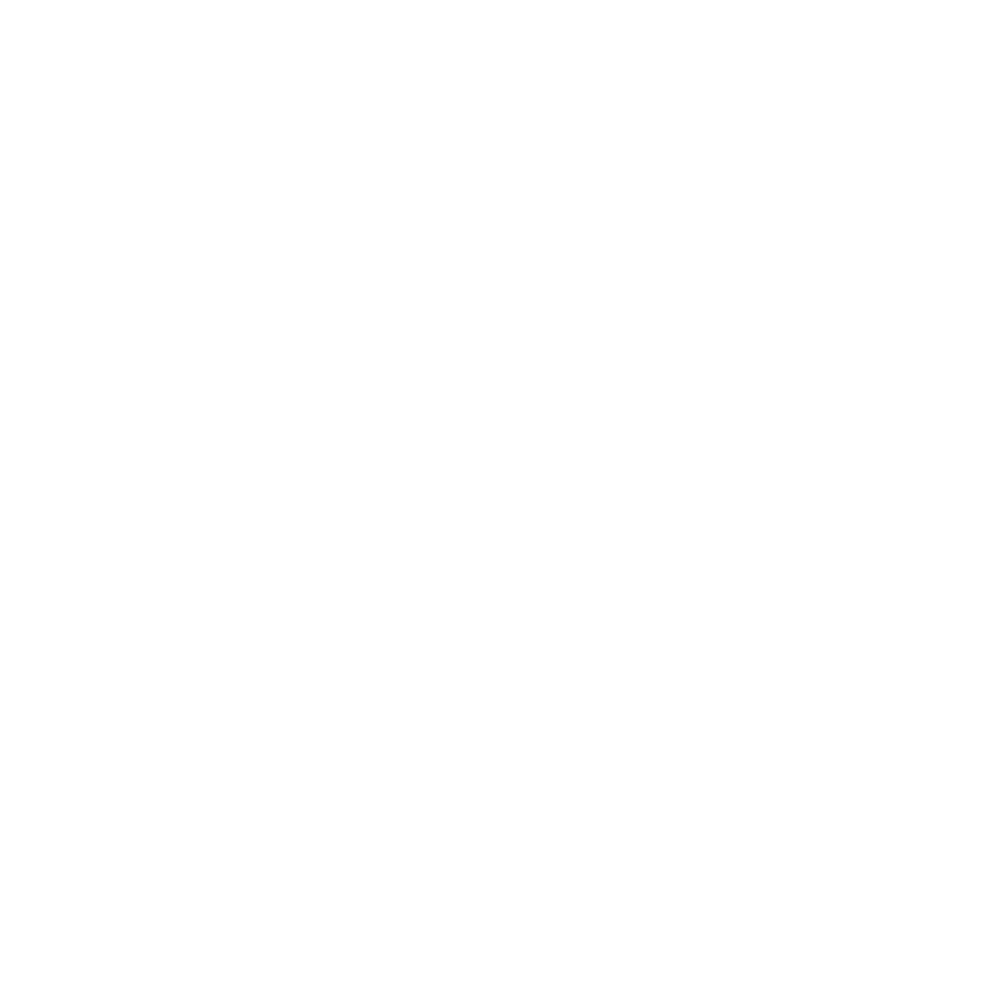

Drift correcting H5 on fov: Conv_zscan_00.tif
Fitting H5_750 on fov: Conv_zscan_00.tif


<IPython.core.display.Javascript object>


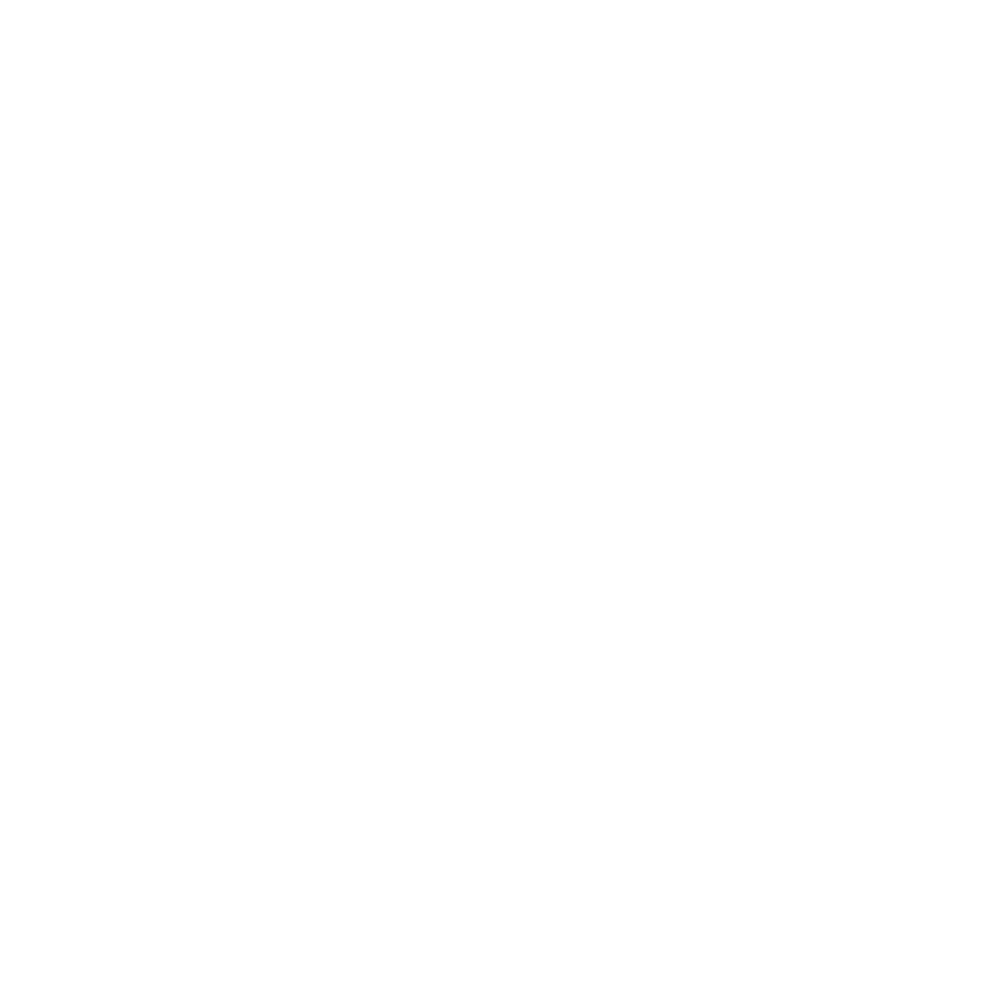

Fitting H5_647 on fov: Conv_zscan_00.tif


<IPython.core.display.Javascript object>


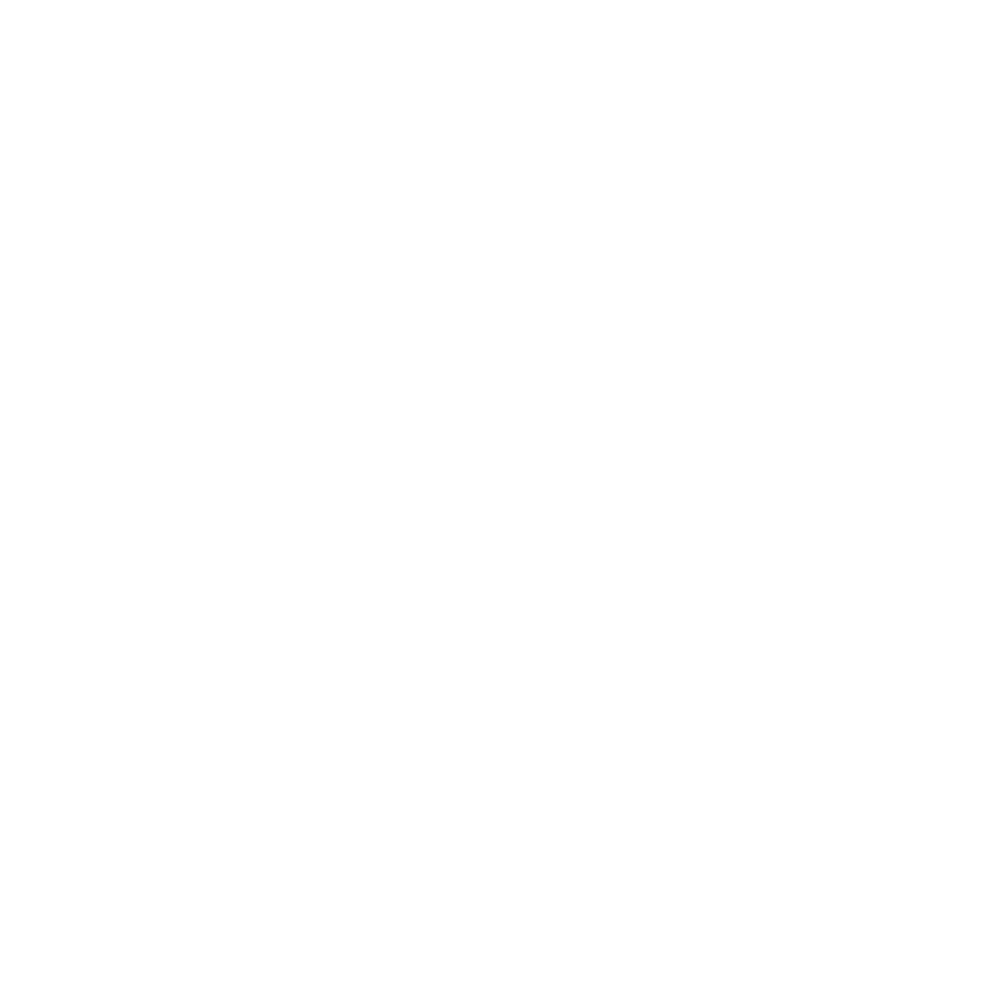

Drift correcting H6 on fov: Conv_zscan_00.tif
Fitting H6_750 on fov: Conv_zscan_00.tif


<IPython.core.display.Javascript object>


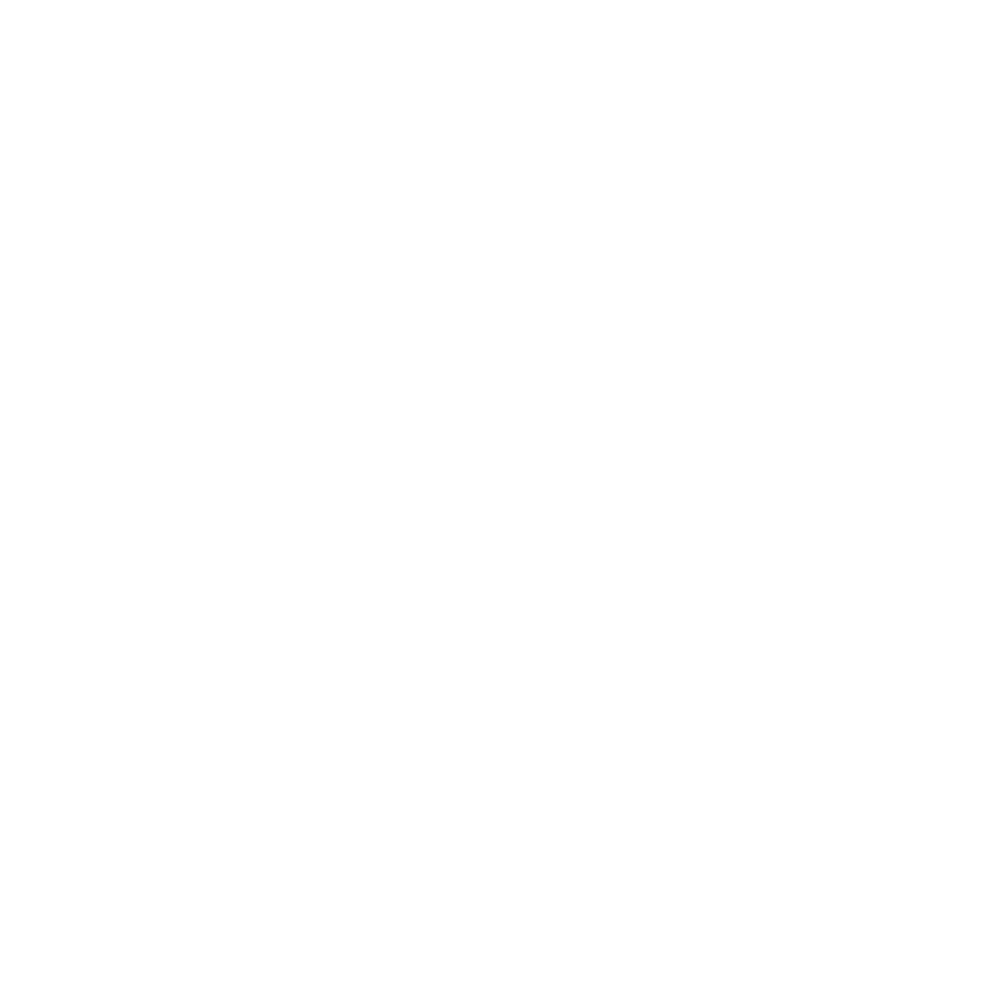

Fitting H6_647 on fov: Conv_zscan_00.tif


<IPython.core.display.Javascript object>


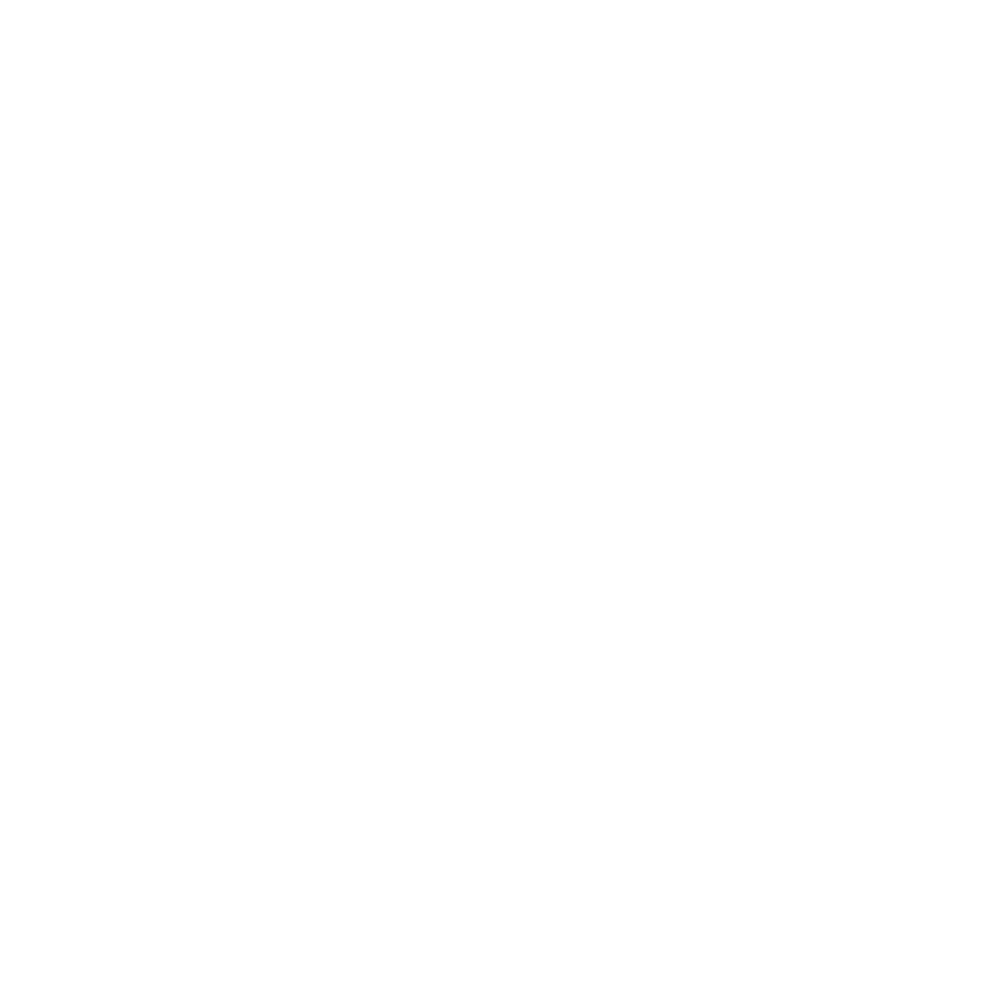

Estimating number of cells based on dapi image on fov: Conv_zscan_00.tif


<IPython.core.display.Javascript object>


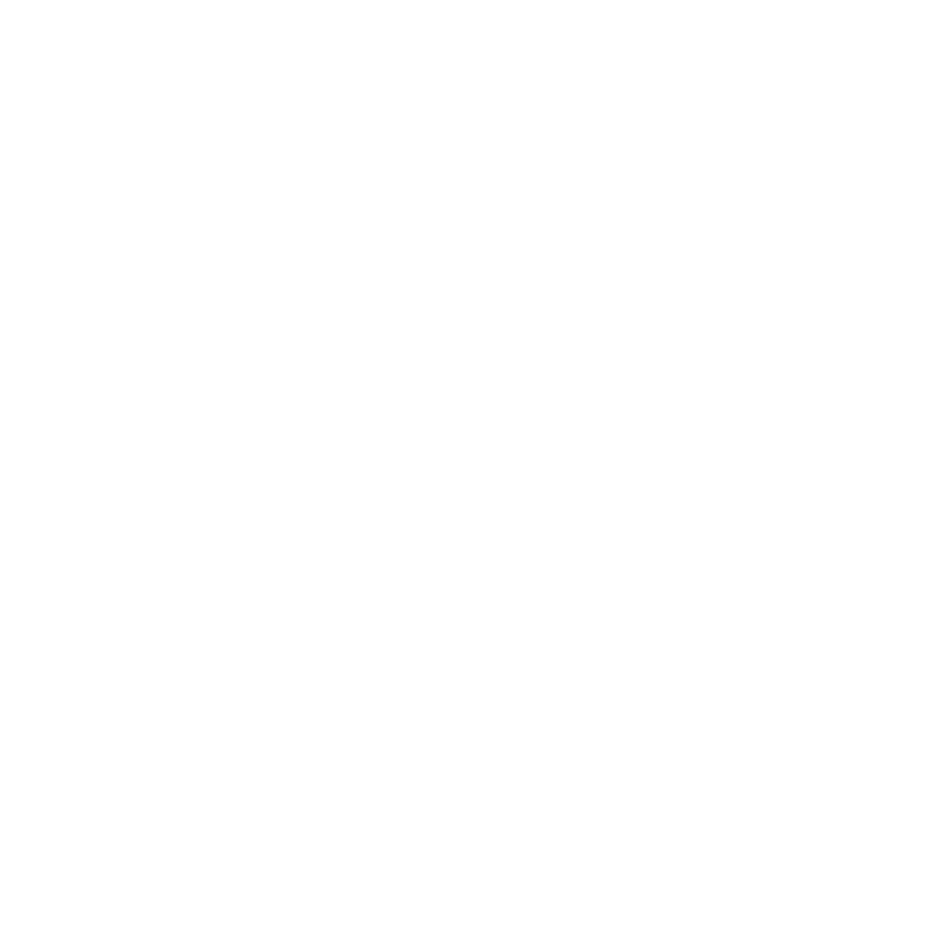

<ipython-input-27-1886a2f7fea2>:20: TqdmDeprecationWarning: This function will be removed in tqdm==5.0.0
Please use `tqdm.notebook.tqdm` instead of `tqdm.tqdm_notebook`
  for fld in tqdm(folders):



Drift correcting H1 on fov: Conv_zscan_01.tif
Fitting H1_750 on fov: Conv_zscan_01.tif


<IPython.core.display.Javascript object>


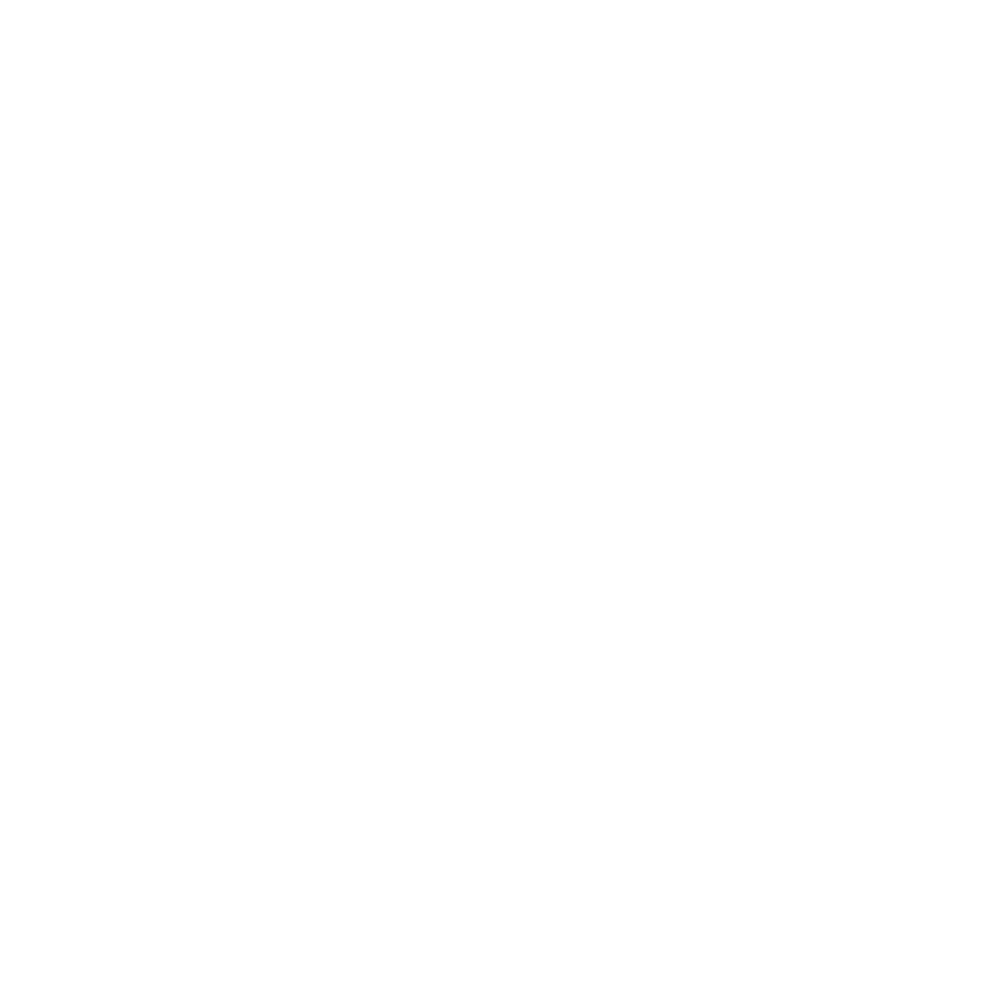

Fitting H1_647 on fov: Conv_zscan_01.tif


<IPython.core.display.Javascript object>


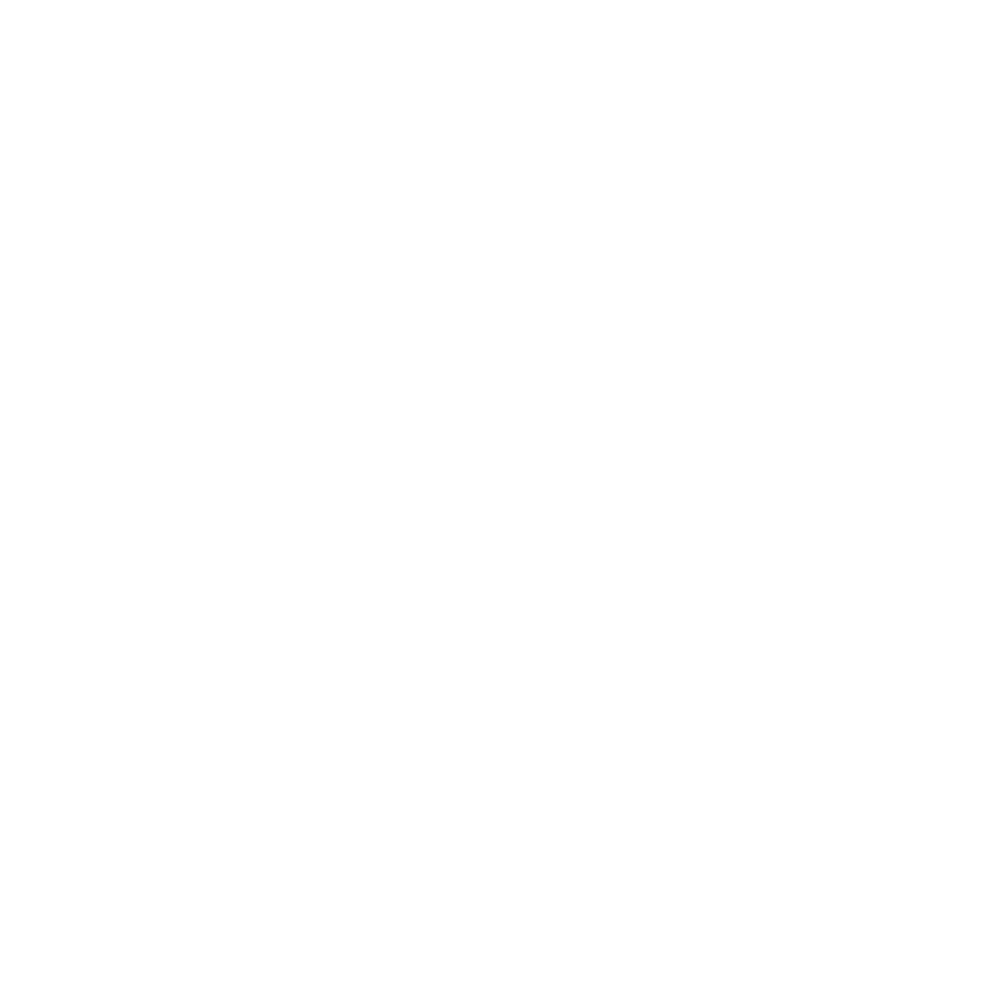

Drift correcting H2 on fov: Conv_zscan_01.tif
Fitting H2_750 on fov: Conv_zscan_01.tif


<IPython.core.display.Javascript object>


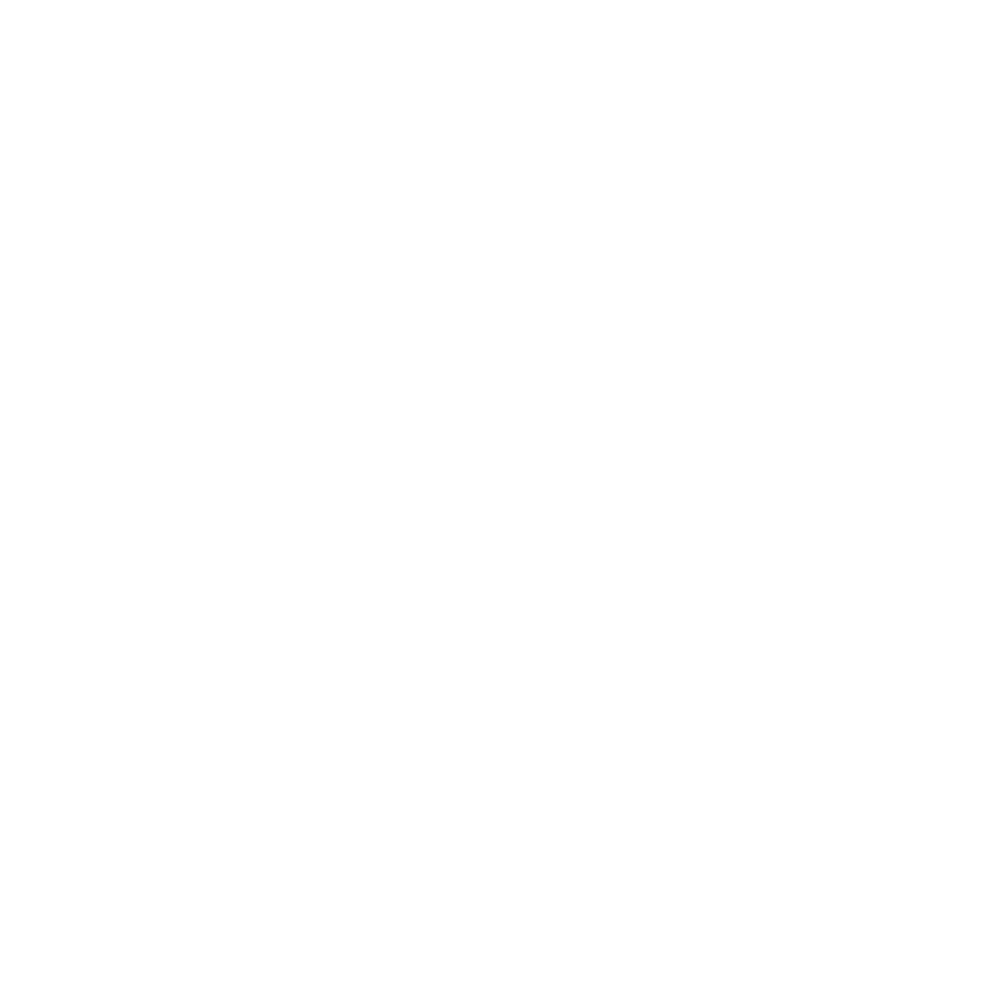

Fitting H2_647 on fov: Conv_zscan_01.tif


<IPython.core.display.Javascript object>


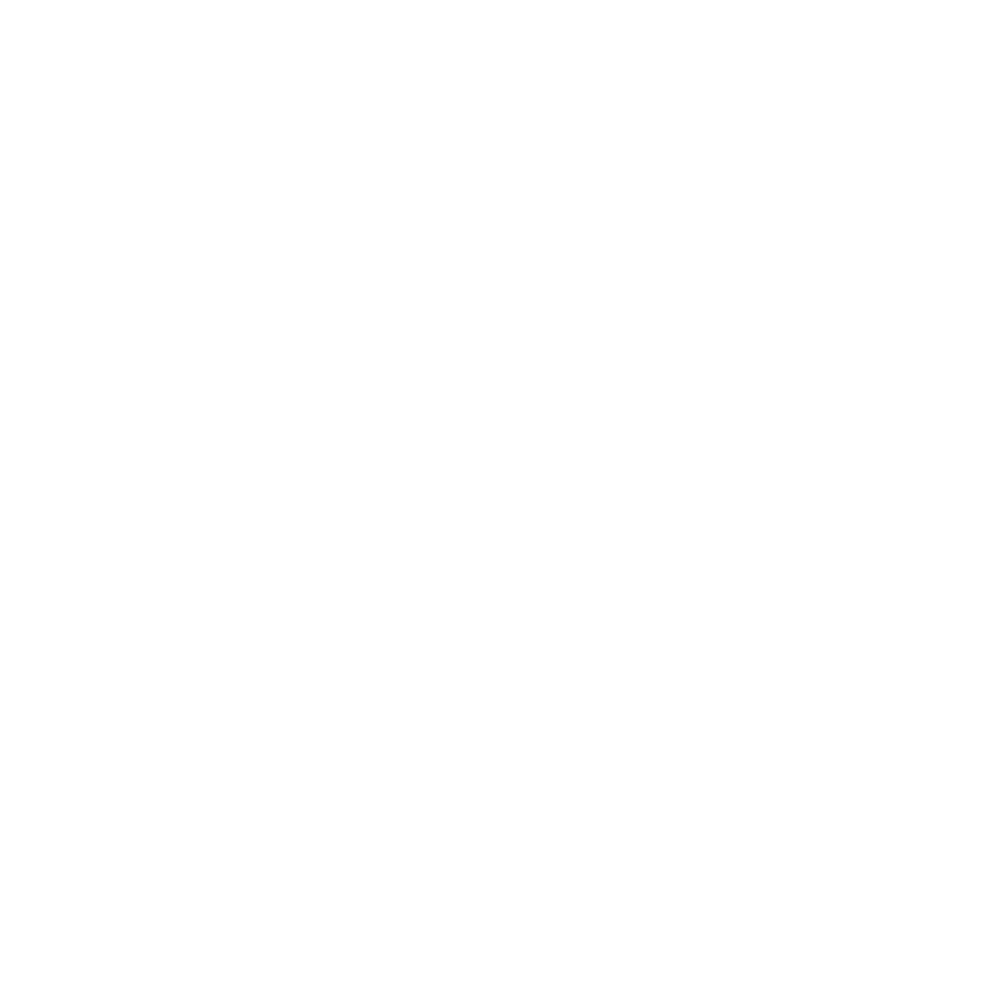

Drift correcting H3 on fov: Conv_zscan_01.tif
Fitting H3_750 on fov: Conv_zscan_01.tif


<IPython.core.display.Javascript object>


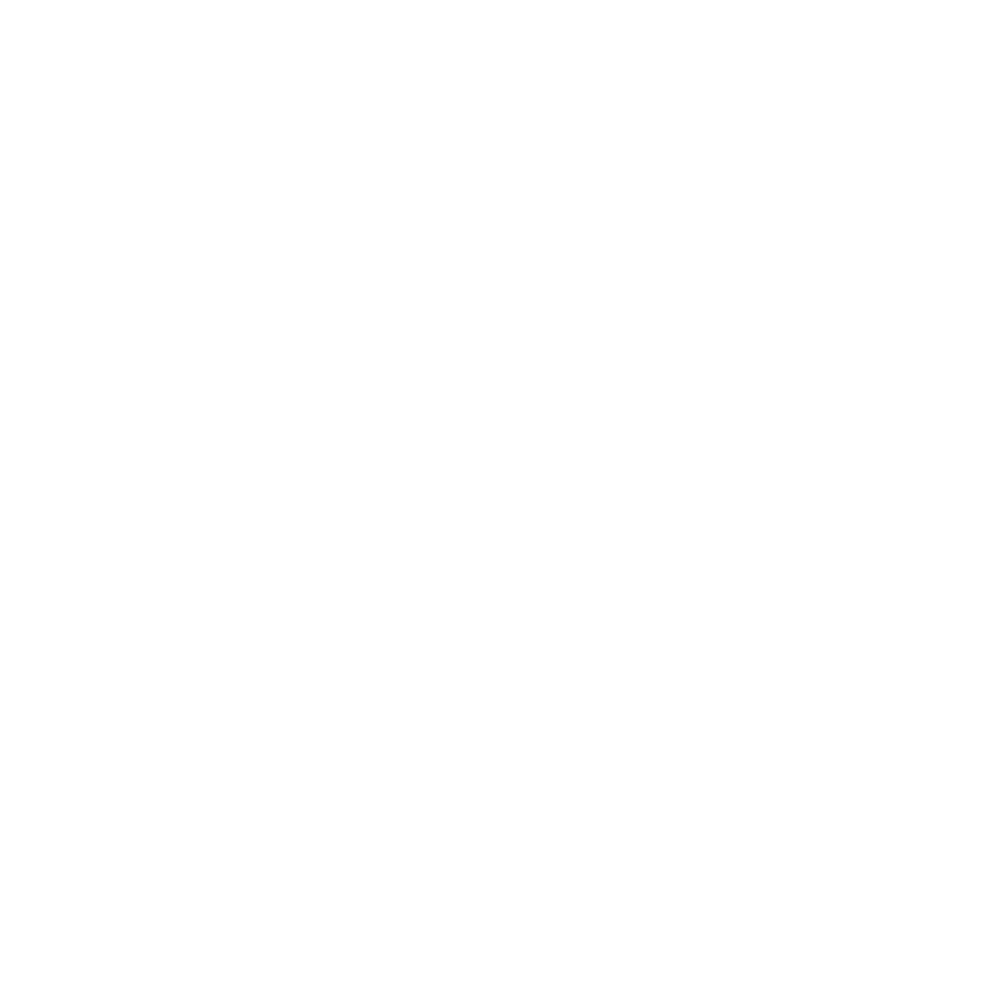

Fitting H3_647 on fov: Conv_zscan_01.tif


<IPython.core.display.Javascript object>


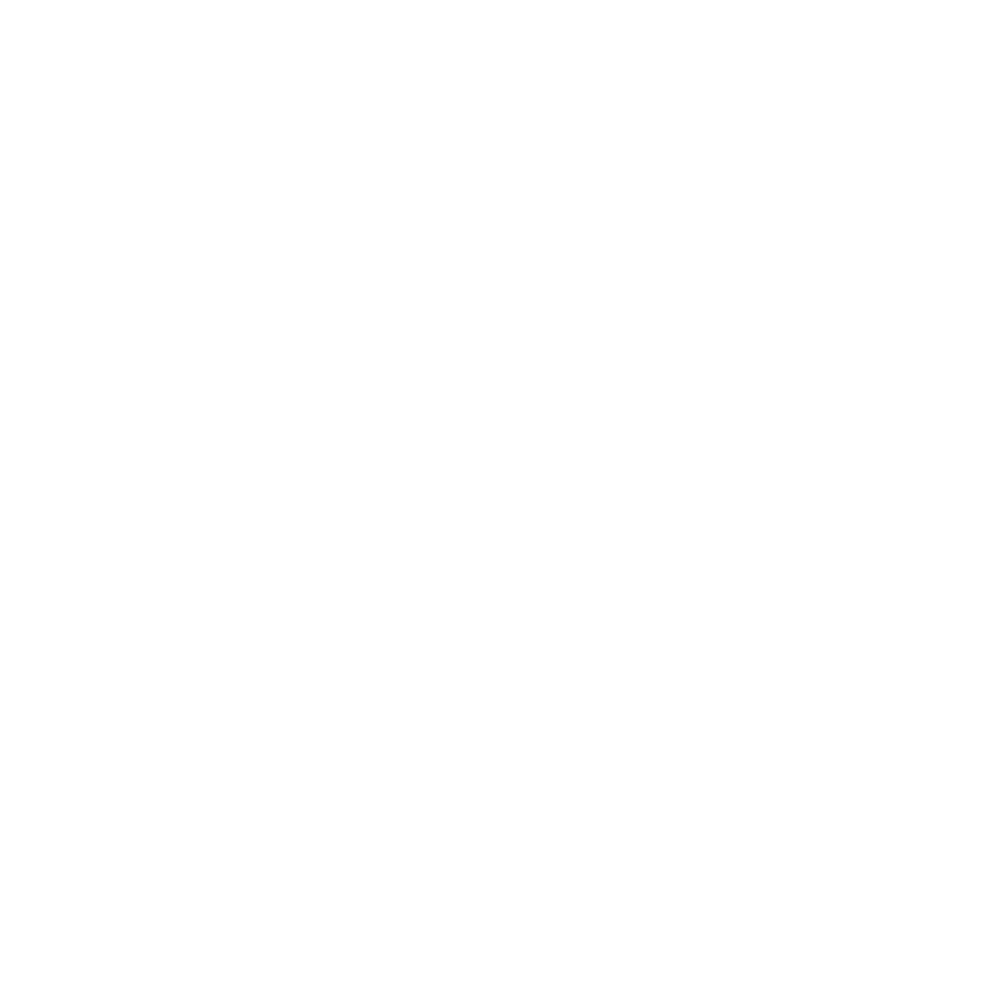

Drift correcting H4 on fov: Conv_zscan_01.tif
Fitting H4_750 on fov: Conv_zscan_01.tif


<IPython.core.display.Javascript object>


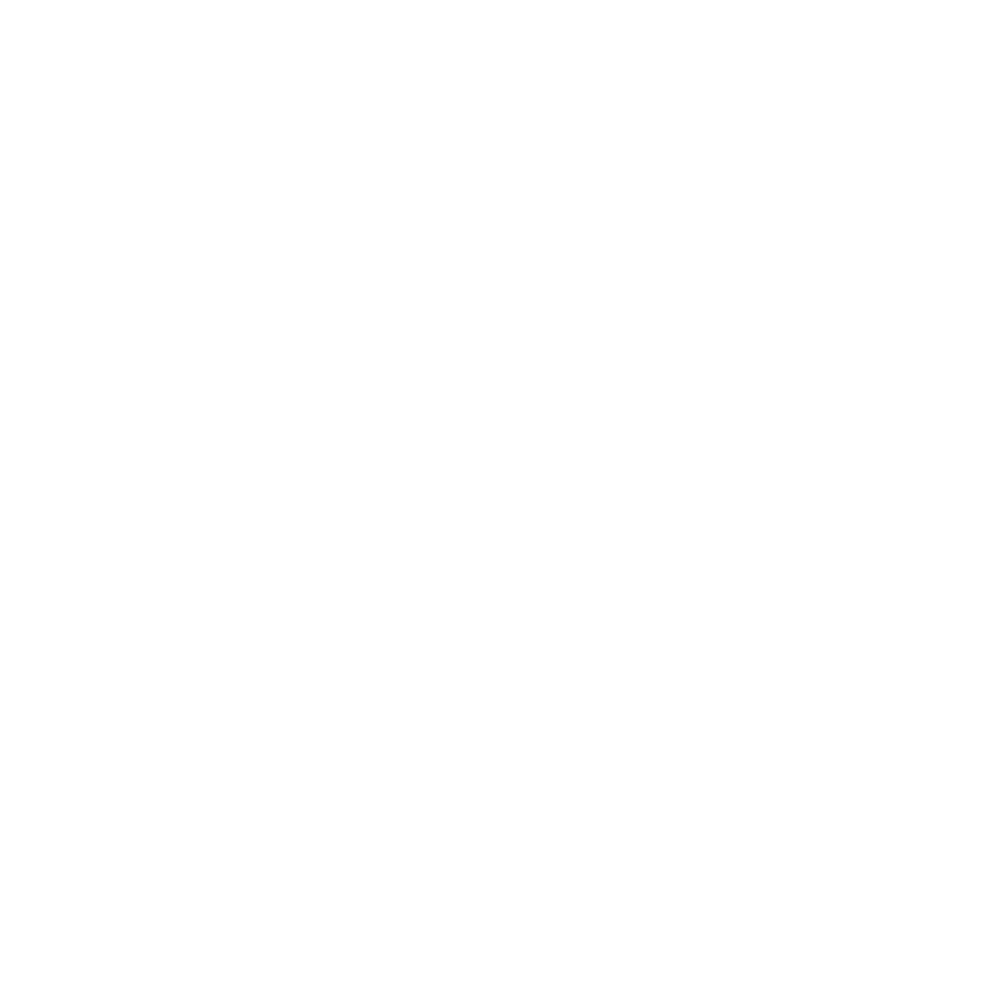

Fitting H4_647 on fov: Conv_zscan_01.tif


<IPython.core.display.Javascript object>


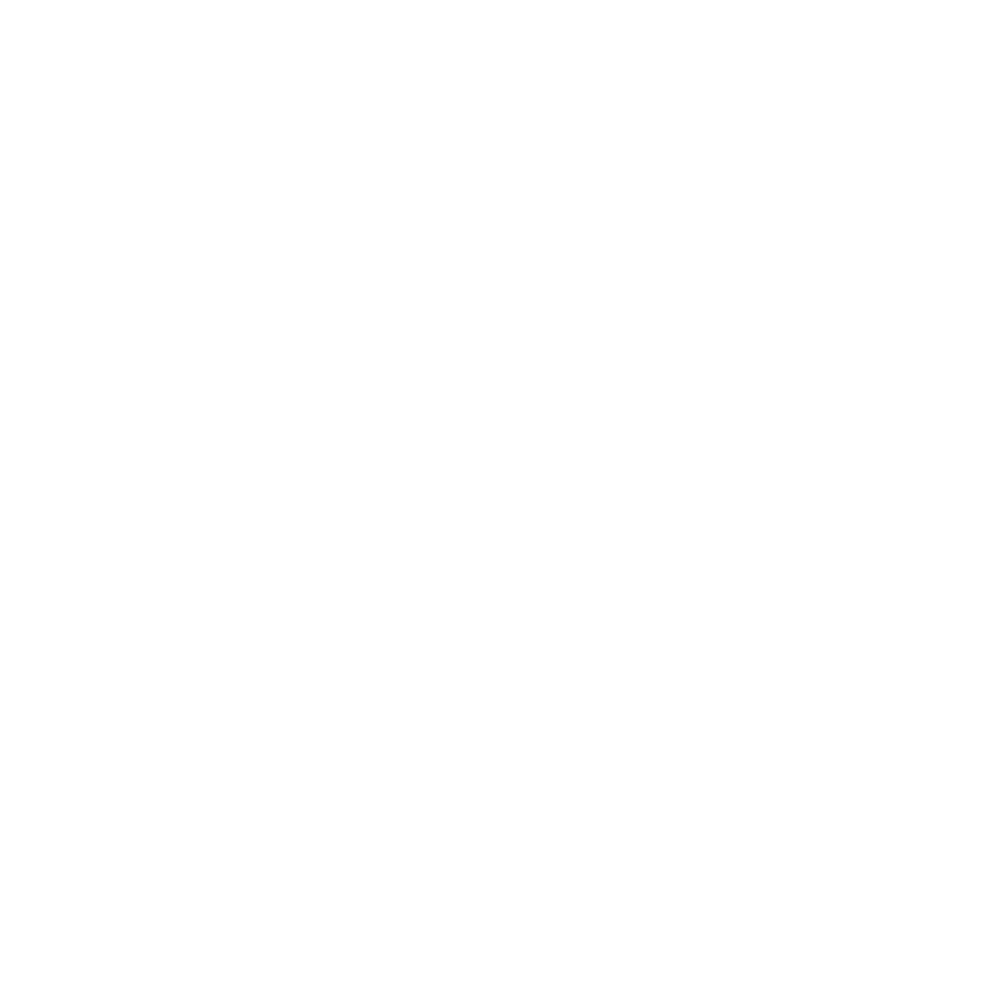

Drift correcting H5 on fov: Conv_zscan_01.tif
Fitting H5_750 on fov: Conv_zscan_01.tif


<IPython.core.display.Javascript object>


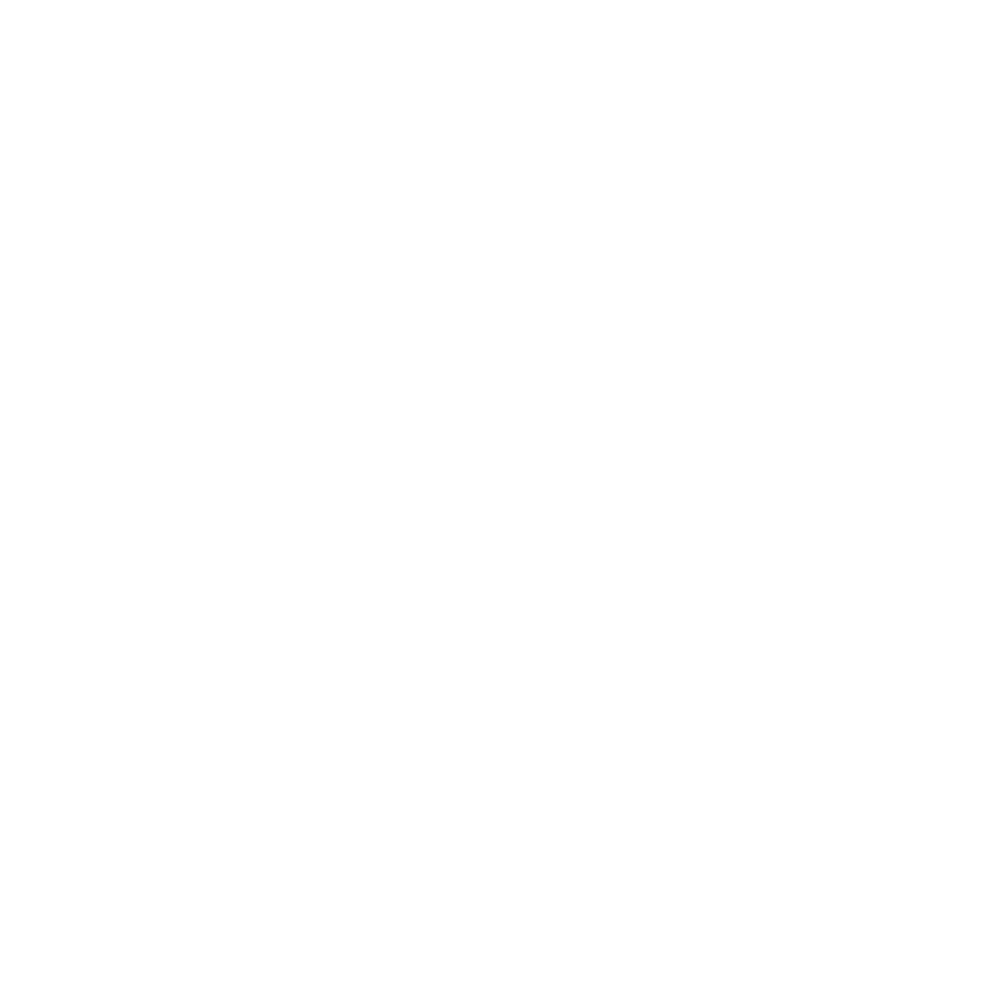

Fitting H5_647 on fov: Conv_zscan_01.tif


<IPython.core.display.Javascript object>


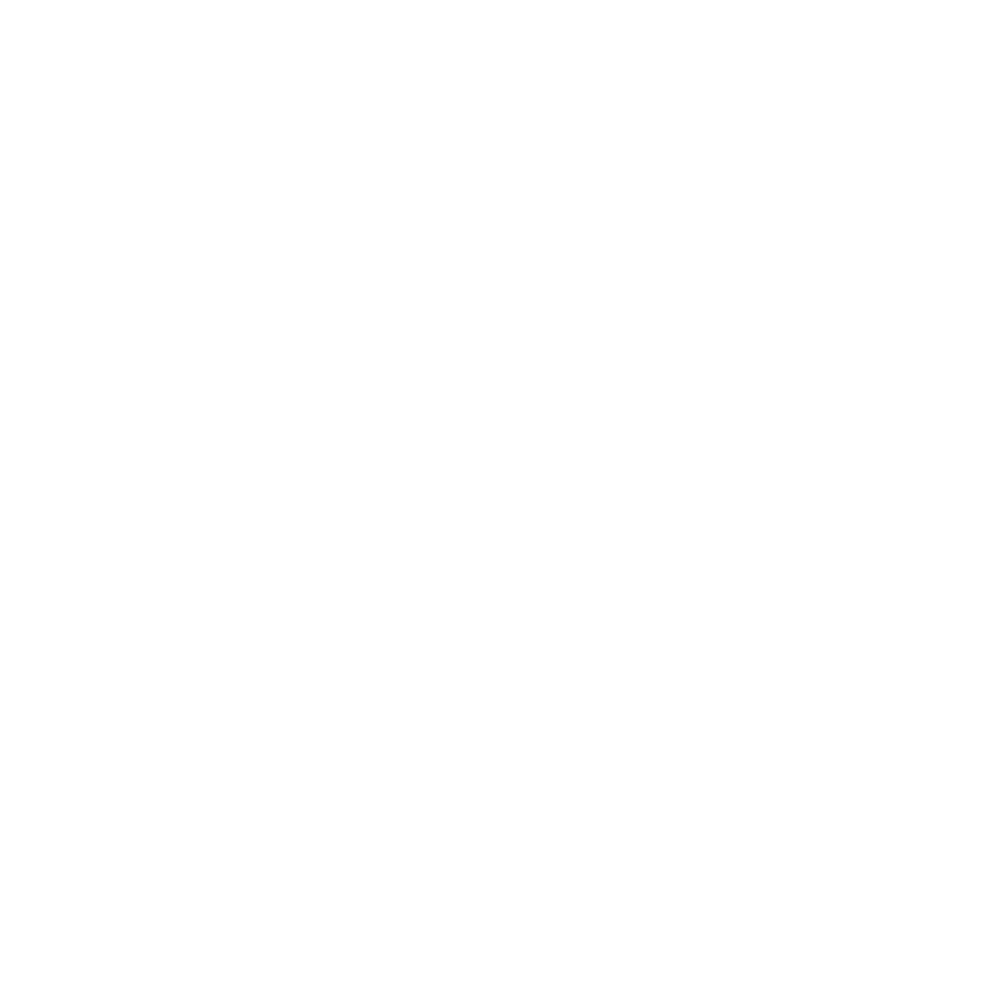

Drift correcting H6 on fov: Conv_zscan_01.tif
Fitting H6_750 on fov: Conv_zscan_01.tif


<IPython.core.display.Javascript object>


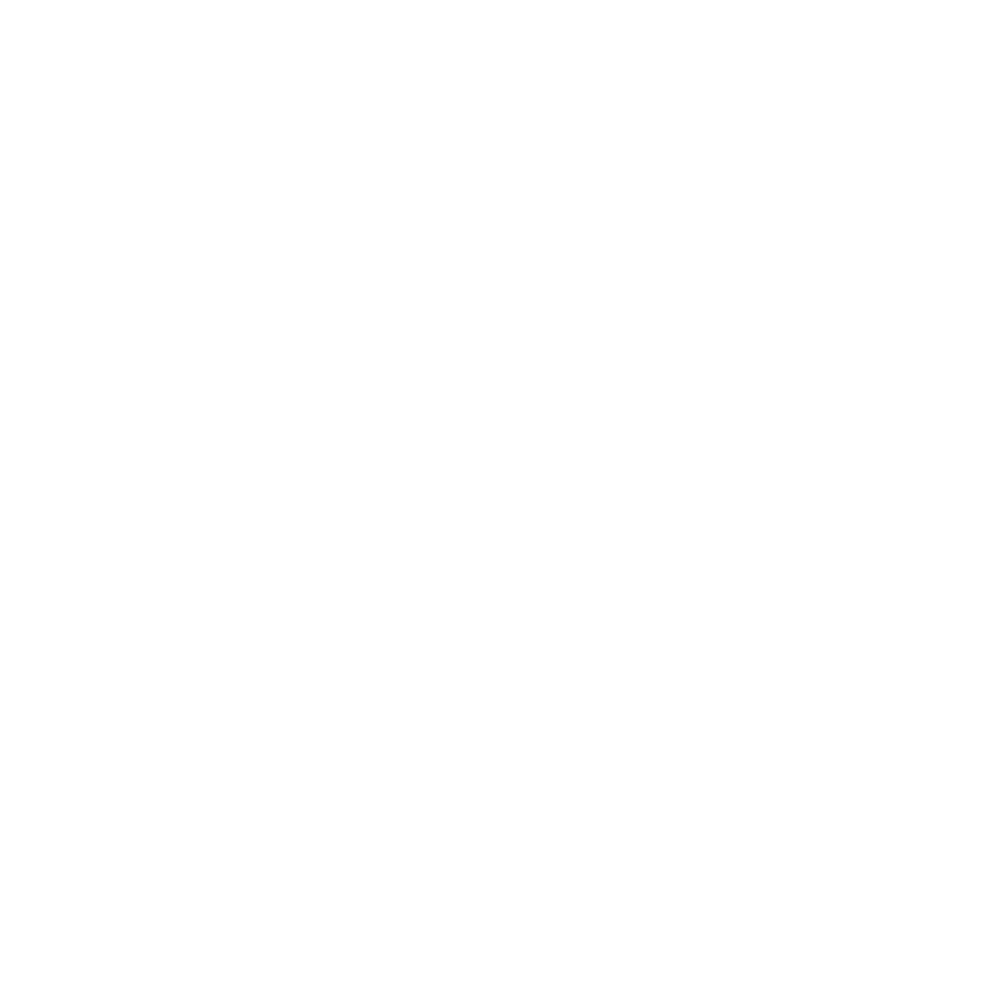

Fitting H6_647 on fov: Conv_zscan_01.tif


<IPython.core.display.Javascript object>


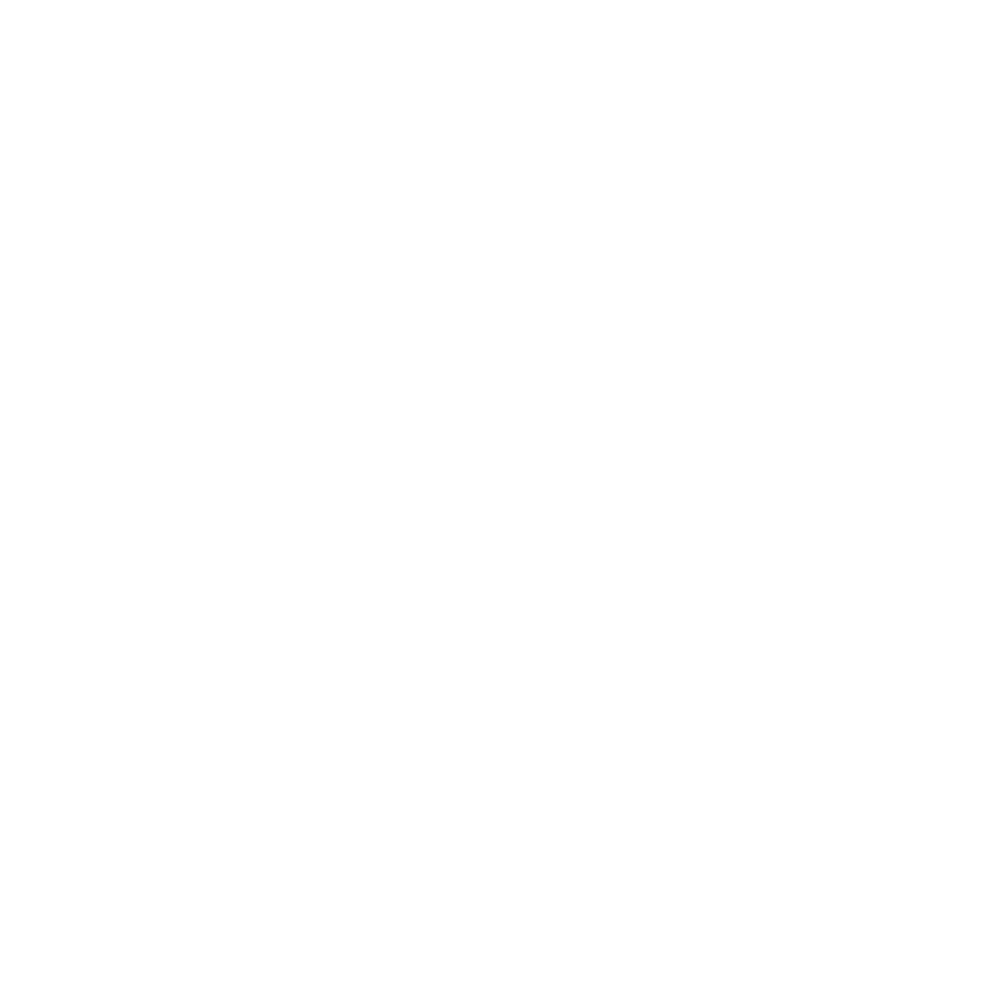

Estimating number of cells based on dapi image on fov: Conv_zscan_01.tif


<IPython.core.display.Javascript object>


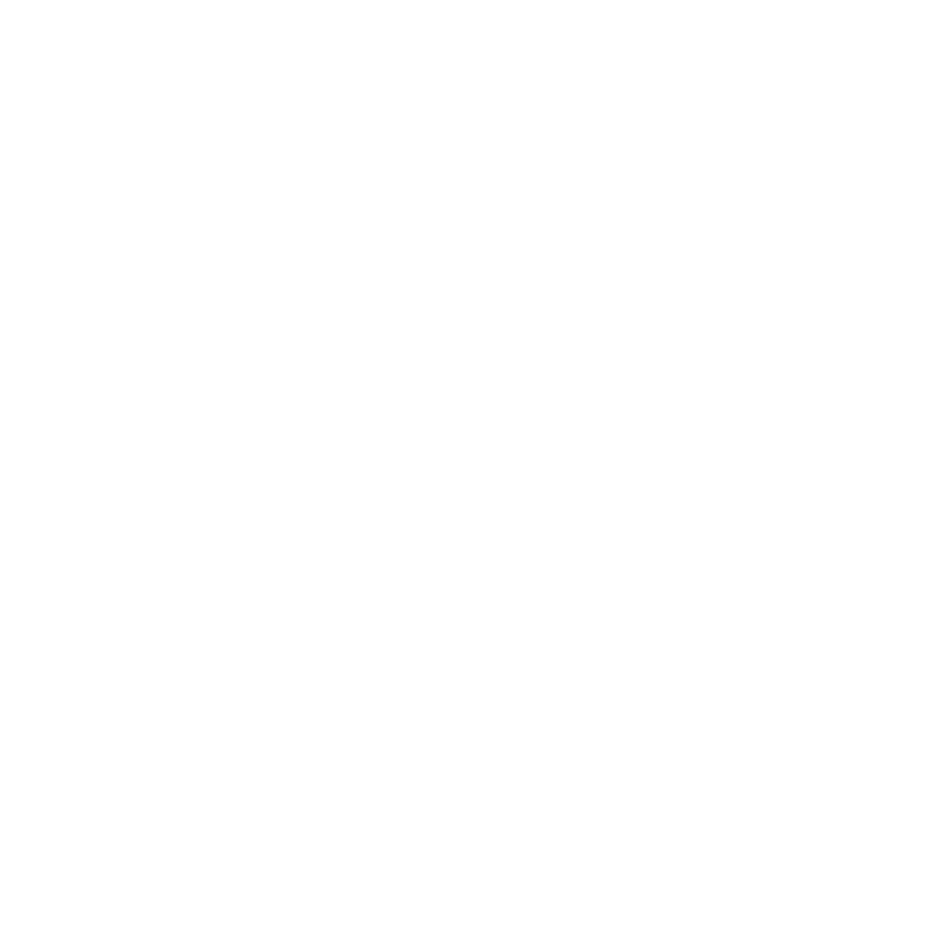

<ipython-input-27-1886a2f7fea2>:20: TqdmDeprecationWarning: This function will be removed in tqdm==5.0.0
Please use `tqdm.notebook.tqdm` instead of `tqdm.tqdm_notebook`
  for fld in tqdm(folders):



Drift correcting H1 on fov: Conv_zscan_02.tif
Fitting H1_750 on fov: Conv_zscan_02.tif


<IPython.core.display.Javascript object>


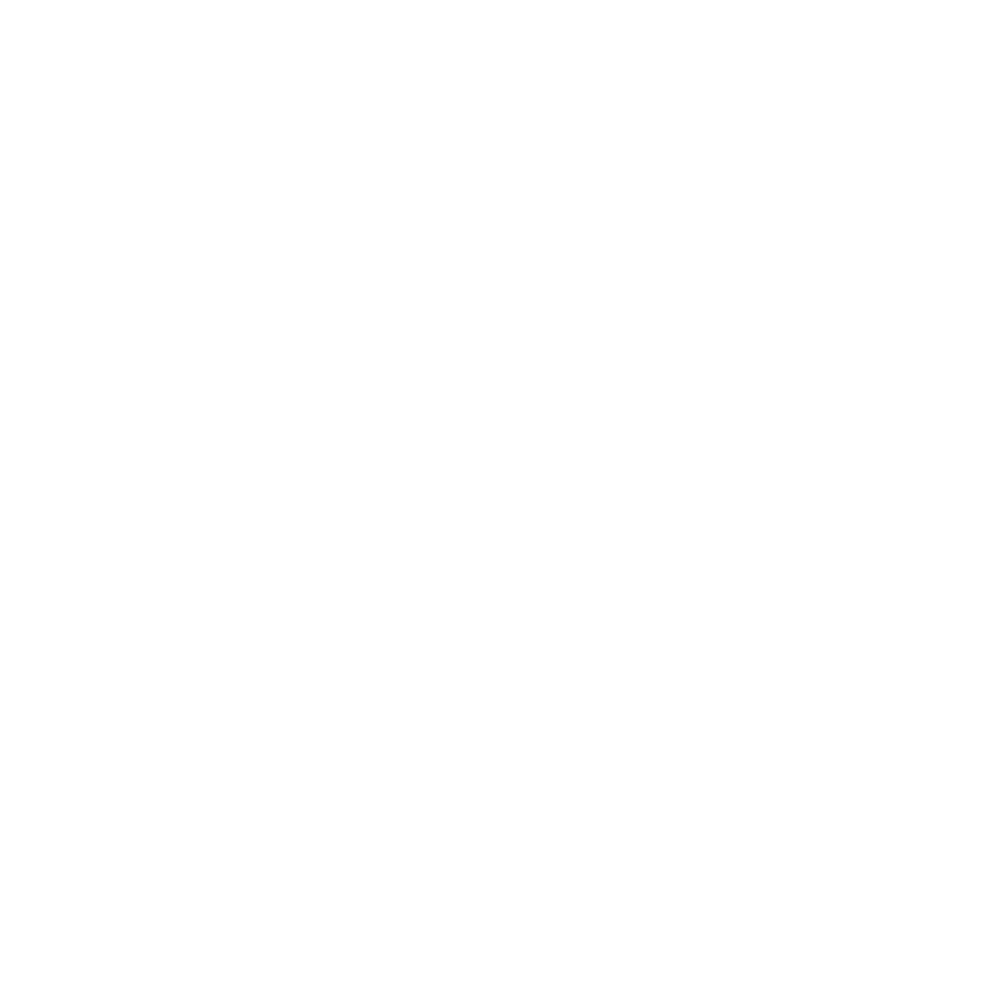

Fitting H1_647 on fov: Conv_zscan_02.tif


<IPython.core.display.Javascript object>


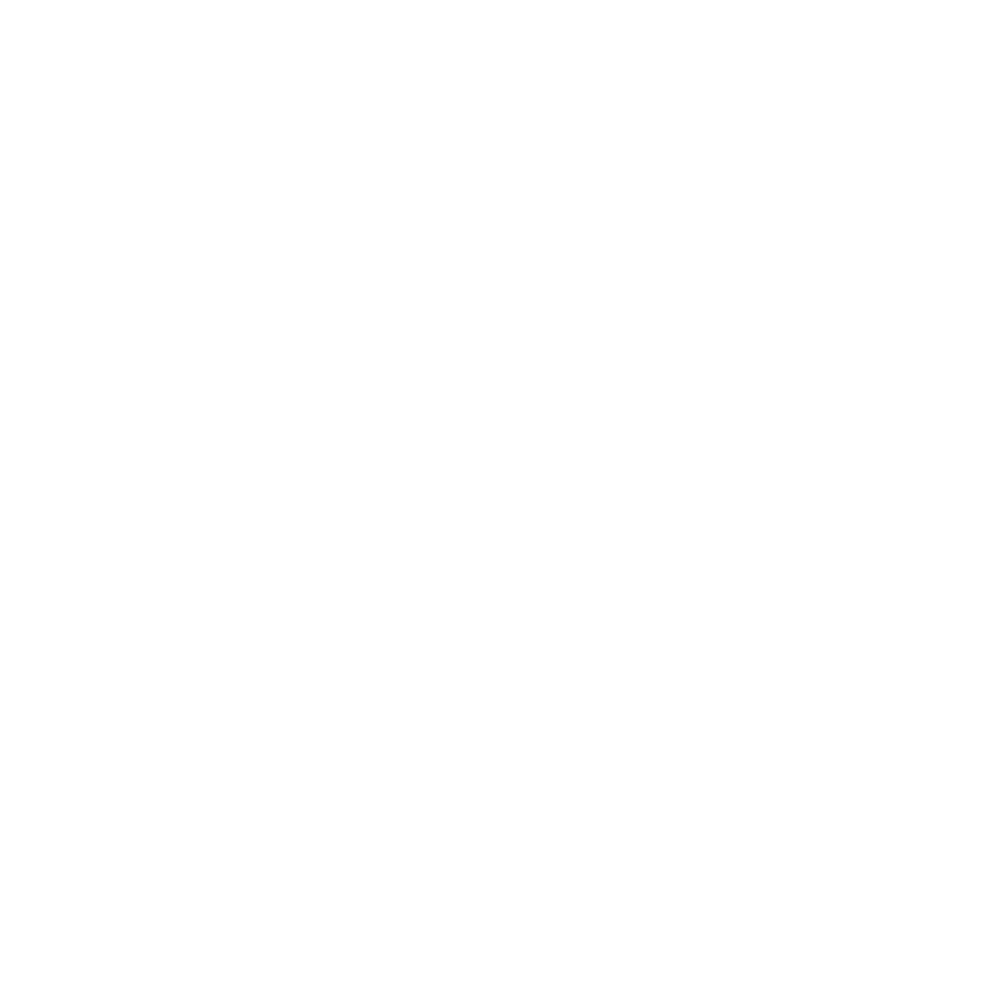

Drift correcting H2 on fov: Conv_zscan_02.tif
Fitting H2_750 on fov: Conv_zscan_02.tif


<IPython.core.display.Javascript object>


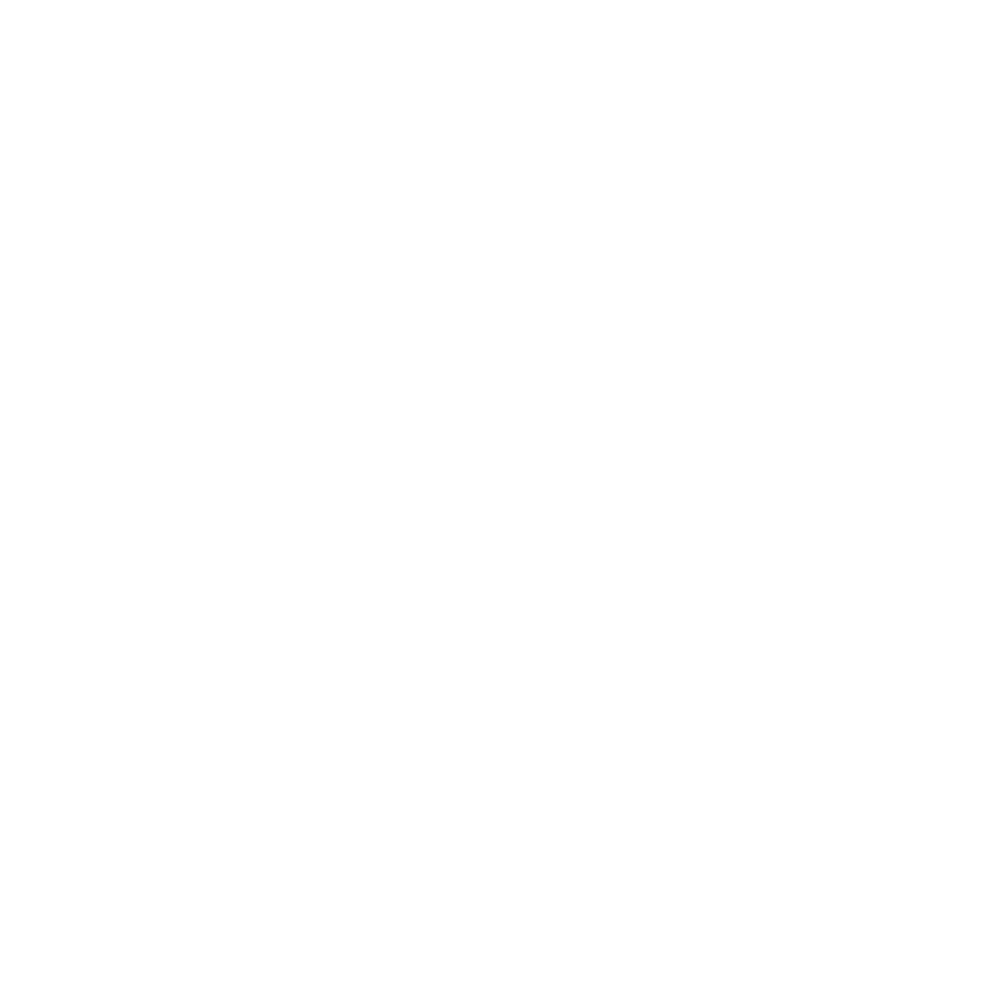

Fitting H2_647 on fov: Conv_zscan_02.tif


<IPython.core.display.Javascript object>


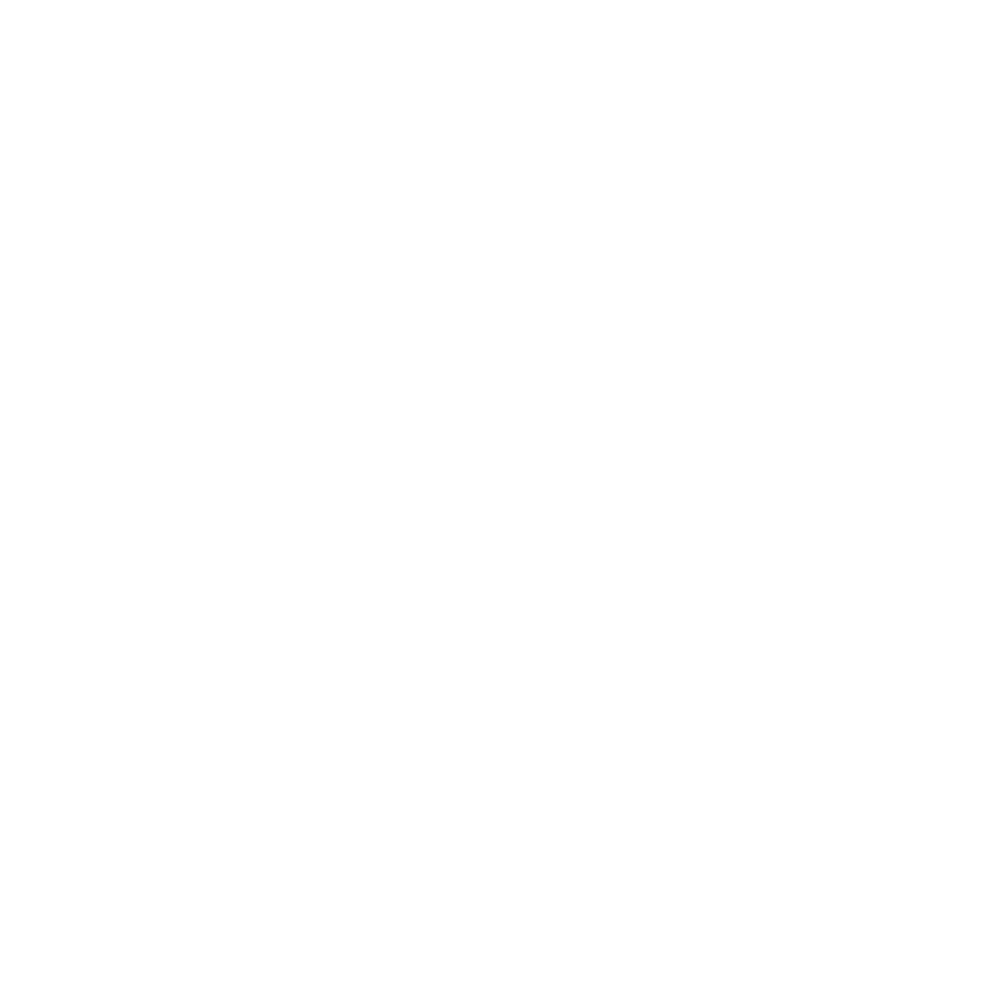

Drift correcting H3 on fov: Conv_zscan_02.tif
Fitting H3_750 on fov: Conv_zscan_02.tif


<IPython.core.display.Javascript object>


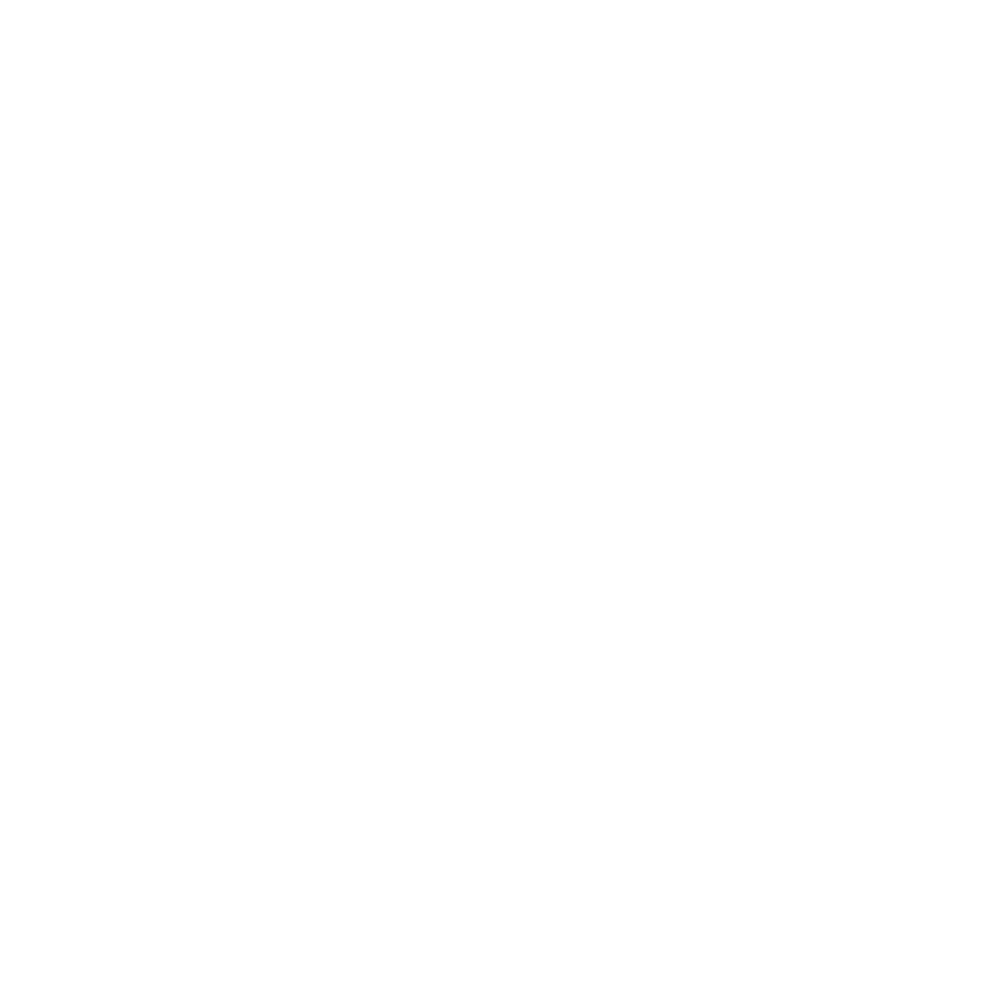

Fitting H3_647 on fov: Conv_zscan_02.tif


<IPython.core.display.Javascript object>


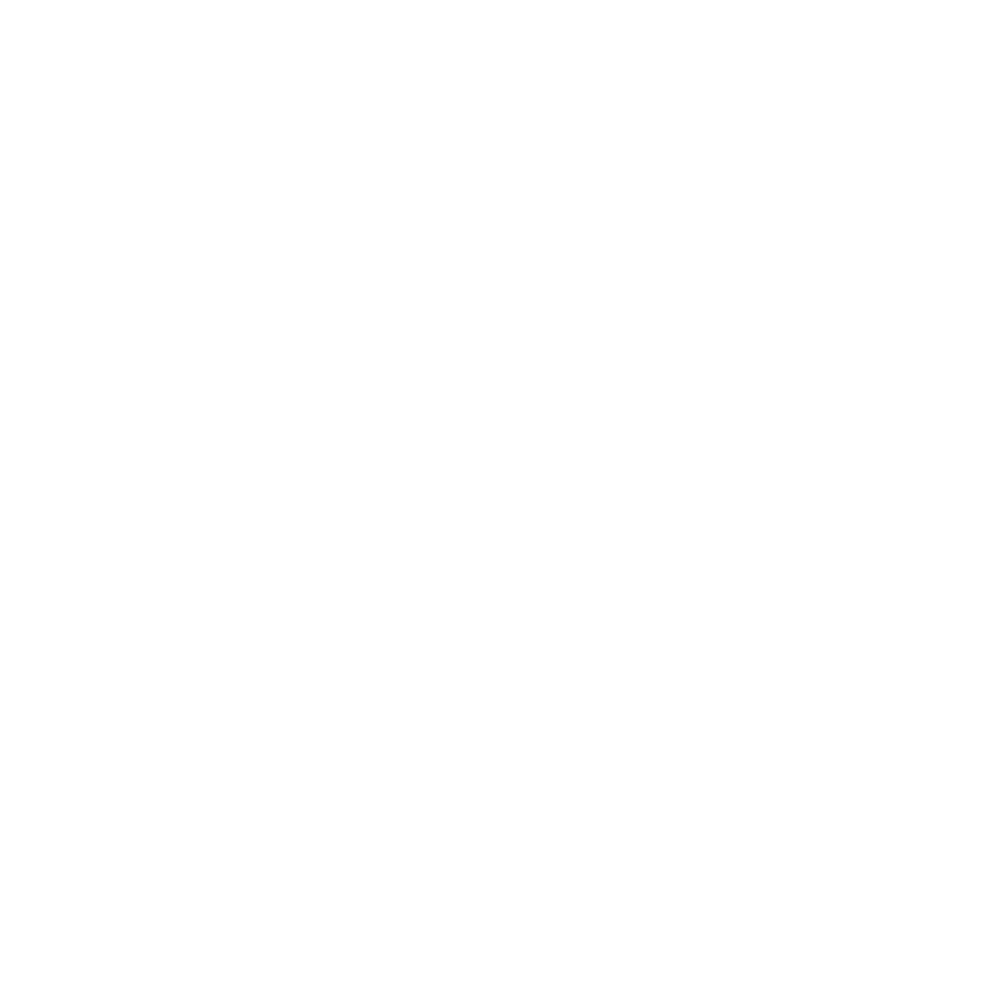

Drift correcting H4 on fov: Conv_zscan_02.tif
Fitting H4_750 on fov: Conv_zscan_02.tif


<IPython.core.display.Javascript object>


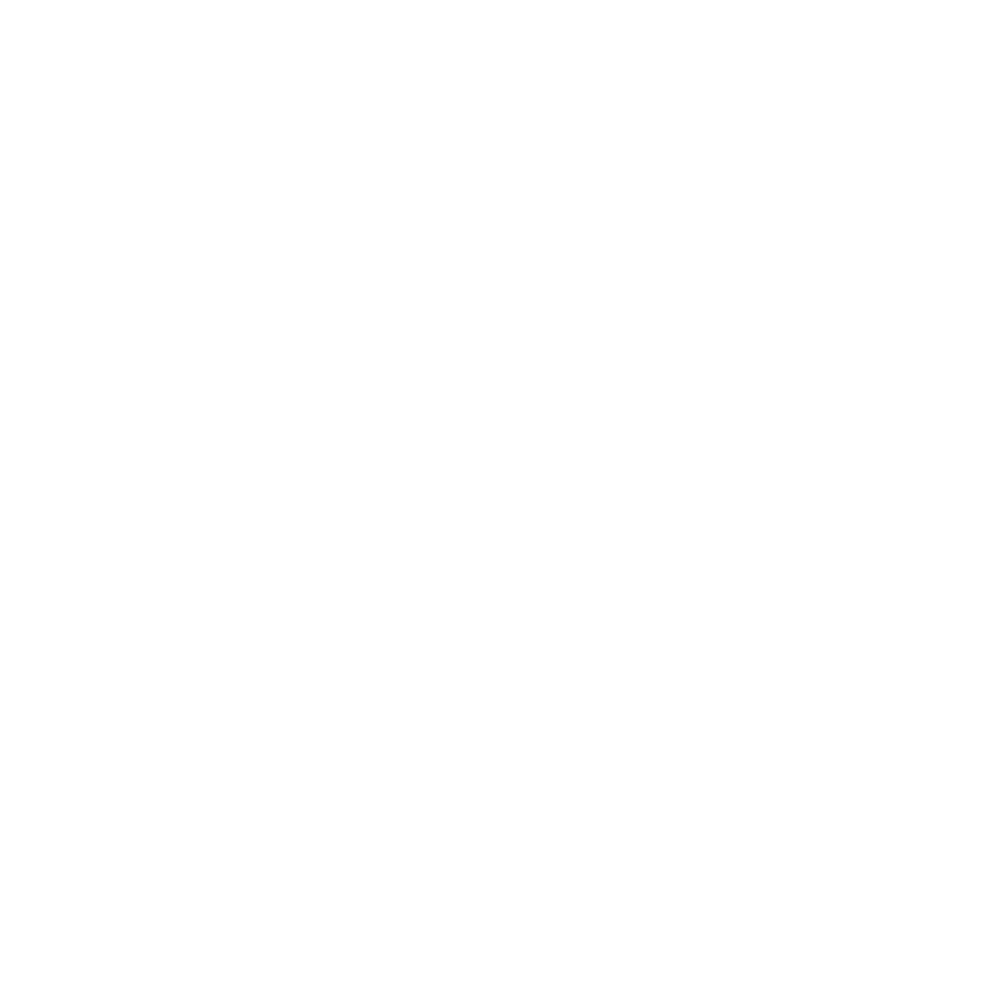

Fitting H4_647 on fov: Conv_zscan_02.tif


<IPython.core.display.Javascript object>


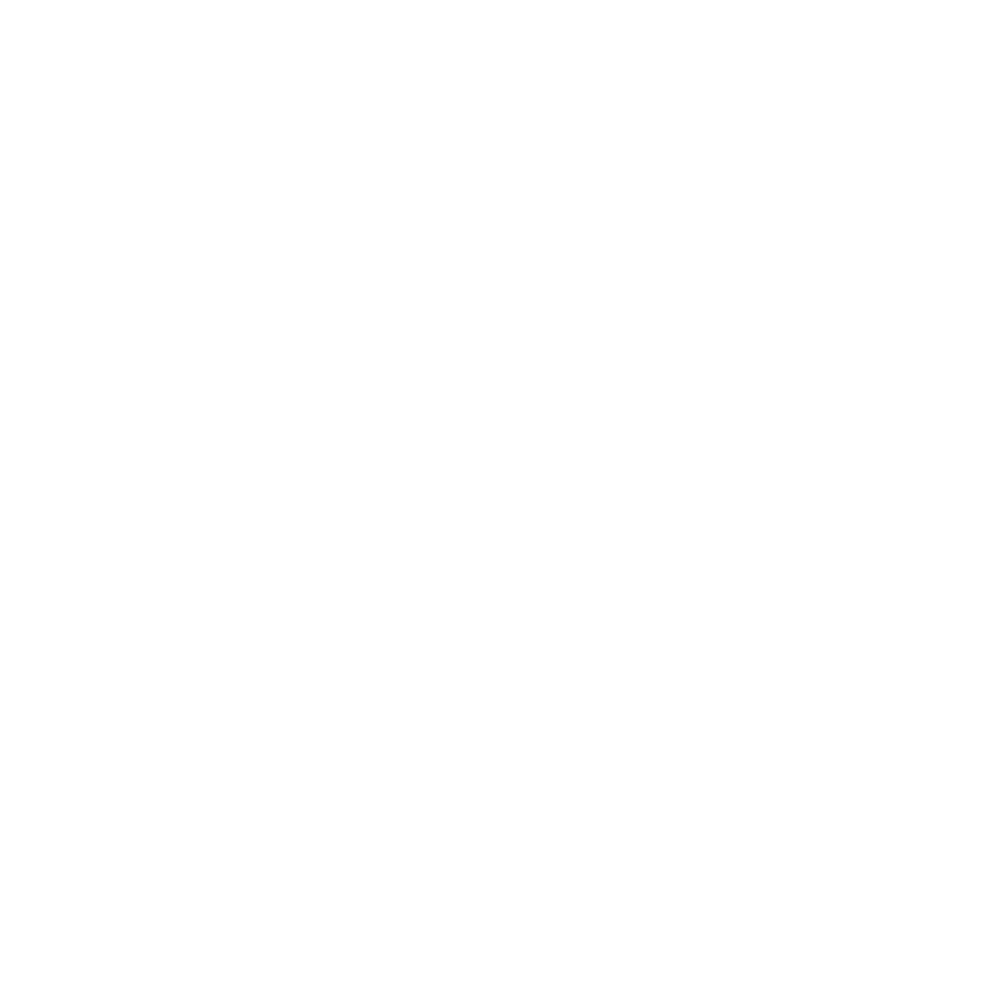

Drift correcting H5 on fov: Conv_zscan_02.tif
Fitting H5_750 on fov: Conv_zscan_02.tif


<IPython.core.display.Javascript object>


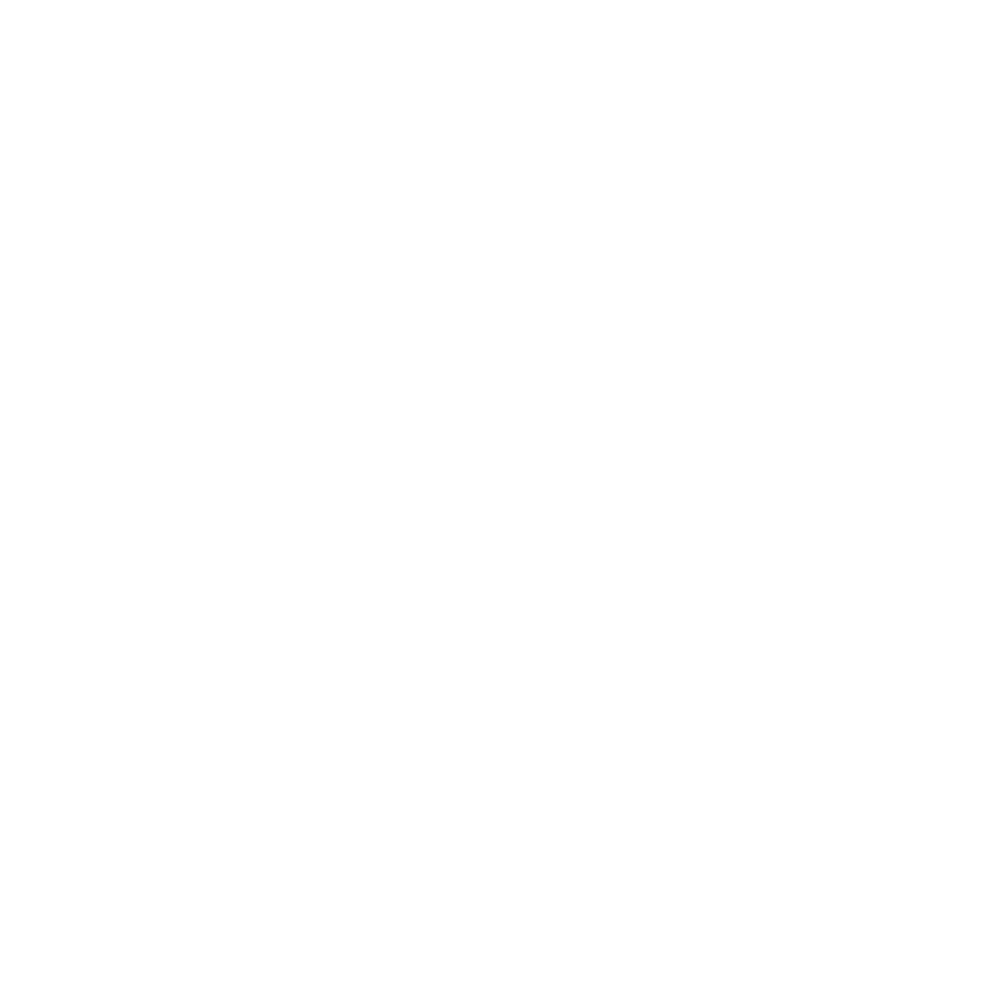

Fitting H5_647 on fov: Conv_zscan_02.tif


<IPython.core.display.Javascript object>


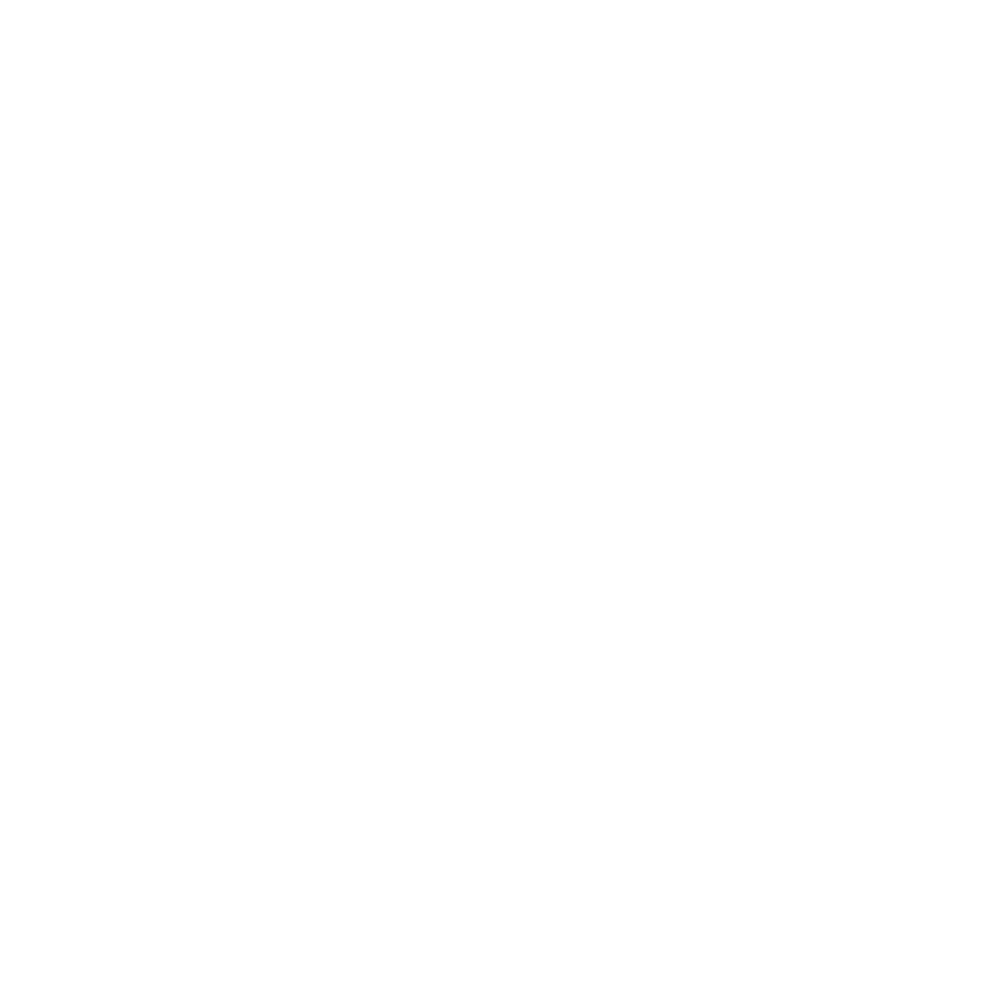

Drift correcting H6 on fov: Conv_zscan_02.tif
Fitting H6_750 on fov: Conv_zscan_02.tif


<IPython.core.display.Javascript object>


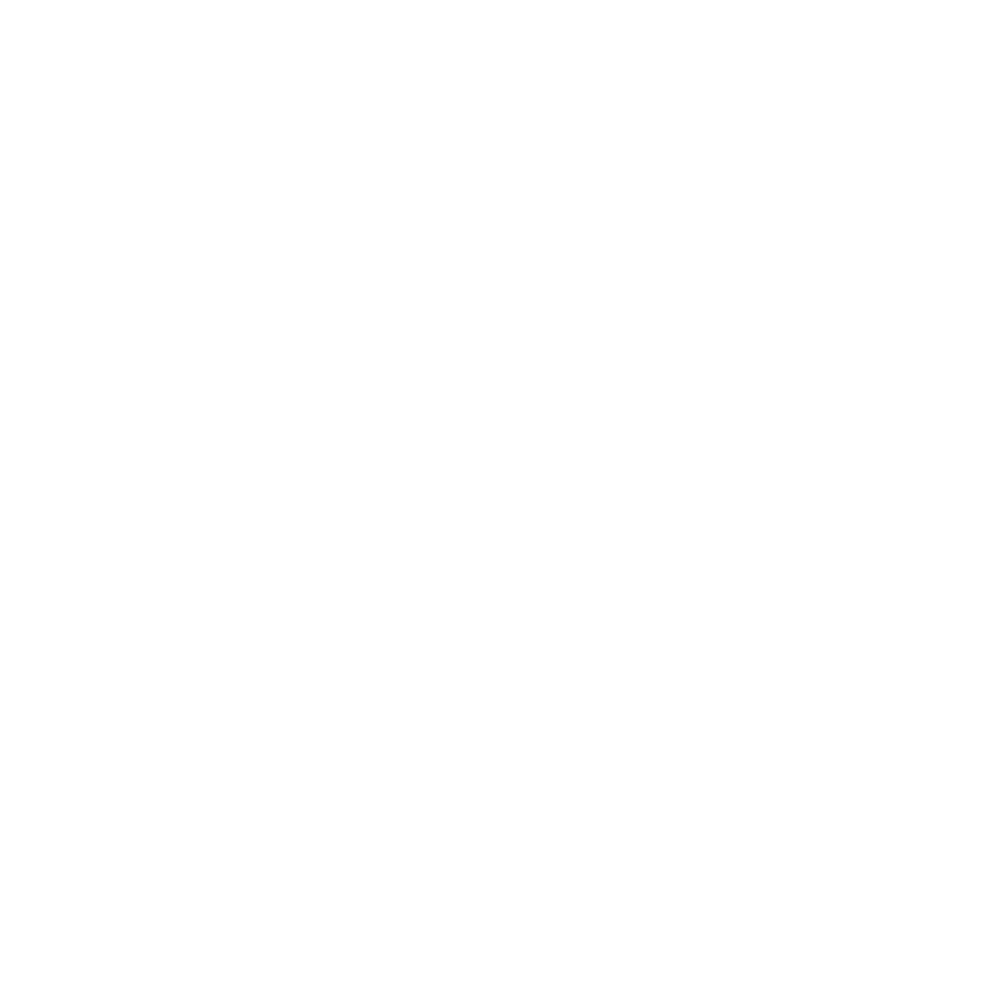

Fitting H6_647 on fov: Conv_zscan_02.tif


<IPython.core.display.Javascript object>


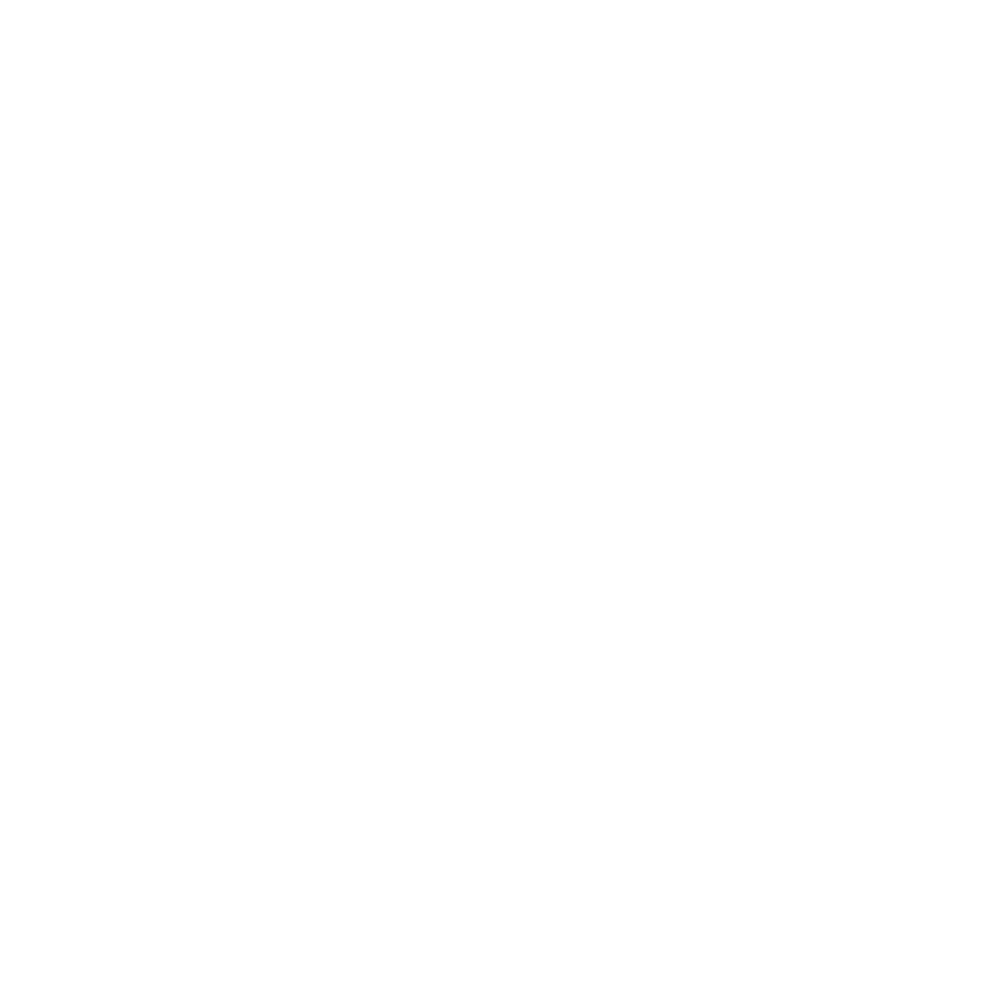

Estimating number of cells based on dapi image on fov: Conv_zscan_02.tif


<IPython.core.display.Javascript object>


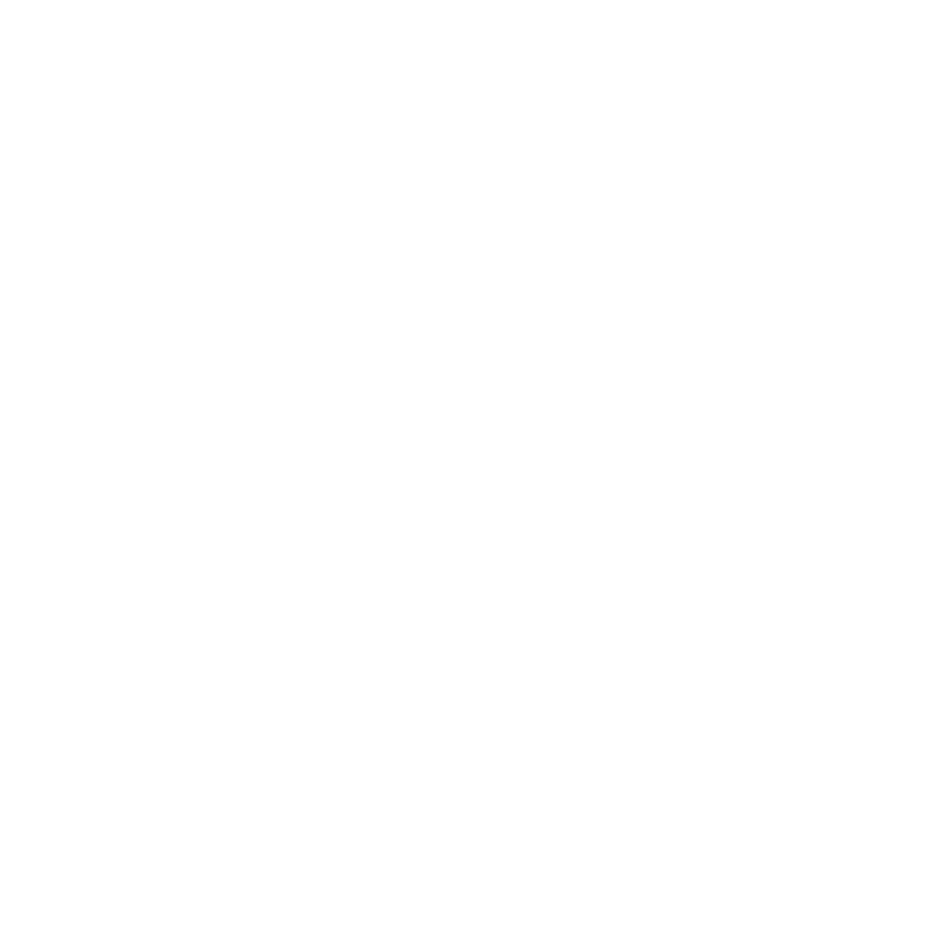

<ipython-input-27-1886a2f7fea2>:20: TqdmDeprecationWarning: This function will be removed in tqdm==5.0.0
Please use `tqdm.notebook.tqdm` instead of `tqdm.tqdm_notebook`
  for fld in tqdm(folders):



Drift correcting H1 on fov: Conv_zscan_03.tif
Fitting H1_750 on fov: Conv_zscan_03.tif


<IPython.core.display.Javascript object>


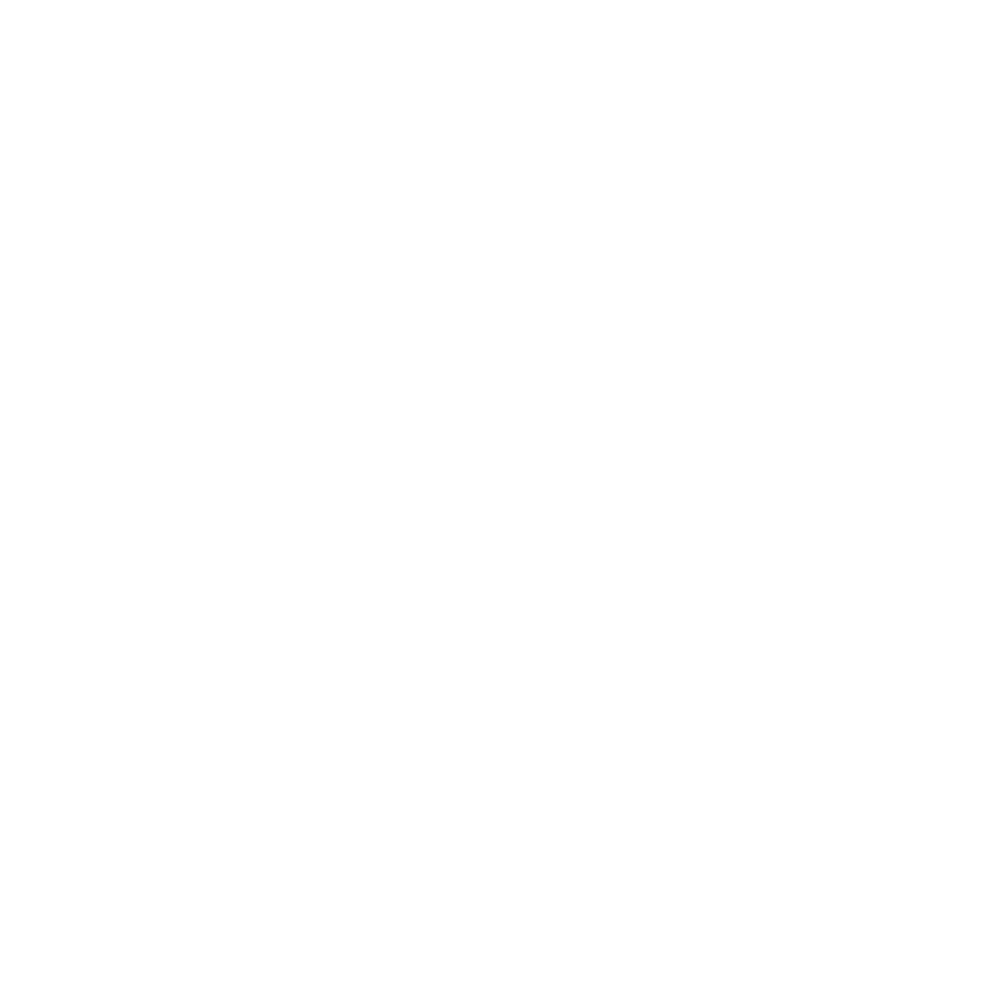

Fitting H1_647 on fov: Conv_zscan_03.tif


<IPython.core.display.Javascript object>


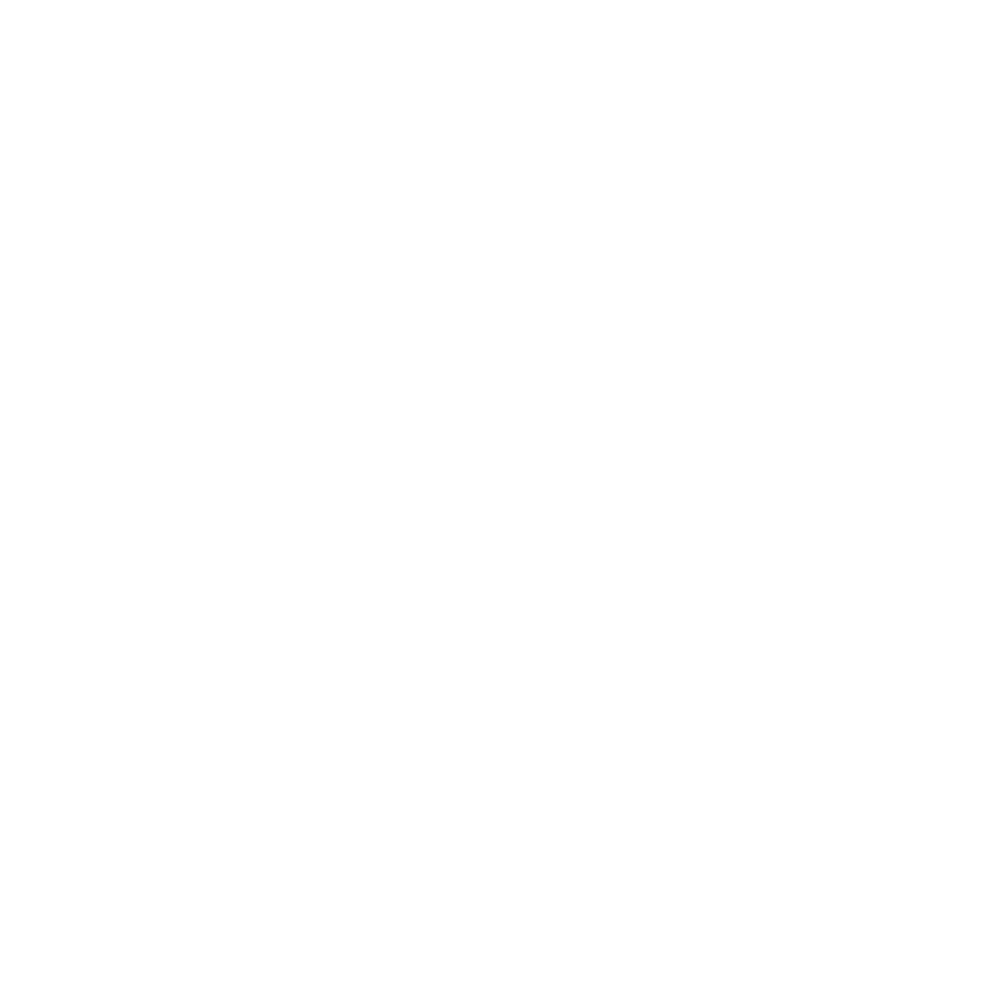

Drift correcting H2 on fov: Conv_zscan_03.tif
Fitting H2_750 on fov: Conv_zscan_03.tif


<IPython.core.display.Javascript object>


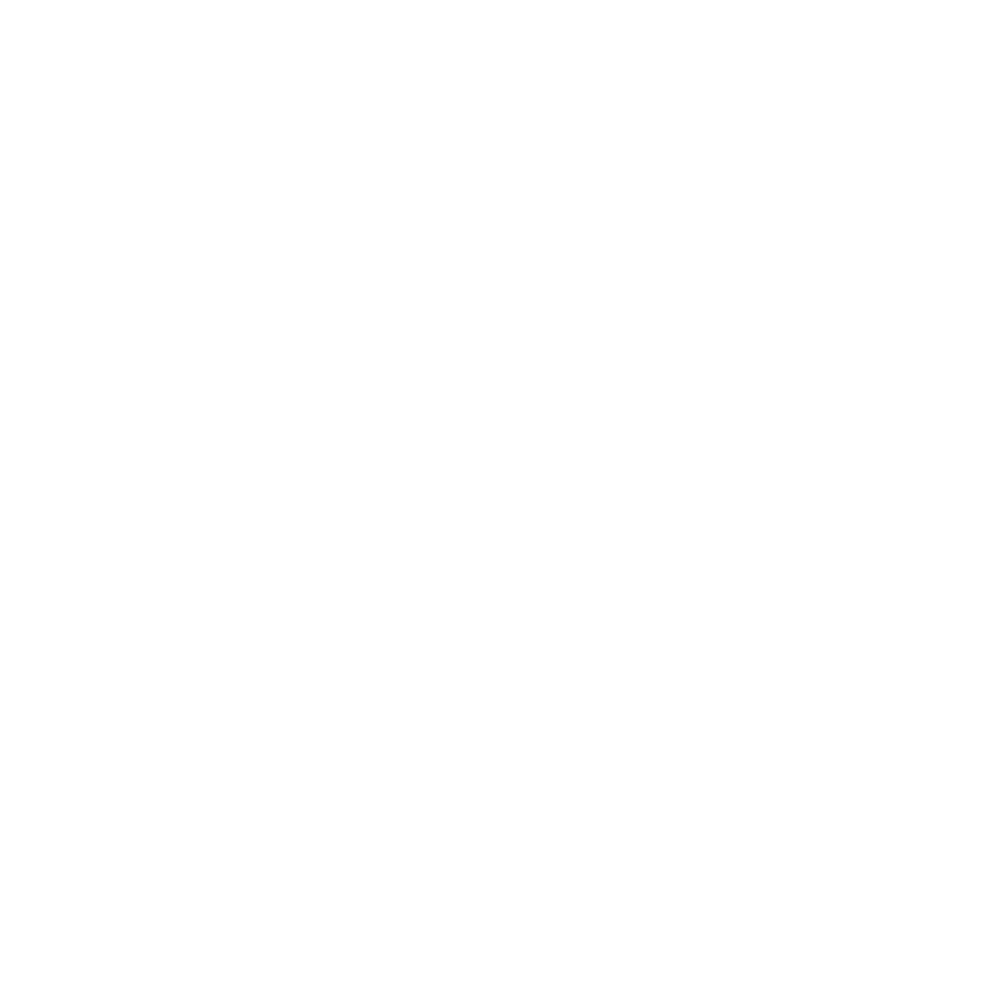

Fitting H2_647 on fov: Conv_zscan_03.tif


<IPython.core.display.Javascript object>


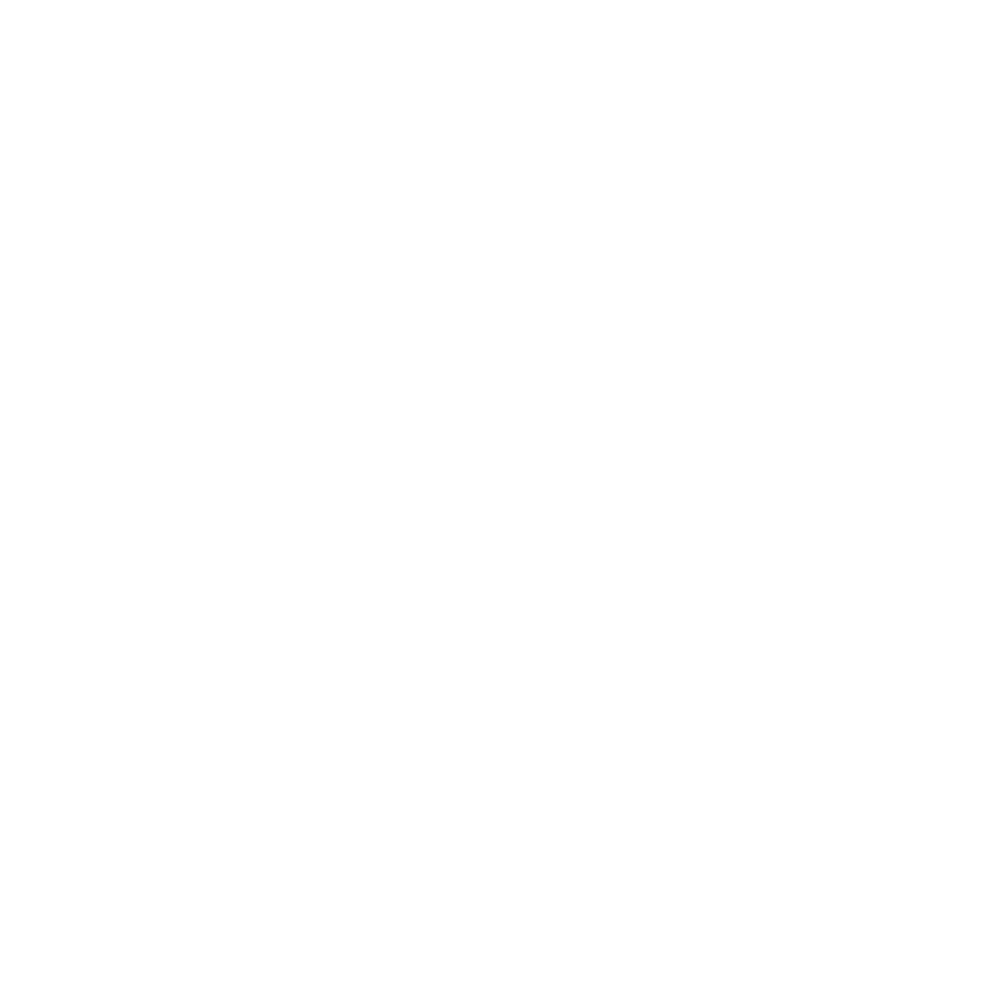

Drift correcting H3 on fov: Conv_zscan_03.tif
Fitting H3_750 on fov: Conv_zscan_03.tif


<IPython.core.display.Javascript object>


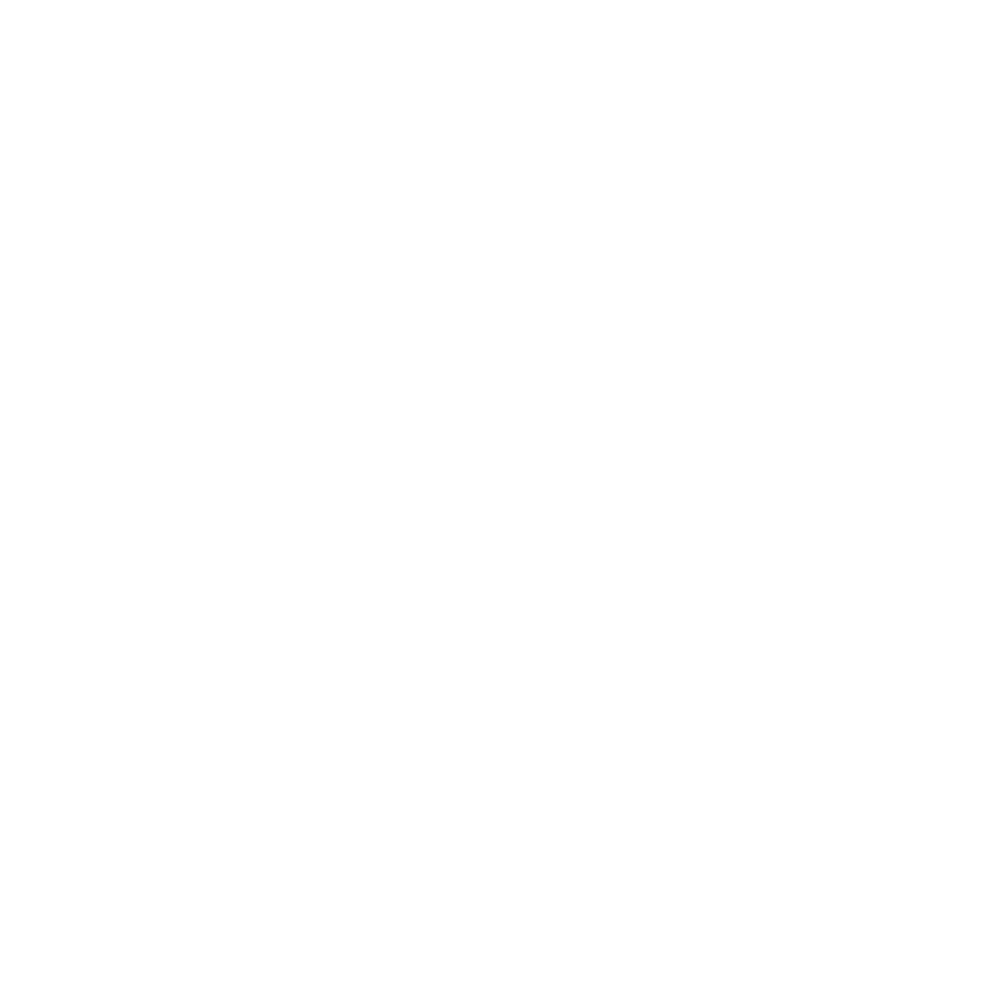

Fitting H3_647 on fov: Conv_zscan_03.tif


<IPython.core.display.Javascript object>


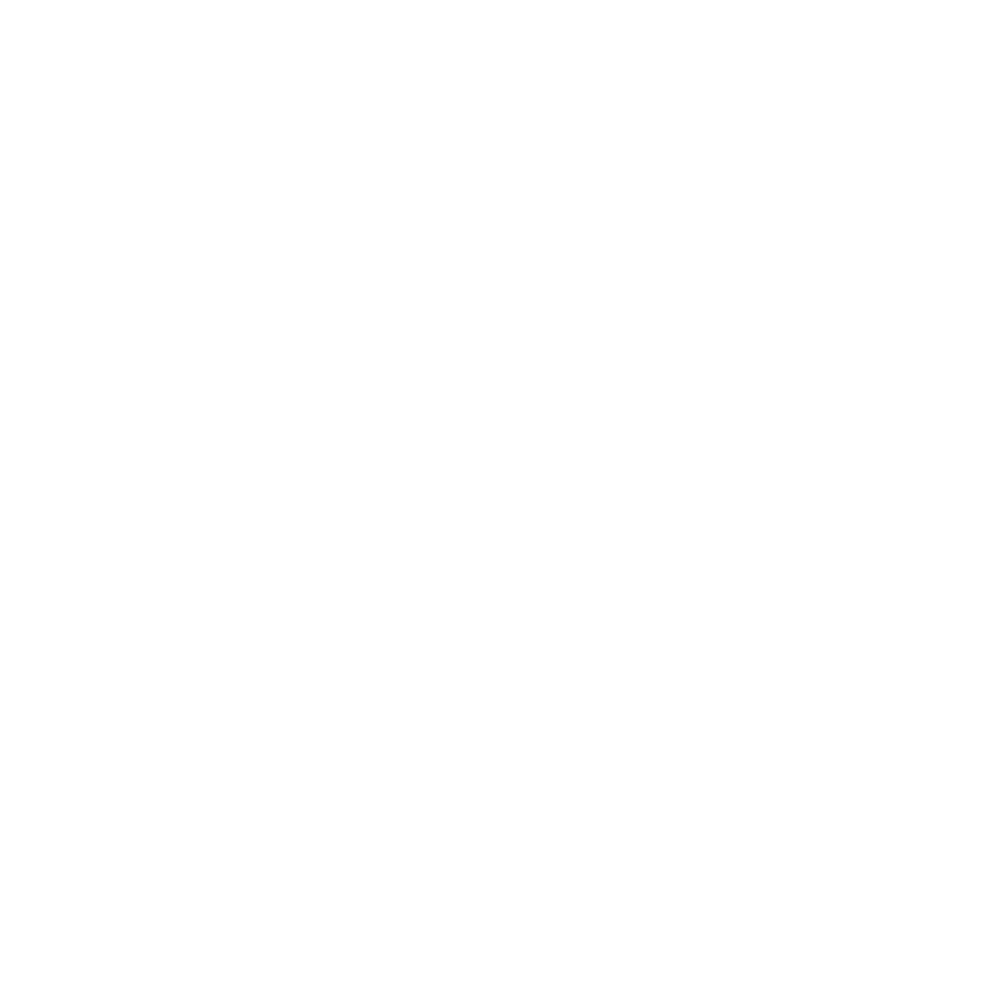

Drift correcting H4 on fov: Conv_zscan_03.tif
Fitting H4_750 on fov: Conv_zscan_03.tif


<IPython.core.display.Javascript object>


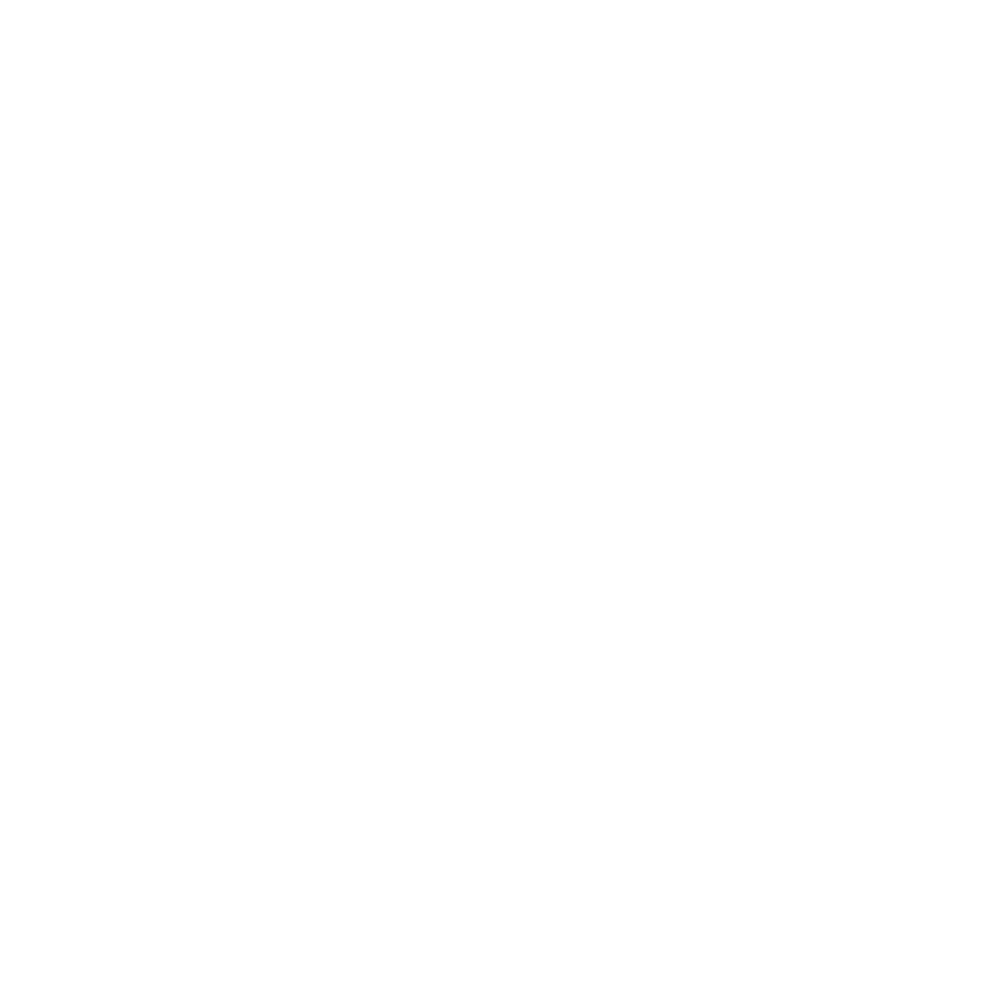

Fitting H4_647 on fov: Conv_zscan_03.tif


<IPython.core.display.Javascript object>


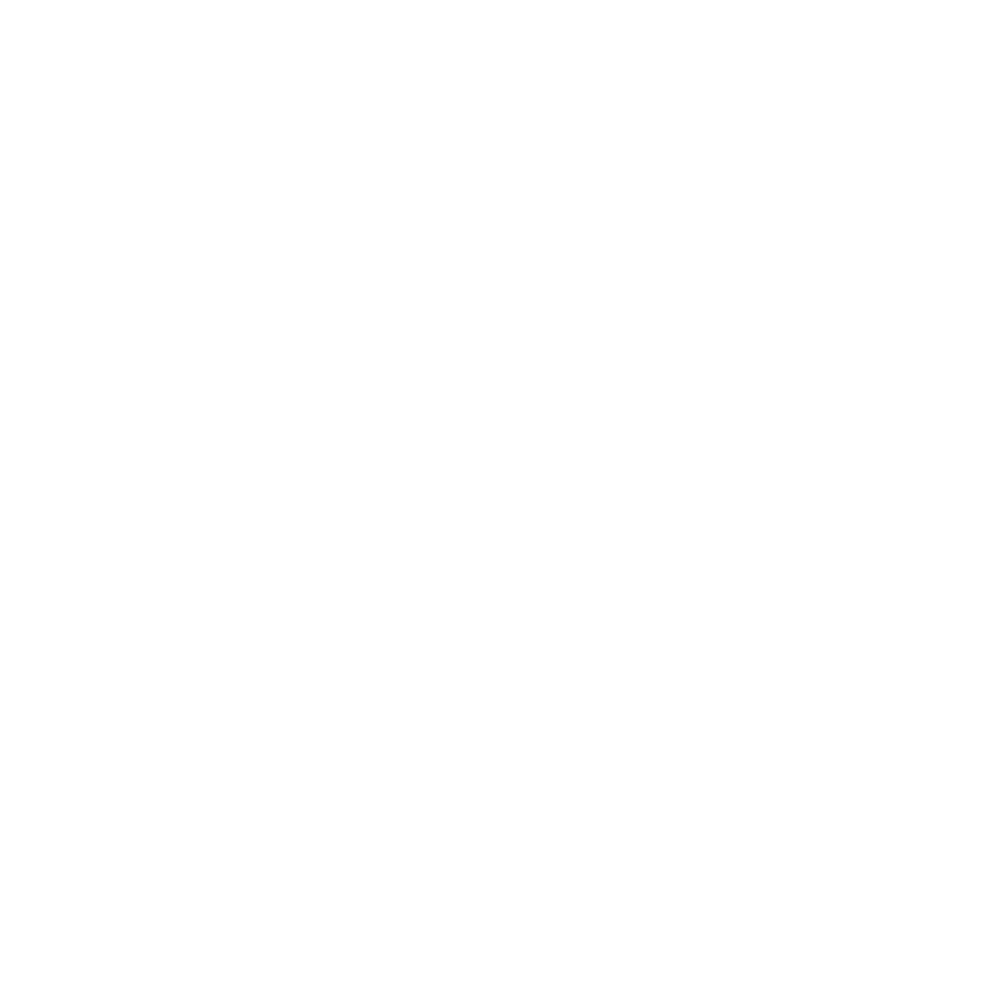

Drift correcting H5 on fov: Conv_zscan_03.tif
Fitting H5_750 on fov: Conv_zscan_03.tif


<IPython.core.display.Javascript object>


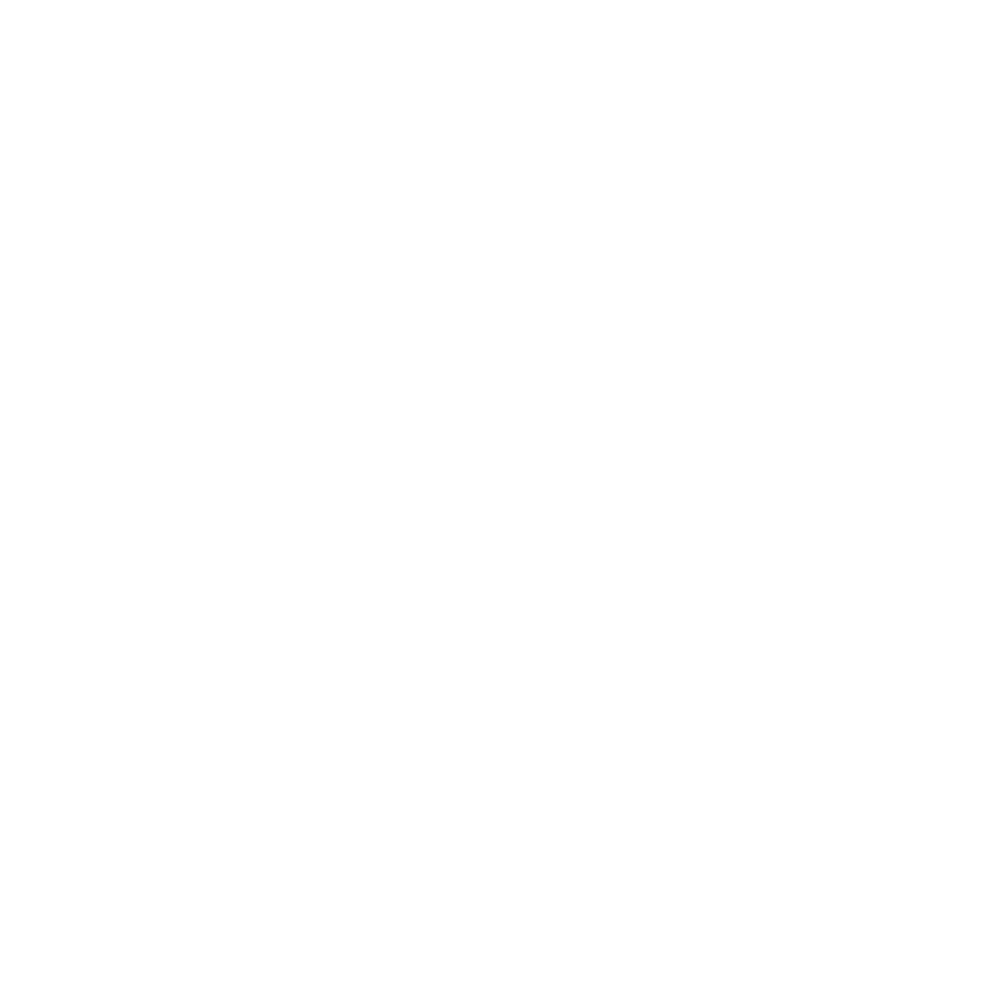

Fitting H5_647 on fov: Conv_zscan_03.tif


<IPython.core.display.Javascript object>


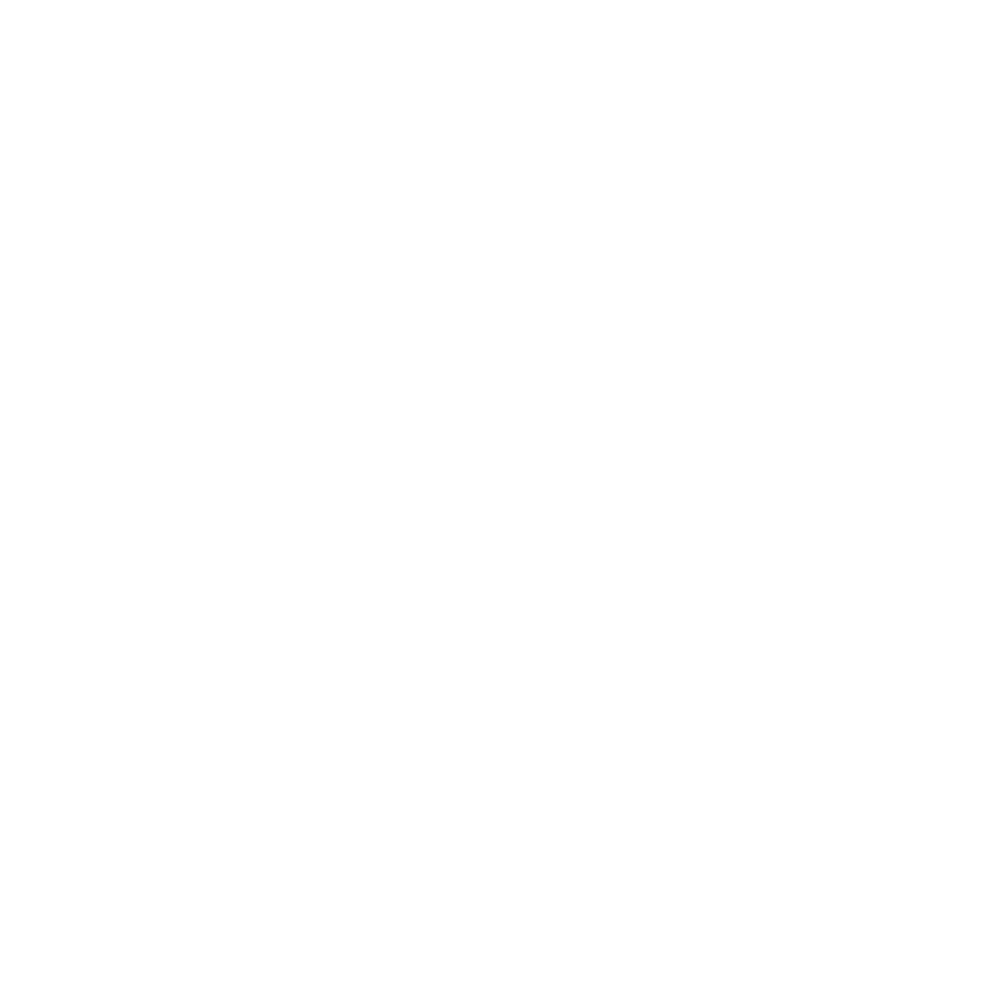

Drift correcting H6 on fov: Conv_zscan_03.tif
Fitting H6_750 on fov: Conv_zscan_03.tif


<IPython.core.display.Javascript object>


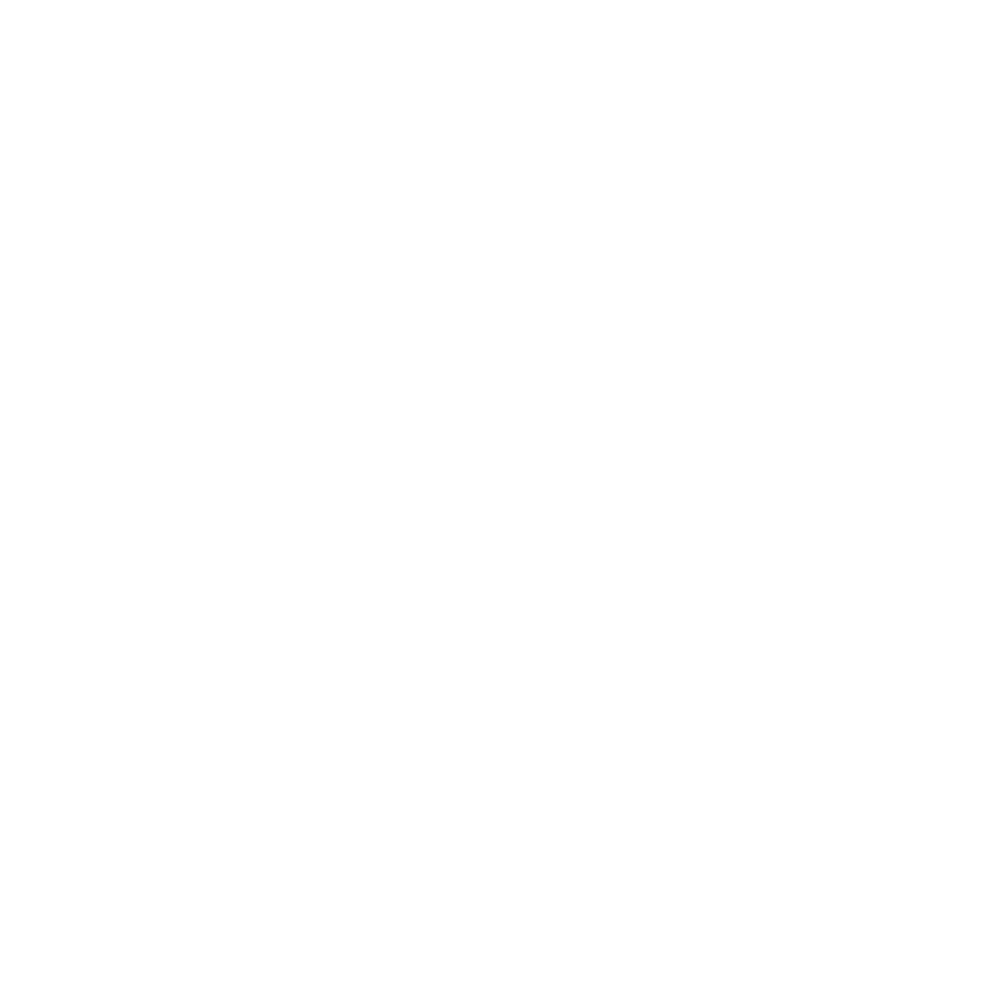

Fitting H6_647 on fov: Conv_zscan_03.tif


<IPython.core.display.Javascript object>


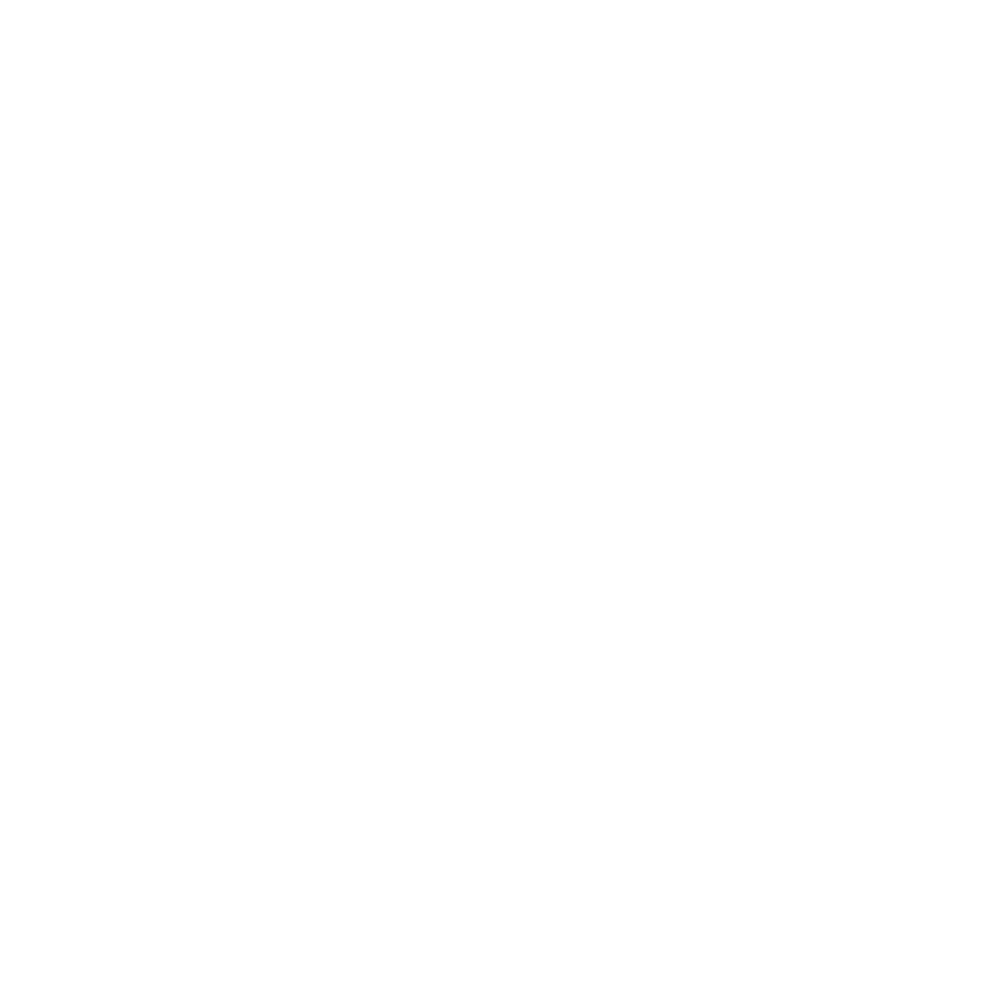

Estimating number of cells based on dapi image on fov: Conv_zscan_03.tif


<IPython.core.display.Javascript object>


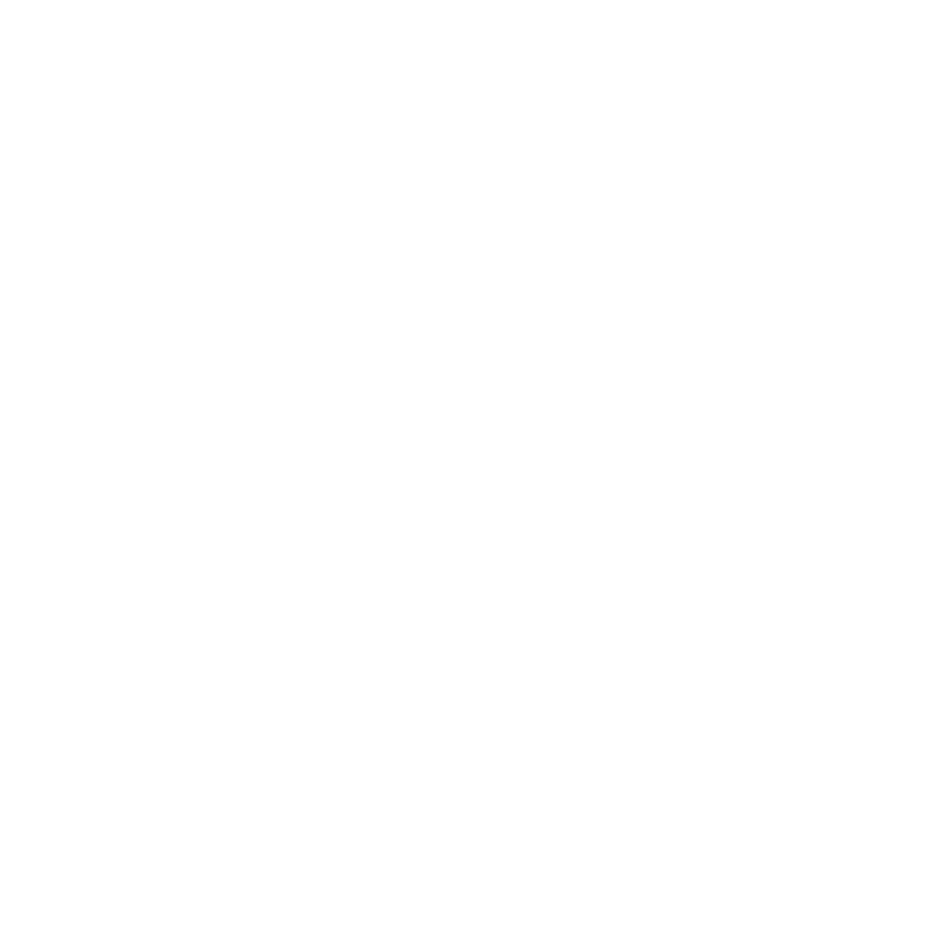

<ipython-input-27-1886a2f7fea2>:20: TqdmDeprecationWarning: This function will be removed in tqdm==5.0.0
Please use `tqdm.notebook.tqdm` instead of `tqdm.tqdm_notebook`
  for fld in tqdm(folders):



Drift correcting H1 on fov: Conv_zscan_04.tif
Fitting H1_750 on fov: Conv_zscan_04.tif


<IPython.core.display.Javascript object>


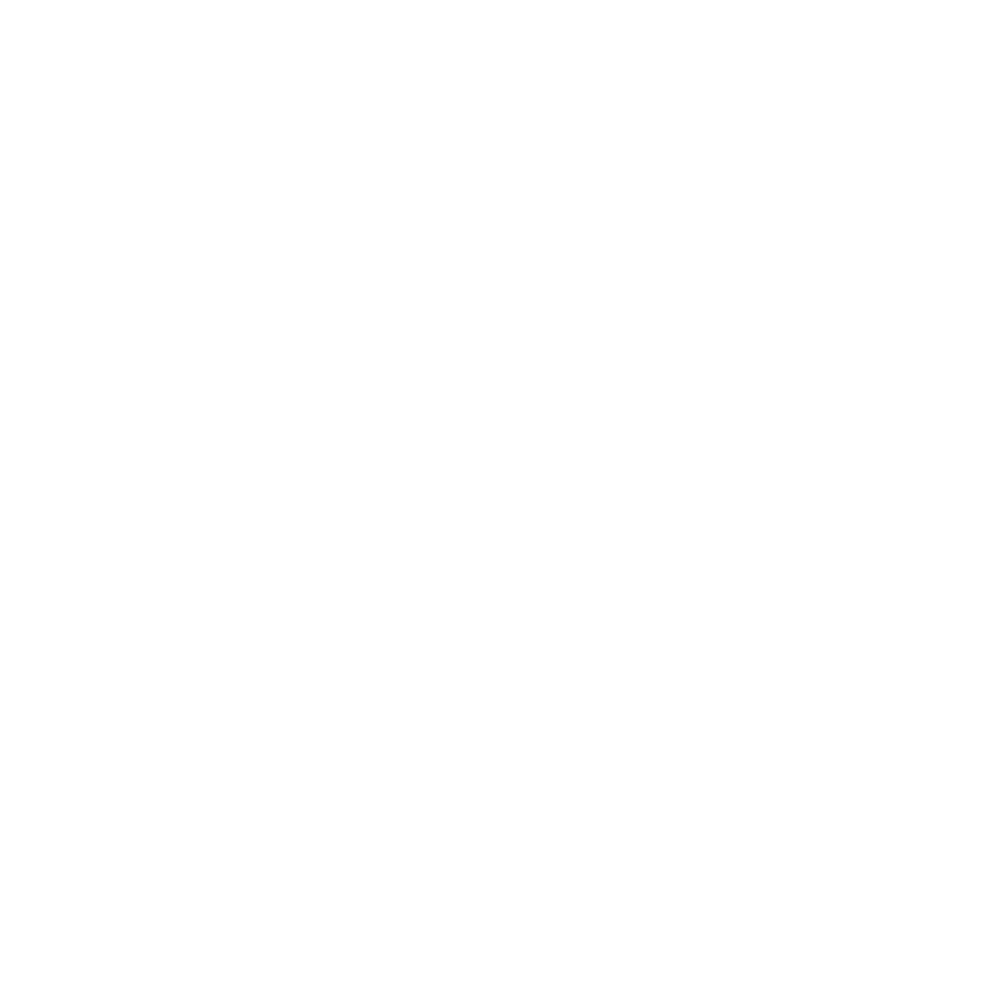

Fitting H1_647 on fov: Conv_zscan_04.tif


<IPython.core.display.Javascript object>


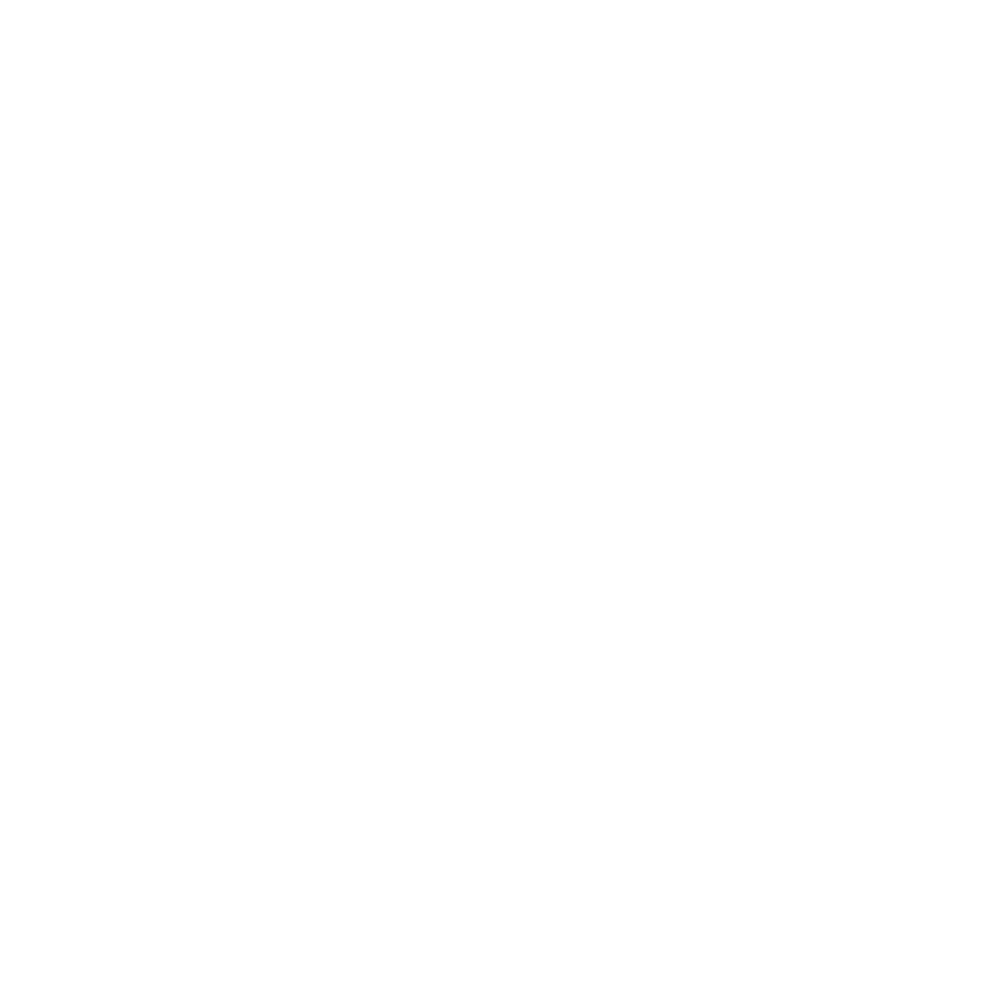

Drift correcting H2 on fov: Conv_zscan_04.tif
Fitting H2_750 on fov: Conv_zscan_04.tif


<IPython.core.display.Javascript object>


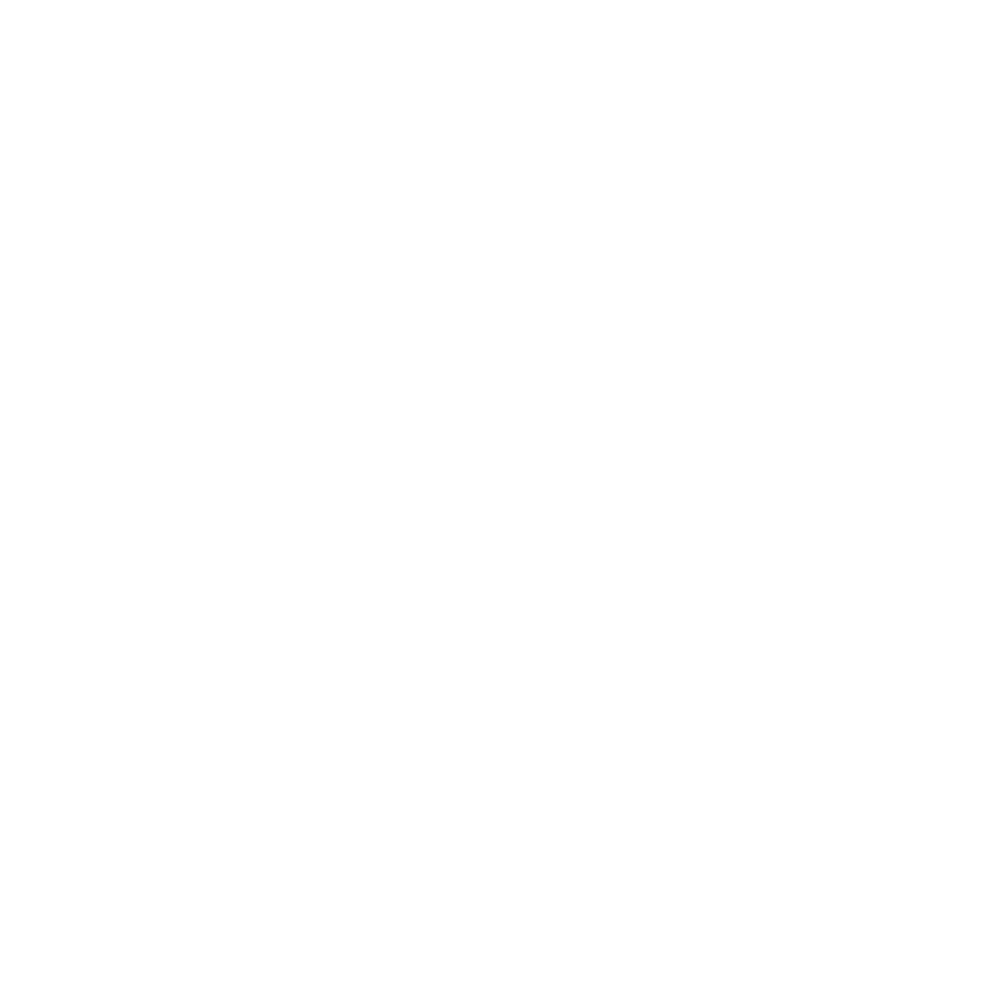

Fitting H2_647 on fov: Conv_zscan_04.tif


<IPython.core.display.Javascript object>


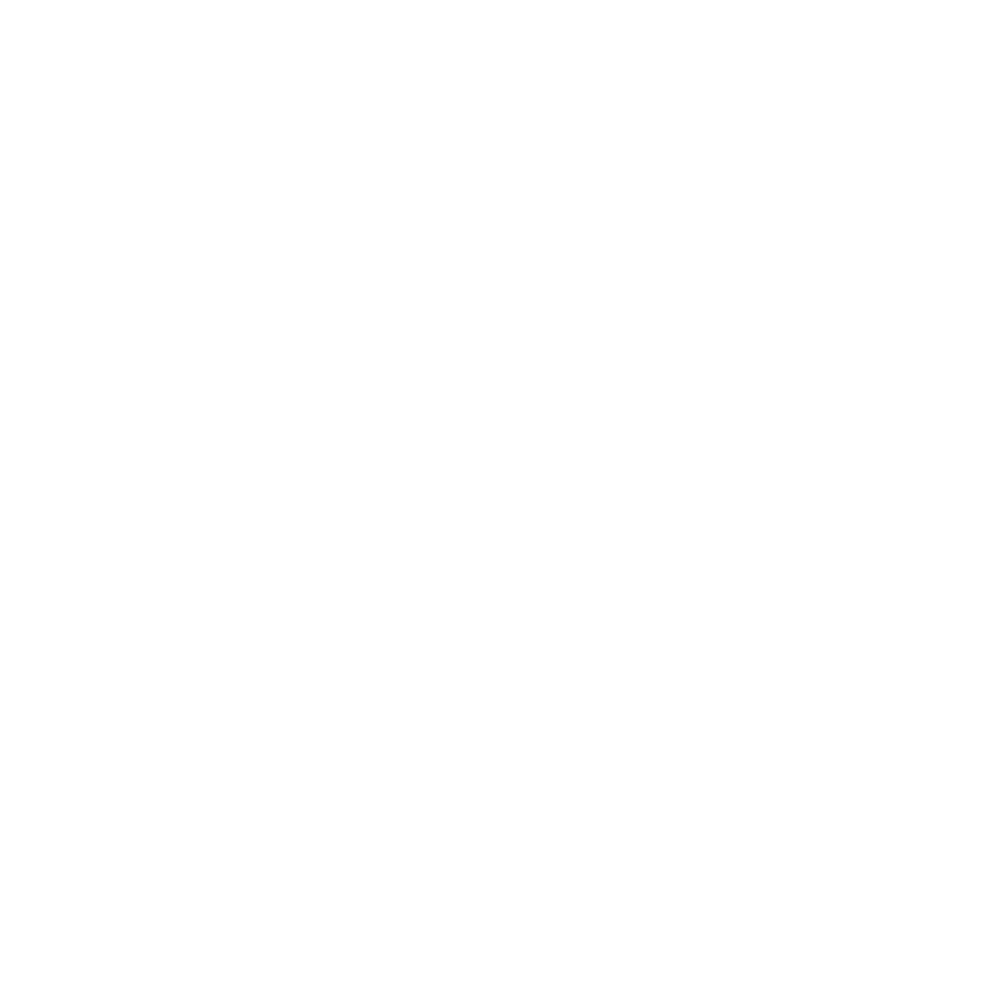

Drift correcting H3 on fov: Conv_zscan_04.tif
Fitting H3_750 on fov: Conv_zscan_04.tif


<IPython.core.display.Javascript object>


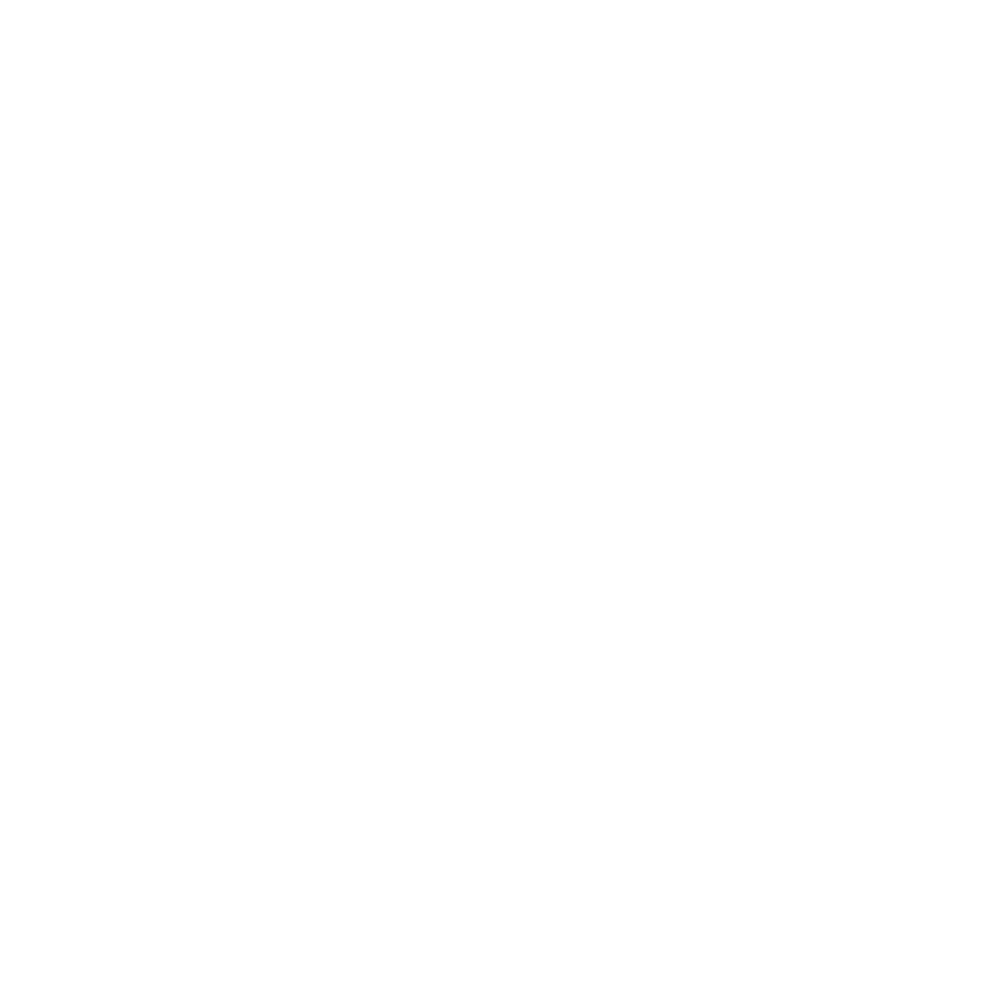

Fitting H3_647 on fov: Conv_zscan_04.tif


<IPython.core.display.Javascript object>


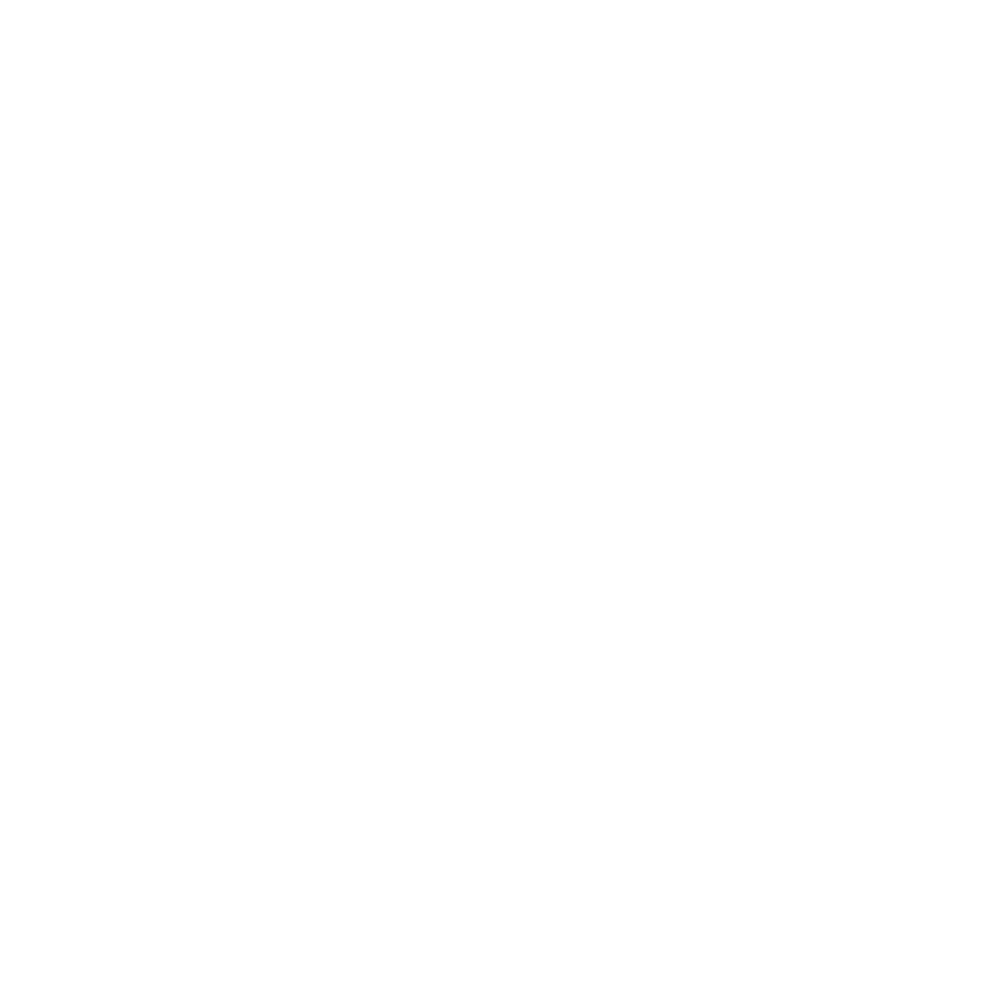

Drift correcting H4 on fov: Conv_zscan_04.tif
Fitting H4_750 on fov: Conv_zscan_04.tif


<IPython.core.display.Javascript object>


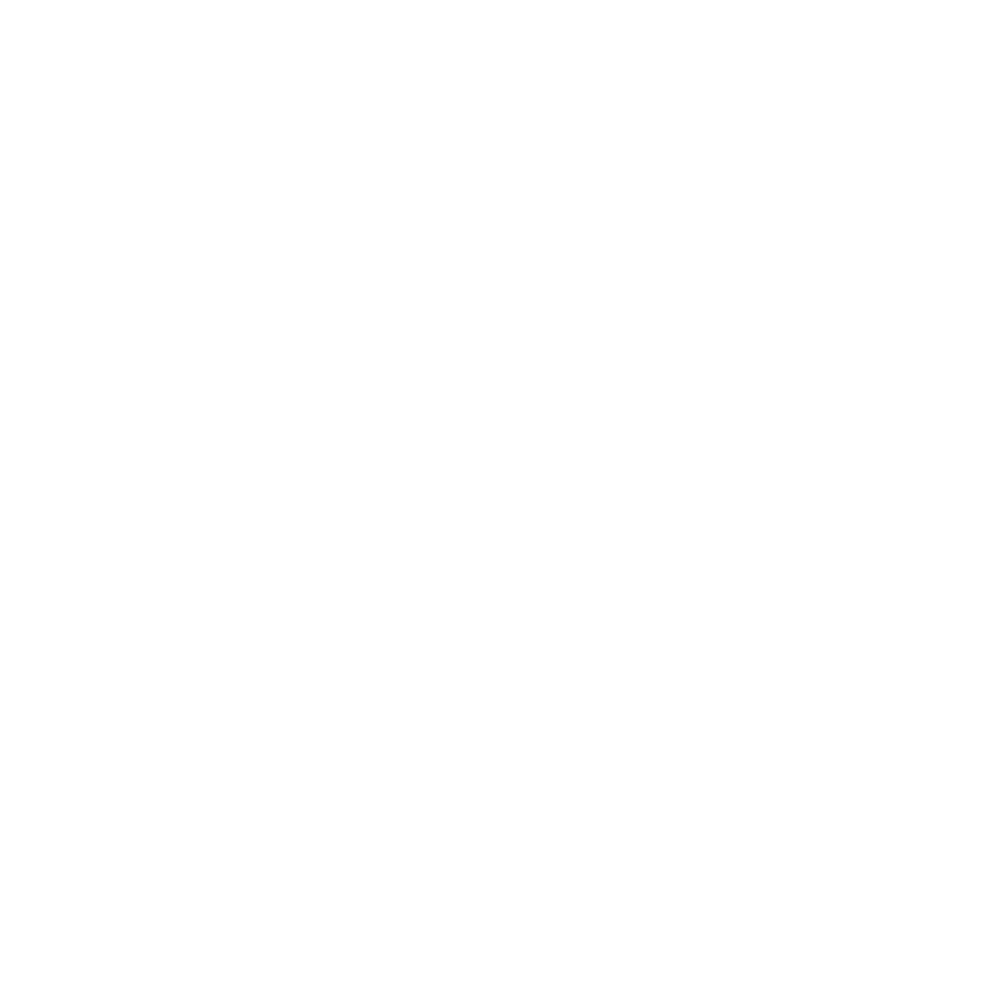

Fitting H4_647 on fov: Conv_zscan_04.tif


<IPython.core.display.Javascript object>


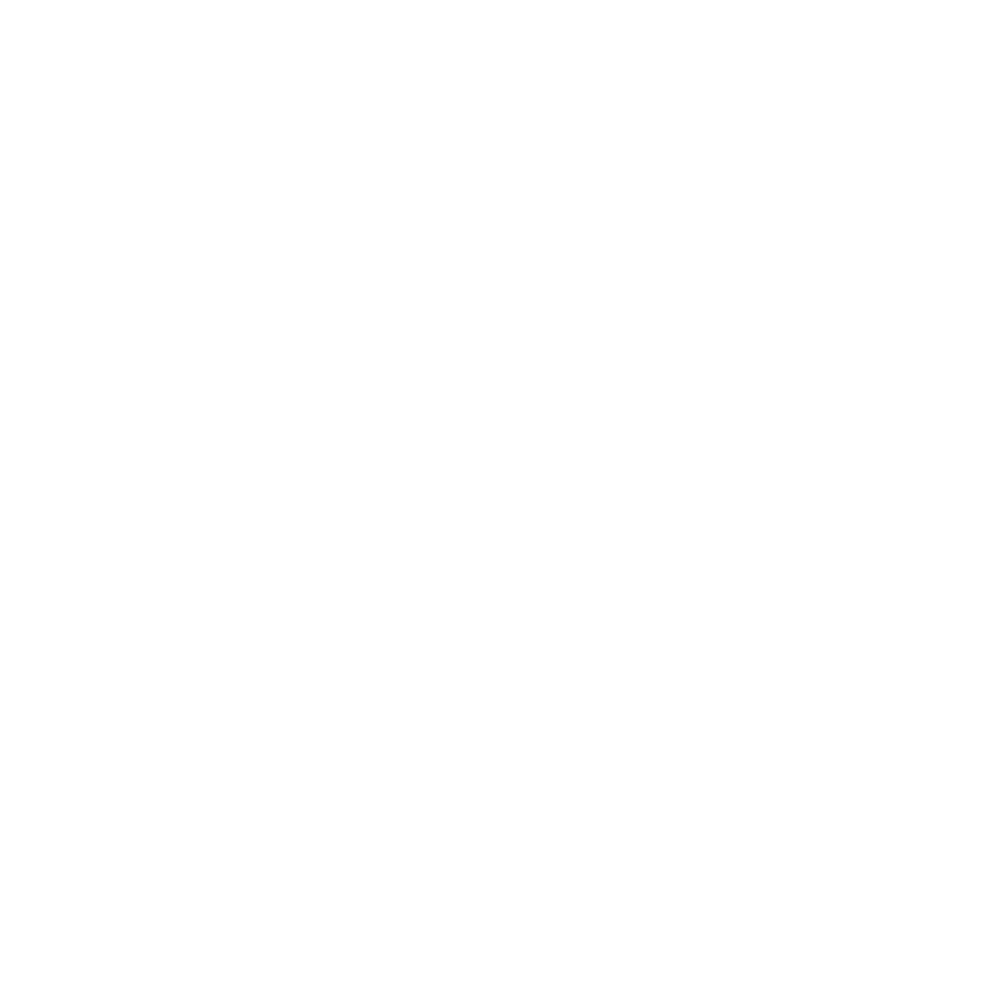

Drift correcting H5 on fov: Conv_zscan_04.tif
Fitting H5_750 on fov: Conv_zscan_04.tif


<IPython.core.display.Javascript object>


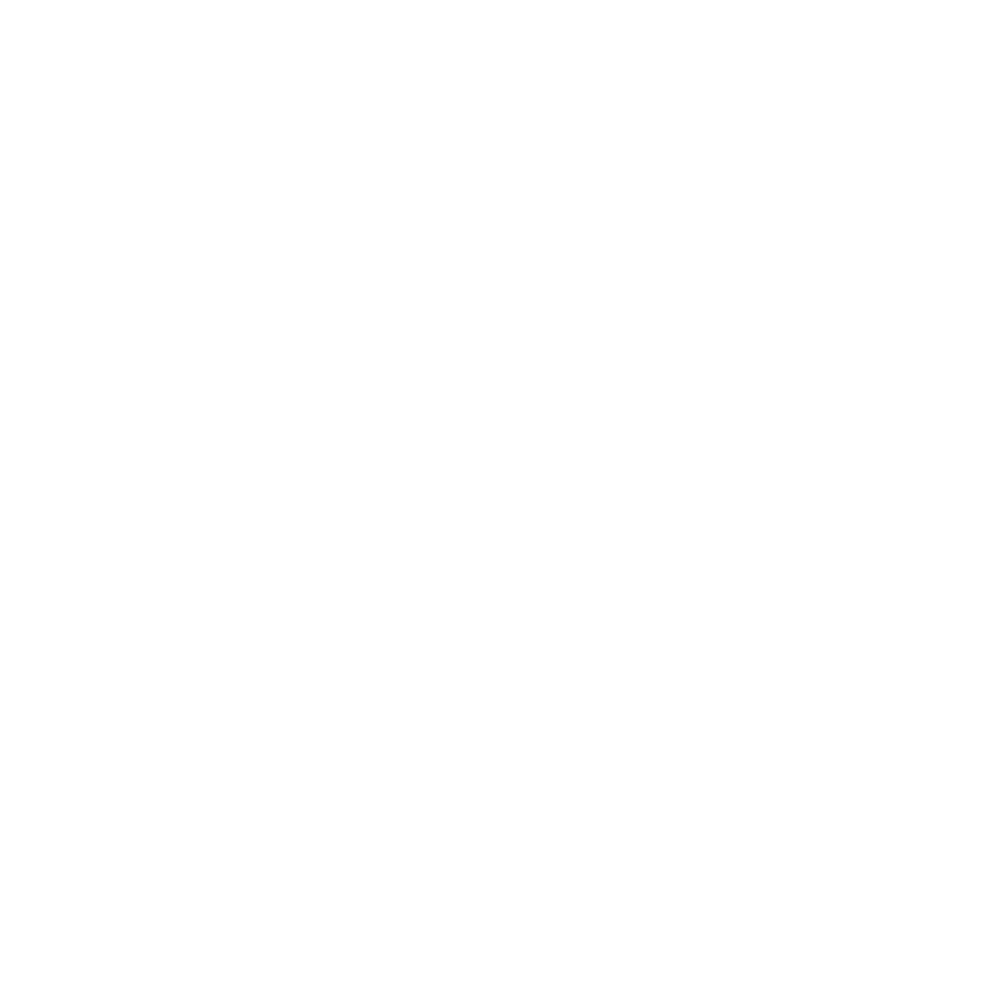

Fitting H5_647 on fov: Conv_zscan_04.tif


<IPython.core.display.Javascript object>


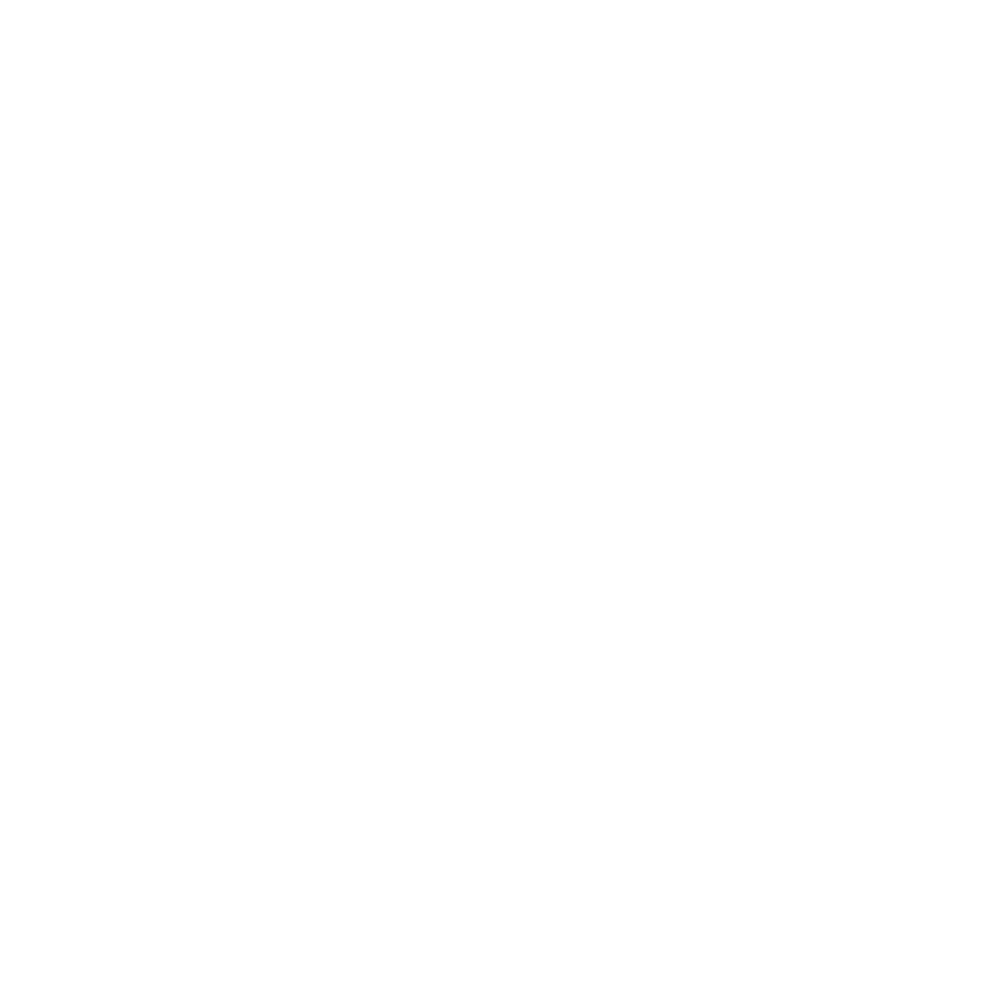

Drift correcting H6 on fov: Conv_zscan_04.tif
Fitting H6_750 on fov: Conv_zscan_04.tif


<IPython.core.display.Javascript object>


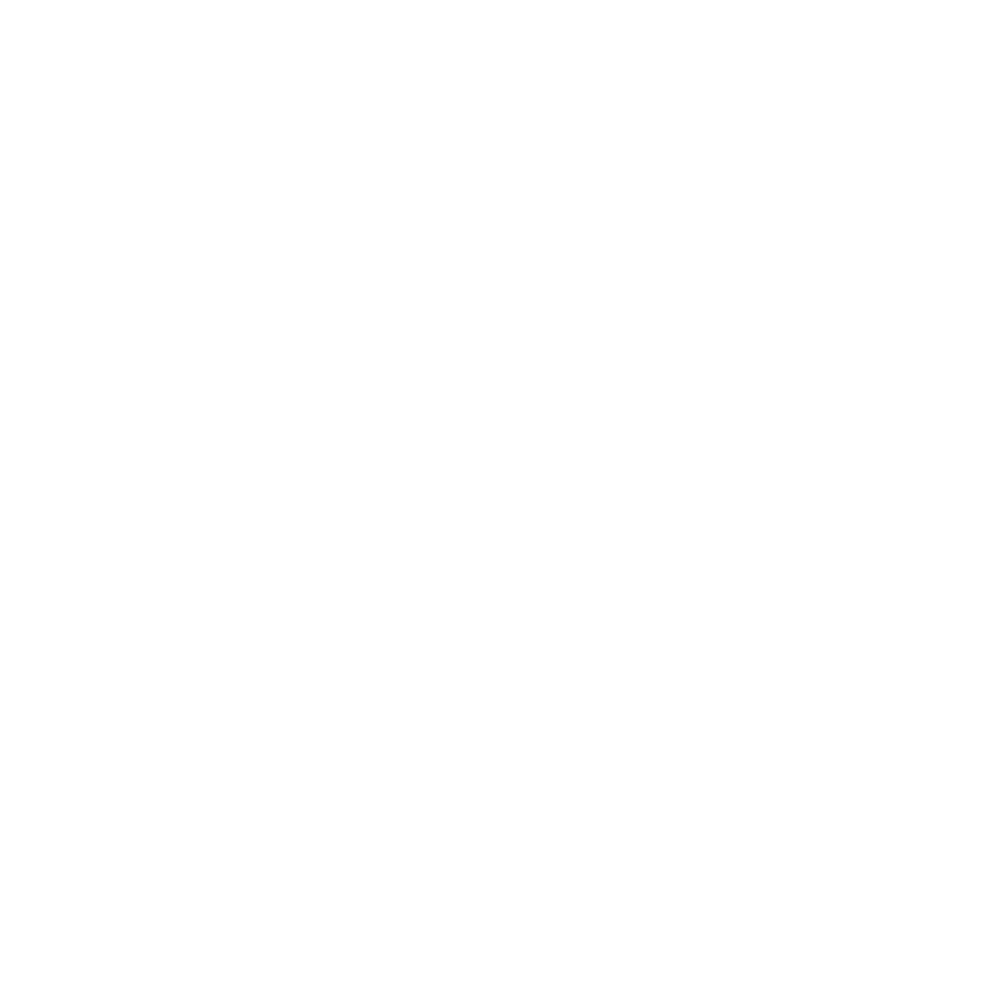

Fitting H6_647 on fov: Conv_zscan_04.tif


<IPython.core.display.Javascript object>


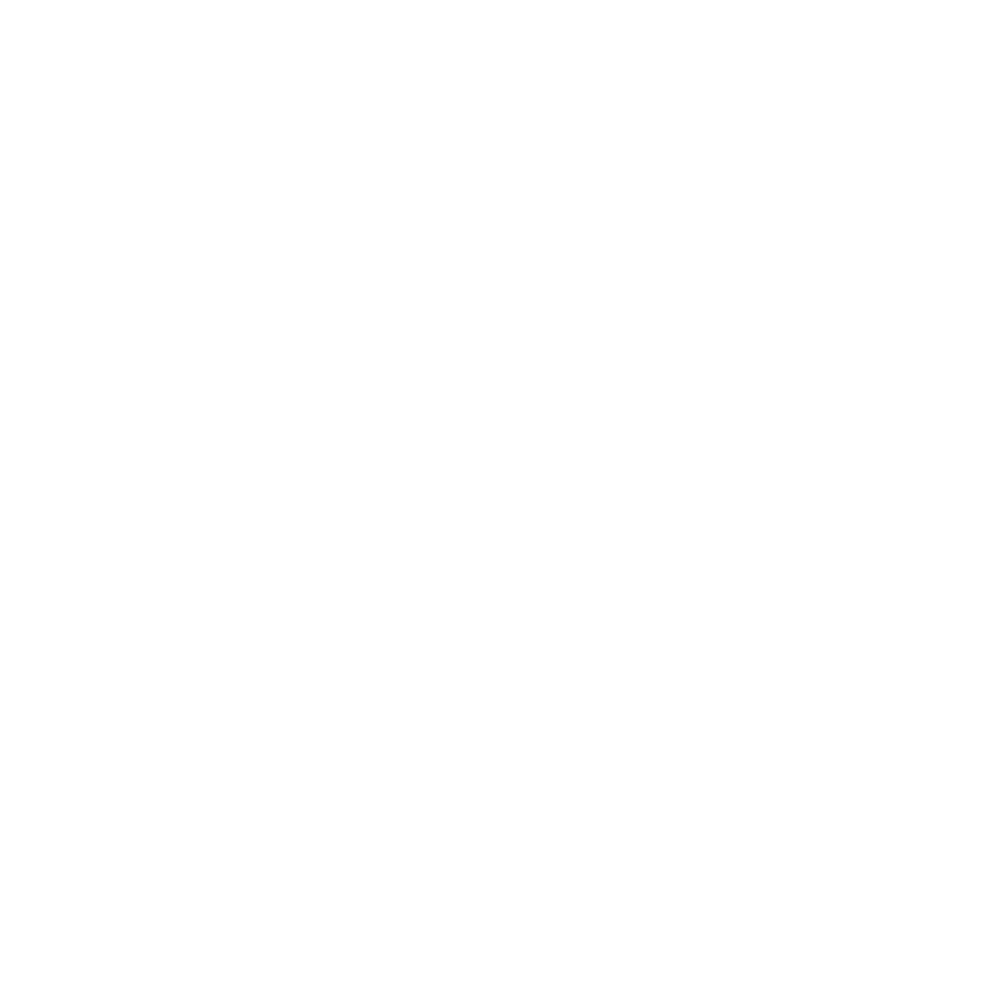

Estimating number of cells based on dapi image on fov: Conv_zscan_04.tif


<IPython.core.display.Javascript object>


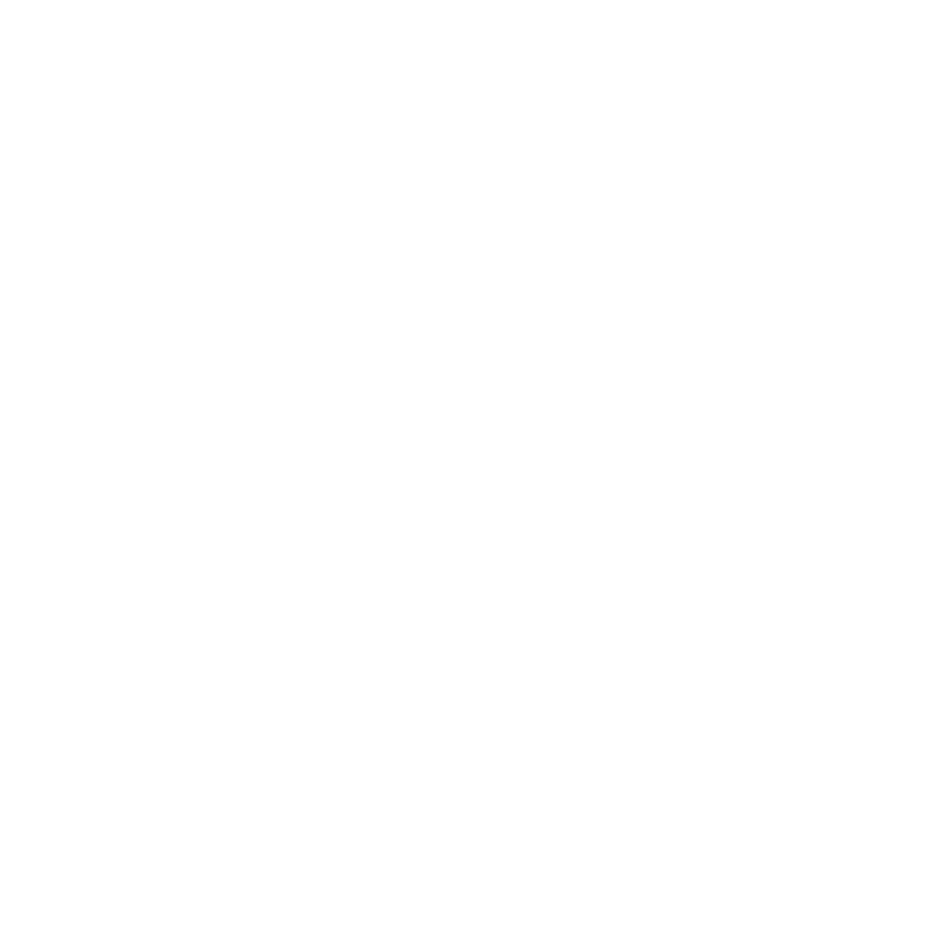

<ipython-input-27-1886a2f7fea2>:20: TqdmDeprecationWarning: This function will be removed in tqdm==5.0.0
Please use `tqdm.notebook.tqdm` instead of `tqdm.tqdm_notebook`
  for fld in tqdm(folders):



Drift correcting H1 on fov: Conv_zscan_05.tif
Fitting H1_750 on fov: Conv_zscan_05.tif


<IPython.core.display.Javascript object>


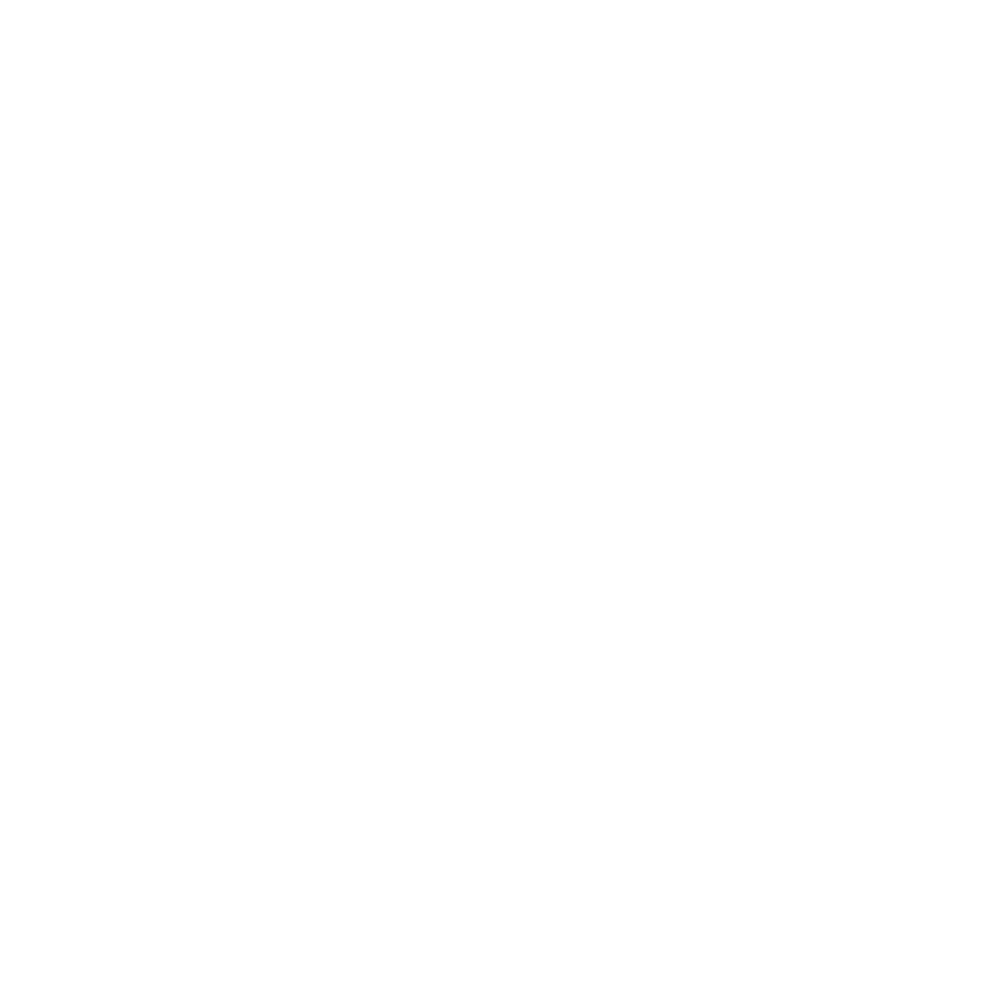

Fitting H1_647 on fov: Conv_zscan_05.tif


<IPython.core.display.Javascript object>


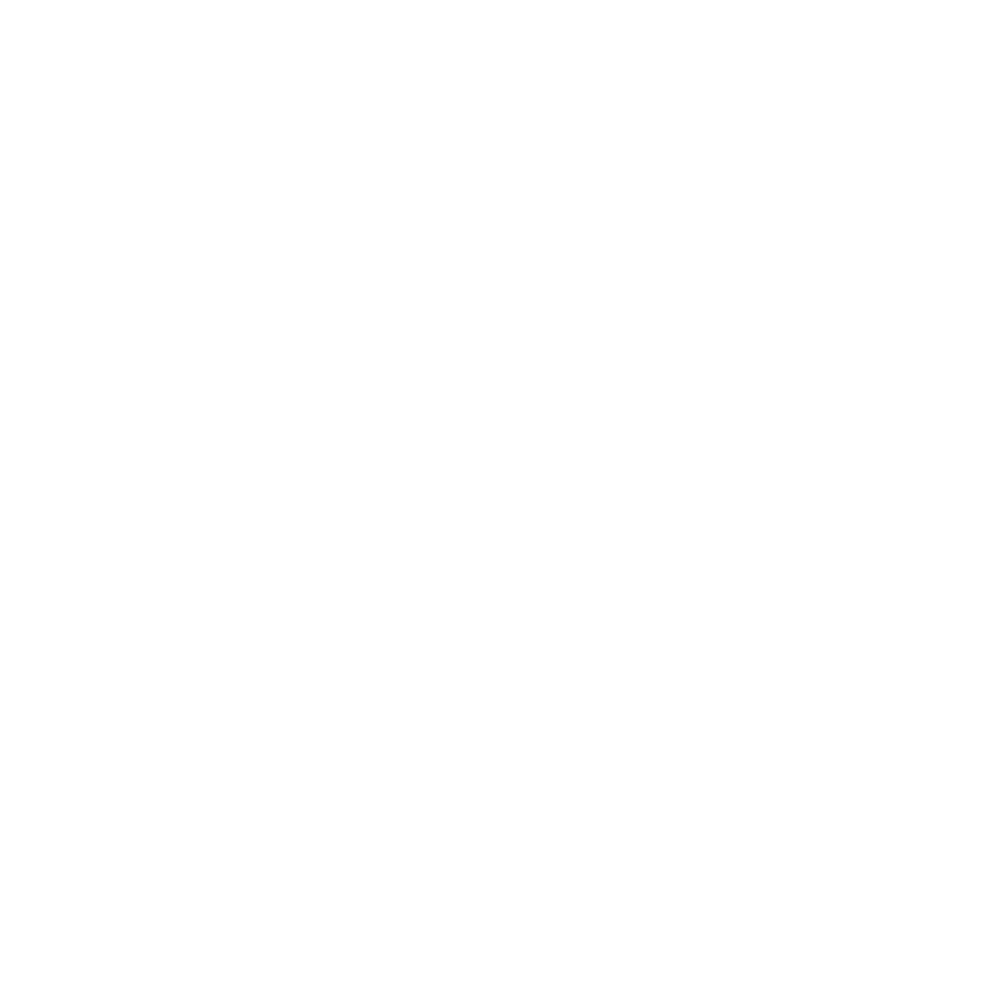

Drift correcting H2 on fov: Conv_zscan_05.tif
Fitting H2_750 on fov: Conv_zscan_05.tif


<IPython.core.display.Javascript object>


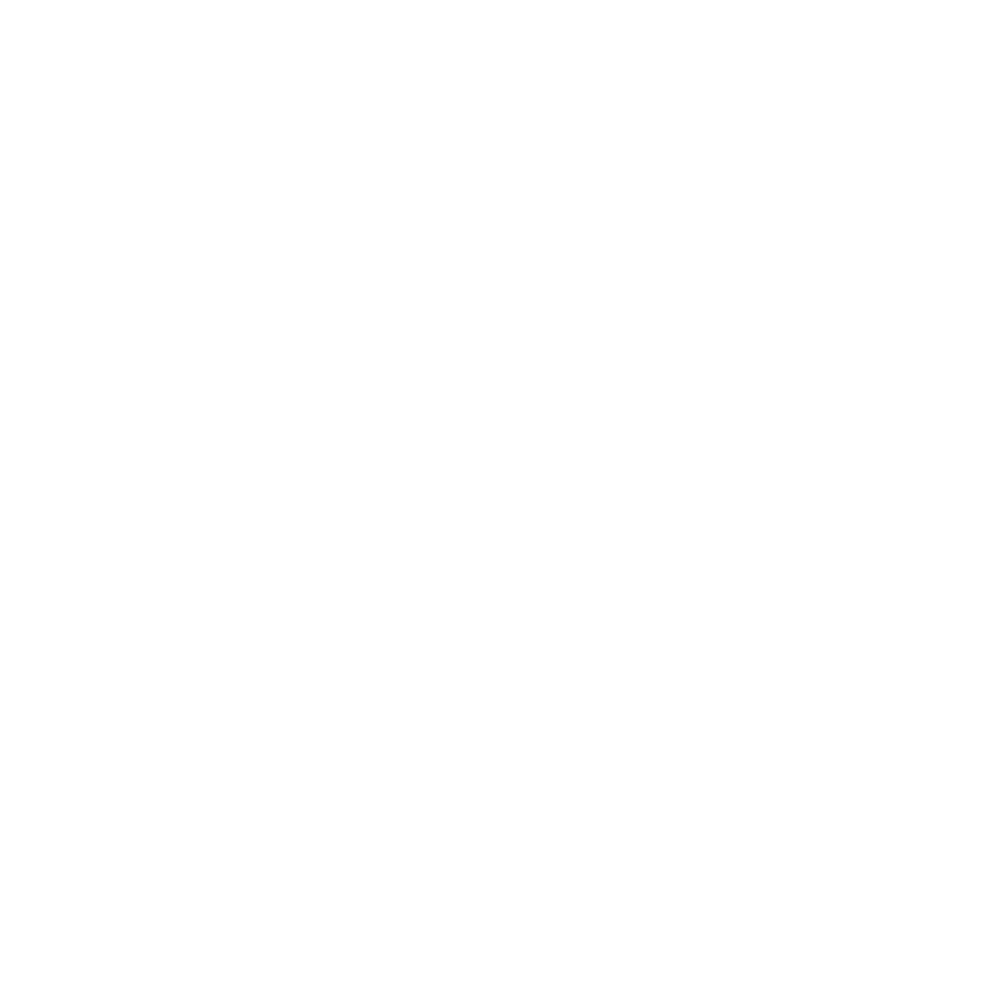

Fitting H2_647 on fov: Conv_zscan_05.tif


<IPython.core.display.Javascript object>


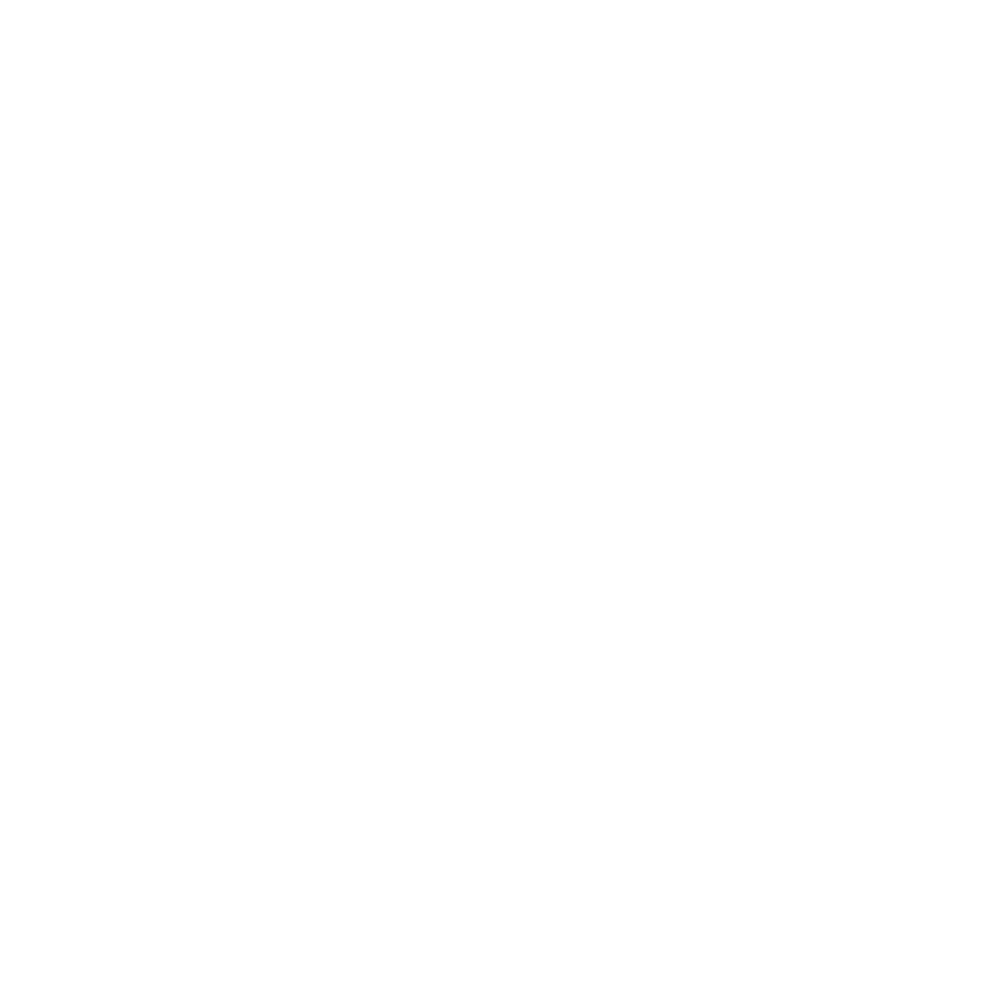

Drift correcting H3 on fov: Conv_zscan_05.tif
Fitting H3_750 on fov: Conv_zscan_05.tif


<IPython.core.display.Javascript object>


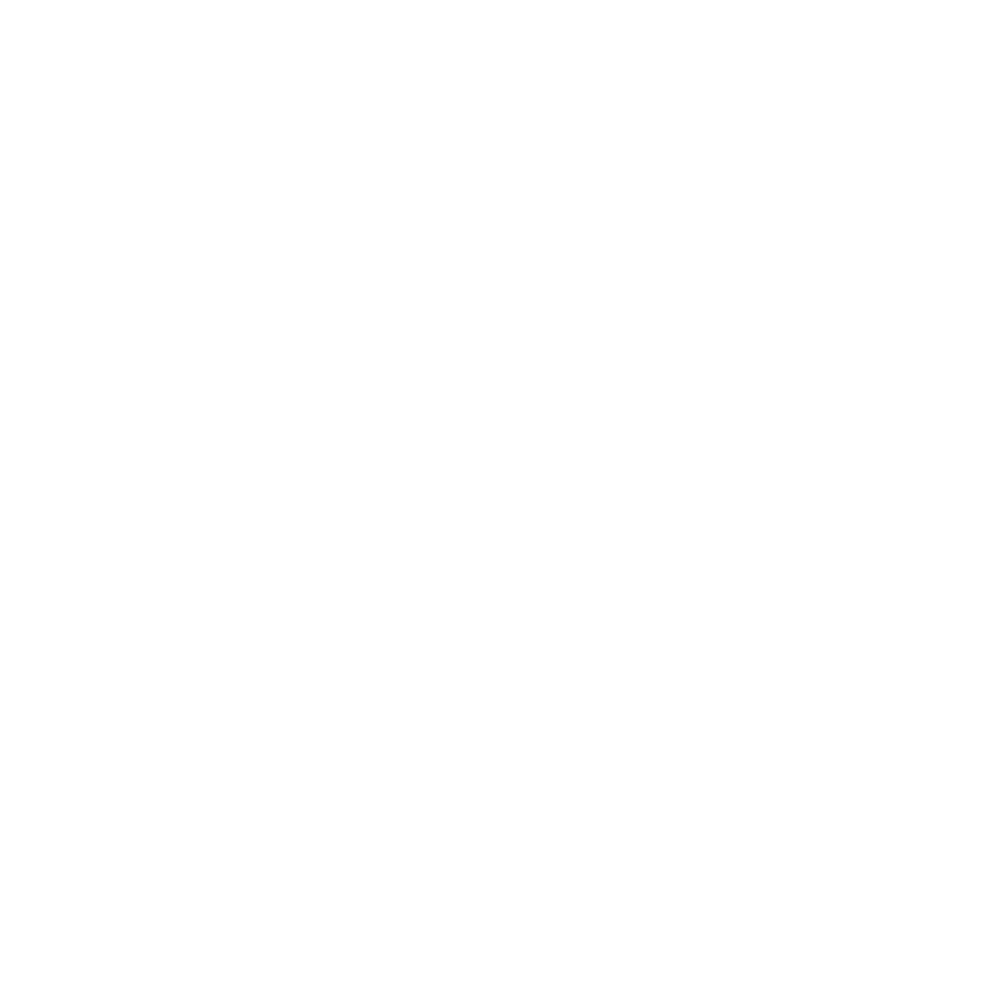

Fitting H3_647 on fov: Conv_zscan_05.tif


<IPython.core.display.Javascript object>


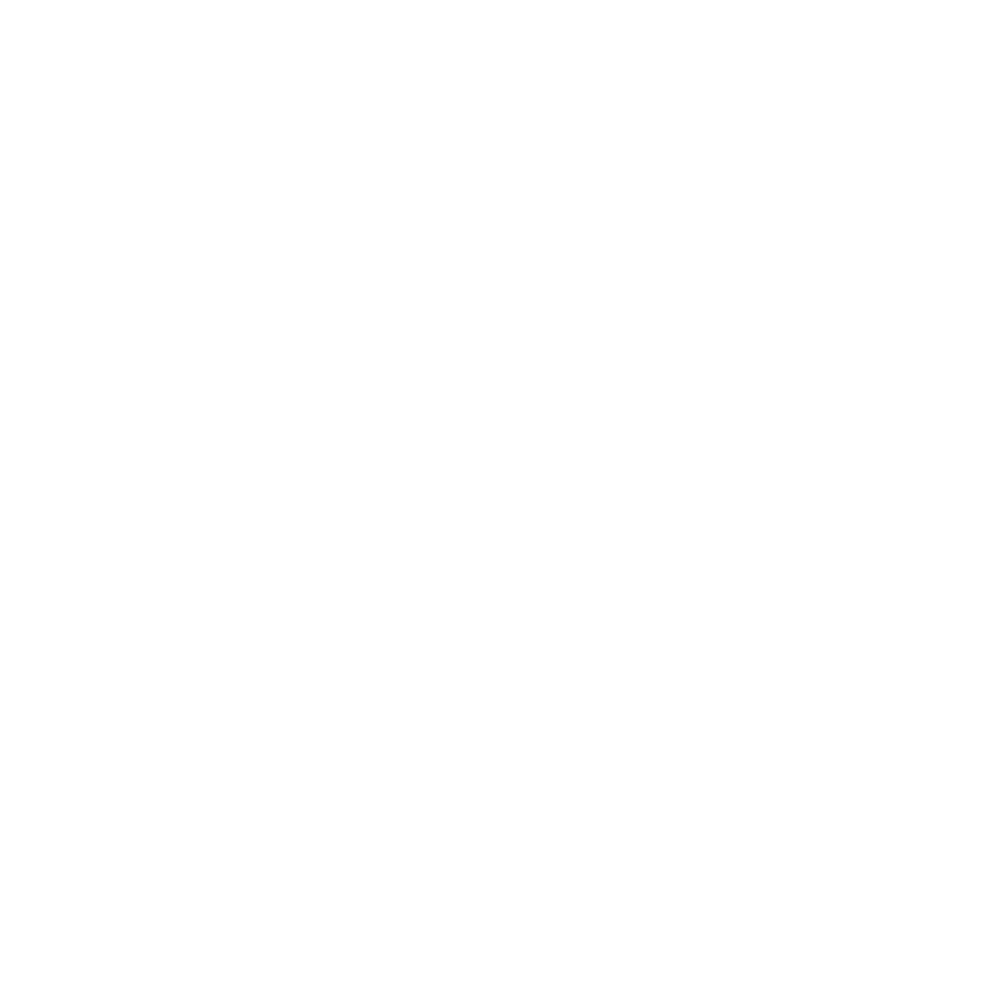

Drift correcting H4 on fov: Conv_zscan_05.tif
Fitting H4_750 on fov: Conv_zscan_05.tif


<IPython.core.display.Javascript object>


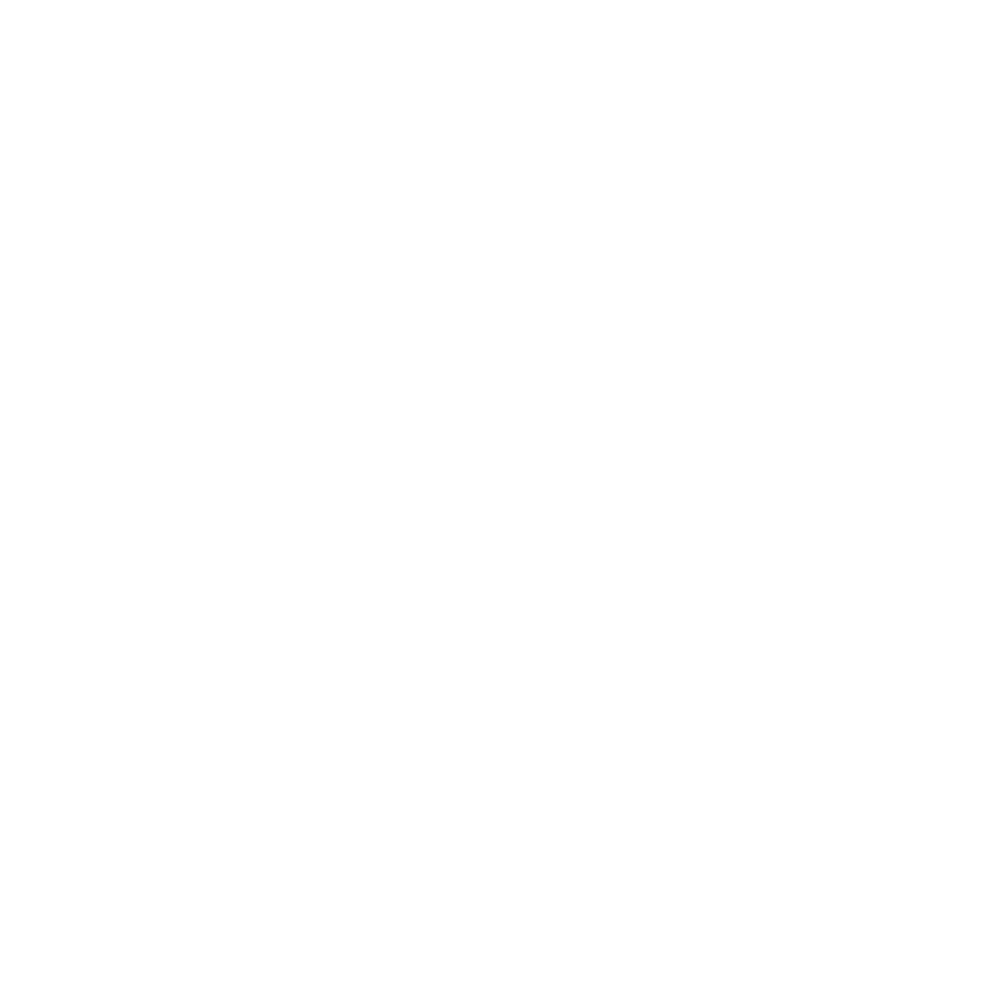

Fitting H4_647 on fov: Conv_zscan_05.tif


<IPython.core.display.Javascript object>


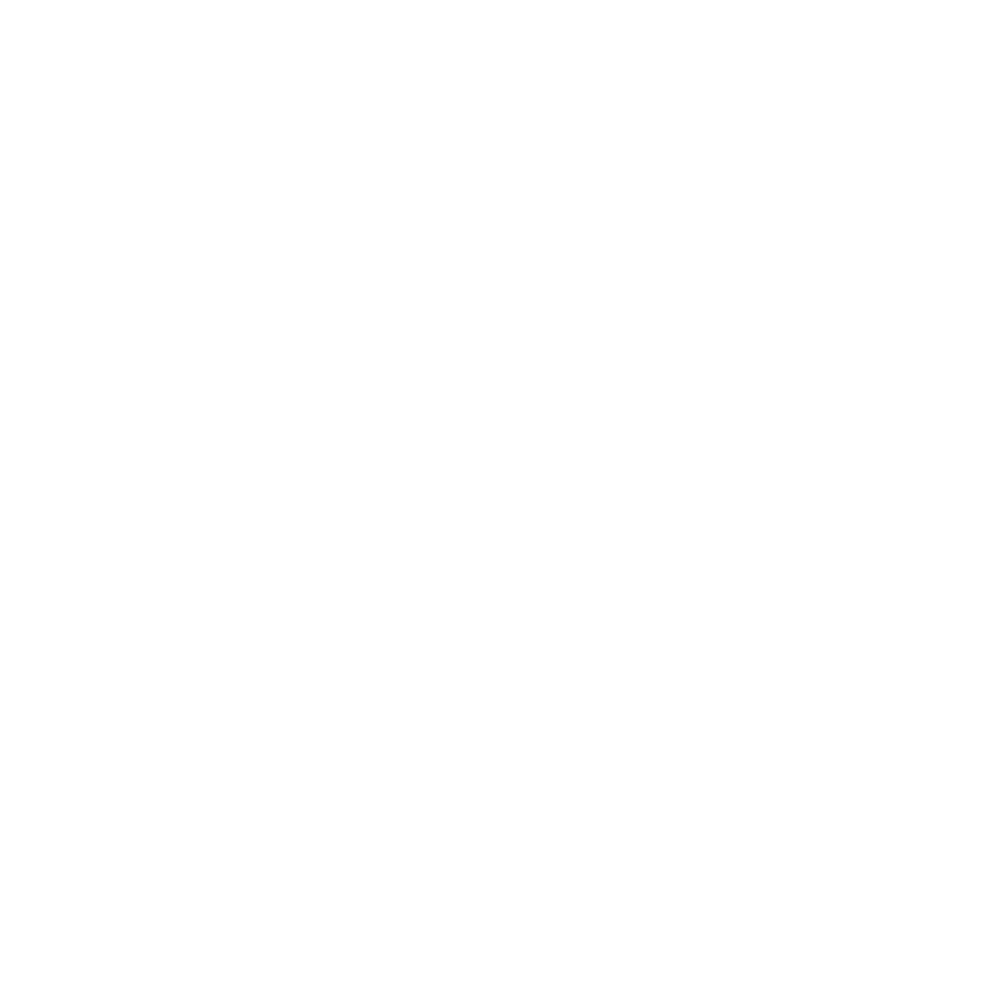

Drift correcting H5 on fov: Conv_zscan_05.tif
Fitting H5_750 on fov: Conv_zscan_05.tif


<IPython.core.display.Javascript object>


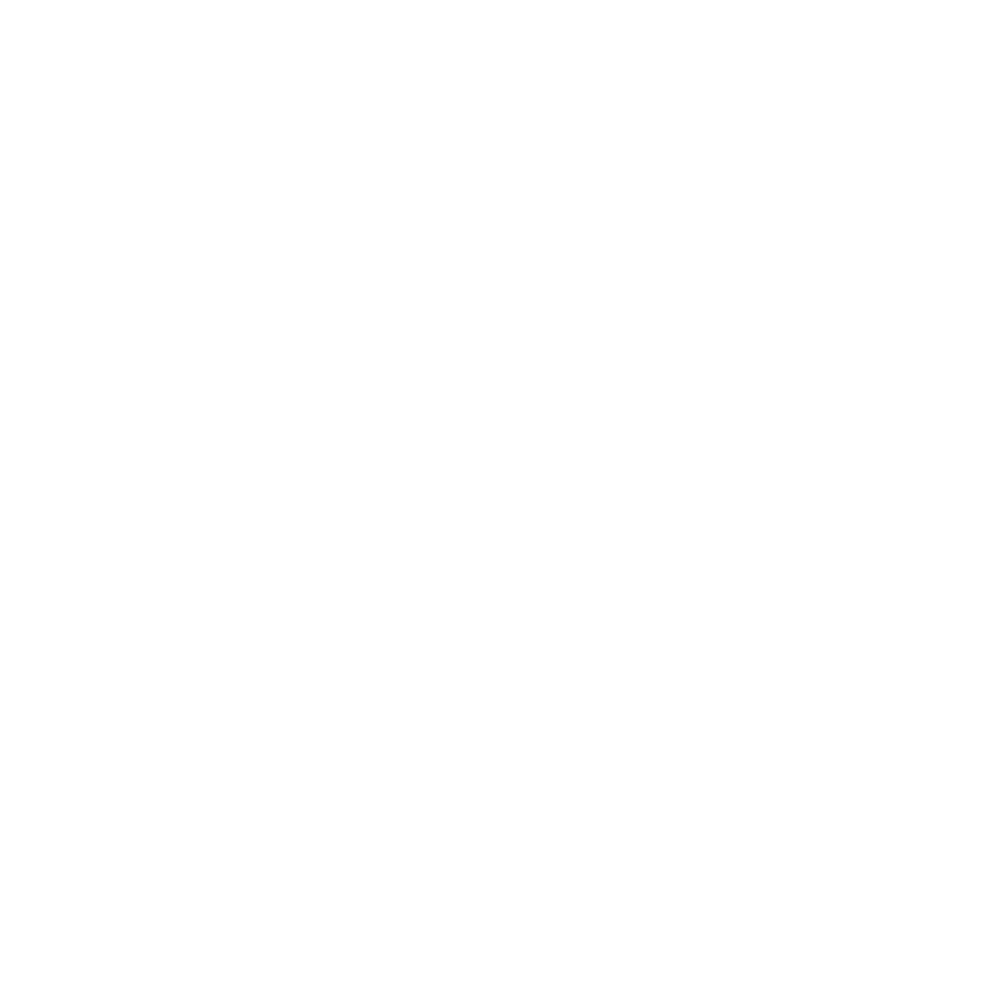

Fitting H5_647 on fov: Conv_zscan_05.tif


<IPython.core.display.Javascript object>


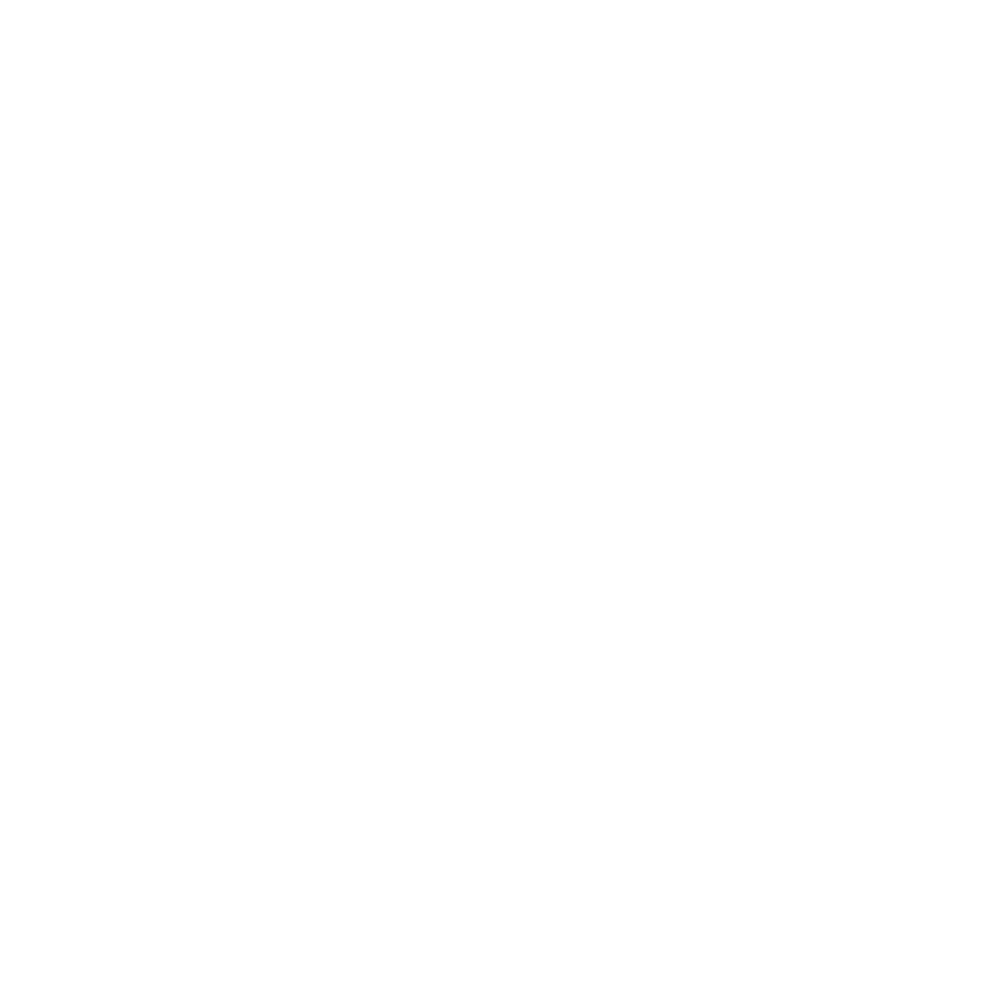

Drift correcting H6 on fov: Conv_zscan_05.tif
Fitting H6_750 on fov: Conv_zscan_05.tif


<IPython.core.display.Javascript object>


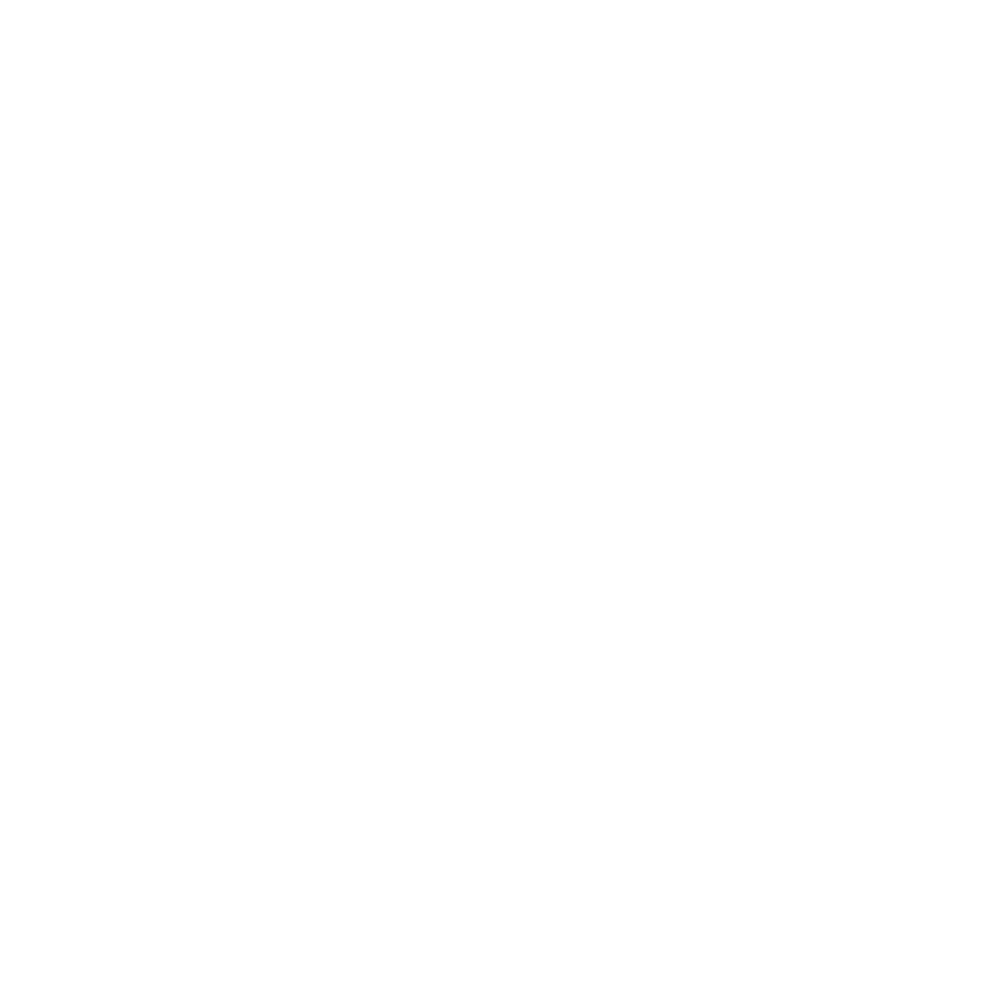

Fitting H6_647 on fov: Conv_zscan_05.tif


<IPython.core.display.Javascript object>


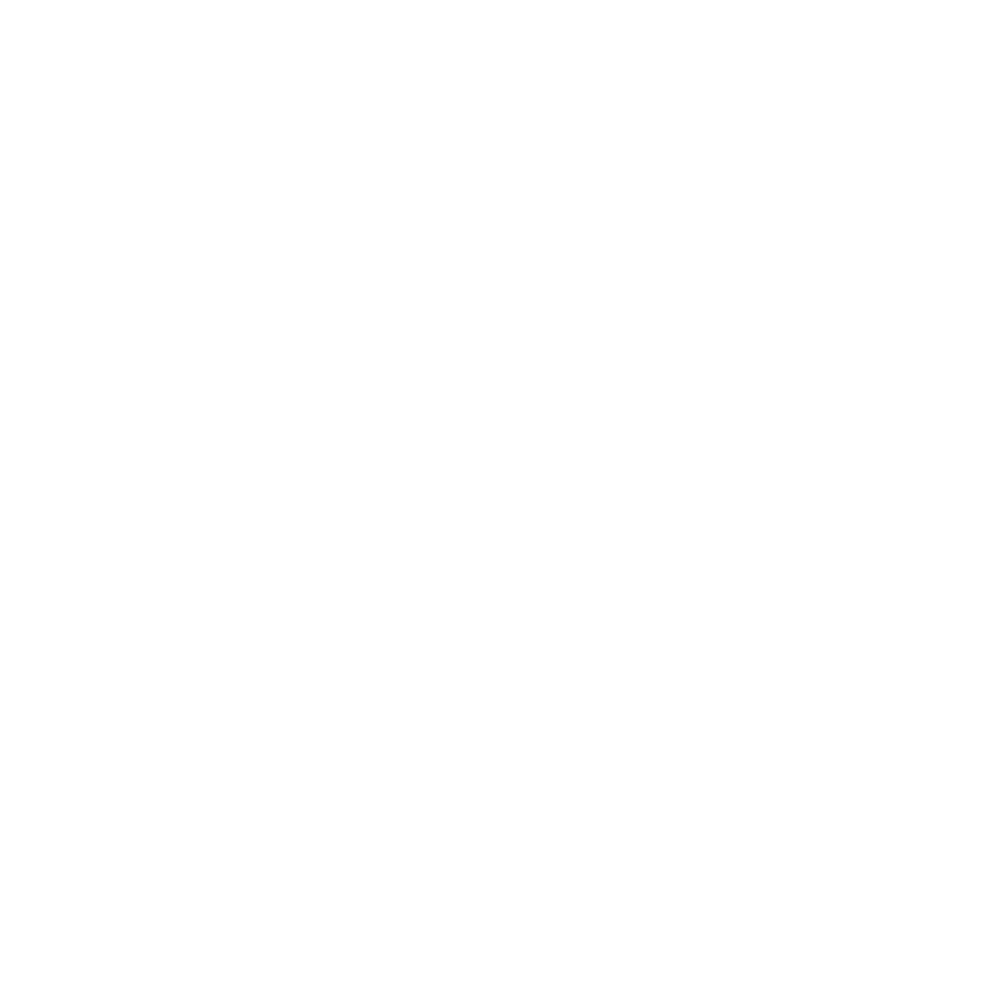

Estimating number of cells based on dapi image on fov: Conv_zscan_05.tif


<IPython.core.display.Javascript object>


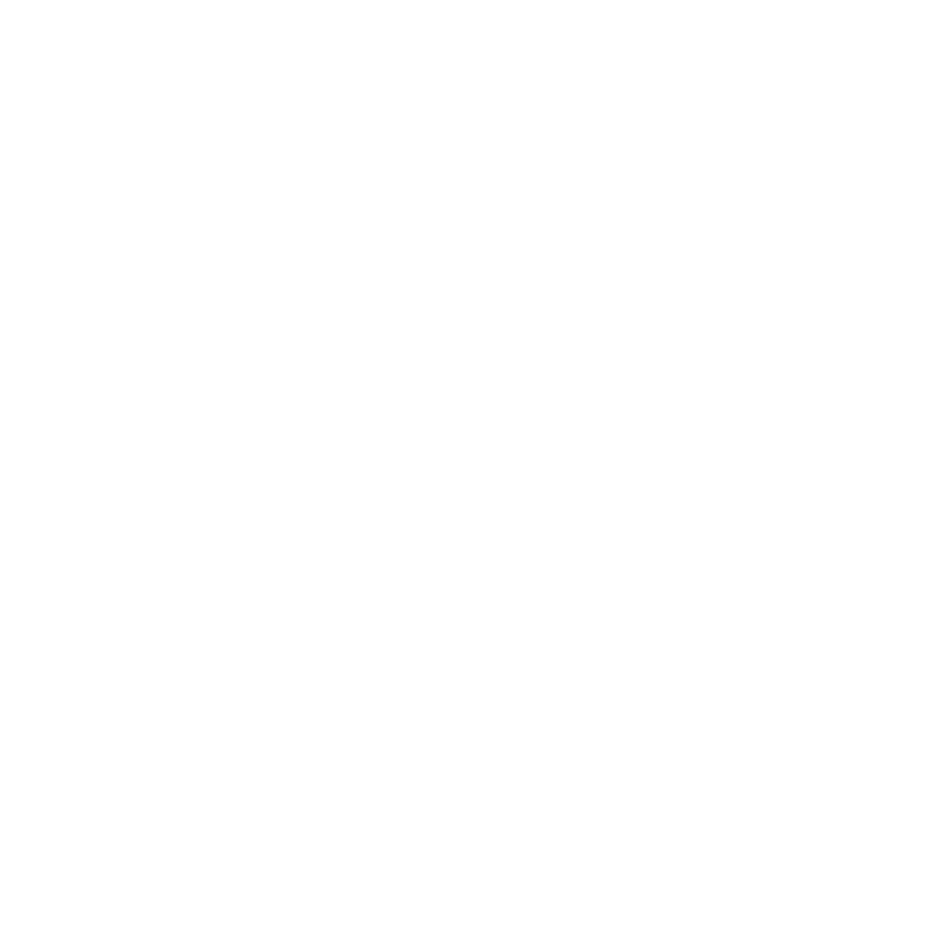

<ipython-input-27-1886a2f7fea2>:20: TqdmDeprecationWarning: This function will be removed in tqdm==5.0.0
Please use `tqdm.notebook.tqdm` instead of `tqdm.tqdm_notebook`
  for fld in tqdm(folders):



Drift correcting H1 on fov: Conv_zscan_06.tif
Fitting H1_750 on fov: Conv_zscan_06.tif


<IPython.core.display.Javascript object>


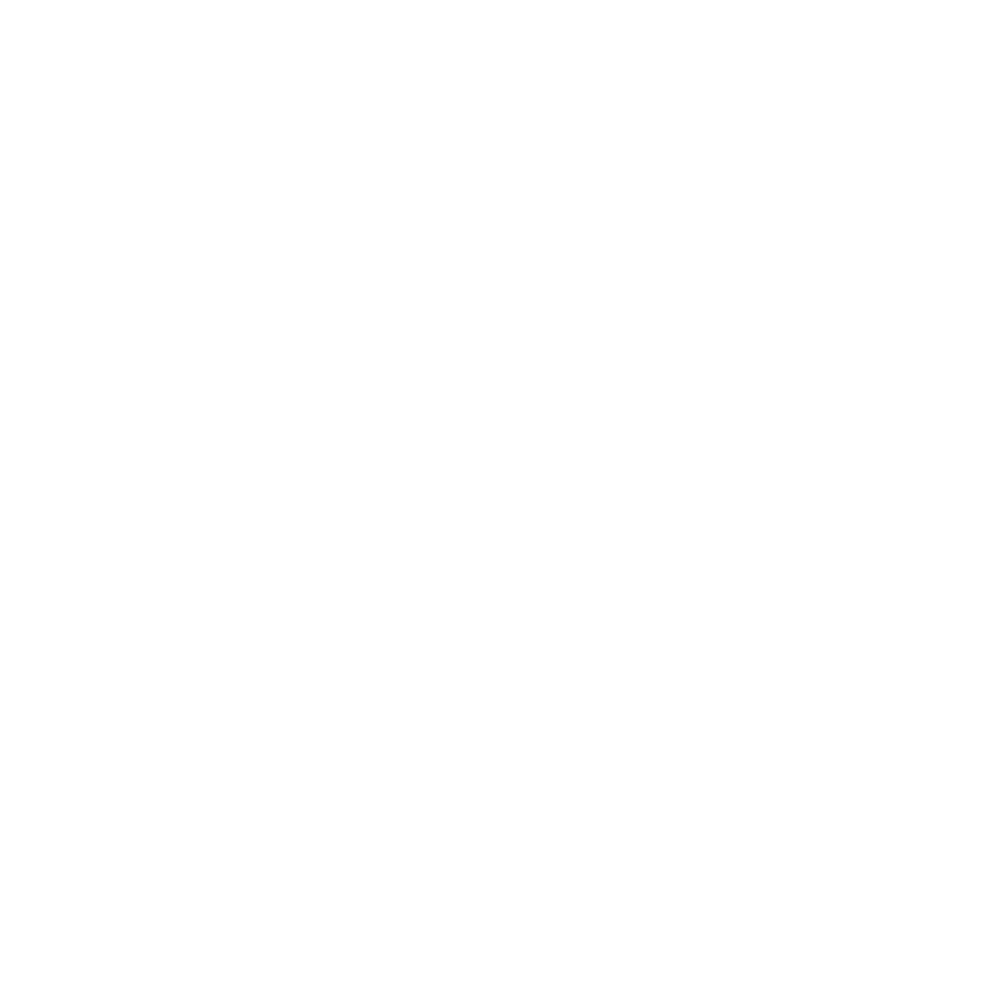

Fitting H1_647 on fov: Conv_zscan_06.tif


<IPython.core.display.Javascript object>


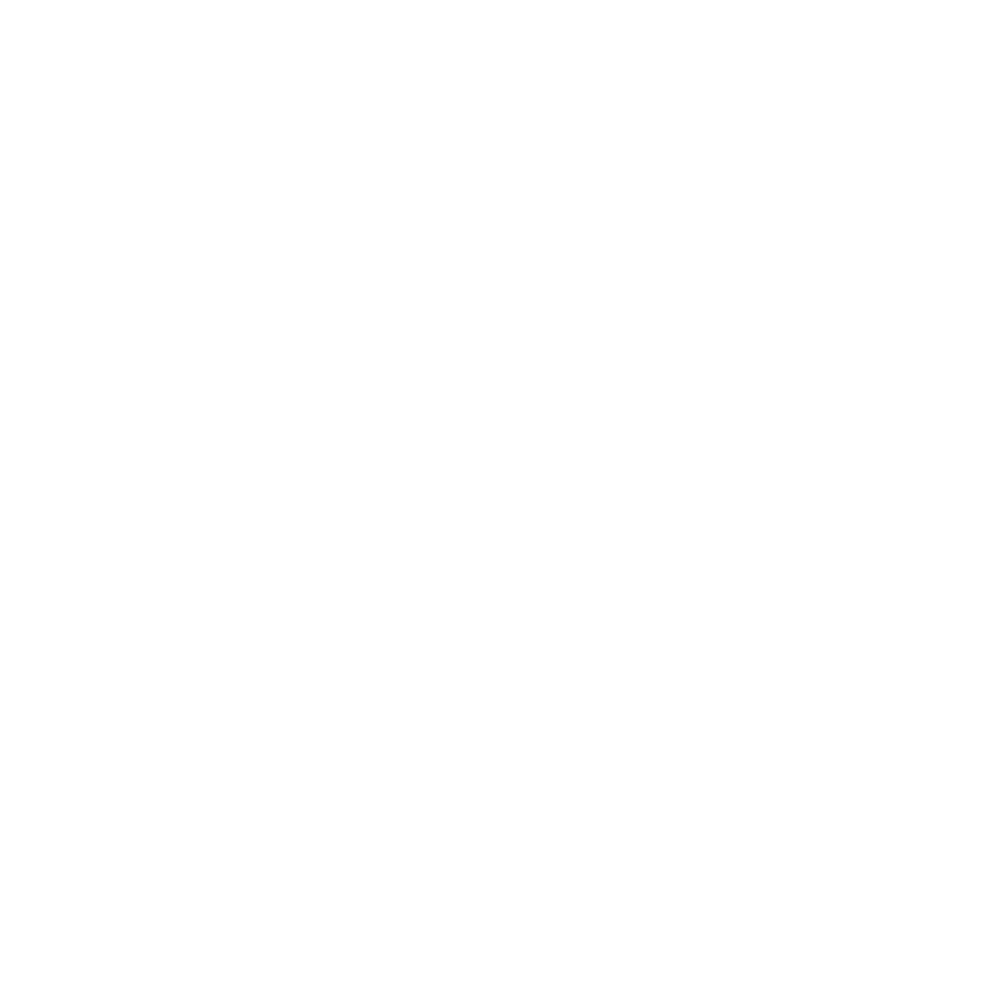

Drift correcting H2 on fov: Conv_zscan_06.tif
Fitting H2_750 on fov: Conv_zscan_06.tif


<IPython.core.display.Javascript object>


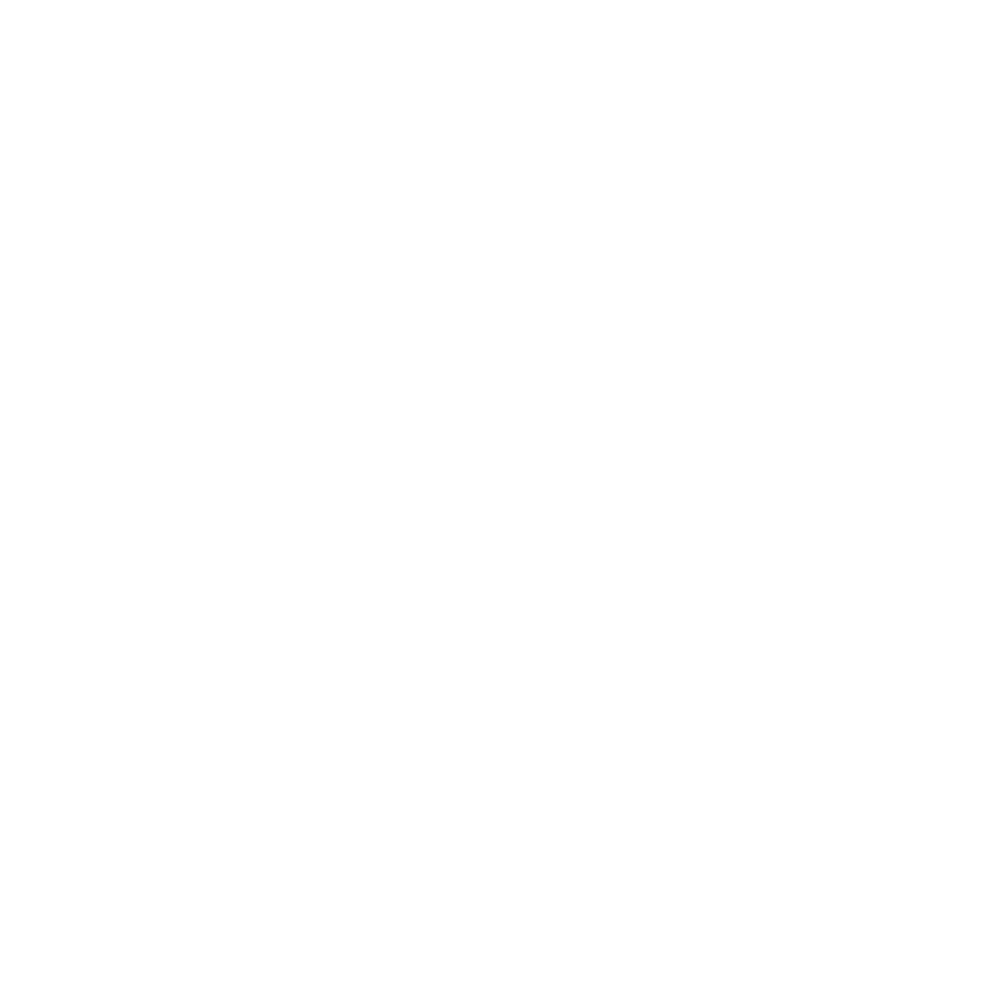

Fitting H2_647 on fov: Conv_zscan_06.tif


<IPython.core.display.Javascript object>


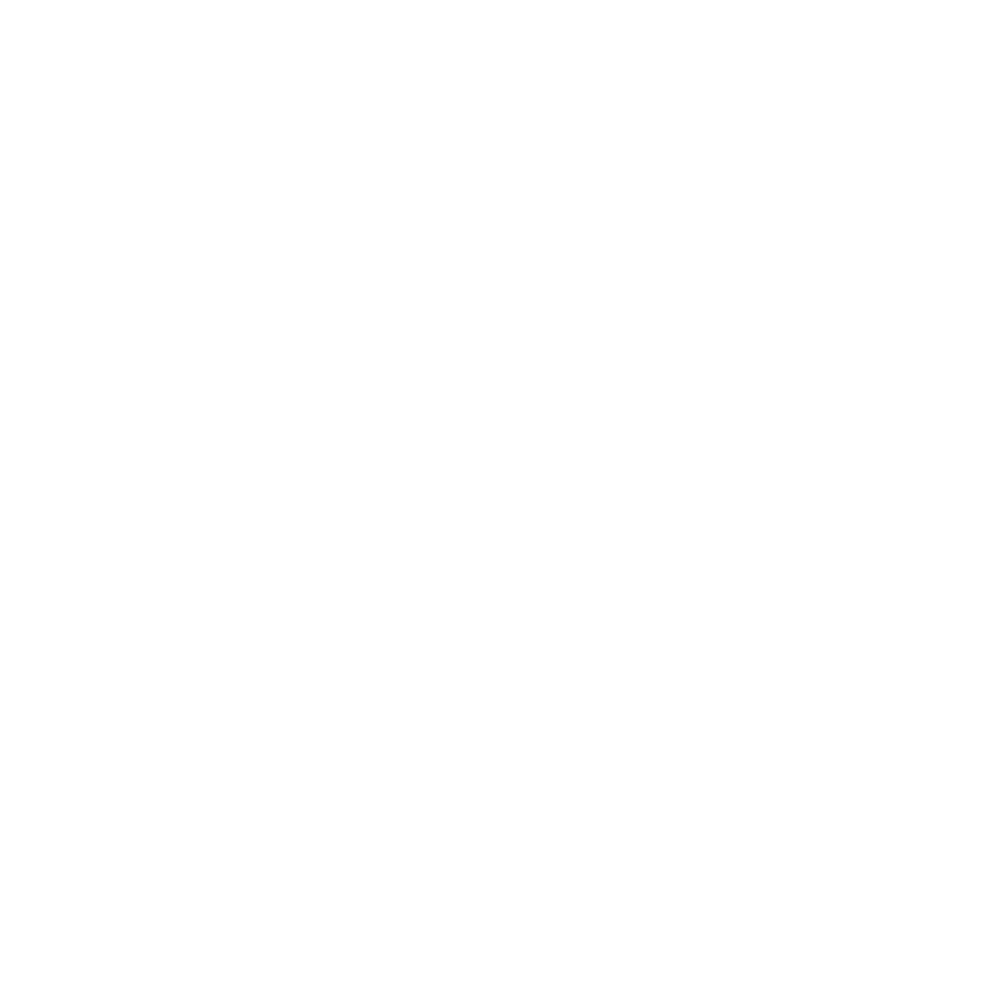

Drift correcting H3 on fov: Conv_zscan_06.tif
Fitting H3_750 on fov: Conv_zscan_06.tif


<IPython.core.display.Javascript object>


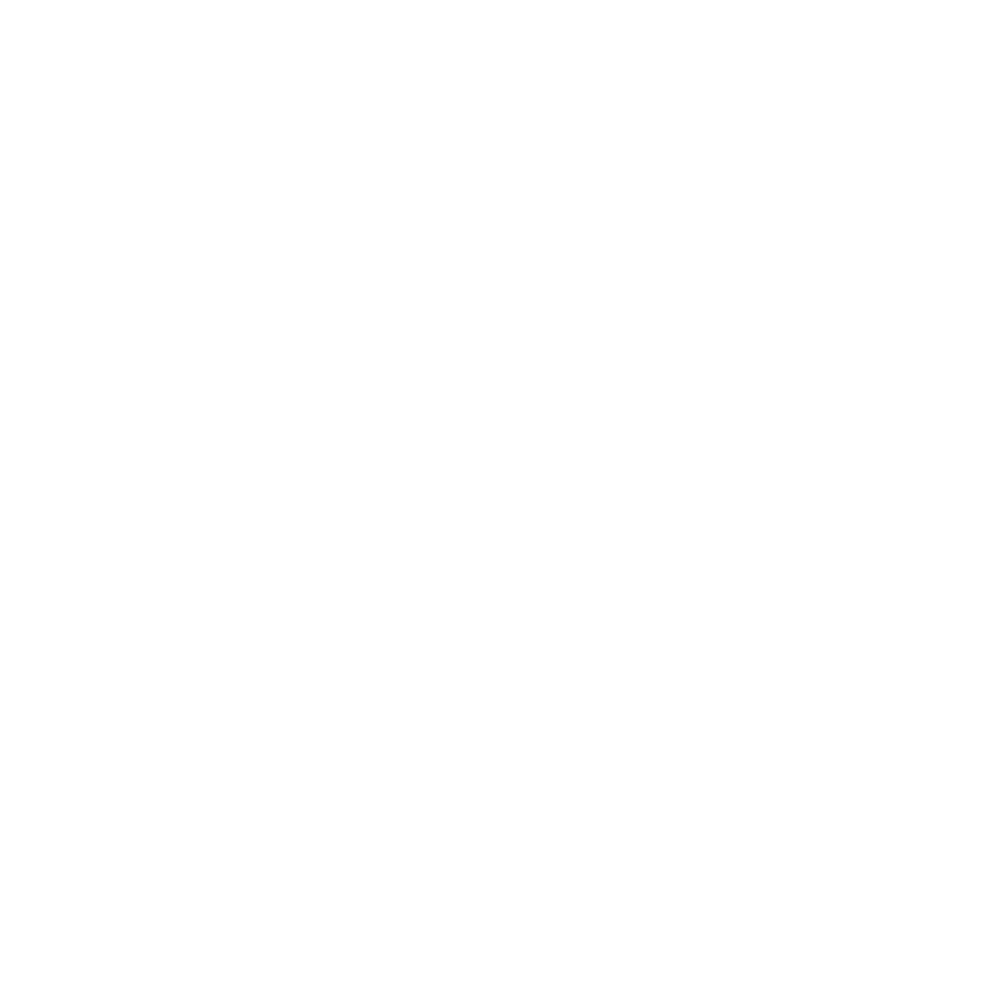

Fitting H3_647 on fov: Conv_zscan_06.tif


<IPython.core.display.Javascript object>


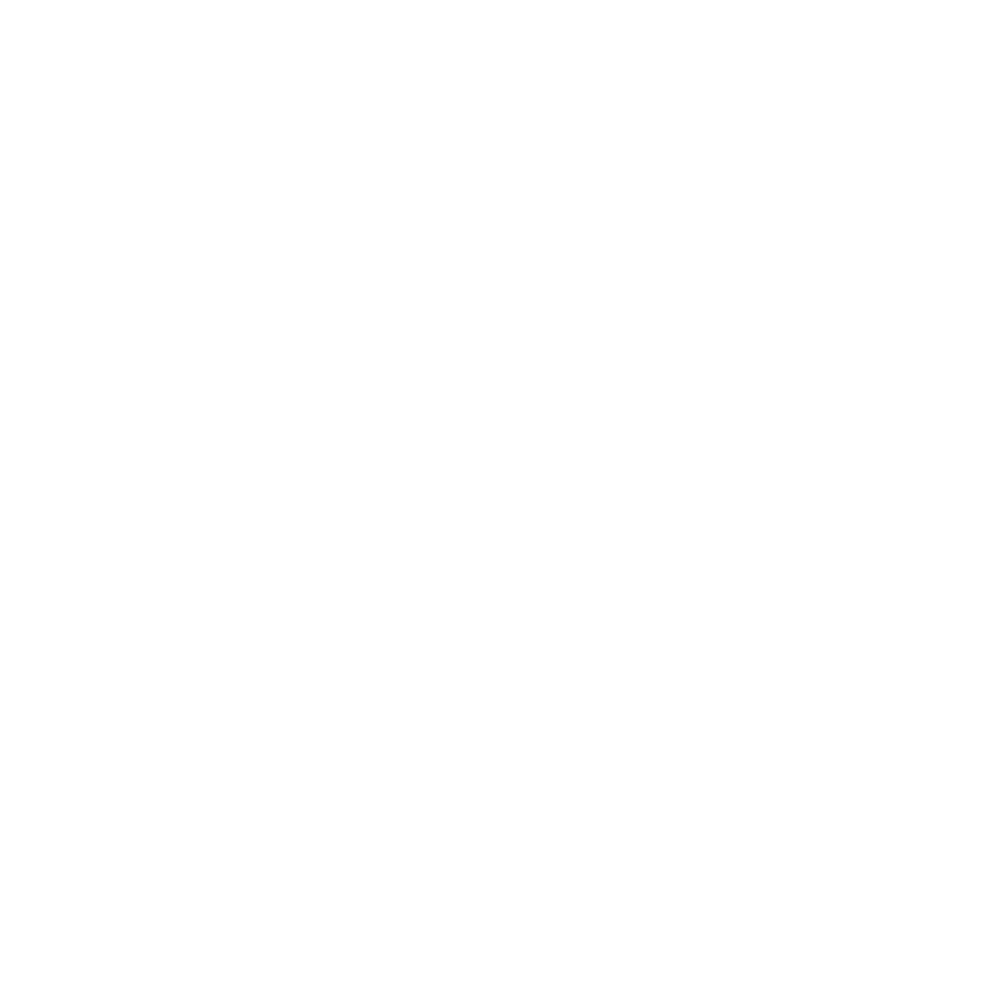

Drift correcting H4 on fov: Conv_zscan_06.tif
Fitting H4_750 on fov: Conv_zscan_06.tif


<IPython.core.display.Javascript object>


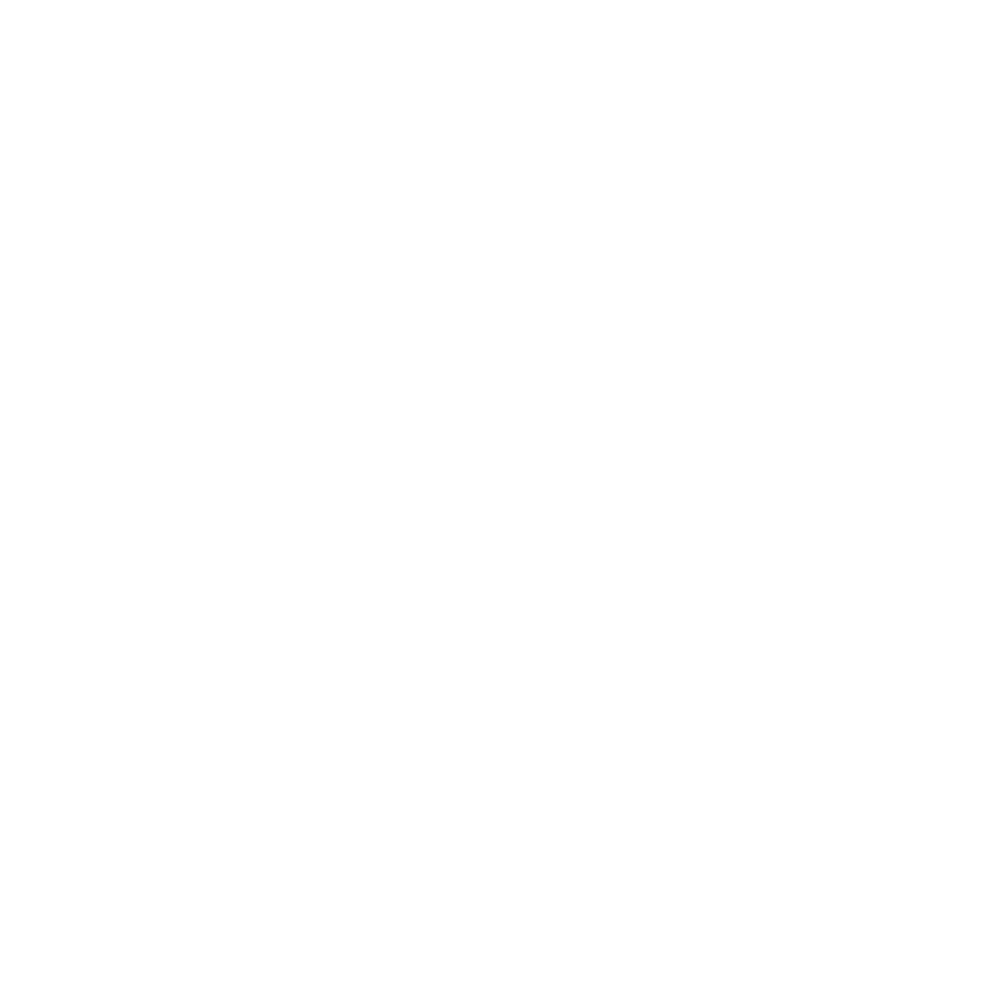

Fitting H4_647 on fov: Conv_zscan_06.tif


<IPython.core.display.Javascript object>


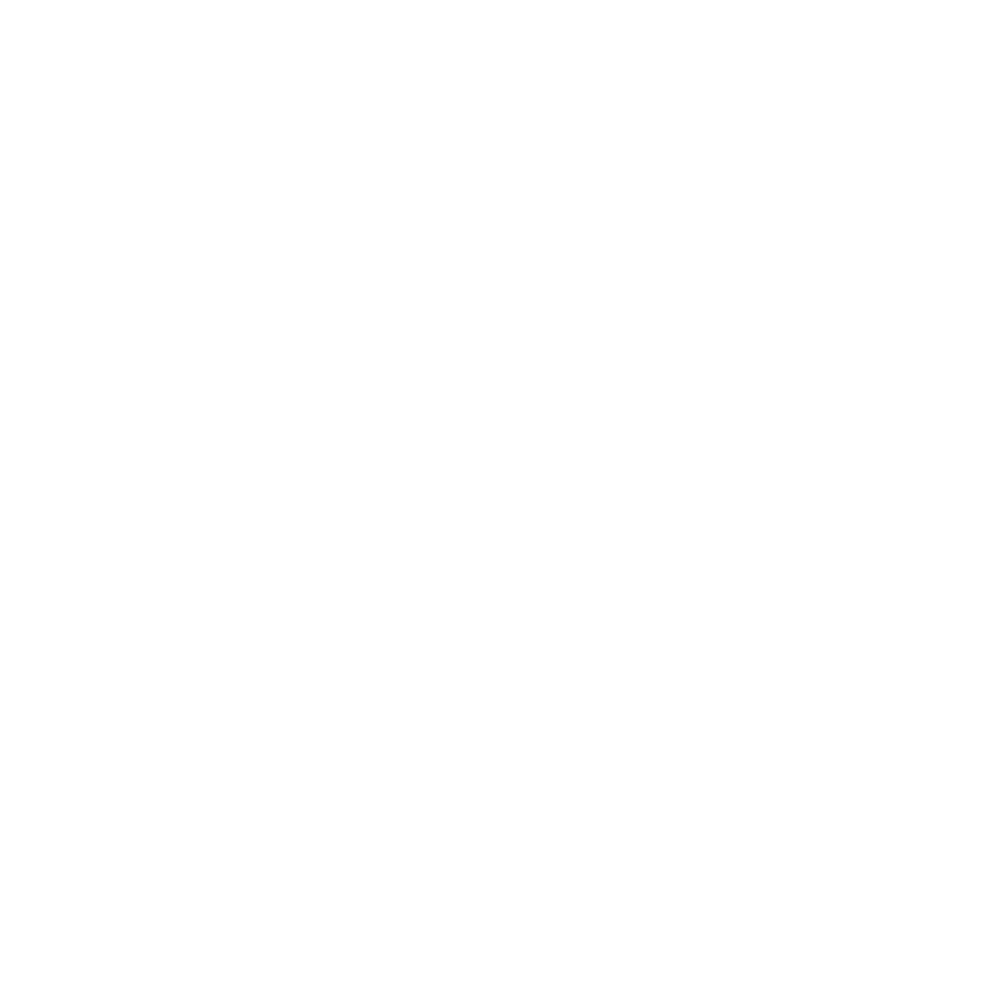

Drift correcting H5 on fov: Conv_zscan_06.tif
Fitting H5_750 on fov: Conv_zscan_06.tif


<IPython.core.display.Javascript object>


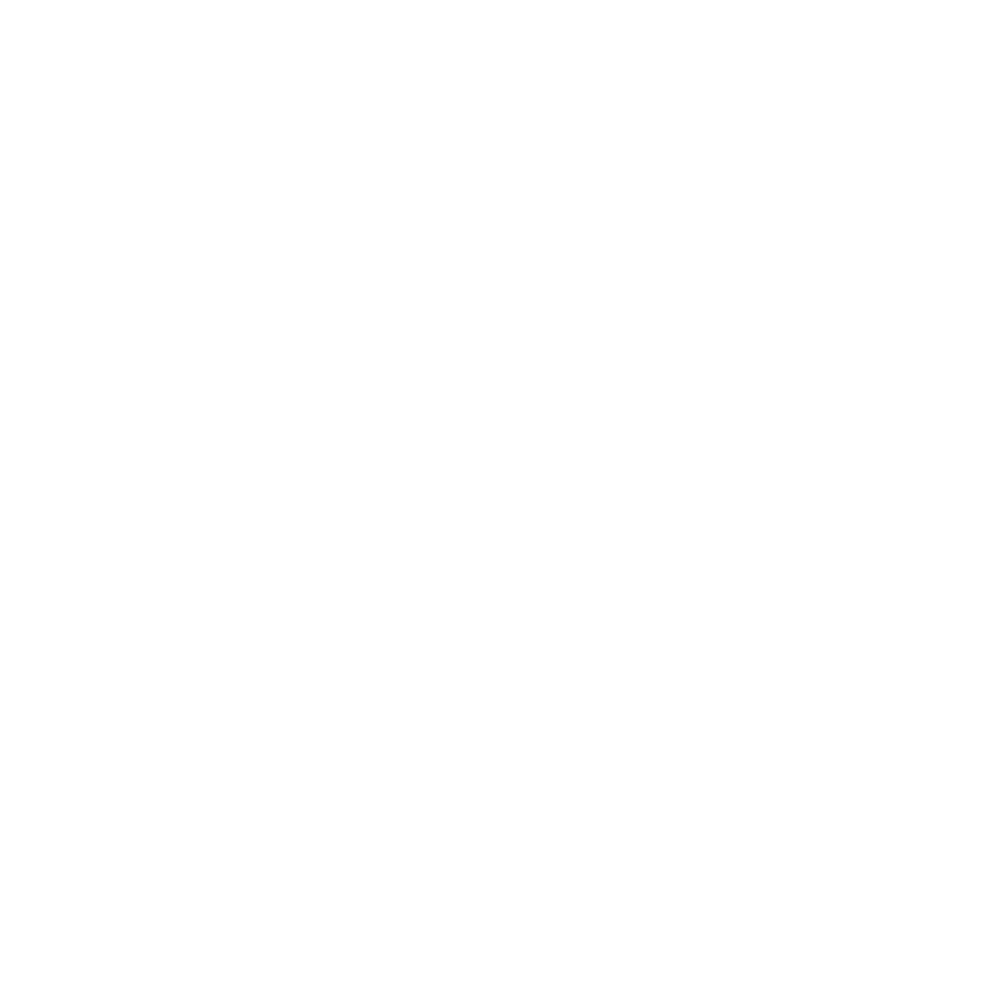

Fitting H5_647 on fov: Conv_zscan_06.tif


<IPython.core.display.Javascript object>


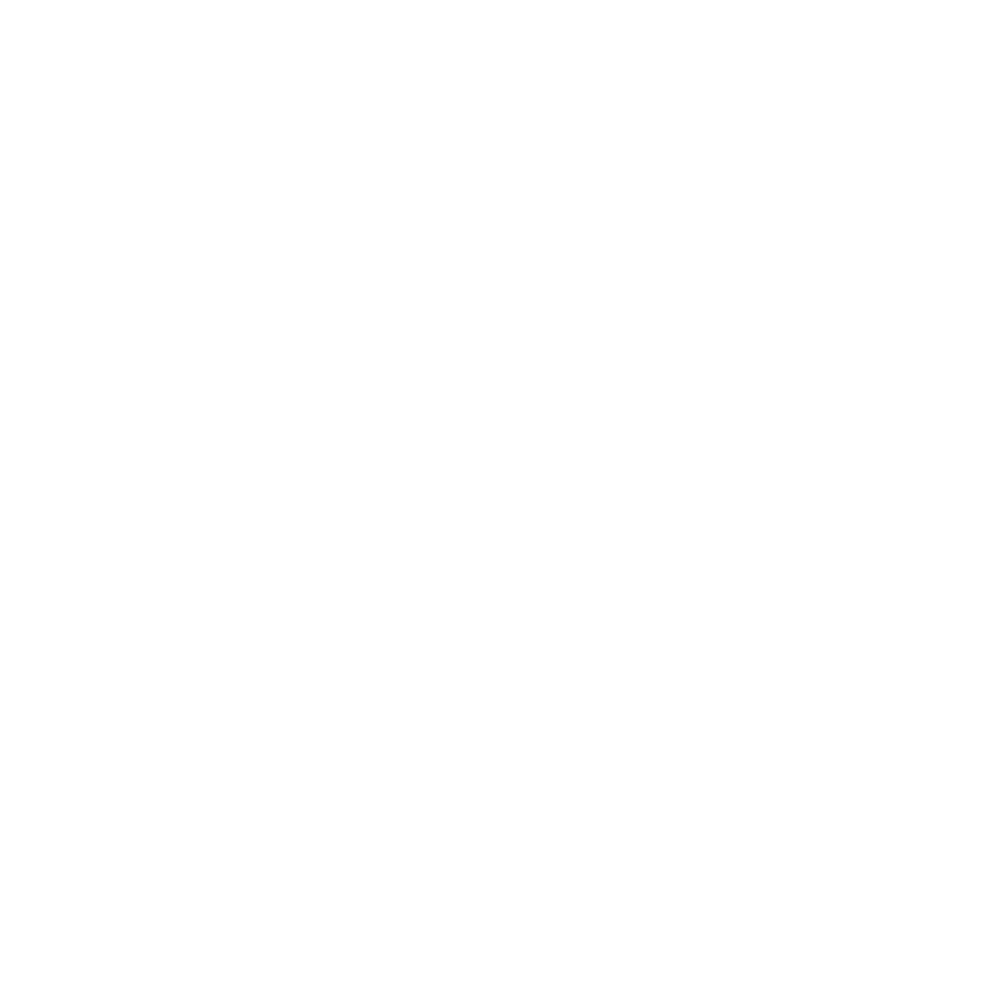

Drift correcting H6 on fov: Conv_zscan_06.tif
Fitting H6_750 on fov: Conv_zscan_06.tif


<IPython.core.display.Javascript object>


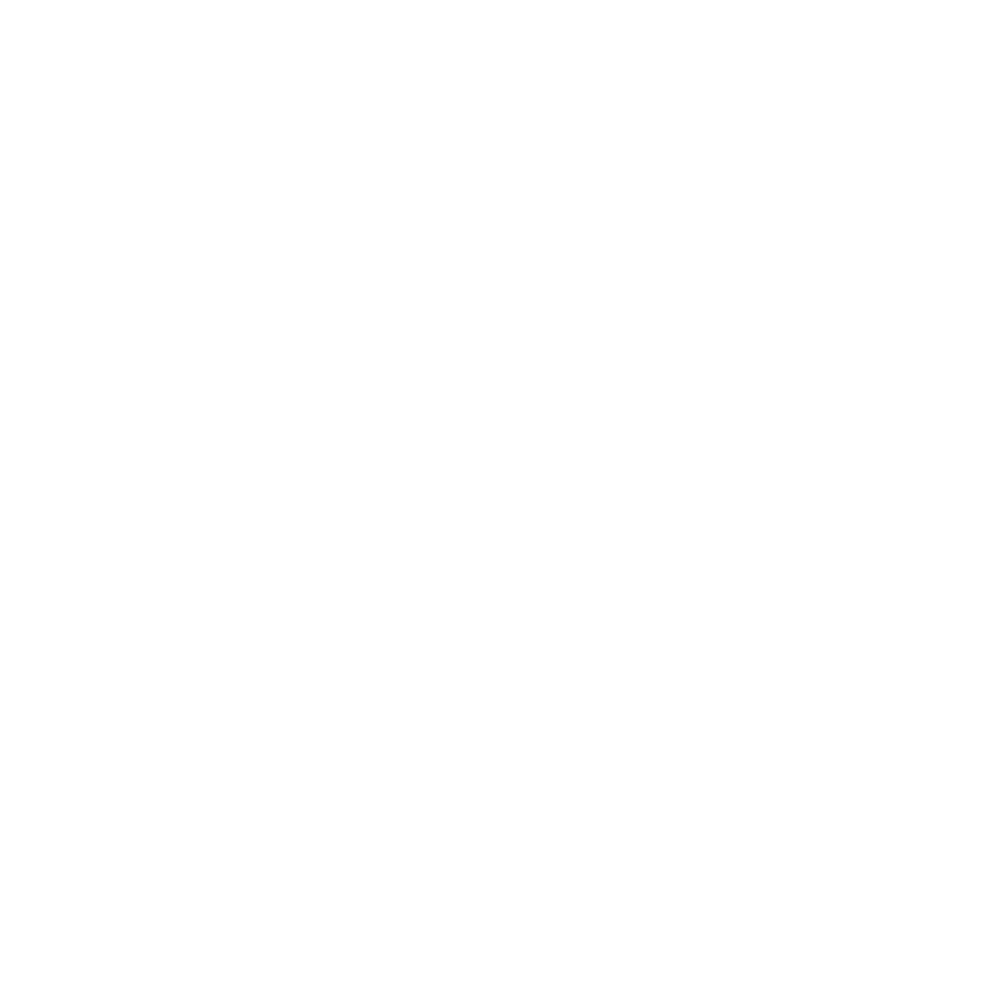

Fitting H6_647 on fov: Conv_zscan_06.tif


<IPython.core.display.Javascript object>


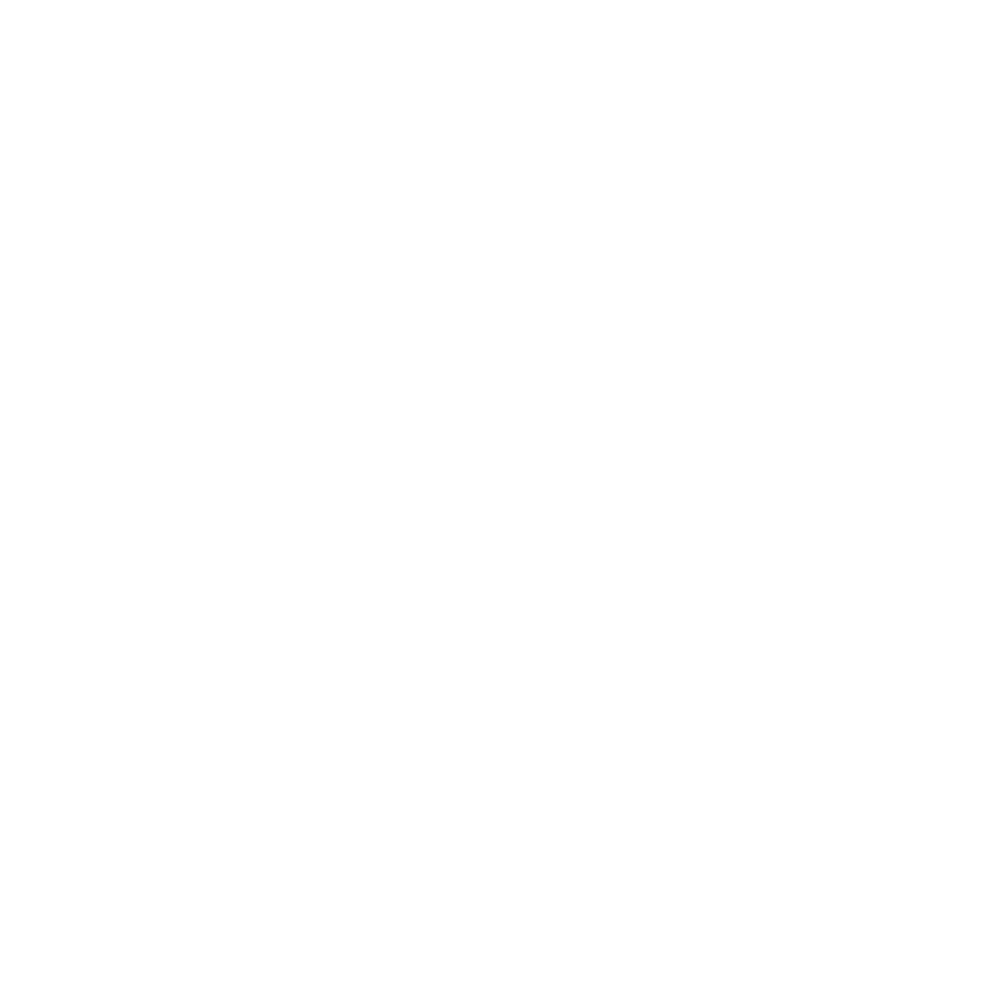

Estimating number of cells based on dapi image on fov: Conv_zscan_06.tif


<IPython.core.display.Javascript object>


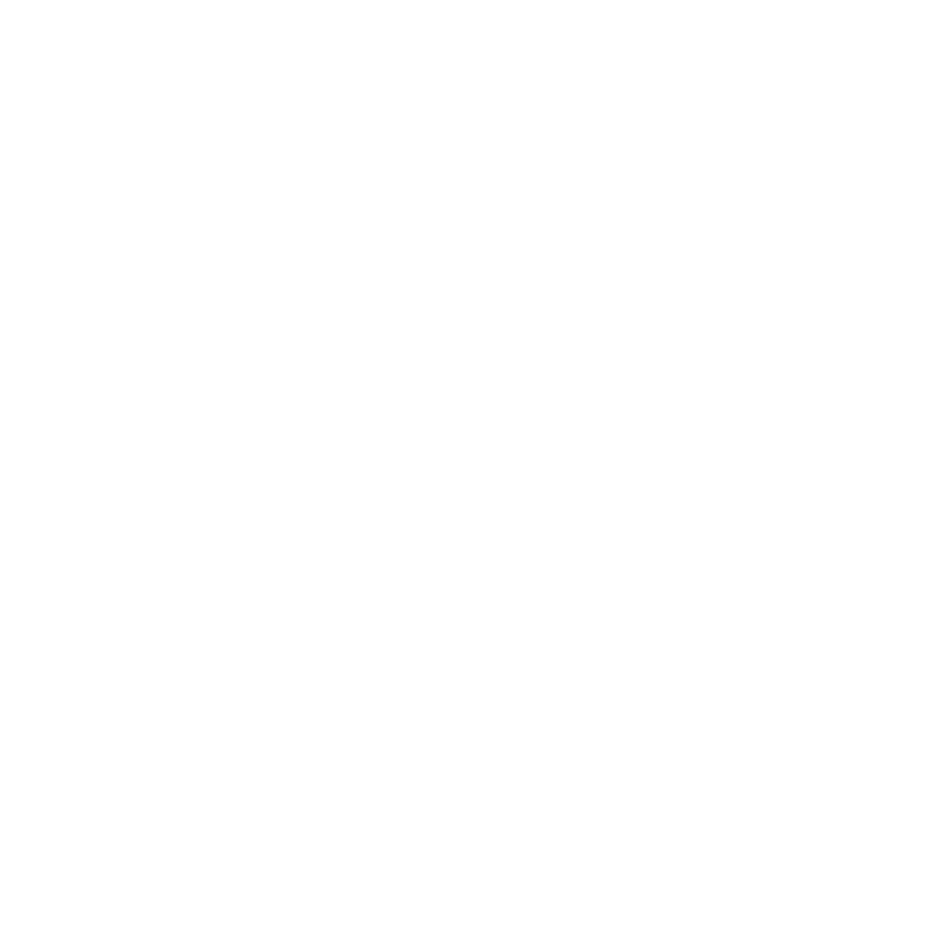

<ipython-input-27-1886a2f7fea2>:20: TqdmDeprecationWarning: This function will be removed in tqdm==5.0.0
Please use `tqdm.notebook.tqdm` instead of `tqdm.tqdm_notebook`
  for fld in tqdm(folders):



Drift correcting H1 on fov: Conv_zscan_07.tif
Fitting H1_750 on fov: Conv_zscan_07.tif


<IPython.core.display.Javascript object>


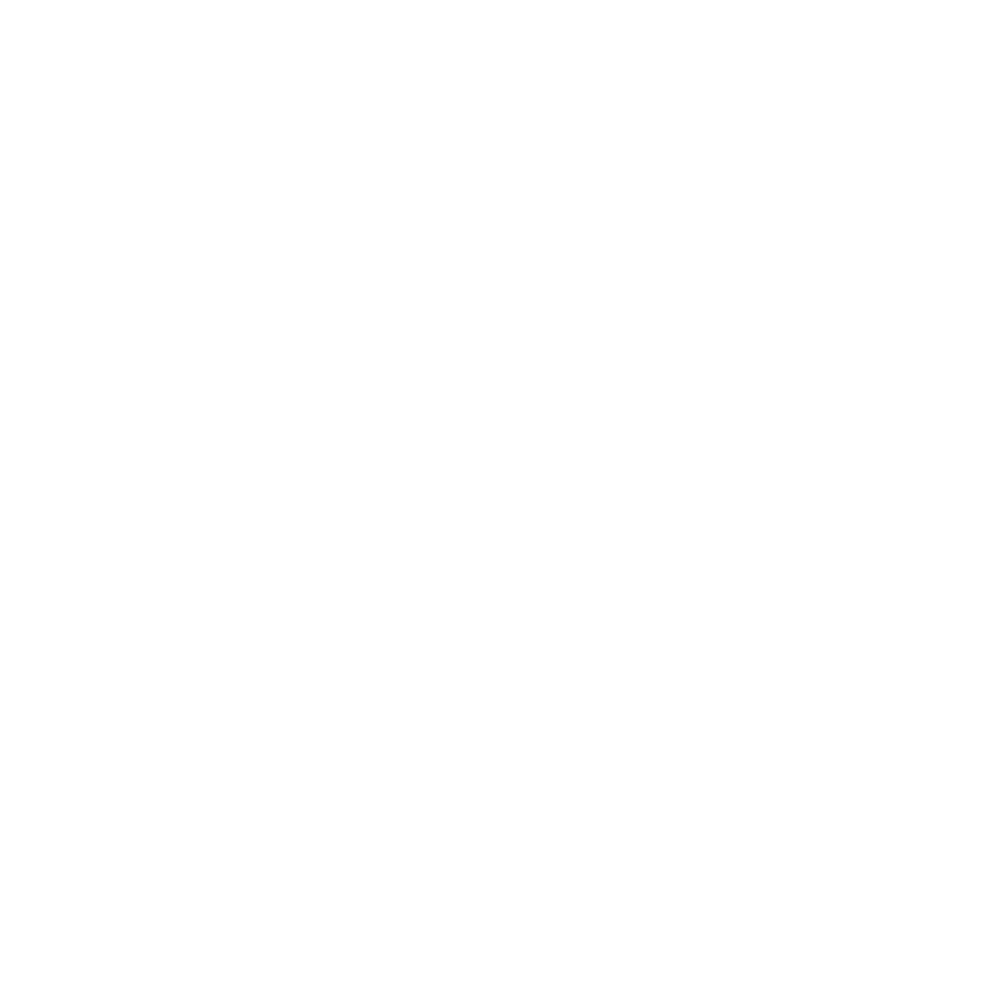

Fitting H1_647 on fov: Conv_zscan_07.tif


<IPython.core.display.Javascript object>


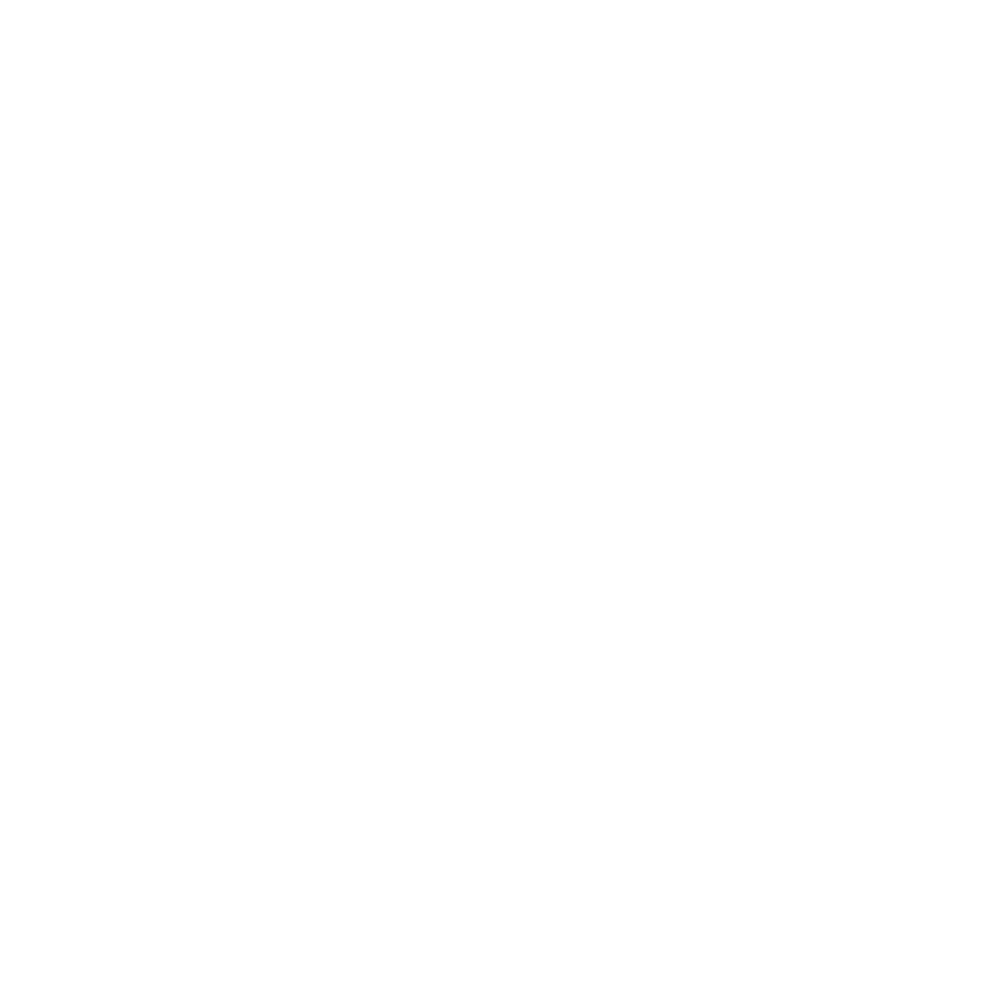

Drift correcting H2 on fov: Conv_zscan_07.tif
Fitting H2_750 on fov: Conv_zscan_07.tif


<IPython.core.display.Javascript object>


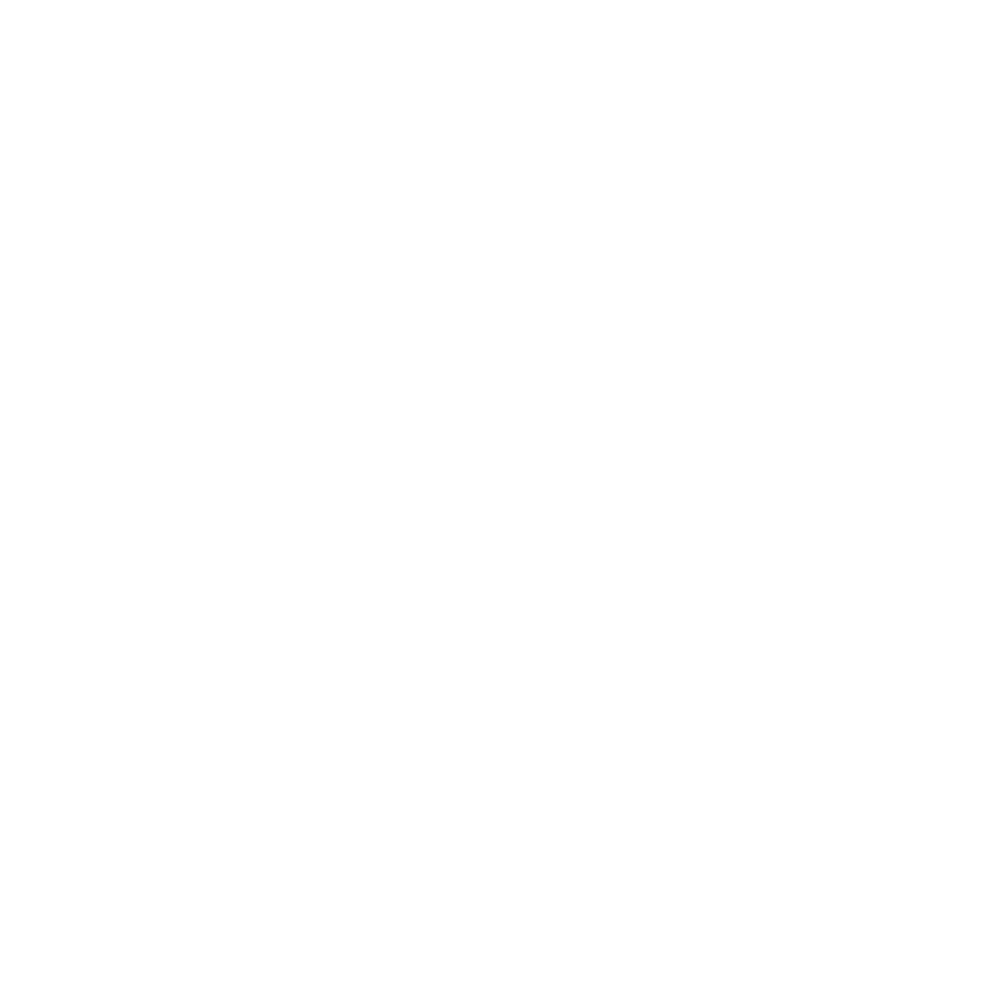

Fitting H2_647 on fov: Conv_zscan_07.tif


<IPython.core.display.Javascript object>


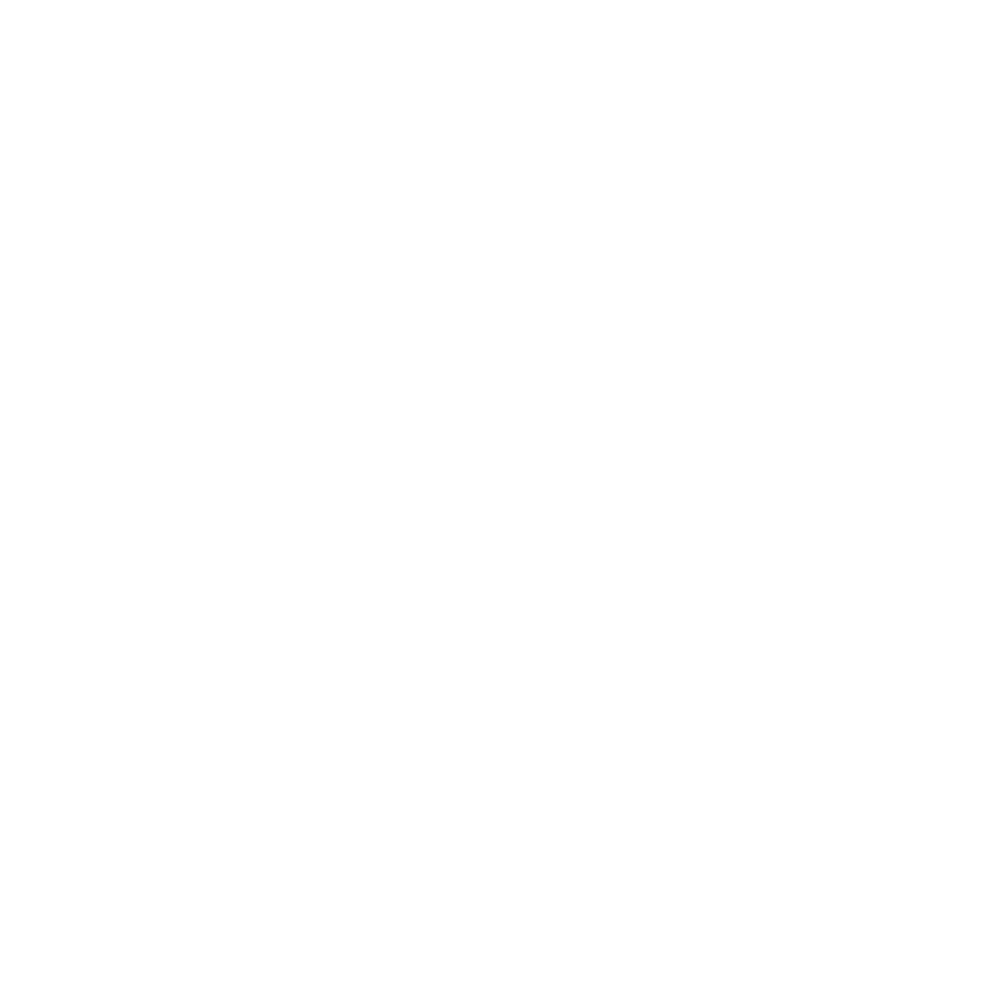

Drift correcting H3 on fov: Conv_zscan_07.tif
Fitting H3_750 on fov: Conv_zscan_07.tif


<IPython.core.display.Javascript object>


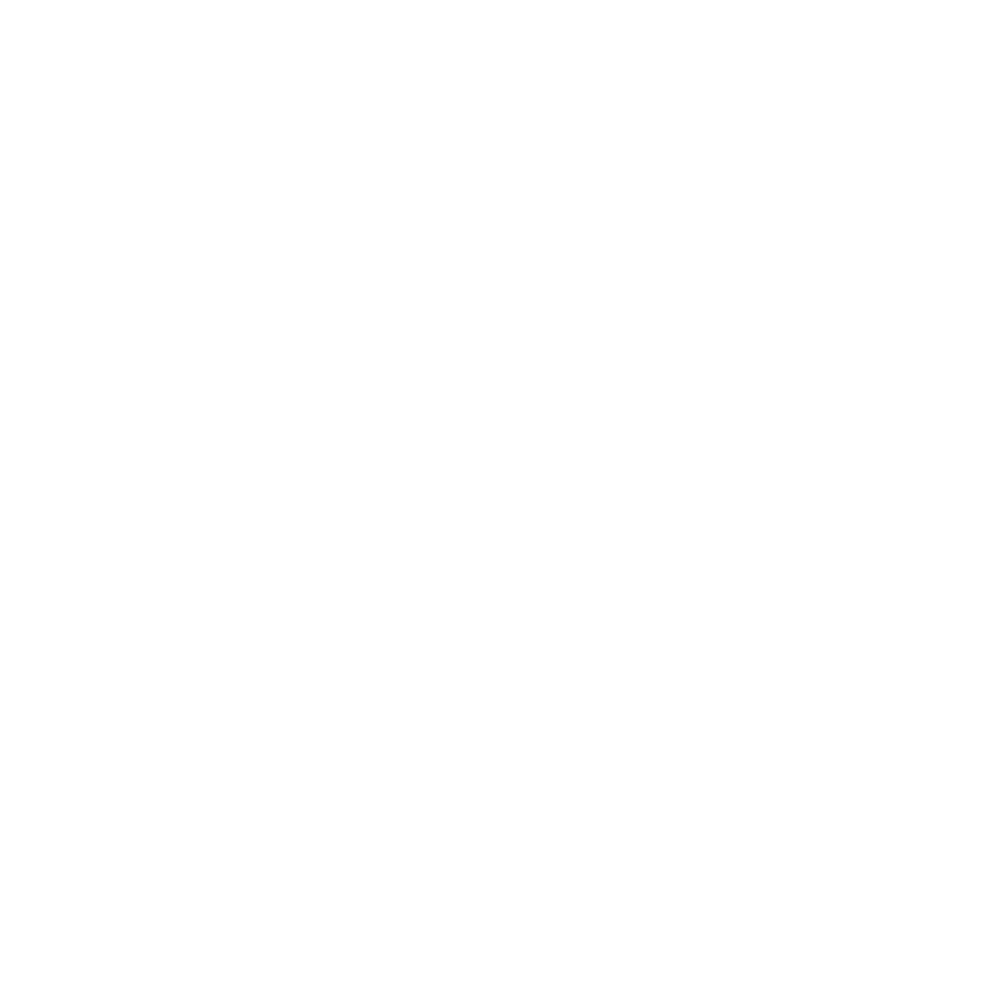

Fitting H3_647 on fov: Conv_zscan_07.tif


<IPython.core.display.Javascript object>


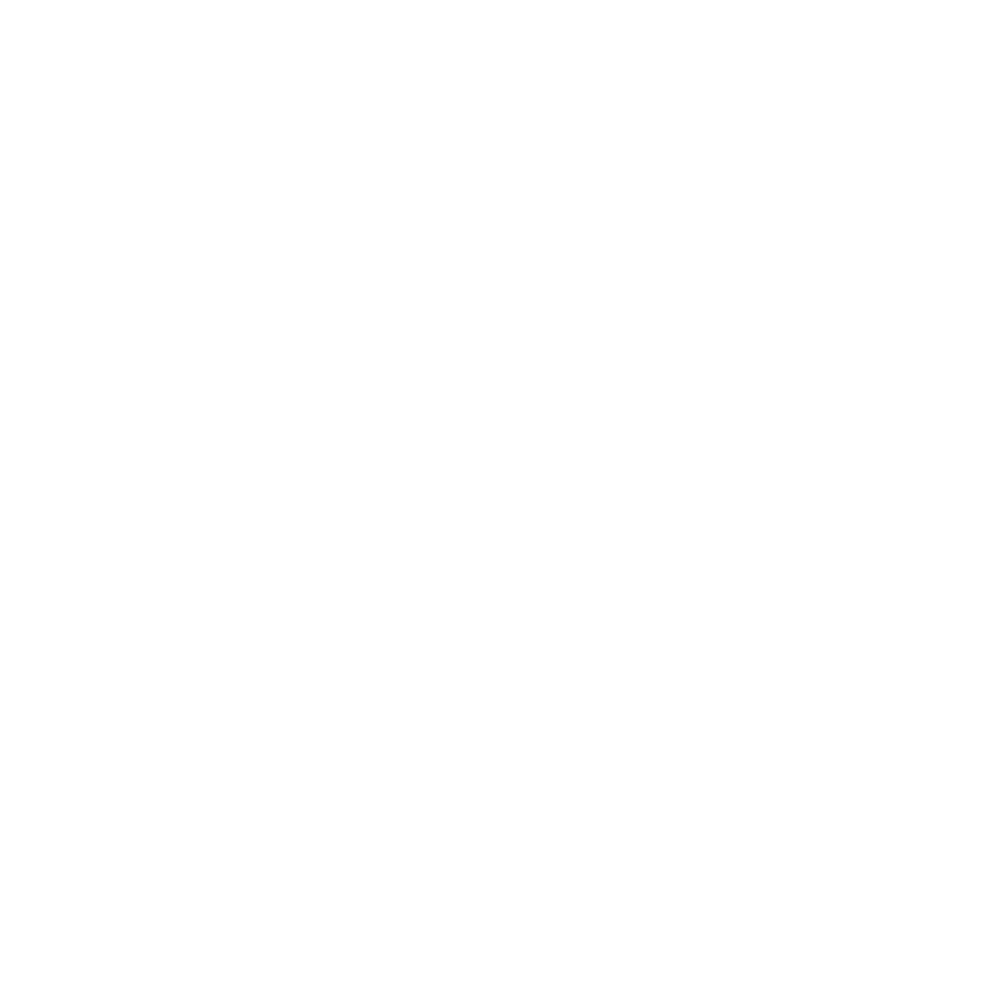

Drift correcting H4 on fov: Conv_zscan_07.tif
Fitting H4_750 on fov: Conv_zscan_07.tif


<IPython.core.display.Javascript object>


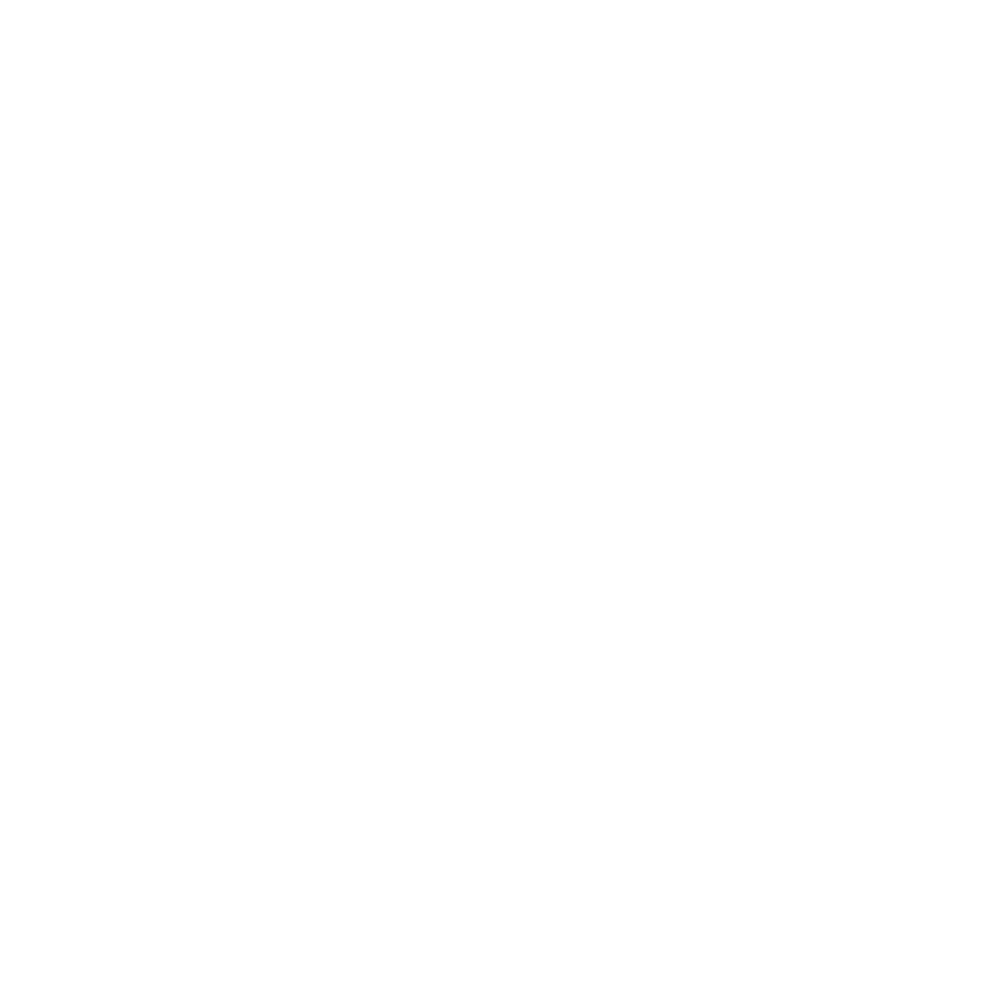

Fitting H4_647 on fov: Conv_zscan_07.tif


<IPython.core.display.Javascript object>


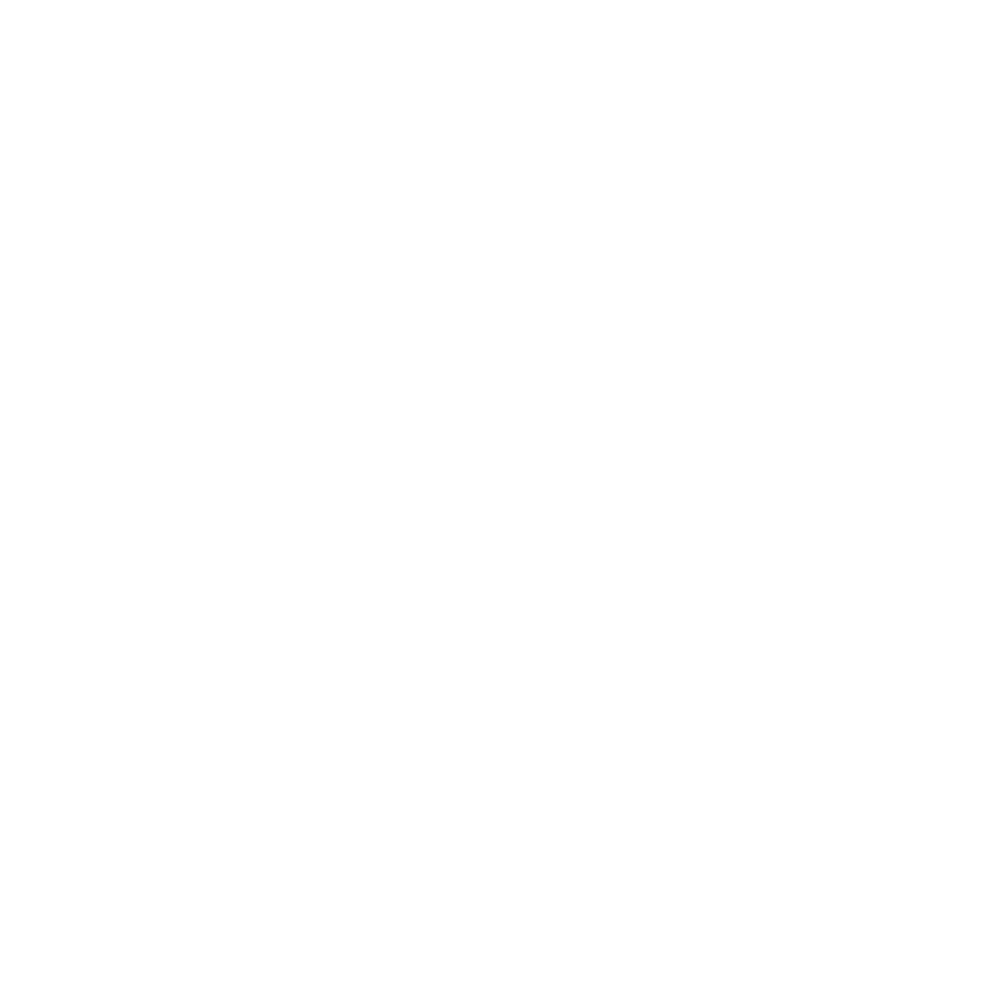

Drift correcting H5 on fov: Conv_zscan_07.tif
Fitting H5_750 on fov: Conv_zscan_07.tif


<IPython.core.display.Javascript object>


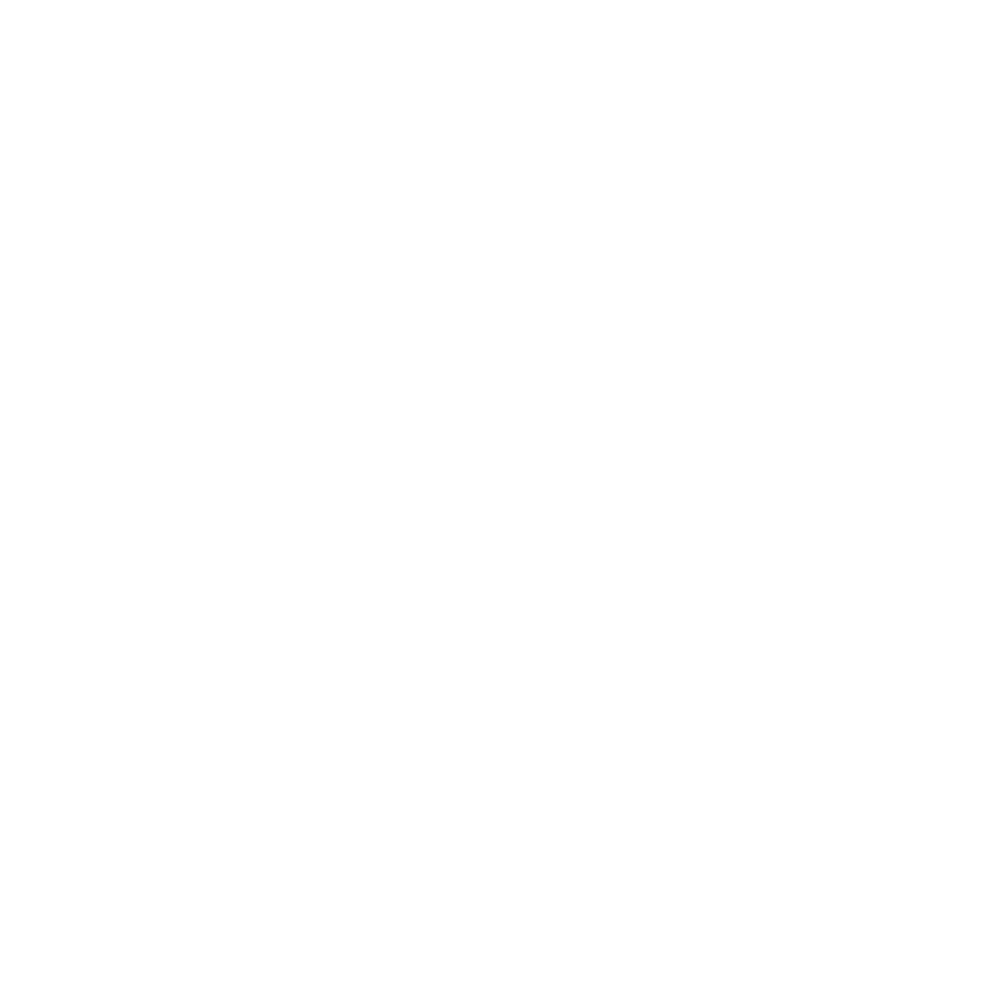

Fitting H5_647 on fov: Conv_zscan_07.tif


<IPython.core.display.Javascript object>


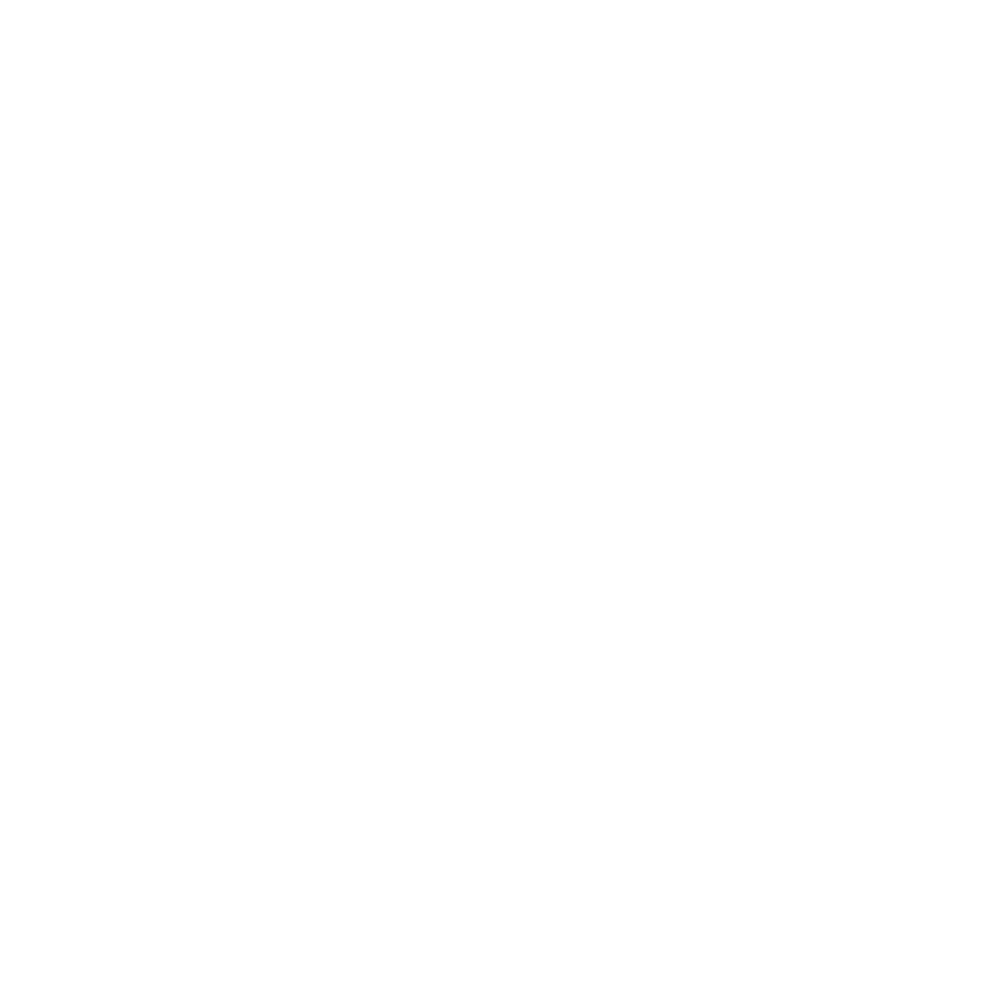

Drift correcting H6 on fov: Conv_zscan_07.tif
Fitting H6_750 on fov: Conv_zscan_07.tif


<IPython.core.display.Javascript object>


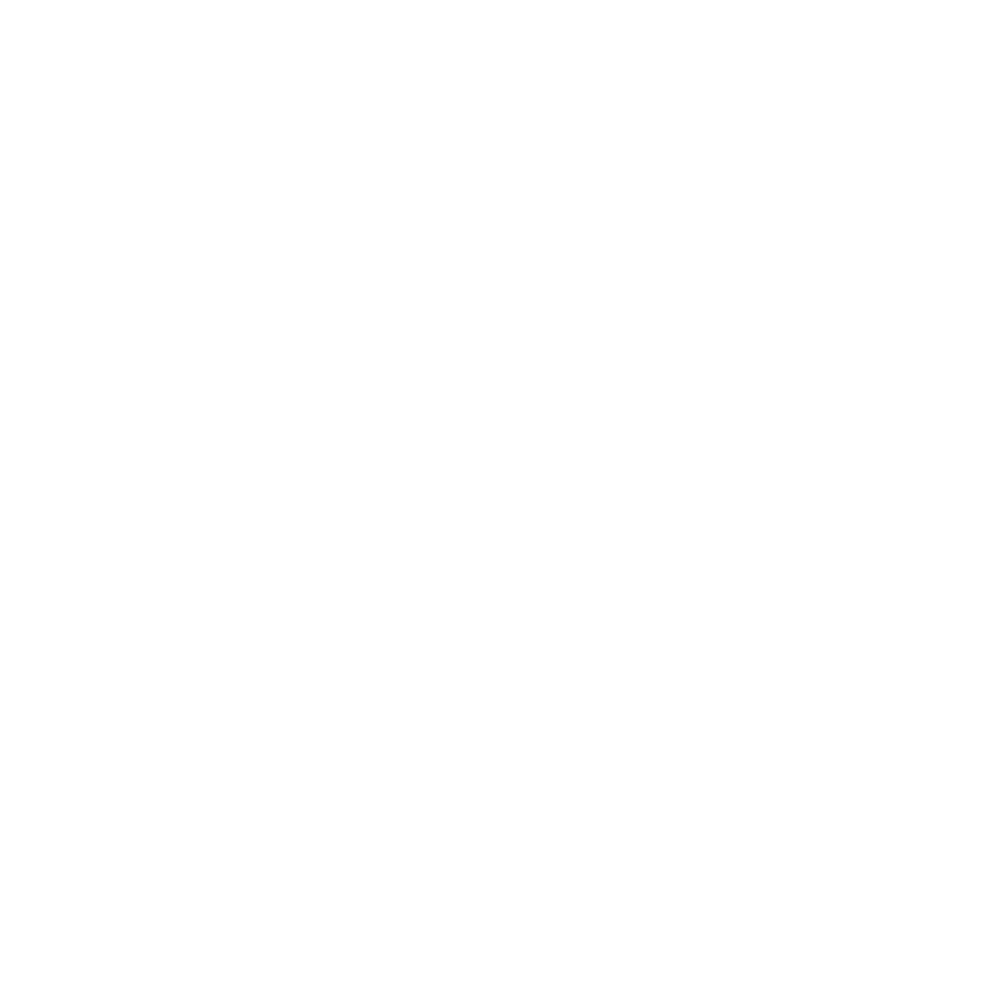

Fitting H6_647 on fov: Conv_zscan_07.tif


<IPython.core.display.Javascript object>


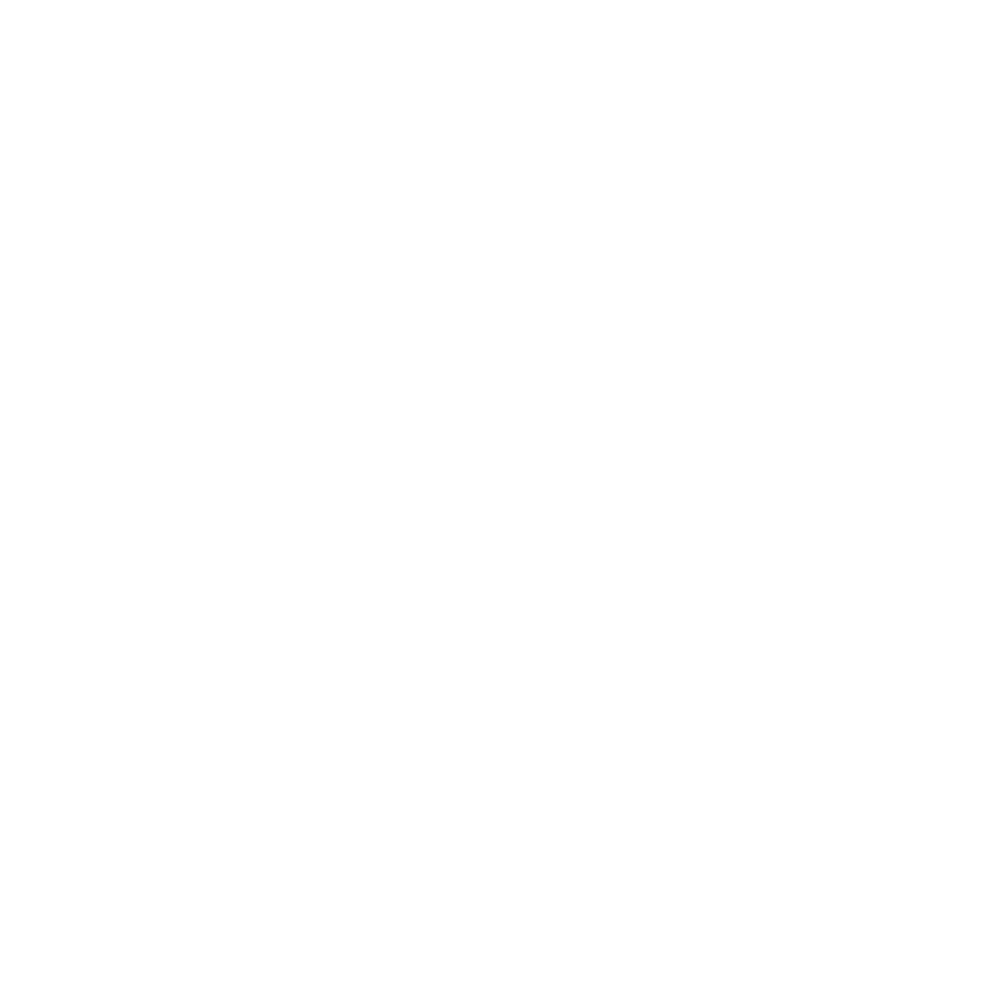

Estimating number of cells based on dapi image on fov: Conv_zscan_07.tif


<IPython.core.display.Javascript object>


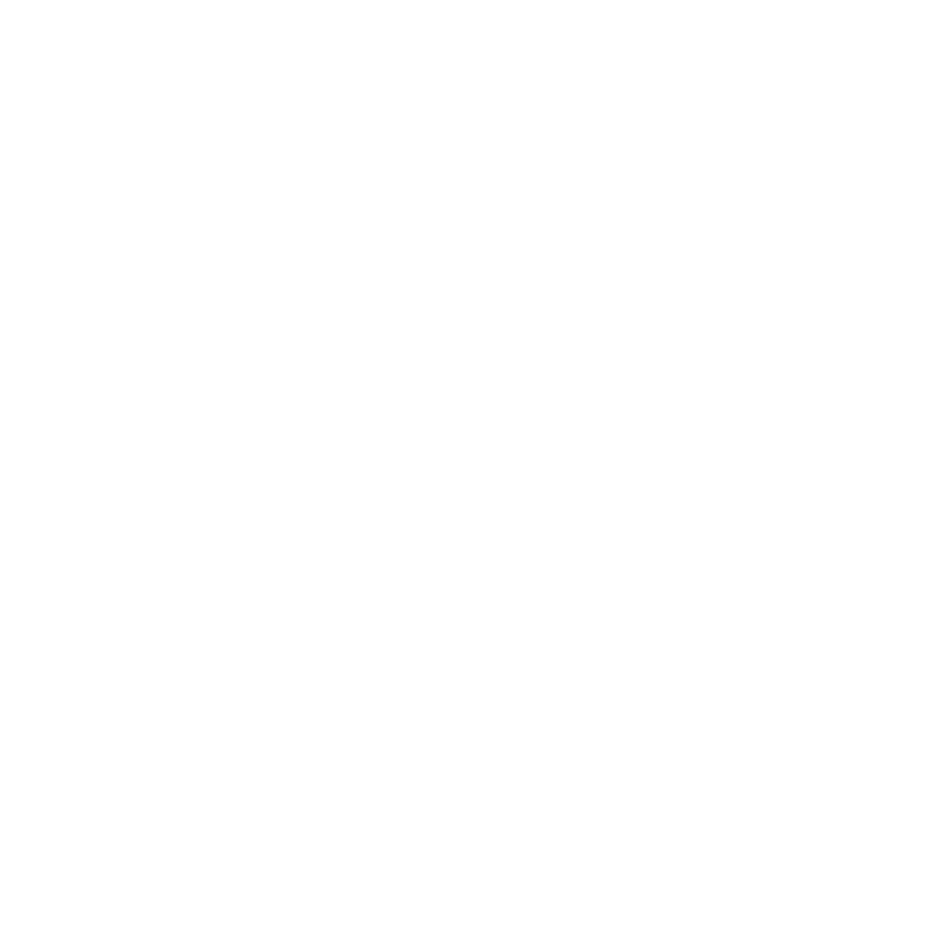

<ipython-input-27-1886a2f7fea2>:20: TqdmDeprecationWarning: This function will be removed in tqdm==5.0.0
Please use `tqdm.notebook.tqdm` instead of `tqdm.tqdm_notebook`
  for fld in tqdm(folders):



Drift correcting H1 on fov: Conv_zscan_08.tif
Fitting H1_750 on fov: Conv_zscan_08.tif


<IPython.core.display.Javascript object>


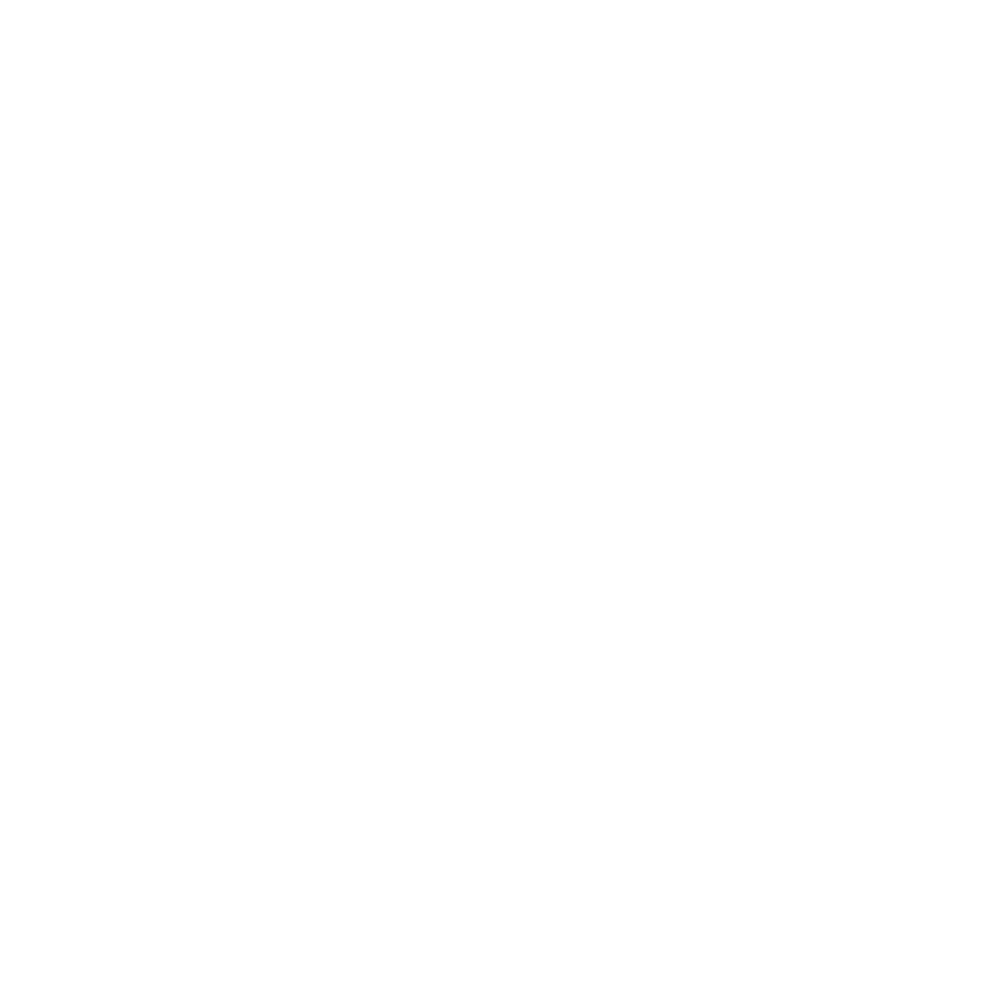

Fitting H1_647 on fov: Conv_zscan_08.tif


<IPython.core.display.Javascript object>


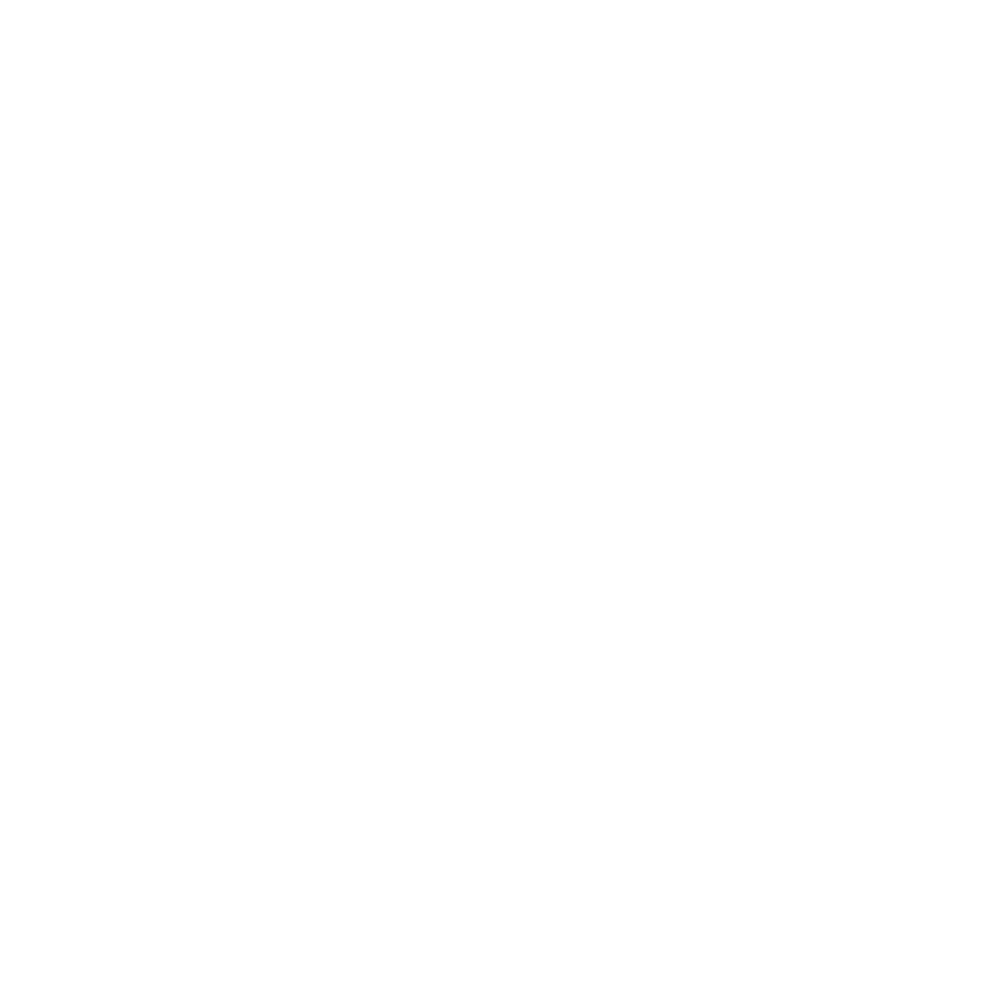

Drift correcting H2 on fov: Conv_zscan_08.tif
Fitting H2_750 on fov: Conv_zscan_08.tif


<IPython.core.display.Javascript object>


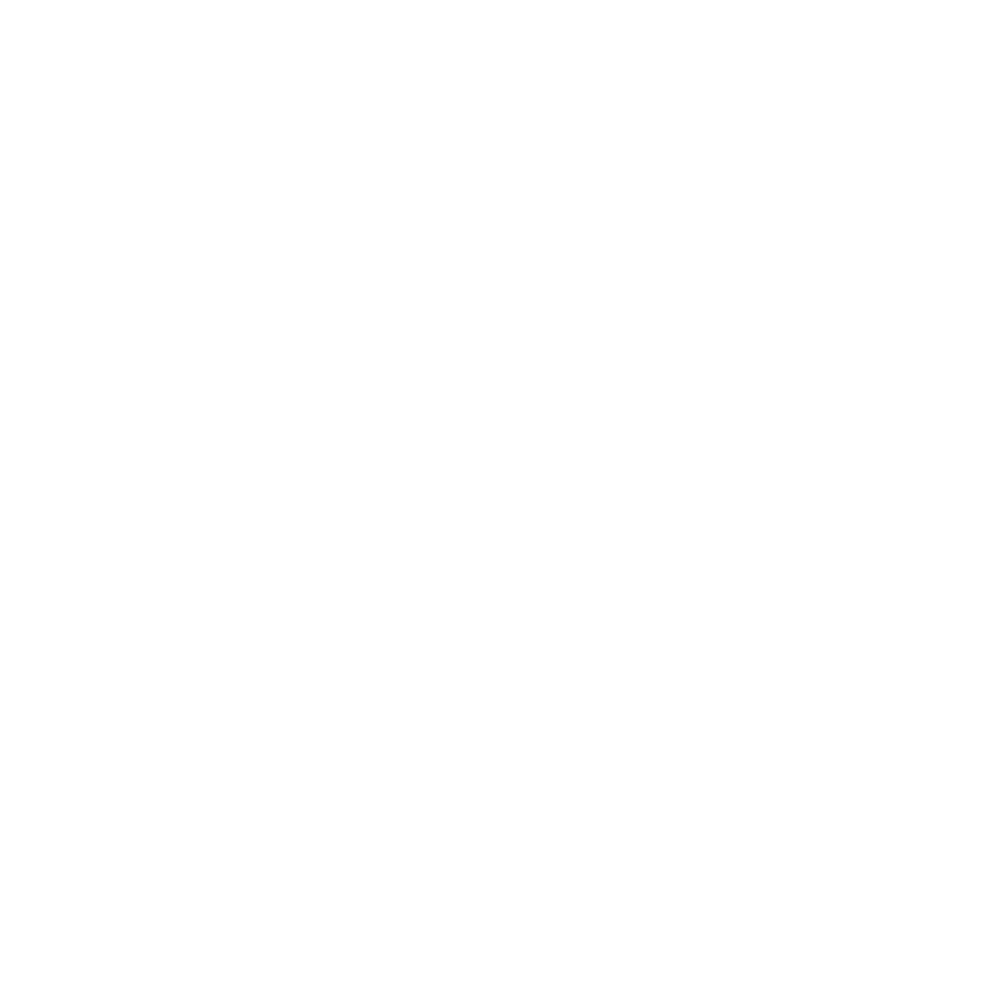

Fitting H2_647 on fov: Conv_zscan_08.tif


<IPython.core.display.Javascript object>


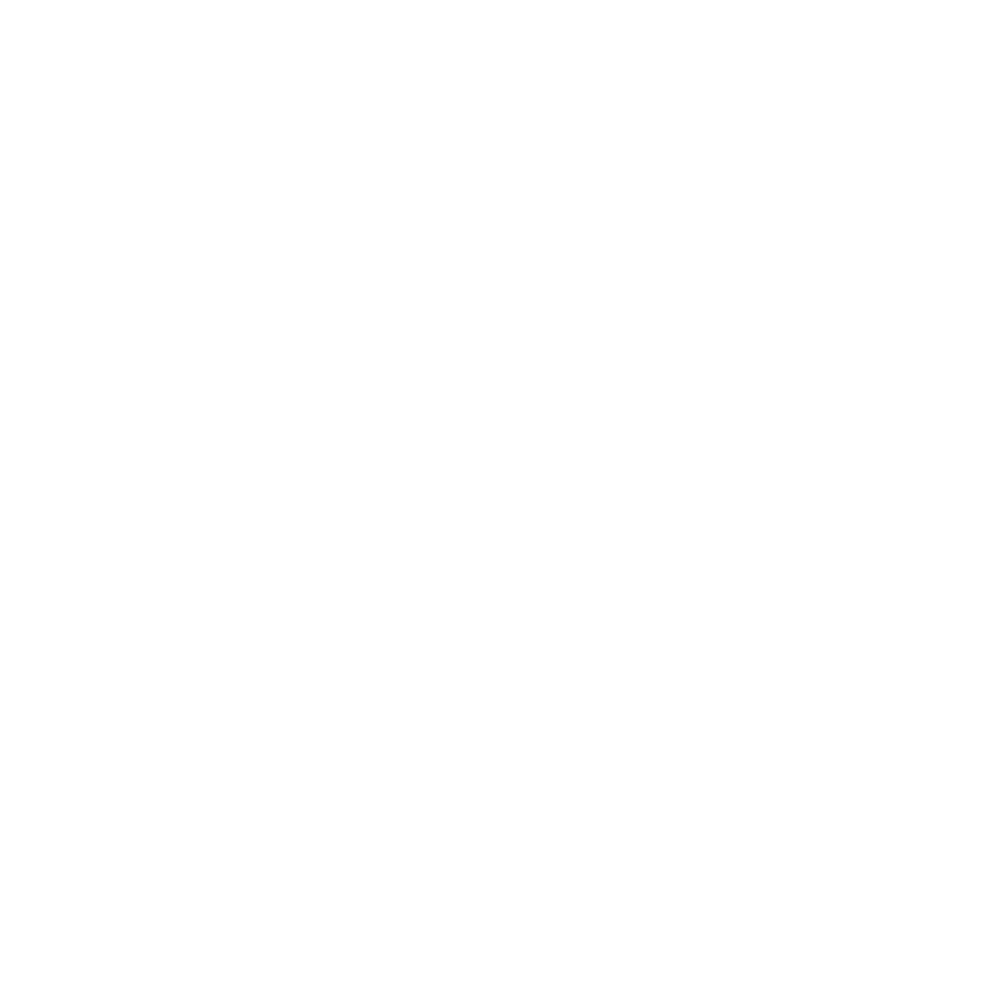

Drift correcting H3 on fov: Conv_zscan_08.tif
Fitting H3_750 on fov: Conv_zscan_08.tif


<IPython.core.display.Javascript object>


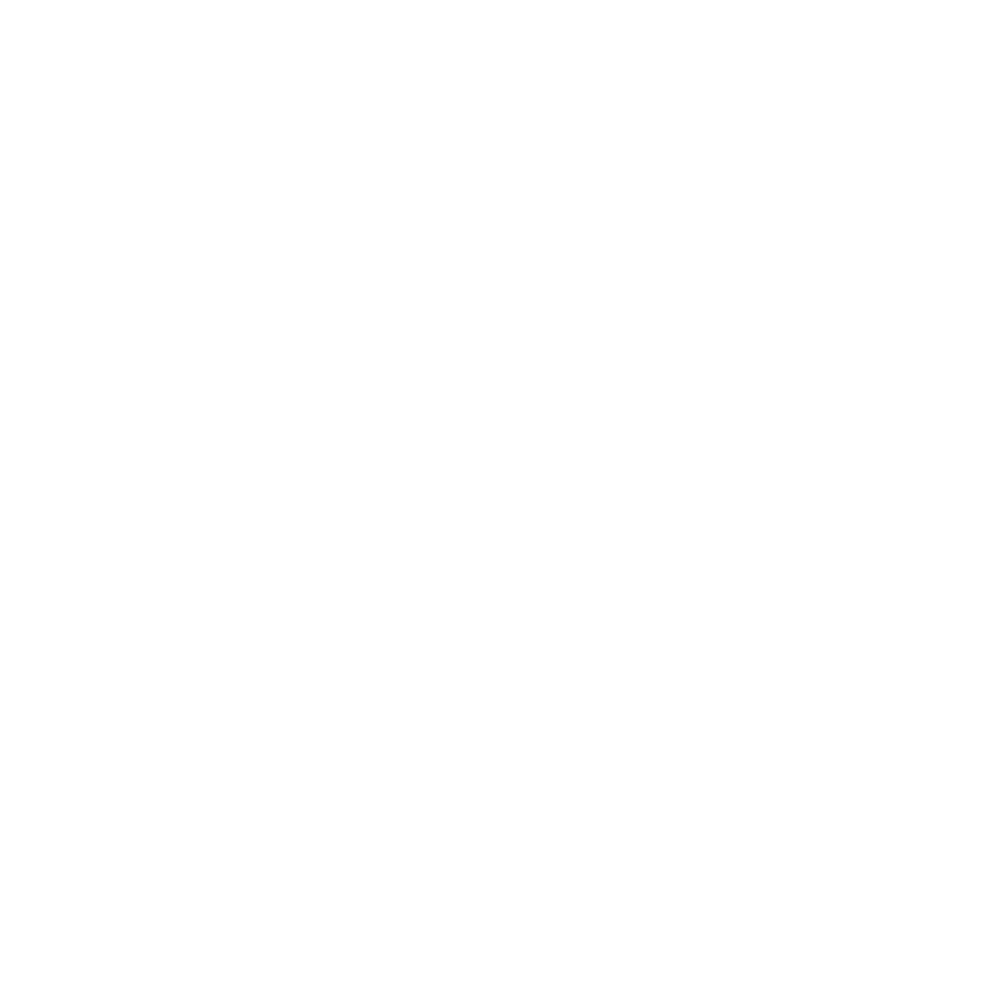

Fitting H3_647 on fov: Conv_zscan_08.tif


<IPython.core.display.Javascript object>


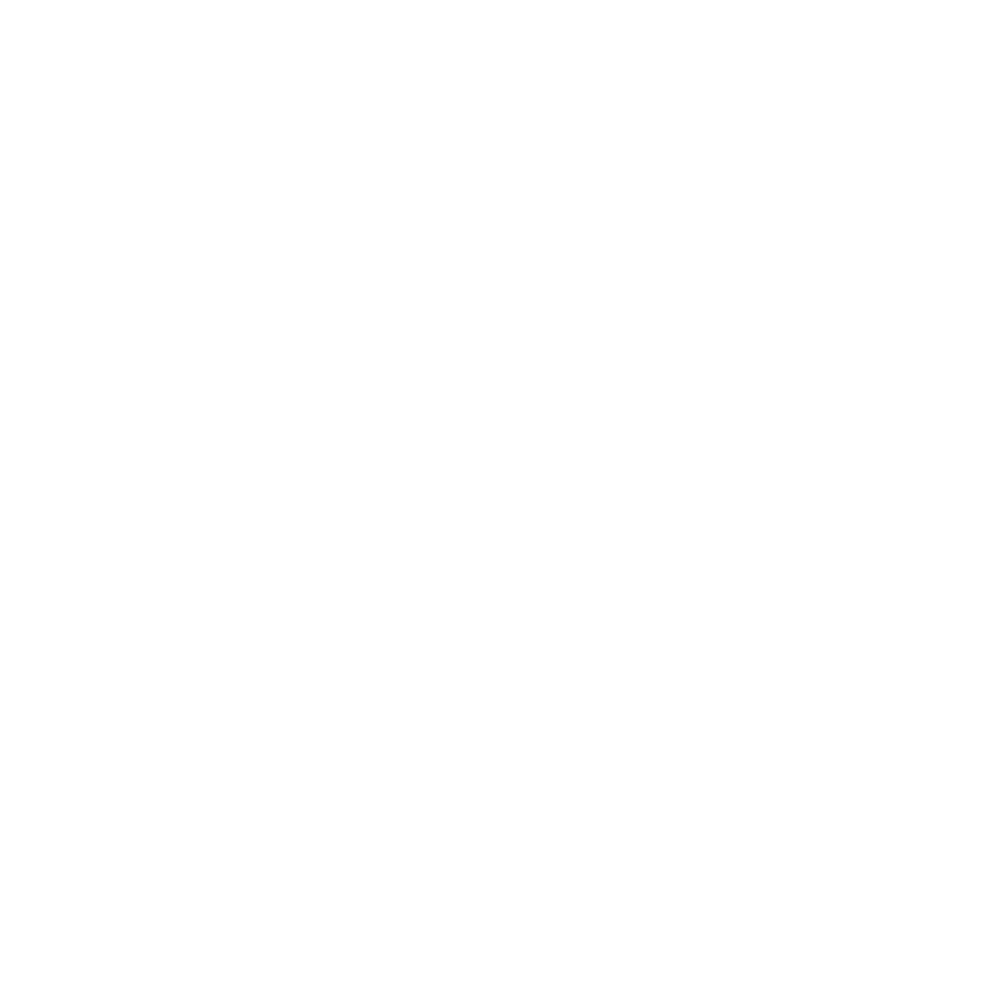

Drift correcting H4 on fov: Conv_zscan_08.tif
Fitting H4_750 on fov: Conv_zscan_08.tif


<IPython.core.display.Javascript object>


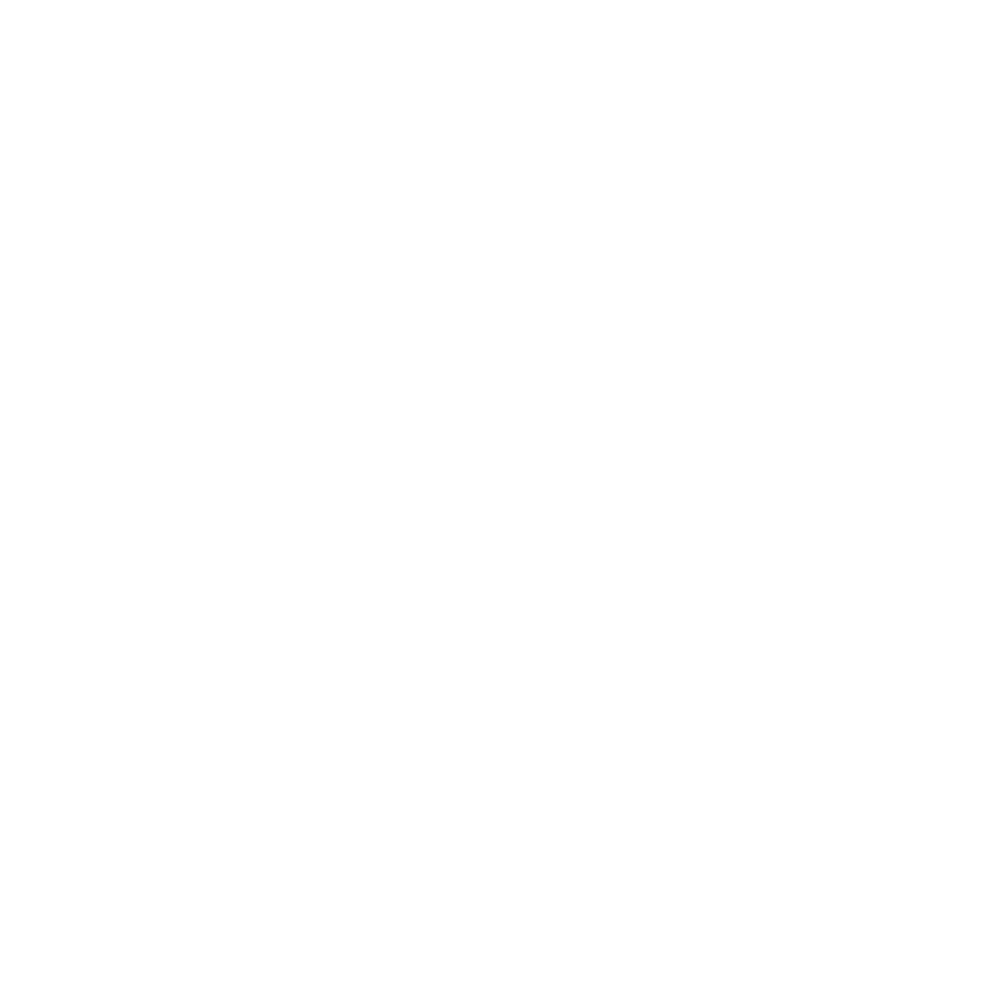

Fitting H4_647 on fov: Conv_zscan_08.tif


<IPython.core.display.Javascript object>


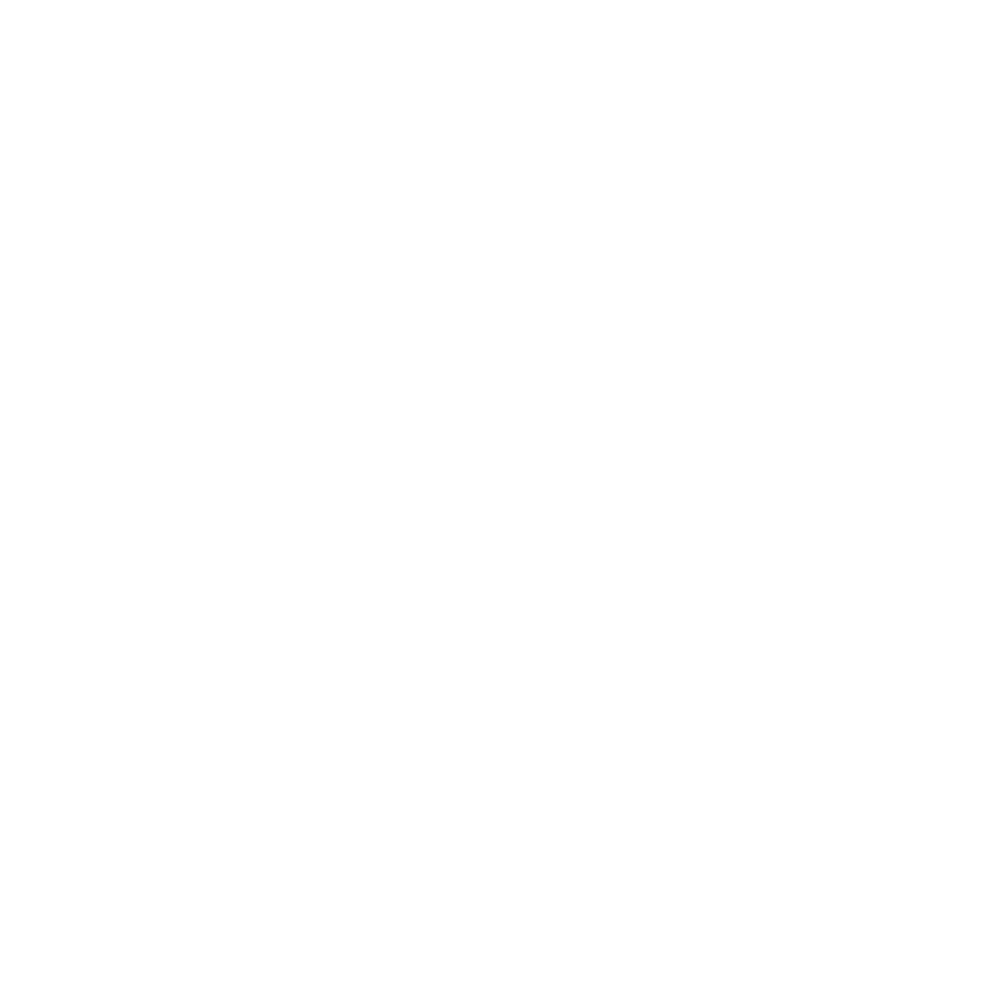

Drift correcting H5 on fov: Conv_zscan_08.tif
Fitting H5_750 on fov: Conv_zscan_08.tif


<IPython.core.display.Javascript object>


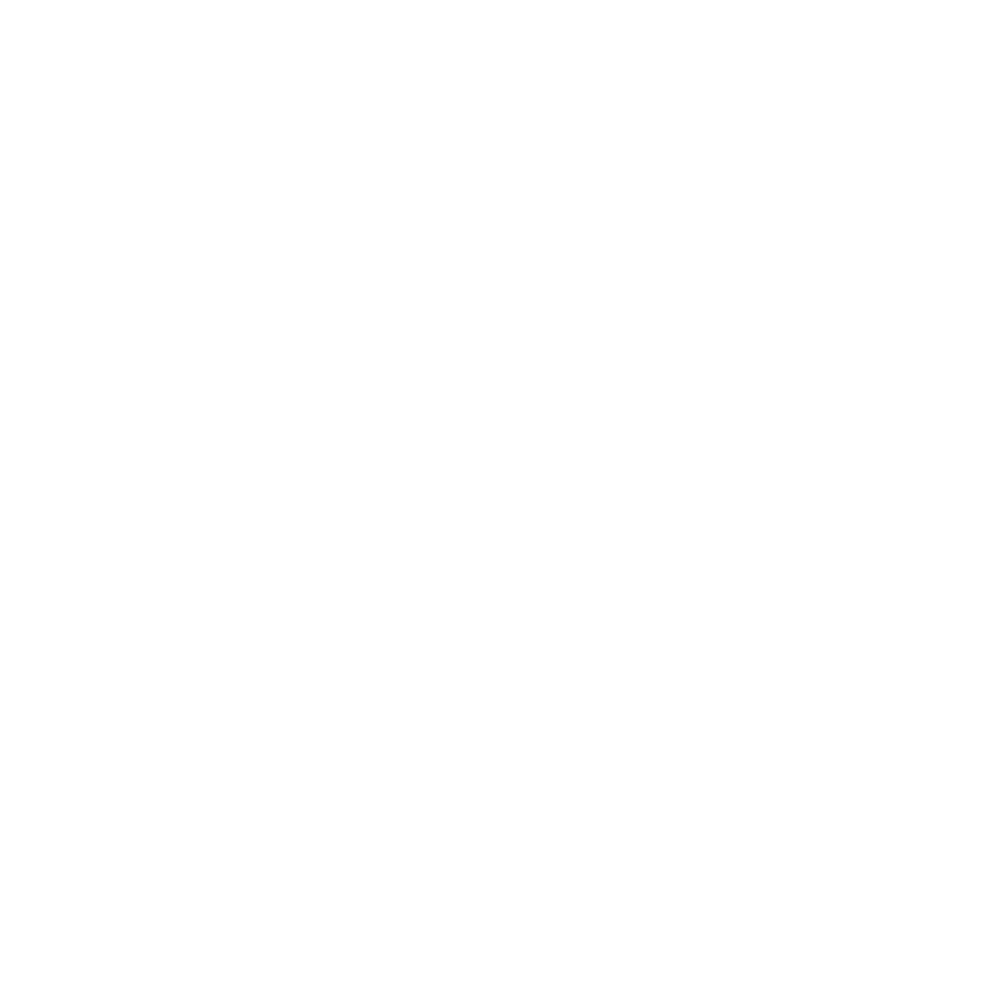

Fitting H5_647 on fov: Conv_zscan_08.tif


<IPython.core.display.Javascript object>


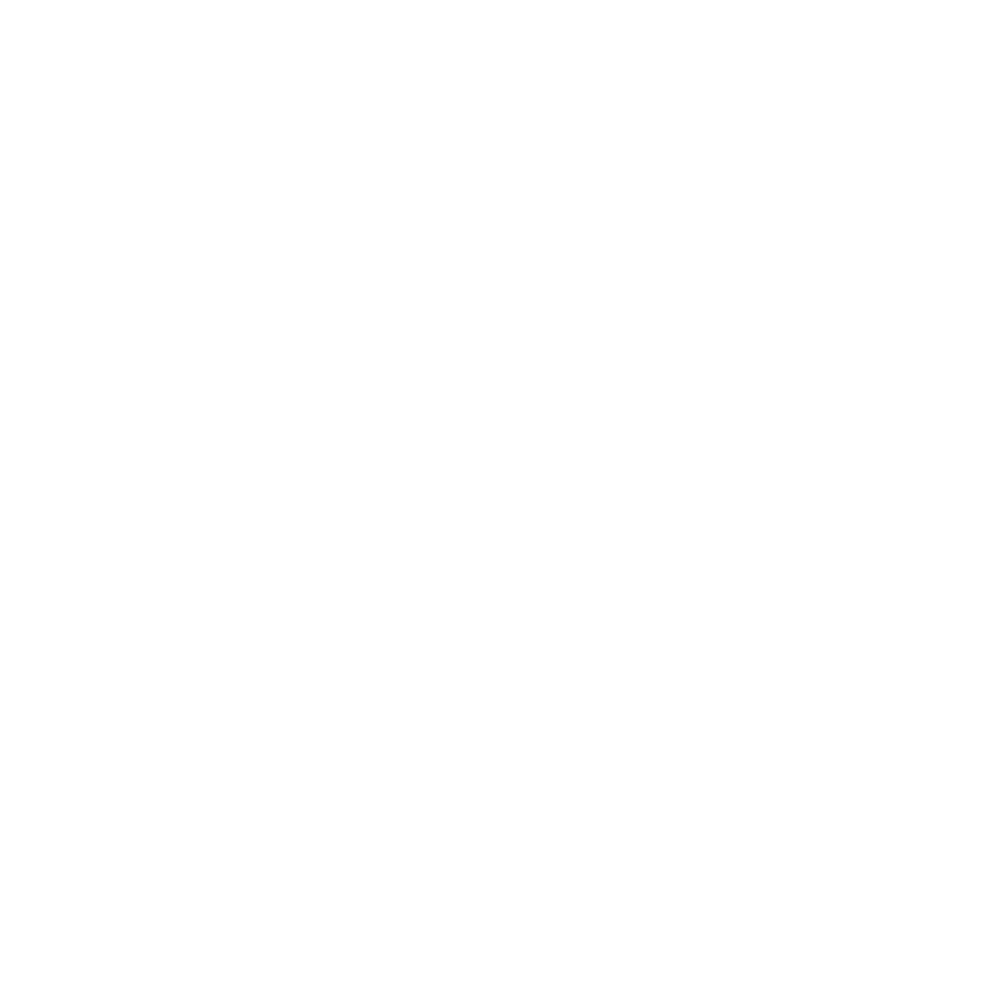

Drift correcting H6 on fov: Conv_zscan_08.tif
Fitting H6_750 on fov: Conv_zscan_08.tif


<IPython.core.display.Javascript object>


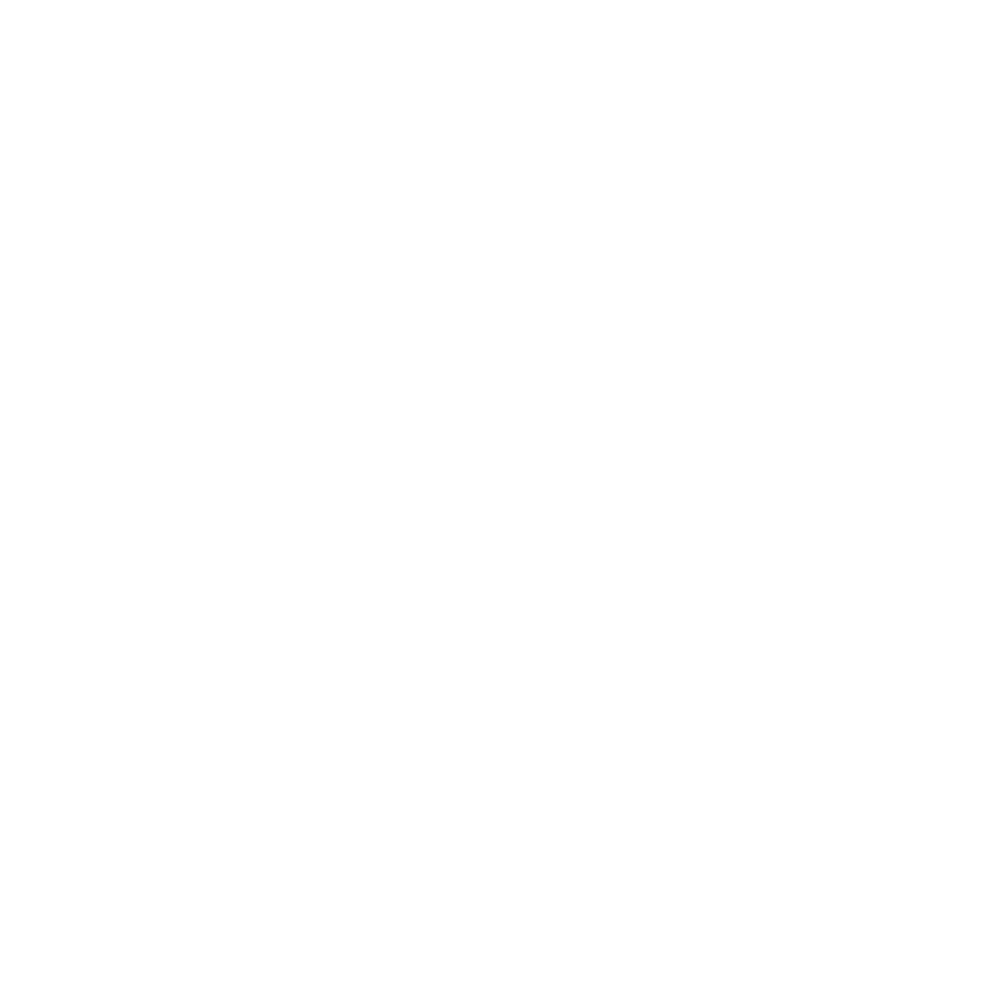

Fitting H6_647 on fov: Conv_zscan_08.tif


<IPython.core.display.Javascript object>


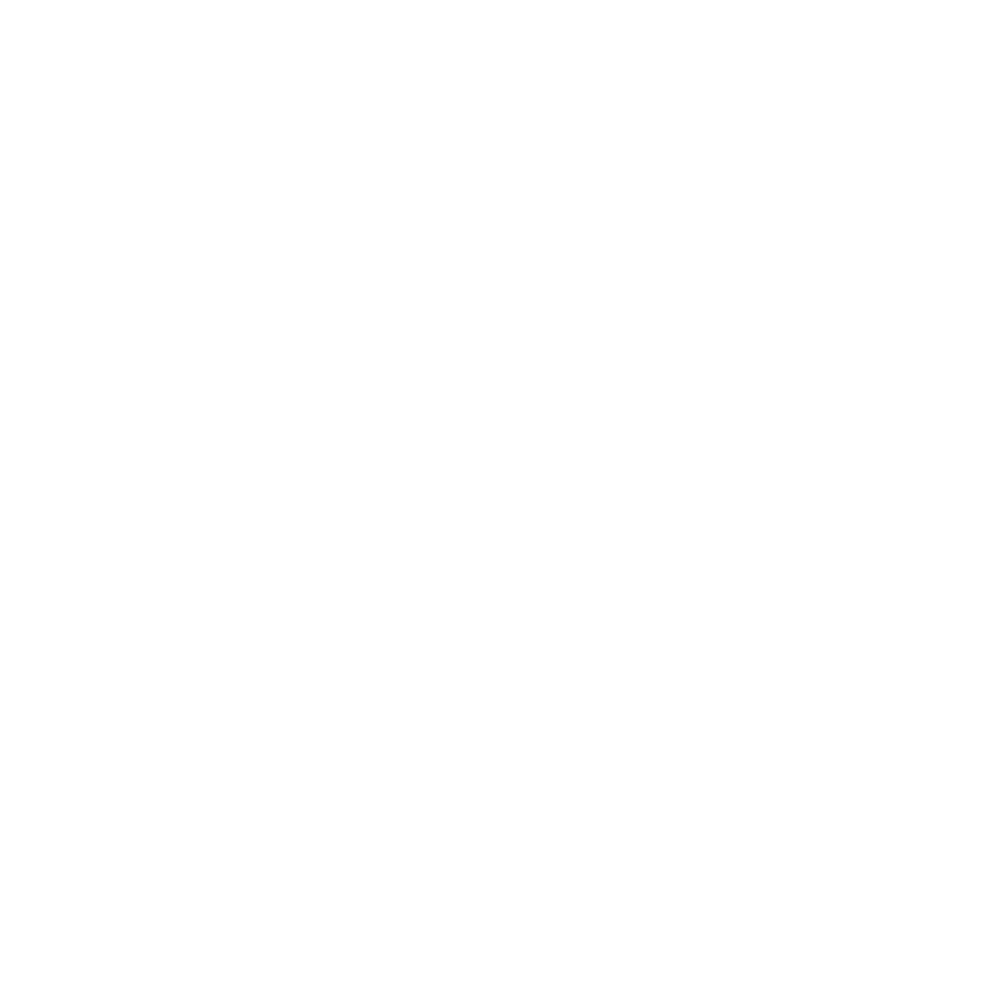

Estimating number of cells based on dapi image on fov: Conv_zscan_08.tif


<IPython.core.display.Javascript object>


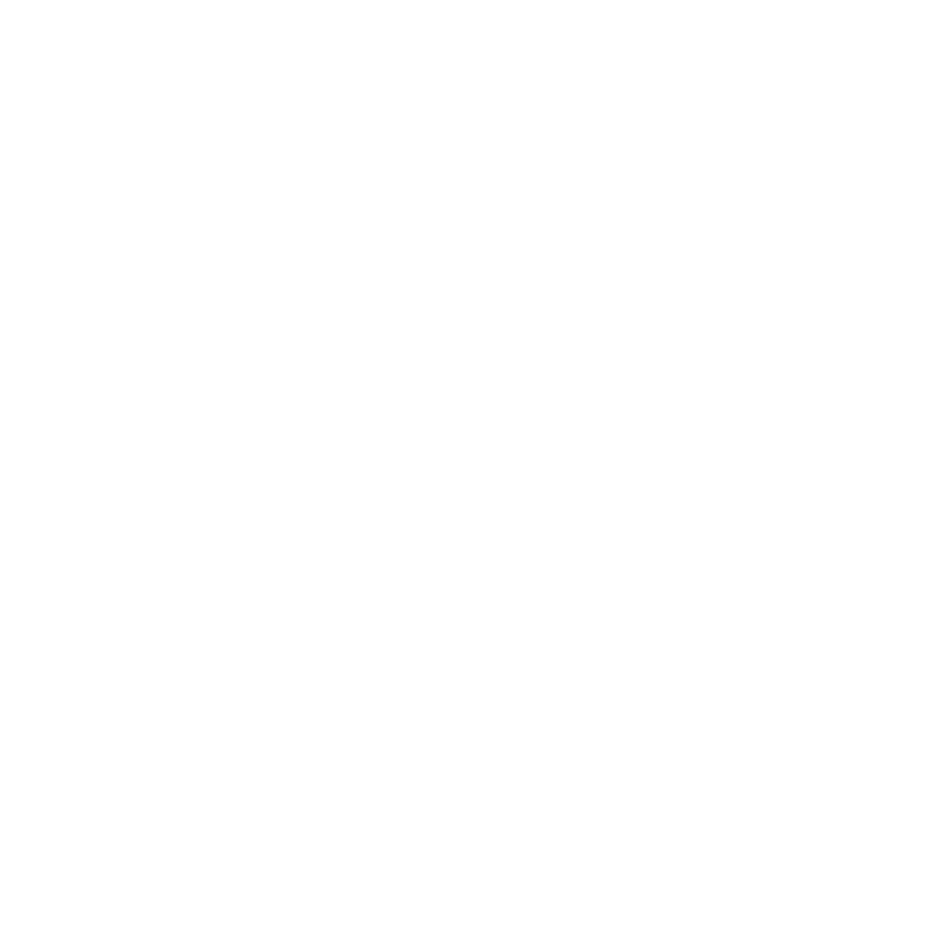

<ipython-input-27-1886a2f7fea2>:20: TqdmDeprecationWarning: This function will be removed in tqdm==5.0.0
Please use `tqdm.notebook.tqdm` instead of `tqdm.tqdm_notebook`
  for fld in tqdm(folders):



Drift correcting H1 on fov: Conv_zscan_09.tif
Fitting H1_750 on fov: Conv_zscan_09.tif


<IPython.core.display.Javascript object>


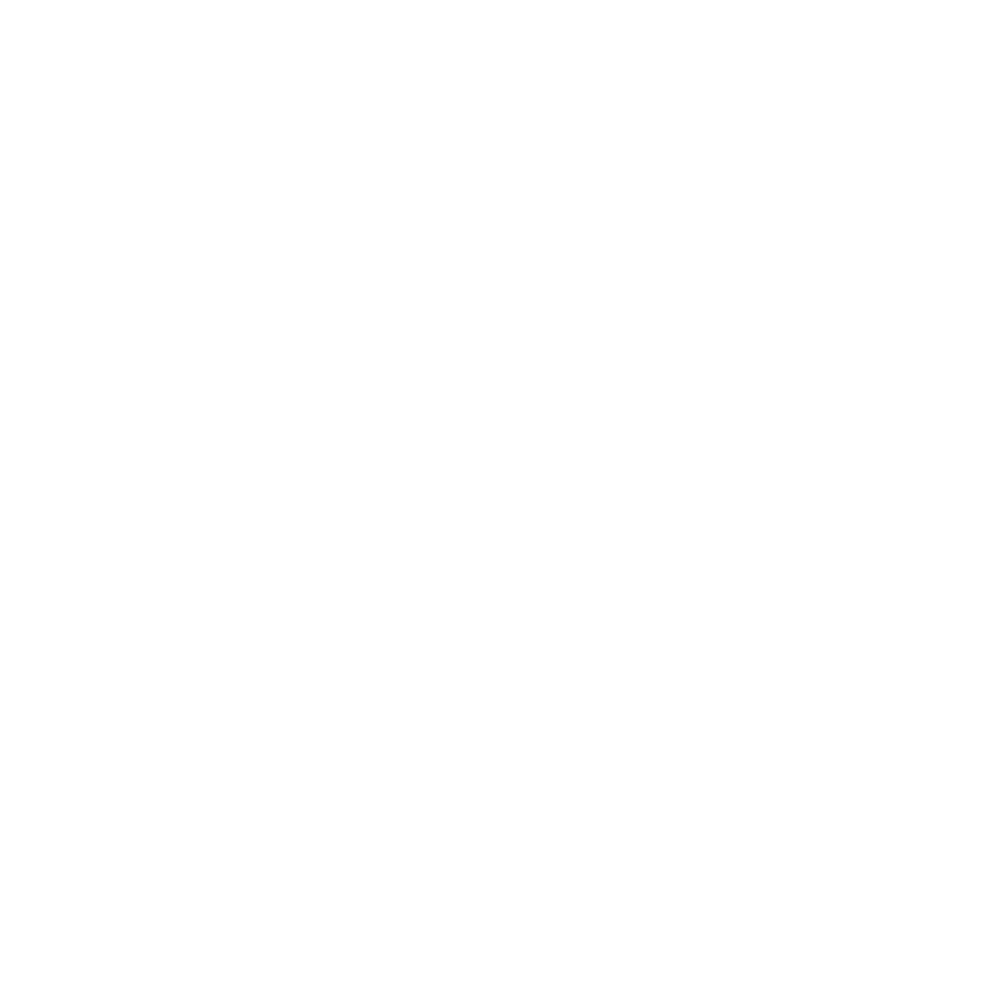

Fitting H1_647 on fov: Conv_zscan_09.tif


<IPython.core.display.Javascript object>


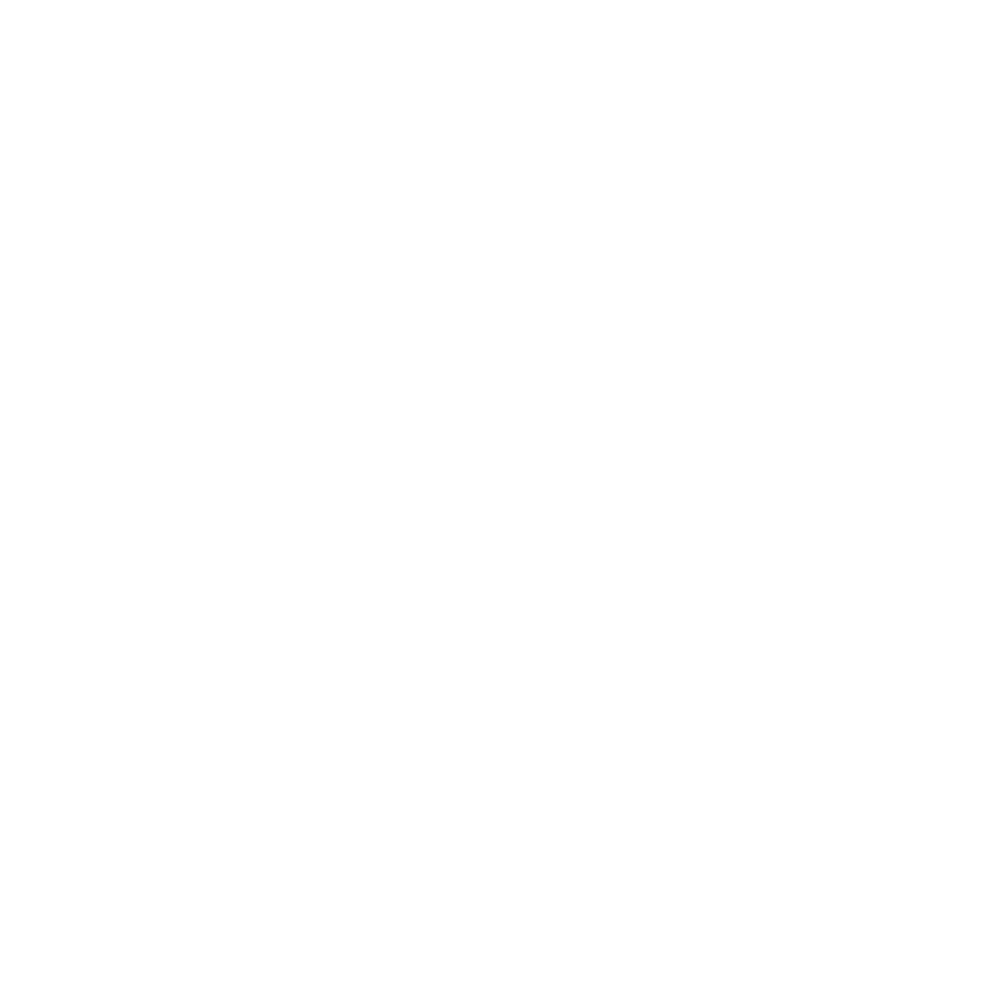

Drift correcting H2 on fov: Conv_zscan_09.tif
Fitting H2_750 on fov: Conv_zscan_09.tif


<IPython.core.display.Javascript object>


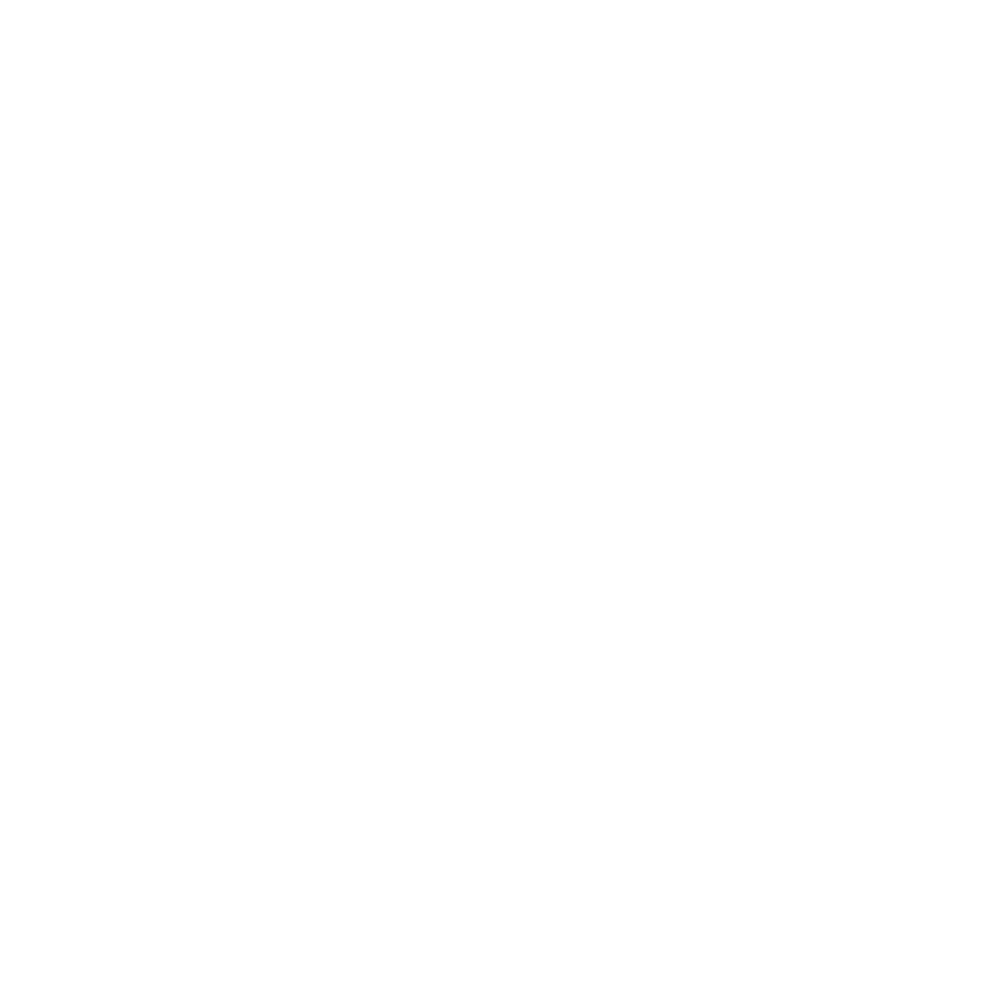

Fitting H2_647 on fov: Conv_zscan_09.tif


<IPython.core.display.Javascript object>


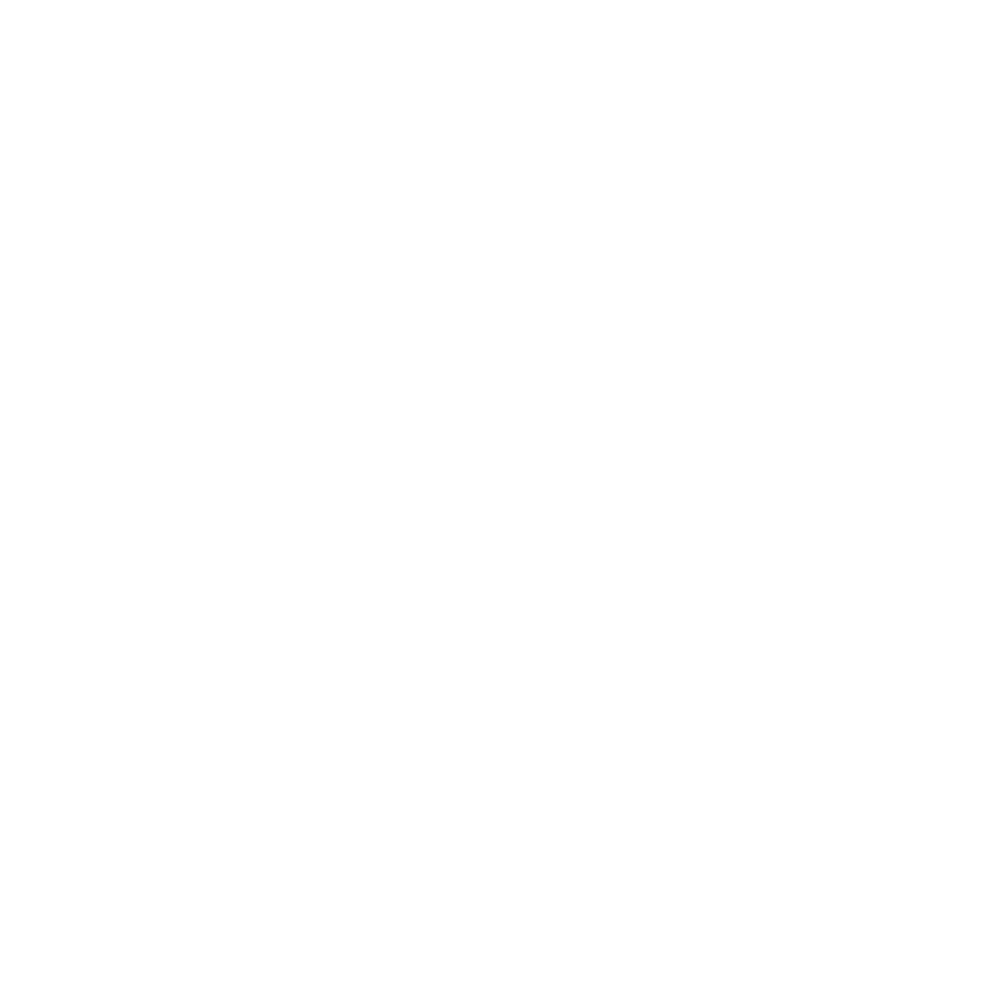

Drift correcting H3 on fov: Conv_zscan_09.tif
Fitting H3_750 on fov: Conv_zscan_09.tif


<IPython.core.display.Javascript object>


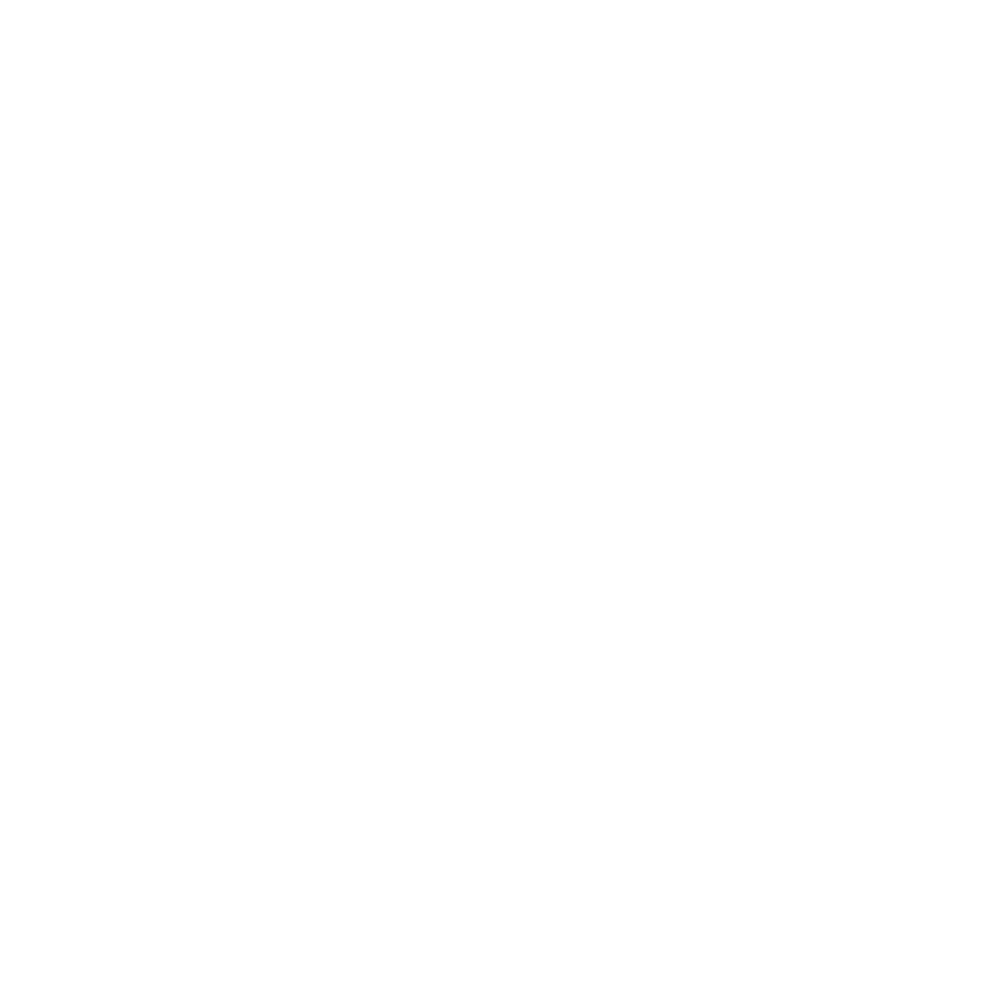

Fitting H3_647 on fov: Conv_zscan_09.tif


<IPython.core.display.Javascript object>


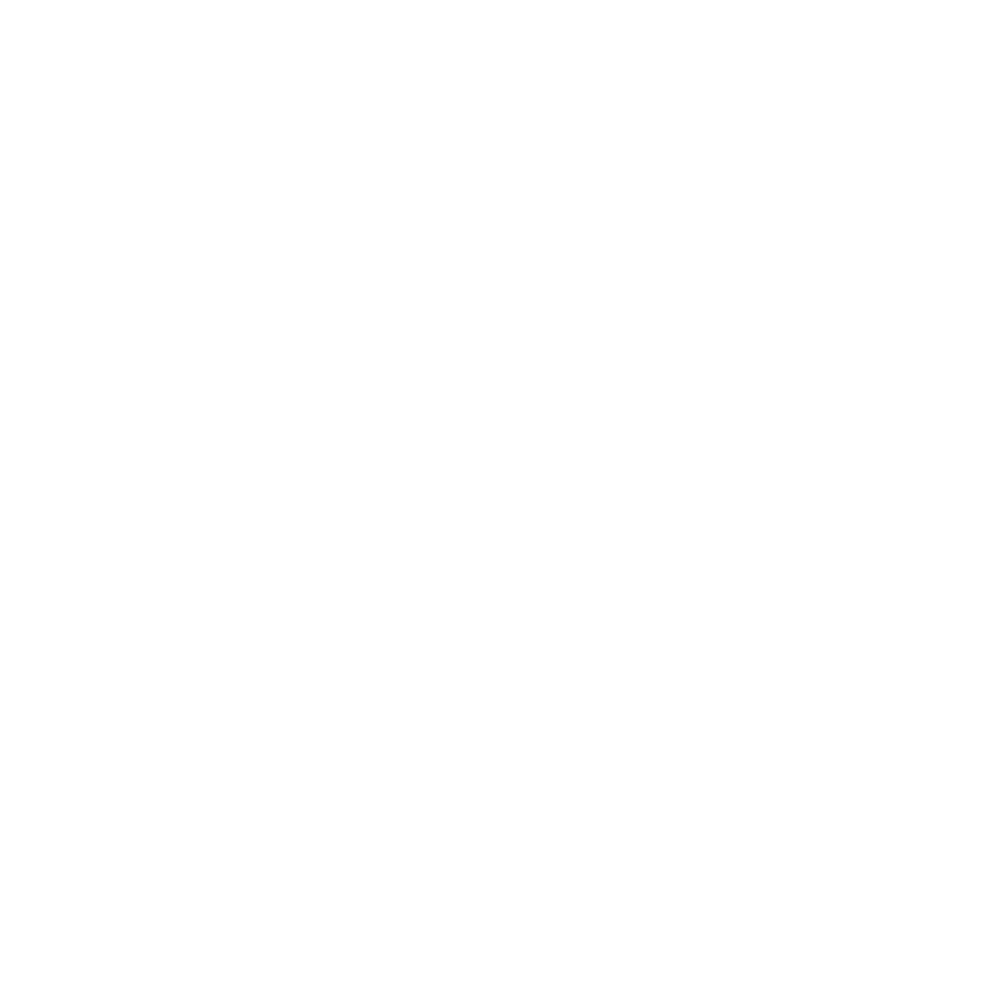

Drift correcting H4 on fov: Conv_zscan_09.tif
Fitting H4_750 on fov: Conv_zscan_09.tif


<IPython.core.display.Javascript object>


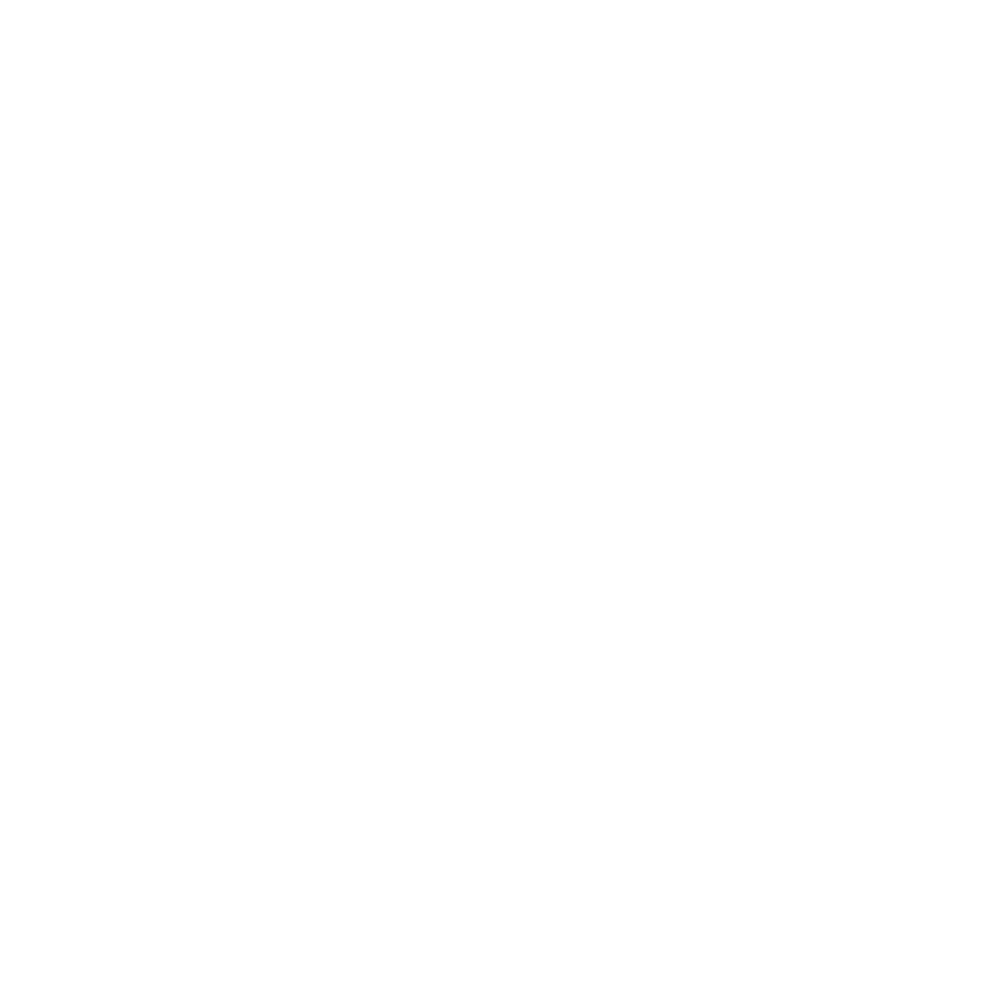

Fitting H4_647 on fov: Conv_zscan_09.tif


<IPython.core.display.Javascript object>


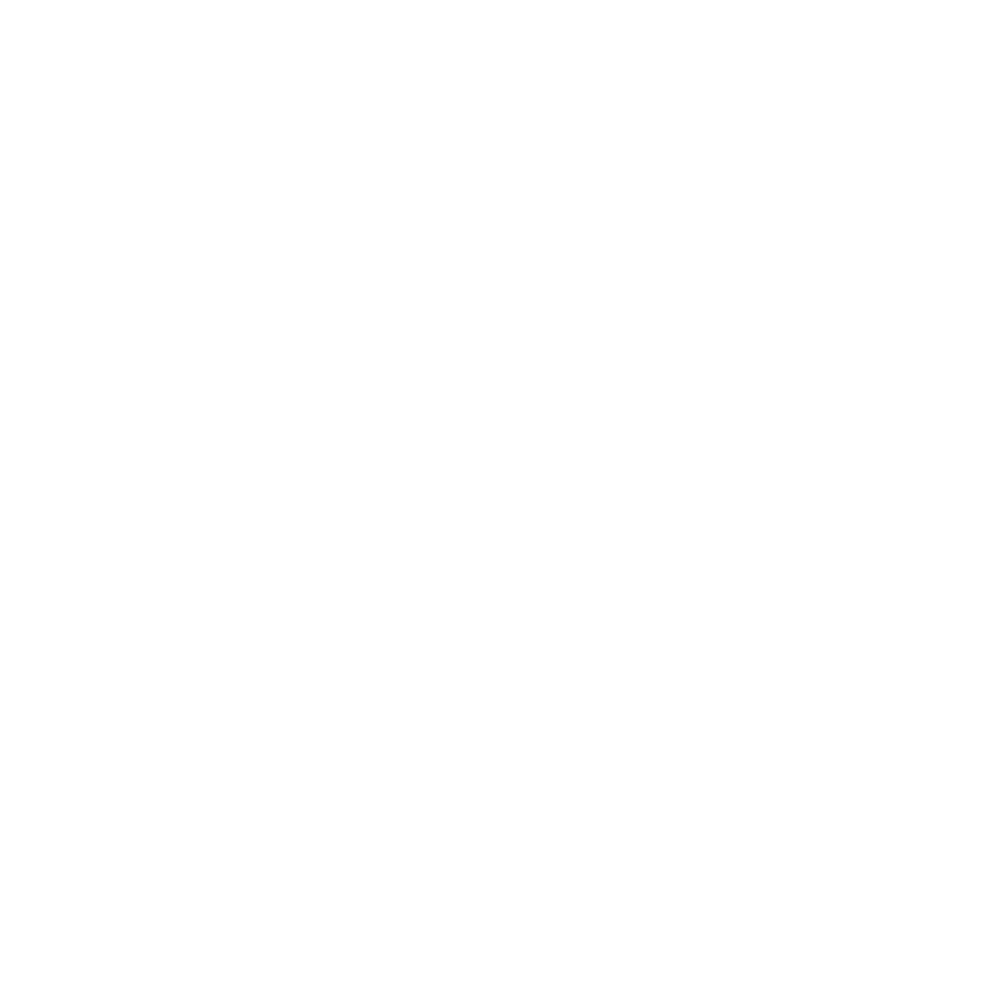

Drift correcting H5 on fov: Conv_zscan_09.tif
Fitting H5_750 on fov: Conv_zscan_09.tif


<IPython.core.display.Javascript object>


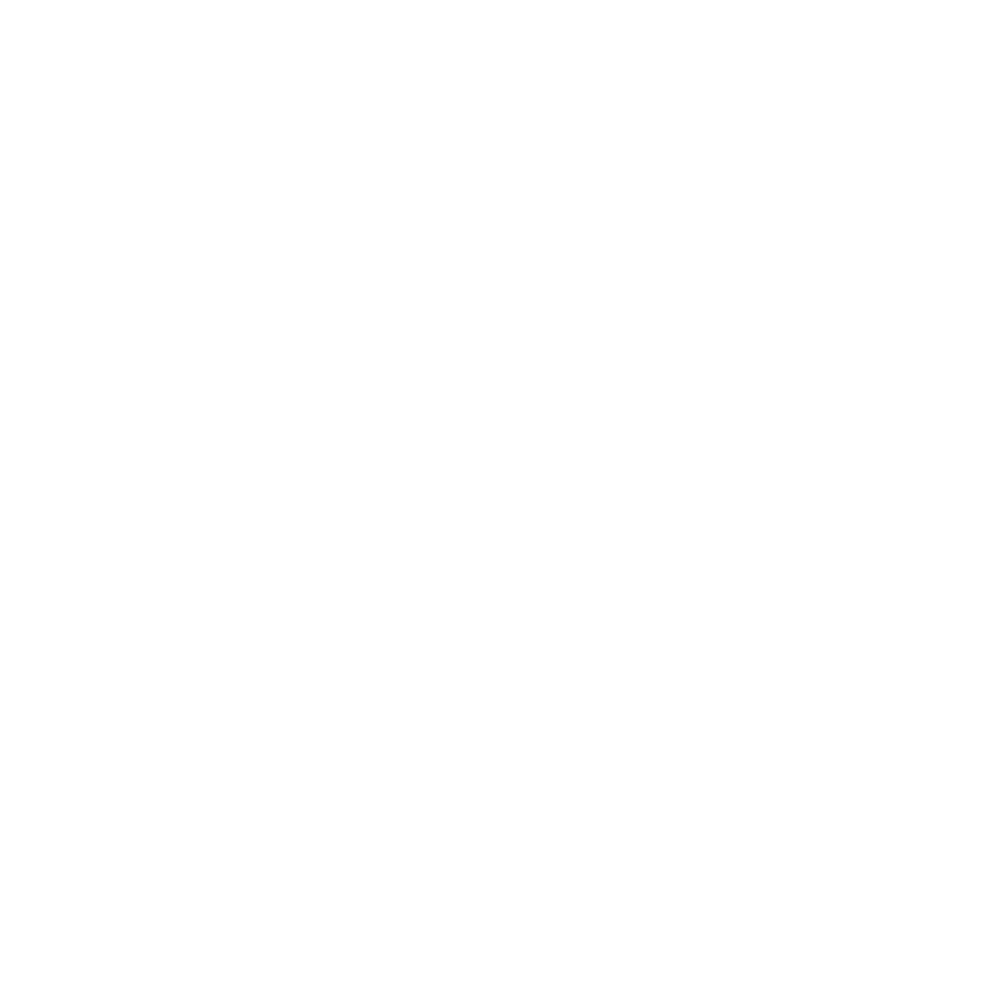

Fitting H5_647 on fov: Conv_zscan_09.tif


<IPython.core.display.Javascript object>


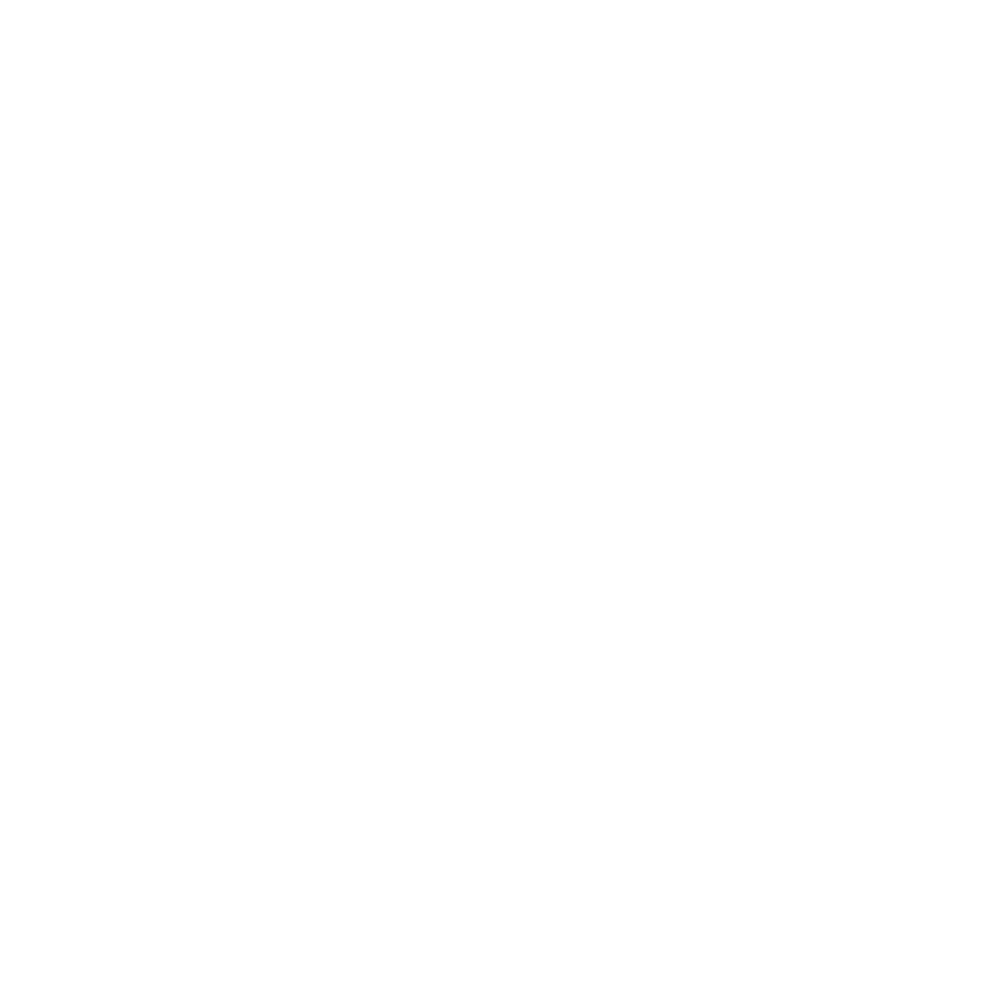

Drift correcting H6 on fov: Conv_zscan_09.tif
Fitting H6_750 on fov: Conv_zscan_09.tif


<IPython.core.display.Javascript object>


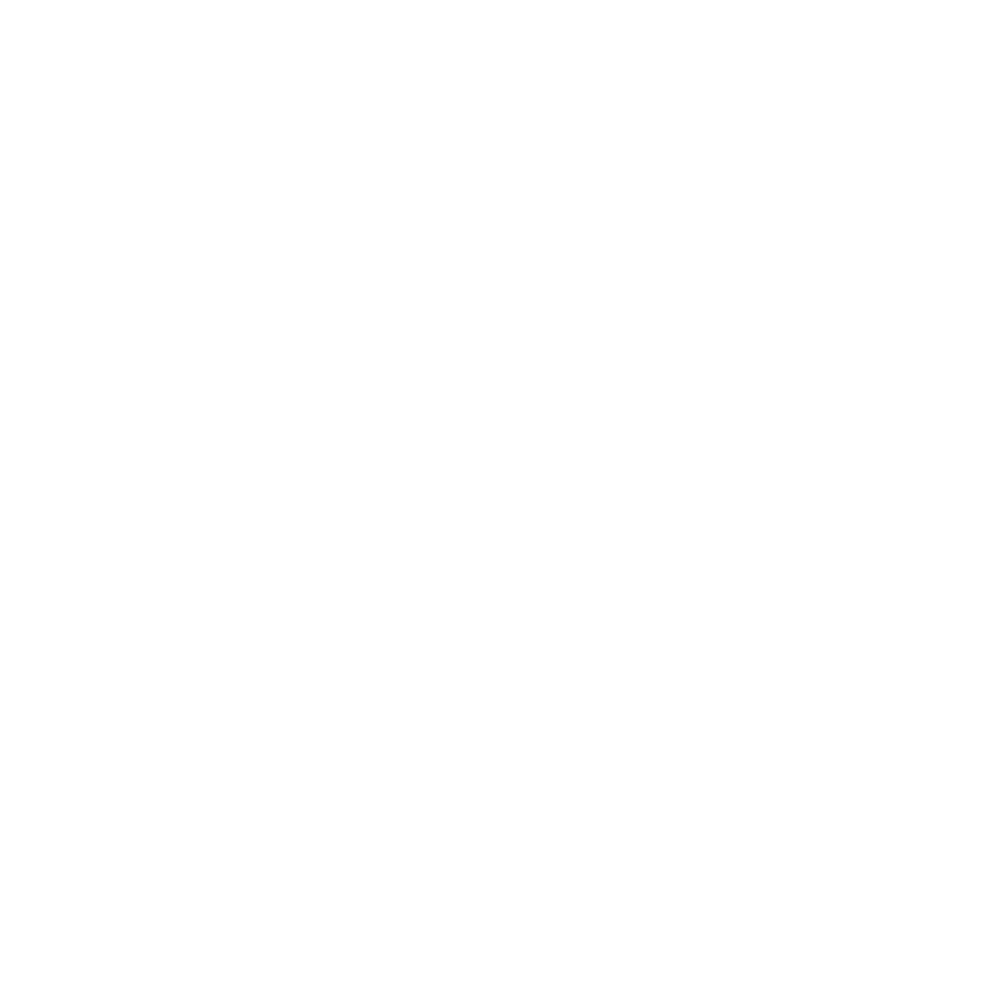

Fitting H6_647 on fov: Conv_zscan_09.tif


<IPython.core.display.Javascript object>


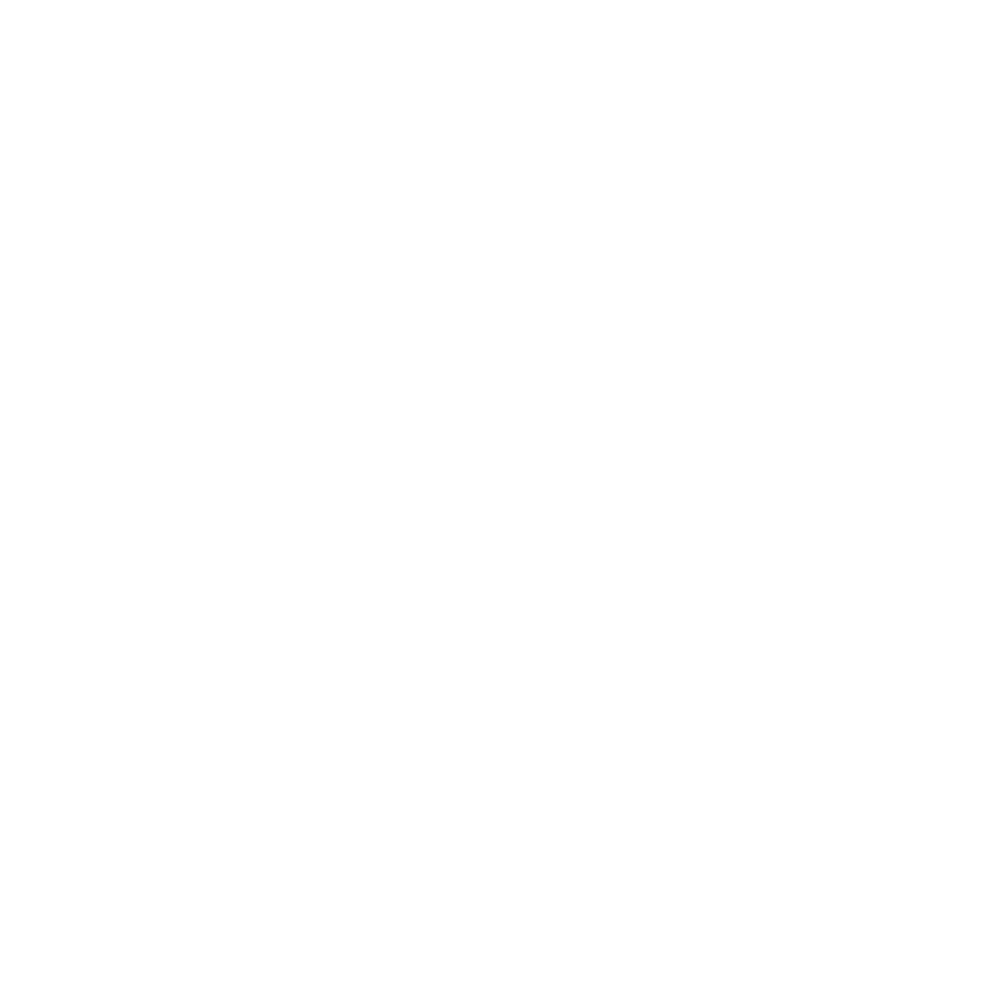

Estimating number of cells based on dapi image on fov: Conv_zscan_09.tif


<IPython.core.display.Javascript object>


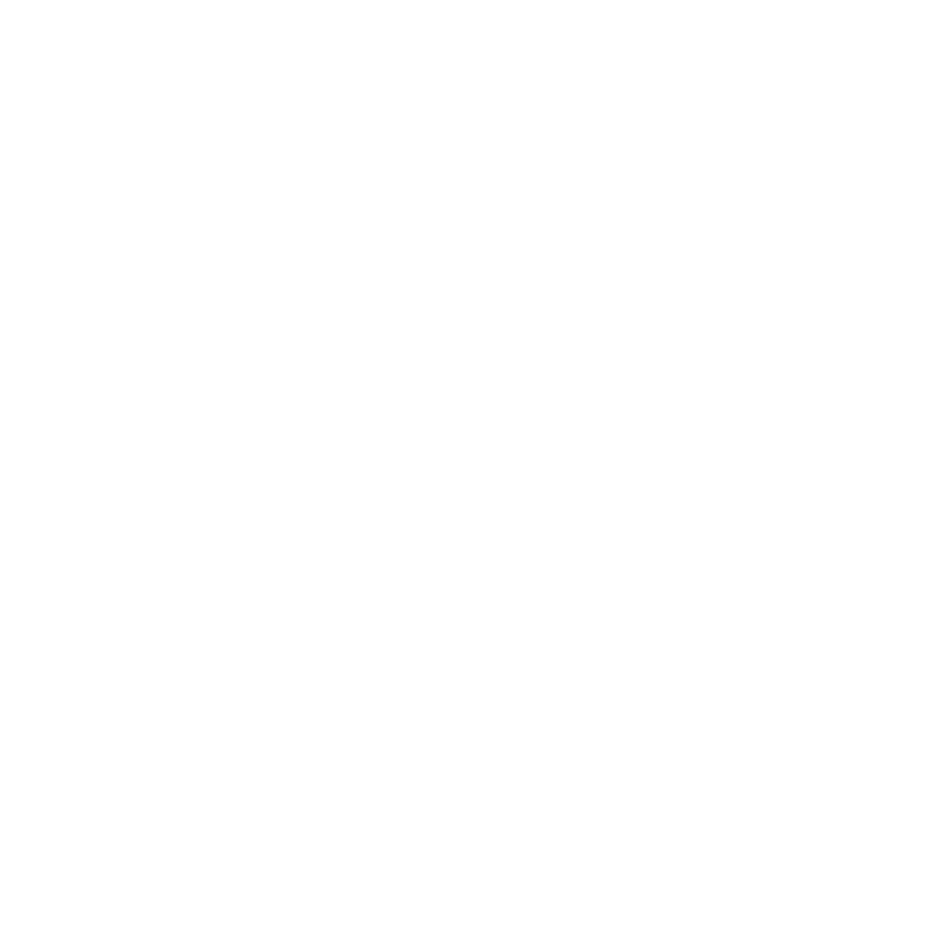

<ipython-input-27-1886a2f7fea2>:20: TqdmDeprecationWarning: This function will be removed in tqdm==5.0.0
Please use `tqdm.notebook.tqdm` instead of `tqdm.tqdm_notebook`
  for fld in tqdm(folders):



Drift correcting H1 on fov: Conv_zscan_10.tif
Fitting H1_750 on fov: Conv_zscan_10.tif


<IPython.core.display.Javascript object>


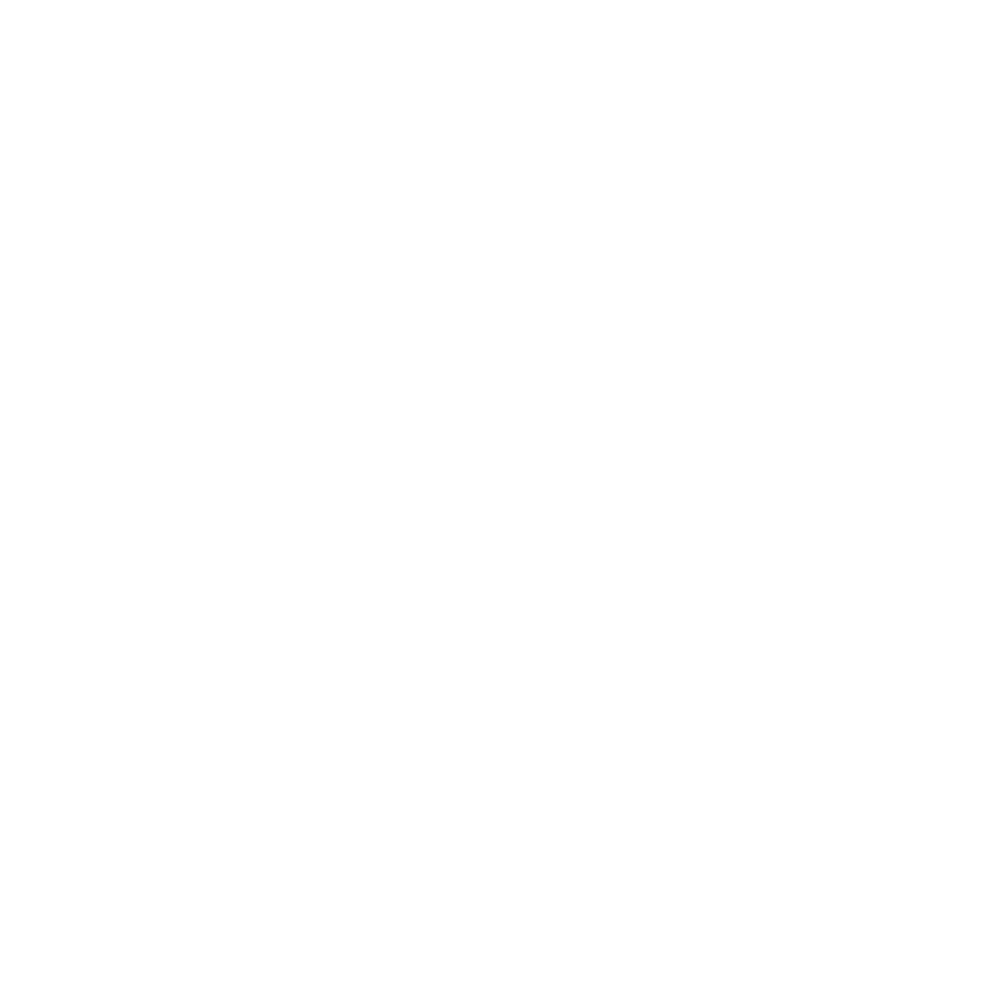

Fitting H1_647 on fov: Conv_zscan_10.tif


<IPython.core.display.Javascript object>


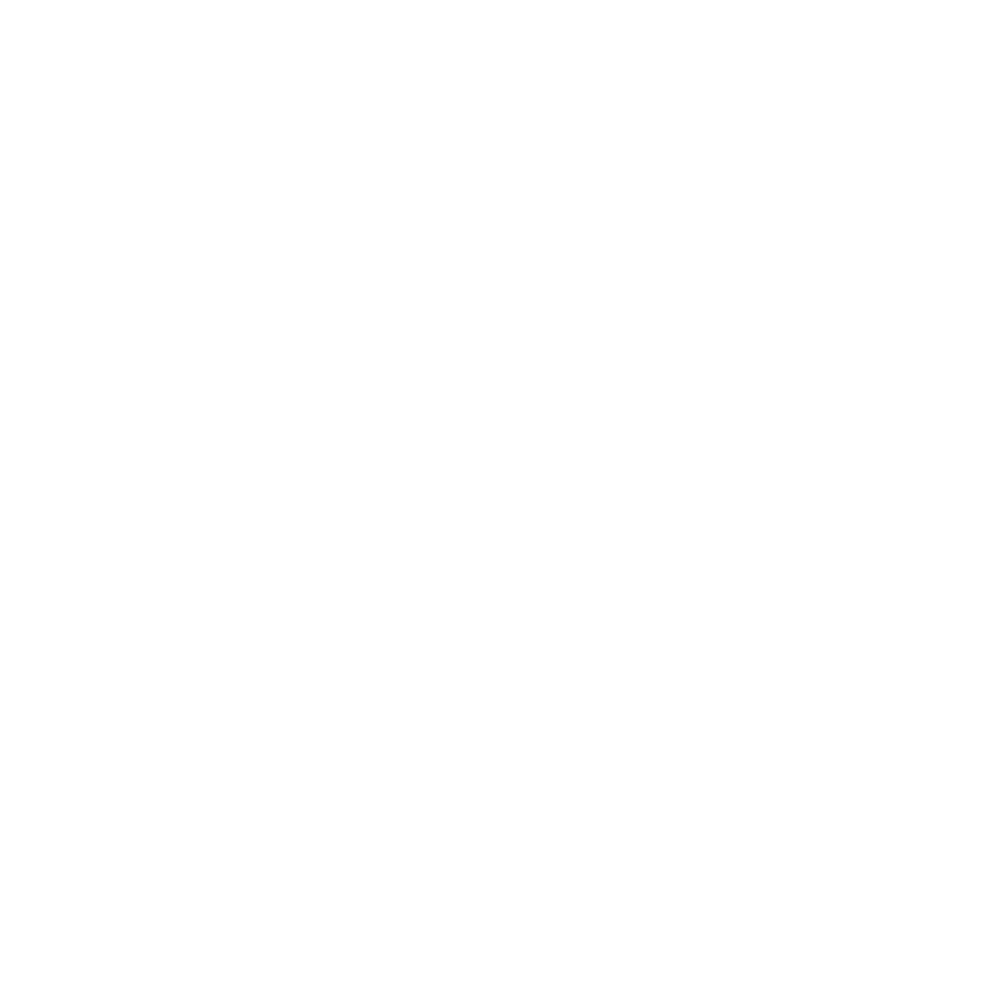

Drift correcting H2 on fov: Conv_zscan_10.tif
Fitting H2_750 on fov: Conv_zscan_10.tif


<IPython.core.display.Javascript object>


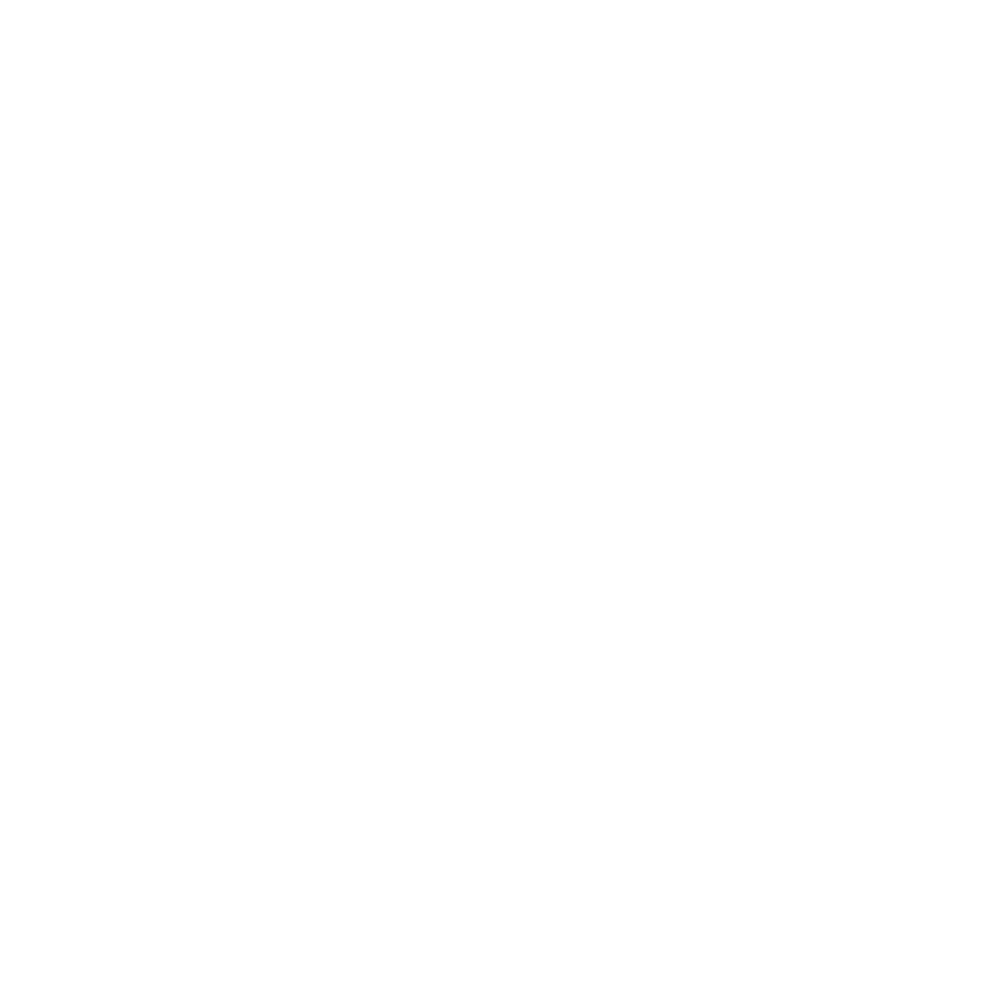

Fitting H2_647 on fov: Conv_zscan_10.tif


<IPython.core.display.Javascript object>


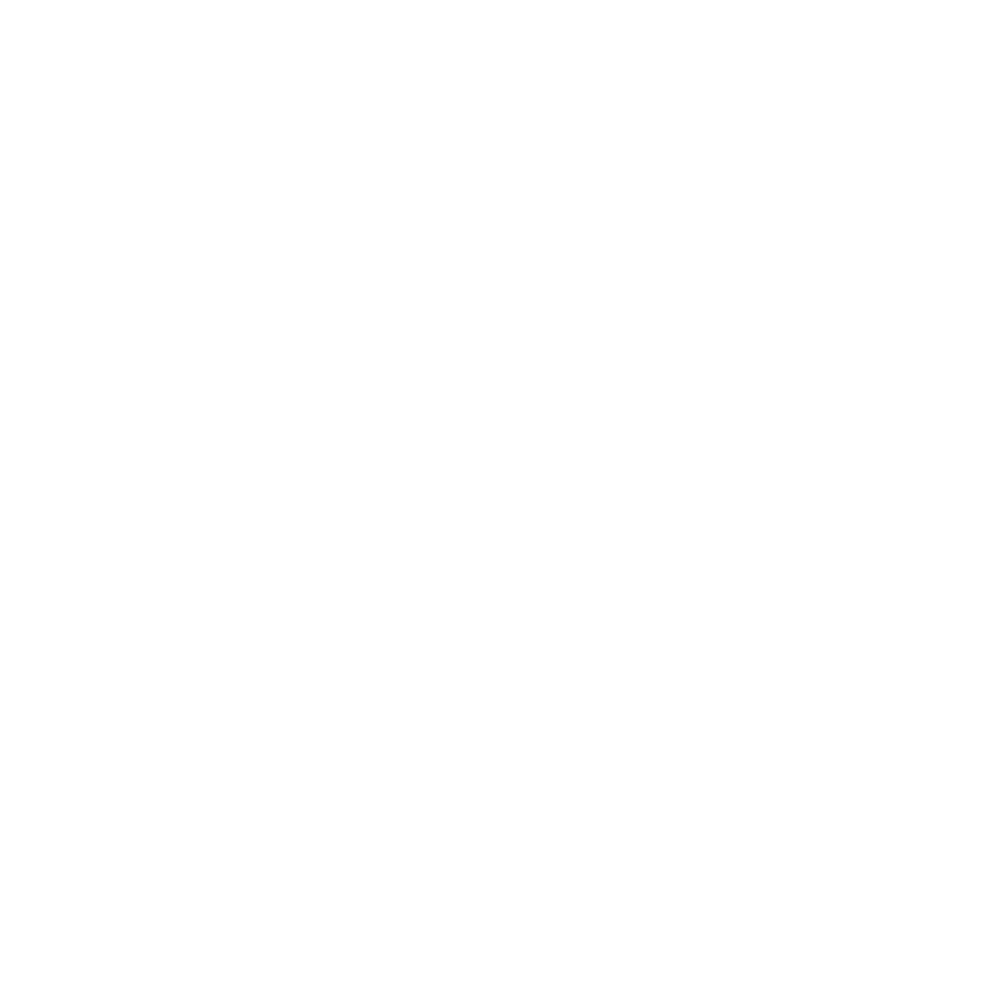

Drift correcting H3 on fov: Conv_zscan_10.tif
Fitting H3_750 on fov: Conv_zscan_10.tif


<IPython.core.display.Javascript object>


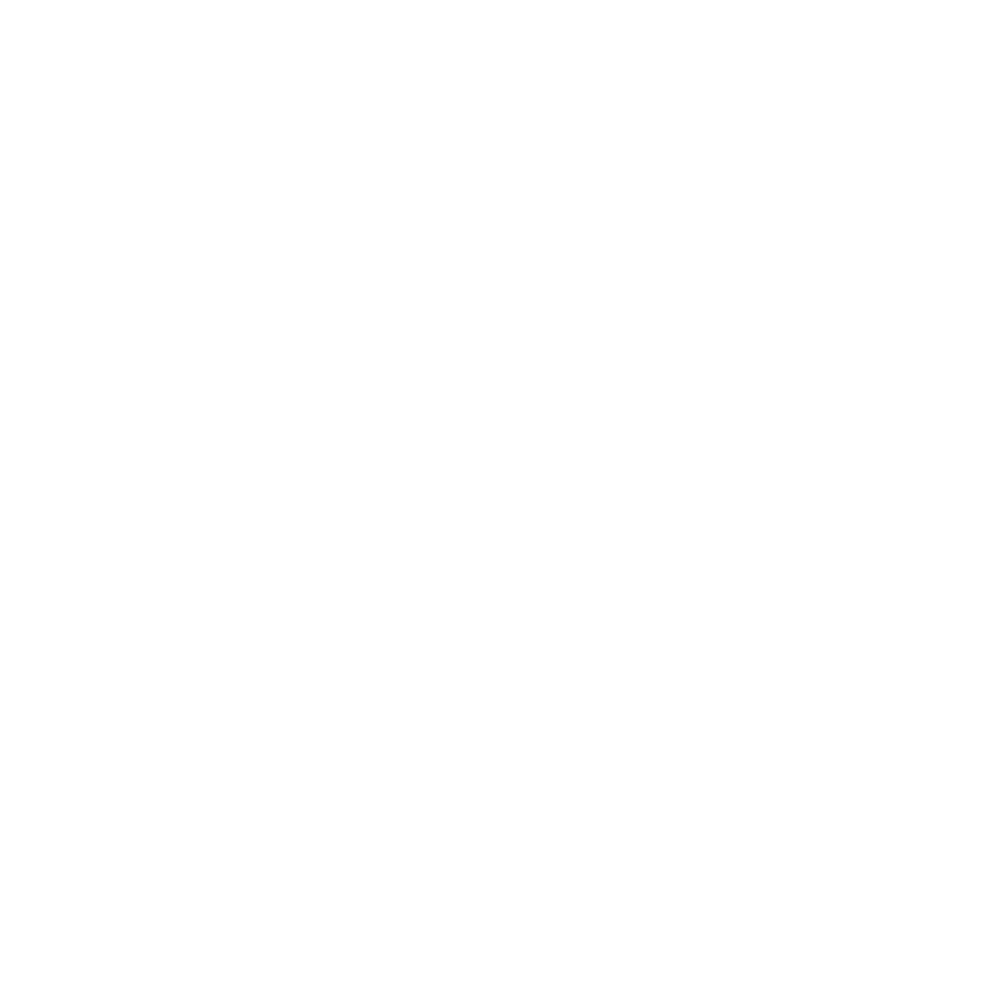

Fitting H3_647 on fov: Conv_zscan_10.tif


<IPython.core.display.Javascript object>


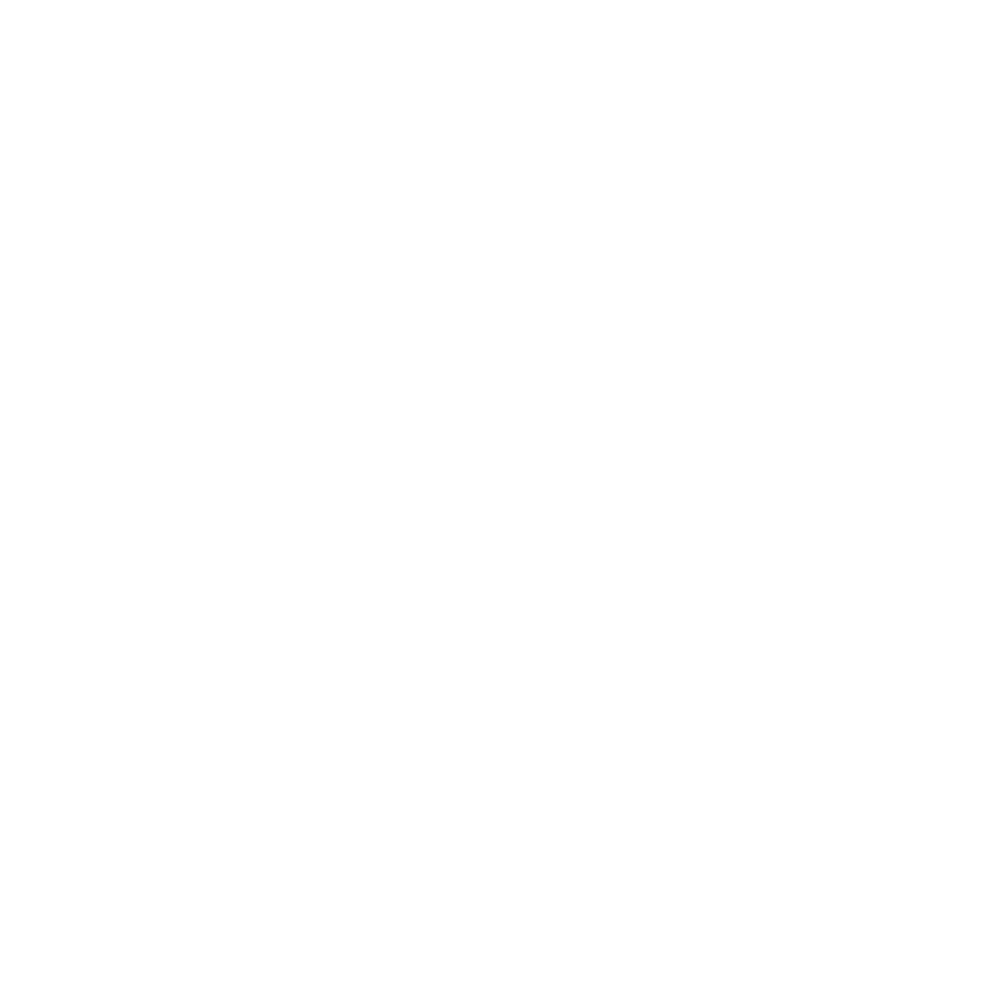

Drift correcting H4 on fov: Conv_zscan_10.tif
Fitting H4_750 on fov: Conv_zscan_10.tif


<IPython.core.display.Javascript object>


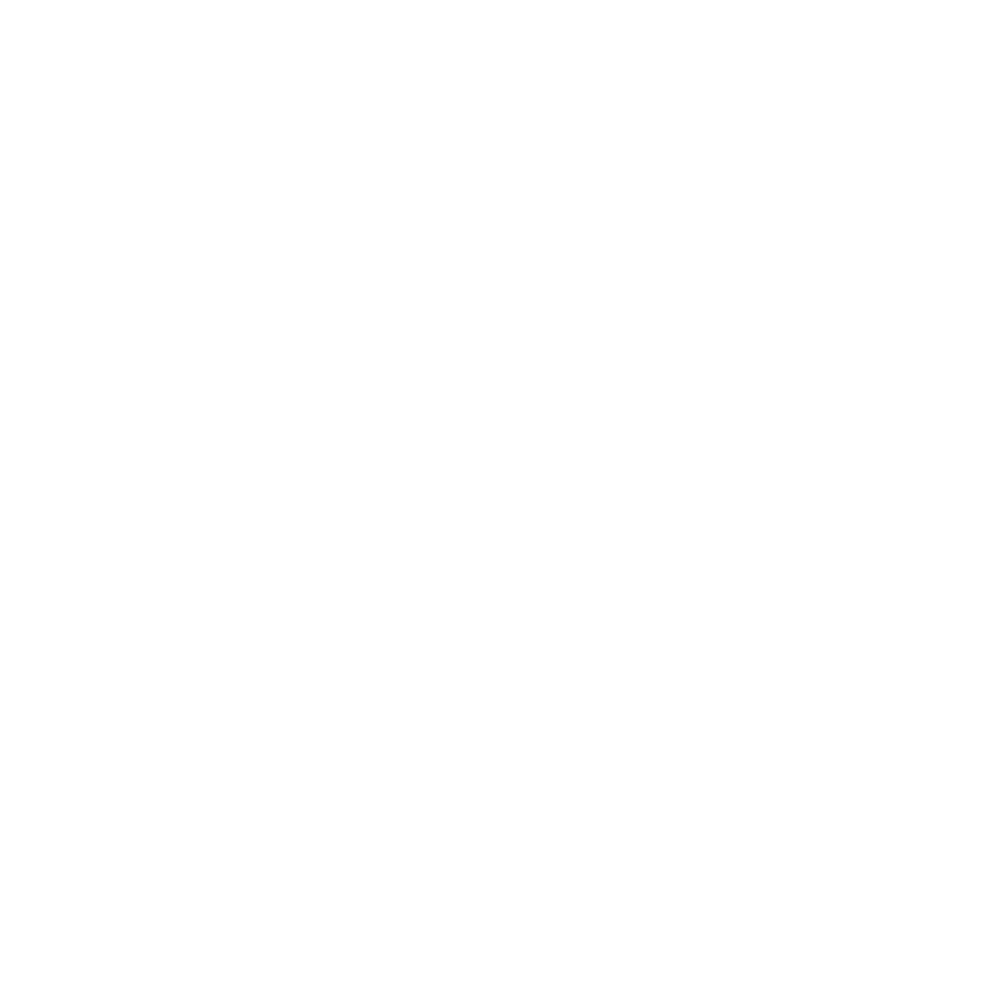

Fitting H4_647 on fov: Conv_zscan_10.tif


<IPython.core.display.Javascript object>


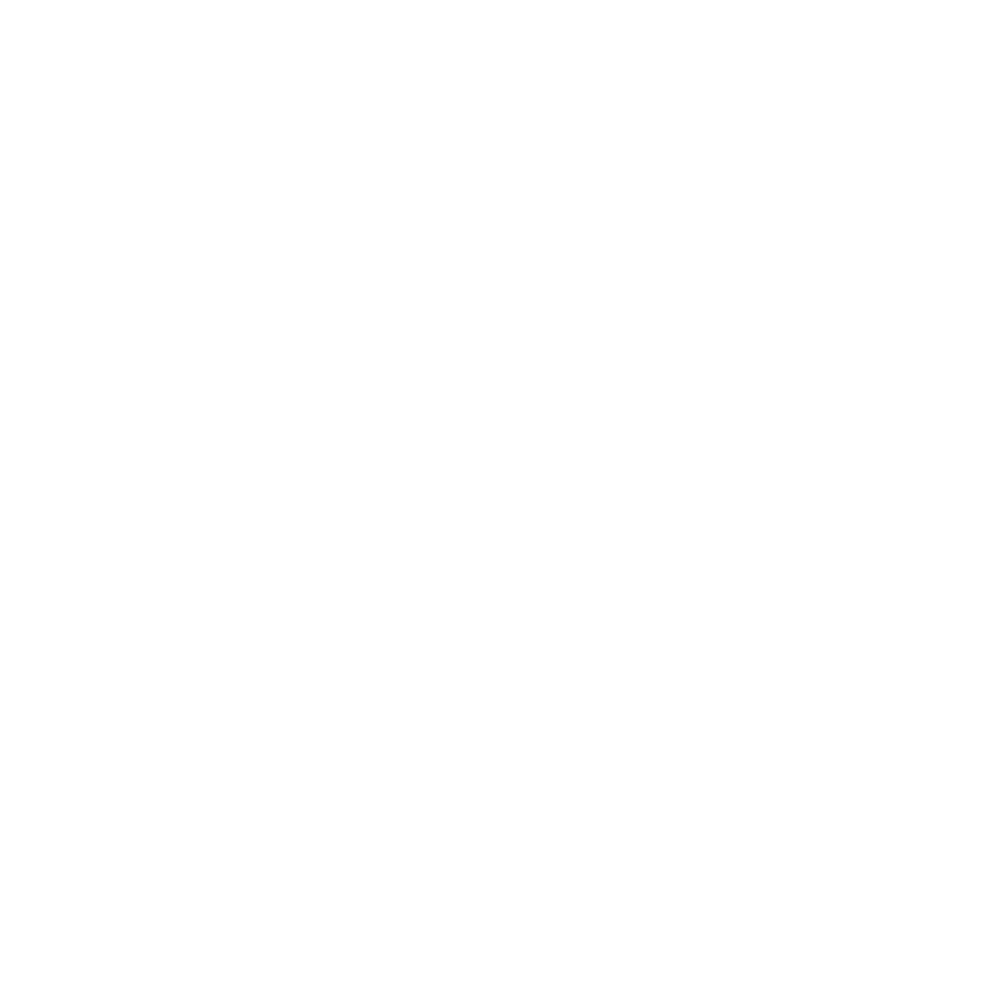

Drift correcting H5 on fov: Conv_zscan_10.tif
Fitting H5_750 on fov: Conv_zscan_10.tif


<IPython.core.display.Javascript object>


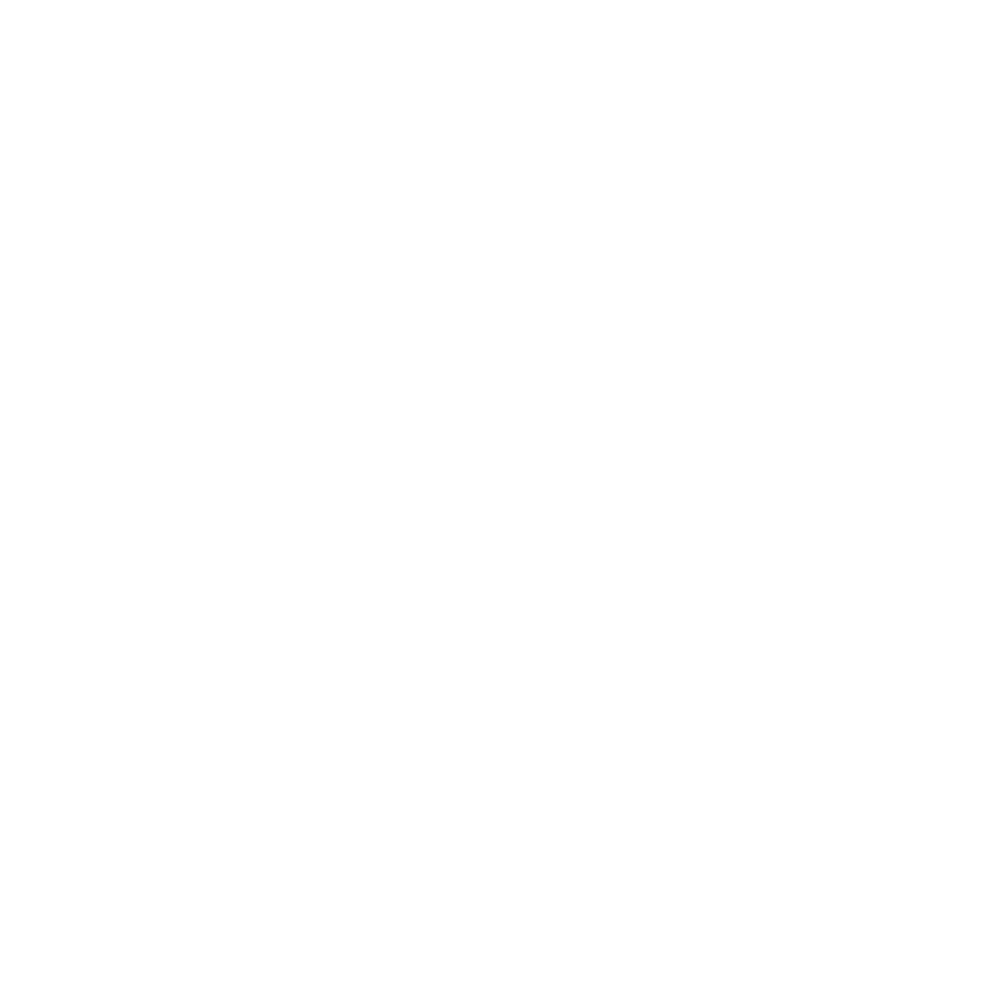

Fitting H5_647 on fov: Conv_zscan_10.tif


<IPython.core.display.Javascript object>


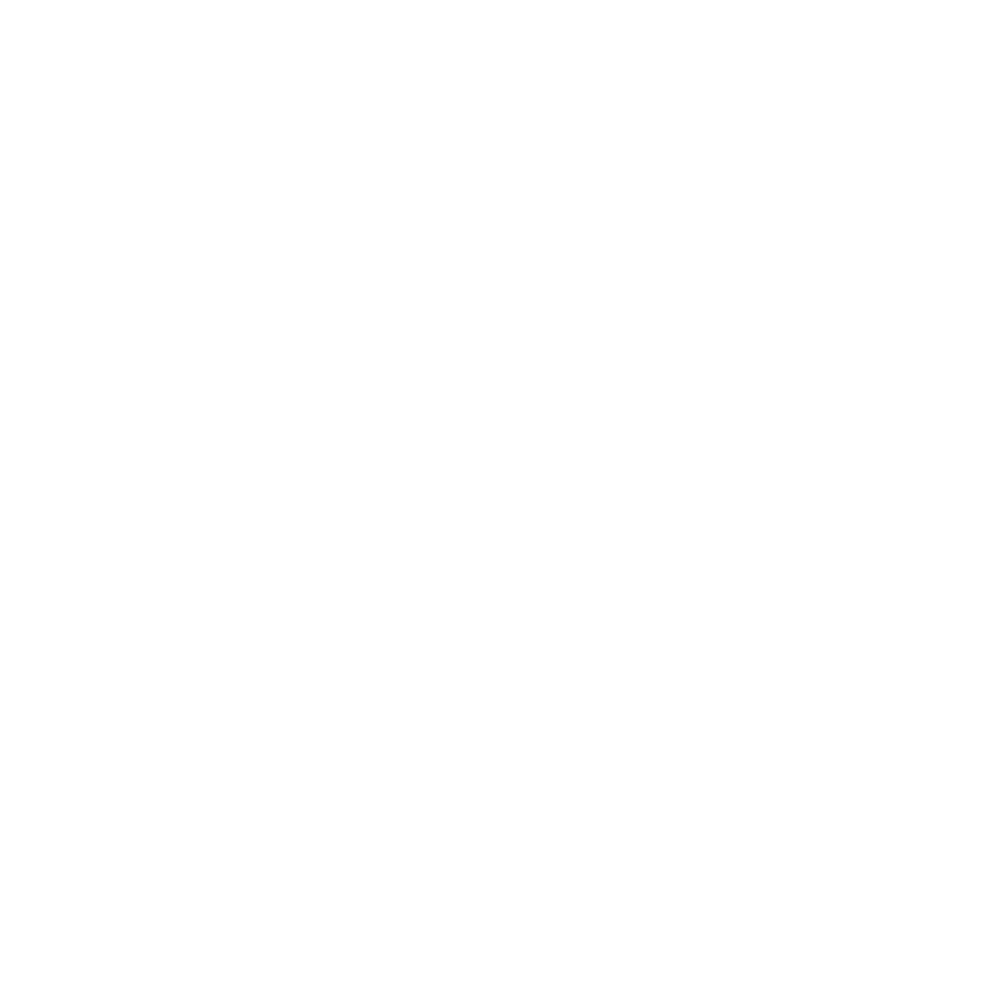

Drift correcting H6 on fov: Conv_zscan_10.tif
Fitting H6_750 on fov: Conv_zscan_10.tif


<IPython.core.display.Javascript object>


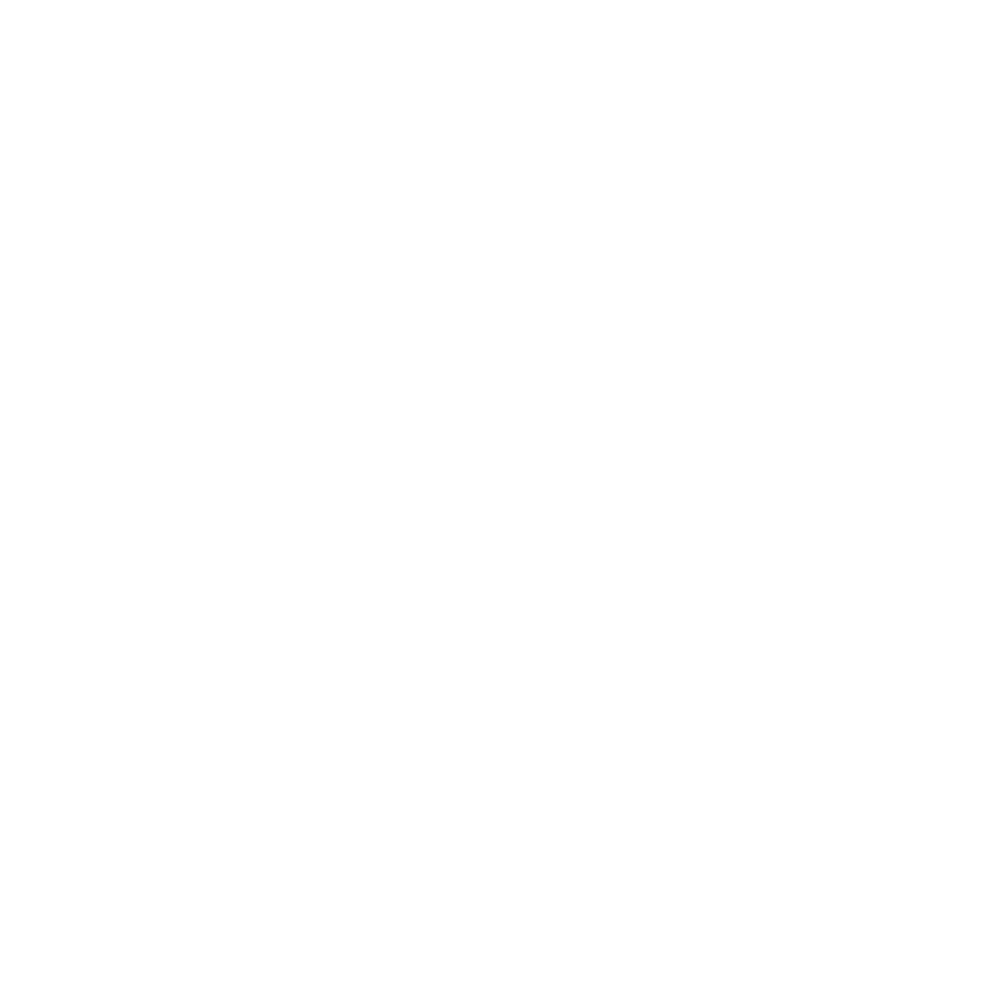

Fitting H6_647 on fov: Conv_zscan_10.tif


<IPython.core.display.Javascript object>


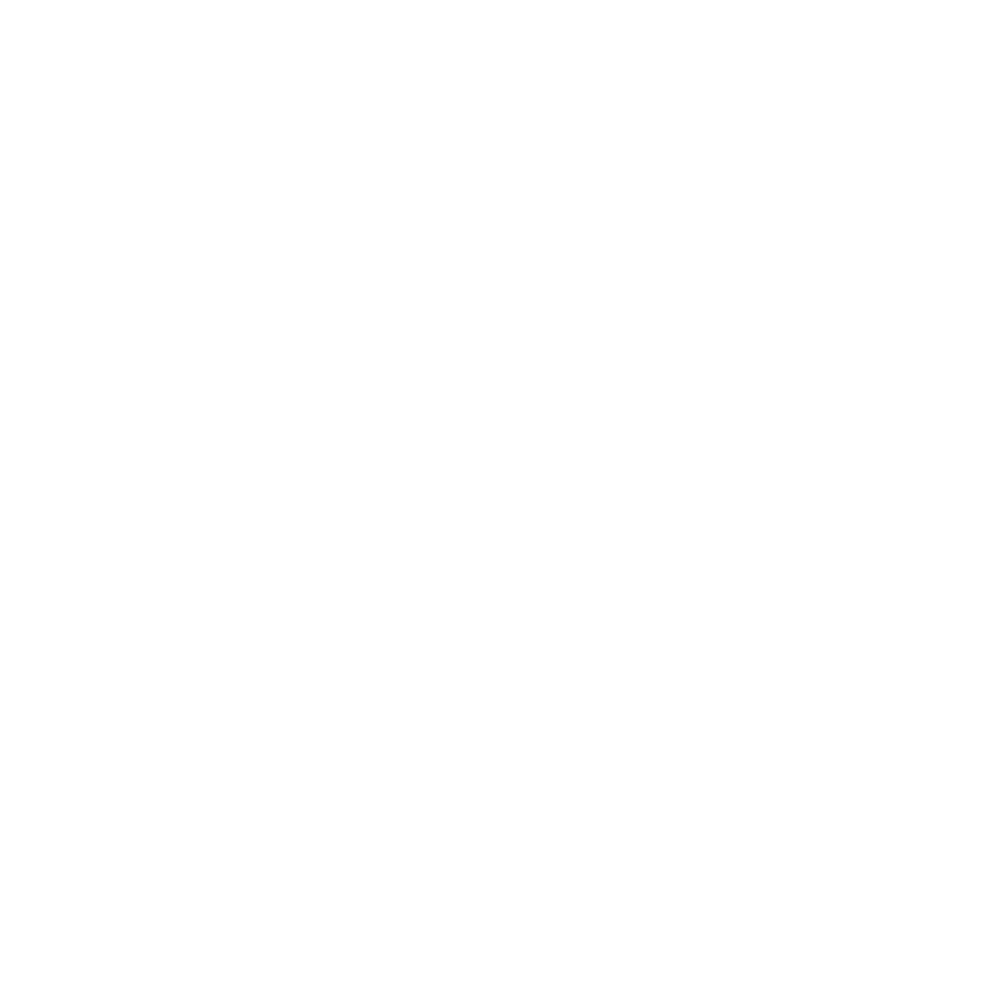

Estimating number of cells based on dapi image on fov: Conv_zscan_10.tif


<IPython.core.display.Javascript object>


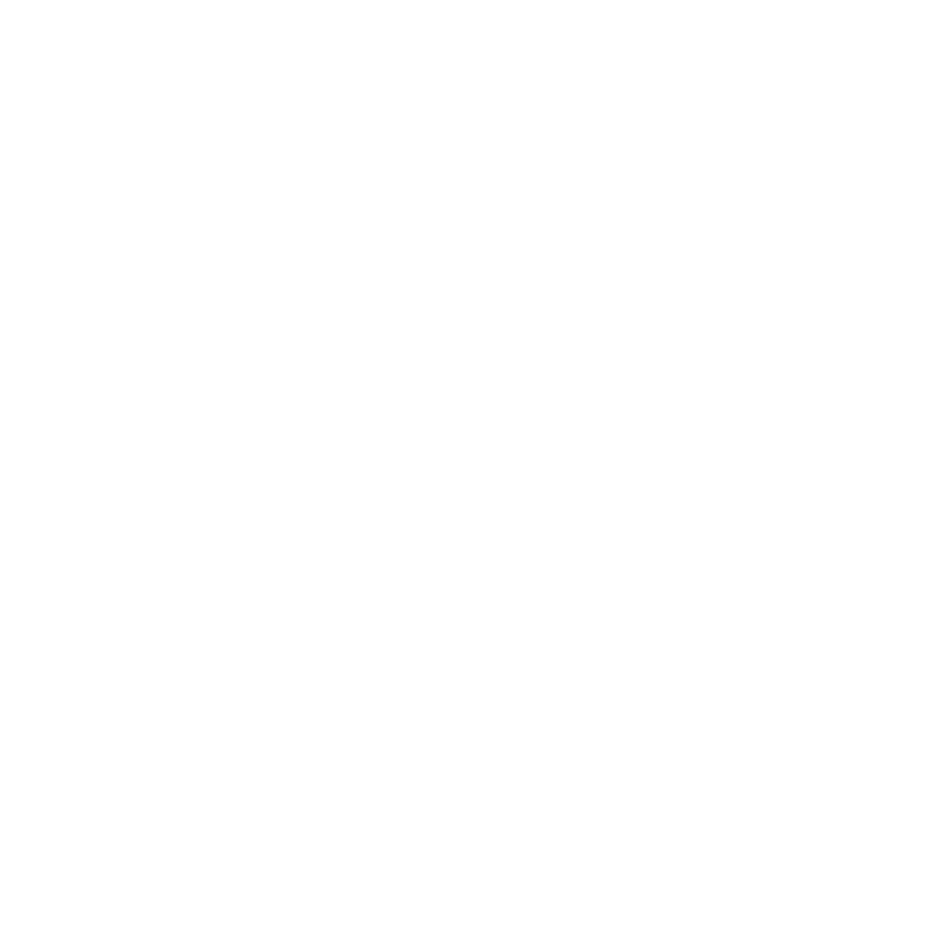

<ipython-input-27-1886a2f7fea2>:20: TqdmDeprecationWarning: This function will be removed in tqdm==5.0.0
Please use `tqdm.notebook.tqdm` instead of `tqdm.tqdm_notebook`
  for fld in tqdm(folders):



Drift correcting H1 on fov: Conv_zscan_11.tif
Fitting H1_750 on fov: Conv_zscan_11.tif


<IPython.core.display.Javascript object>


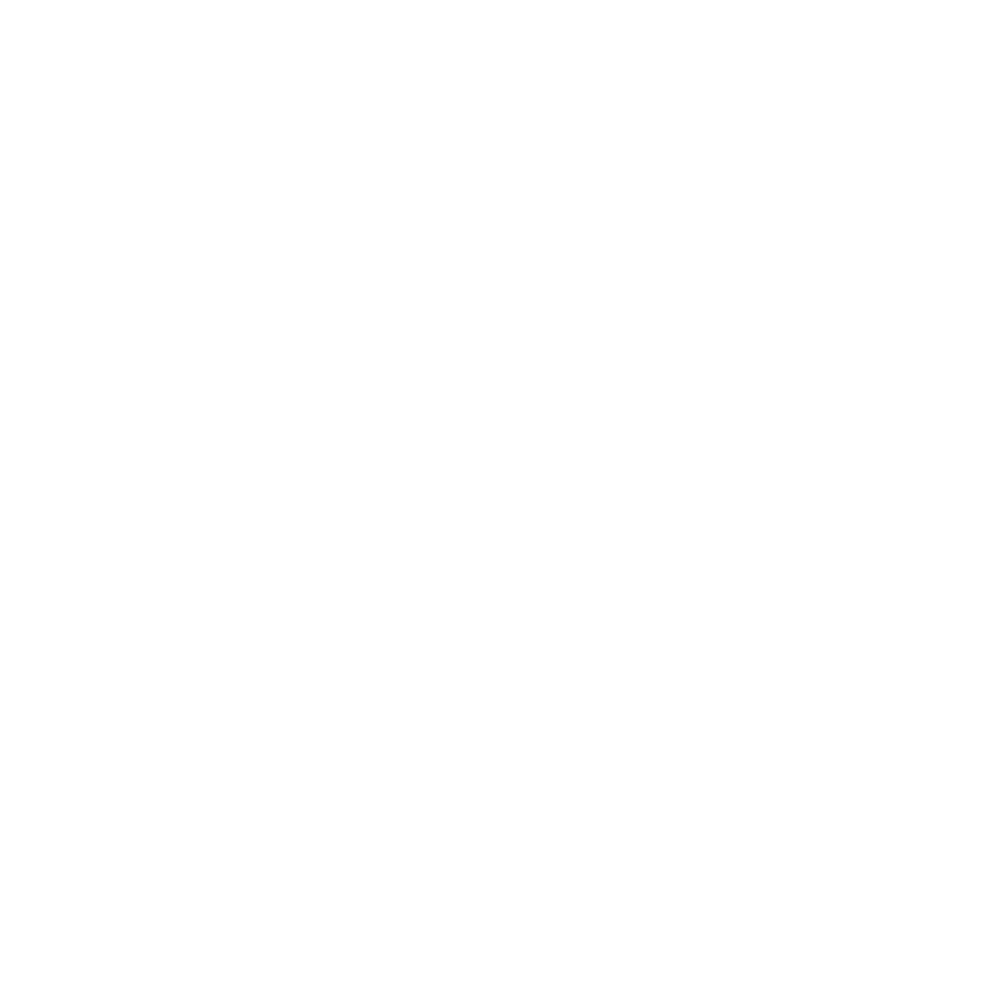

Fitting H1_647 on fov: Conv_zscan_11.tif


<IPython.core.display.Javascript object>


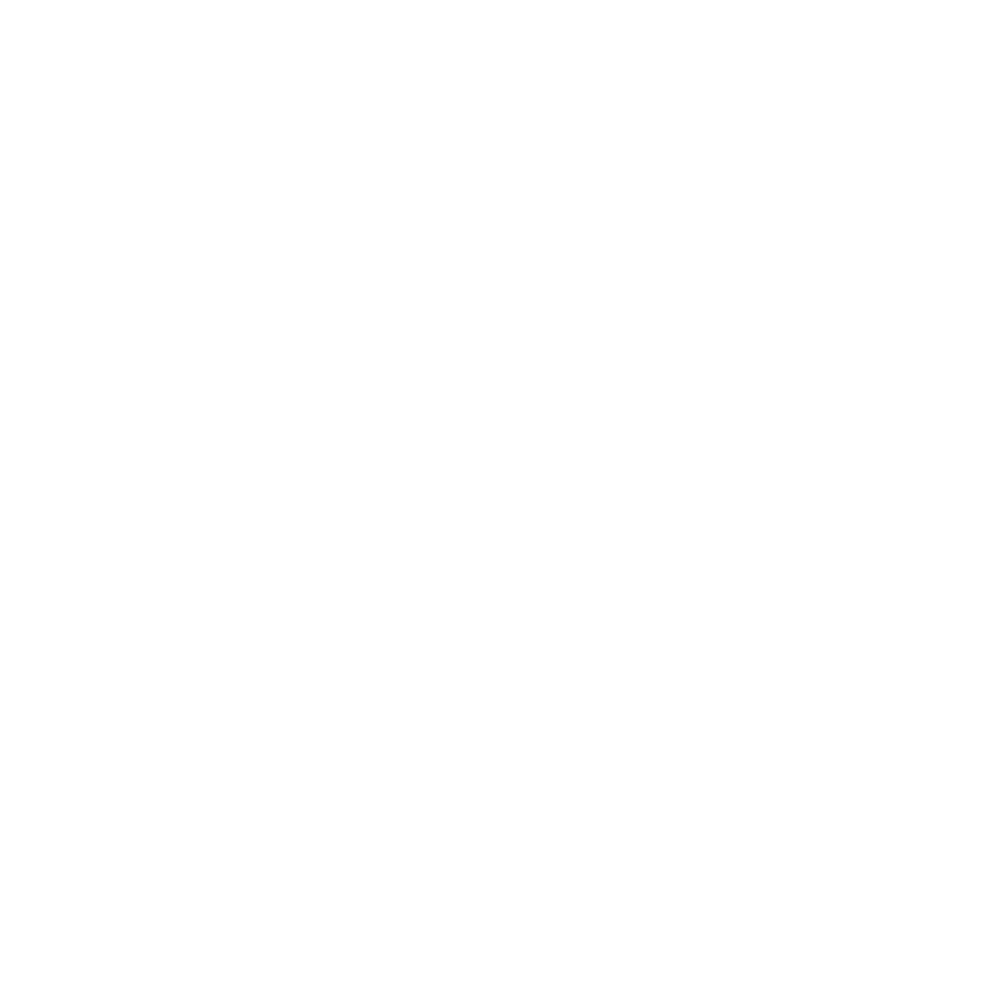

Drift correcting H2 on fov: Conv_zscan_11.tif
Fitting H2_750 on fov: Conv_zscan_11.tif


<IPython.core.display.Javascript object>


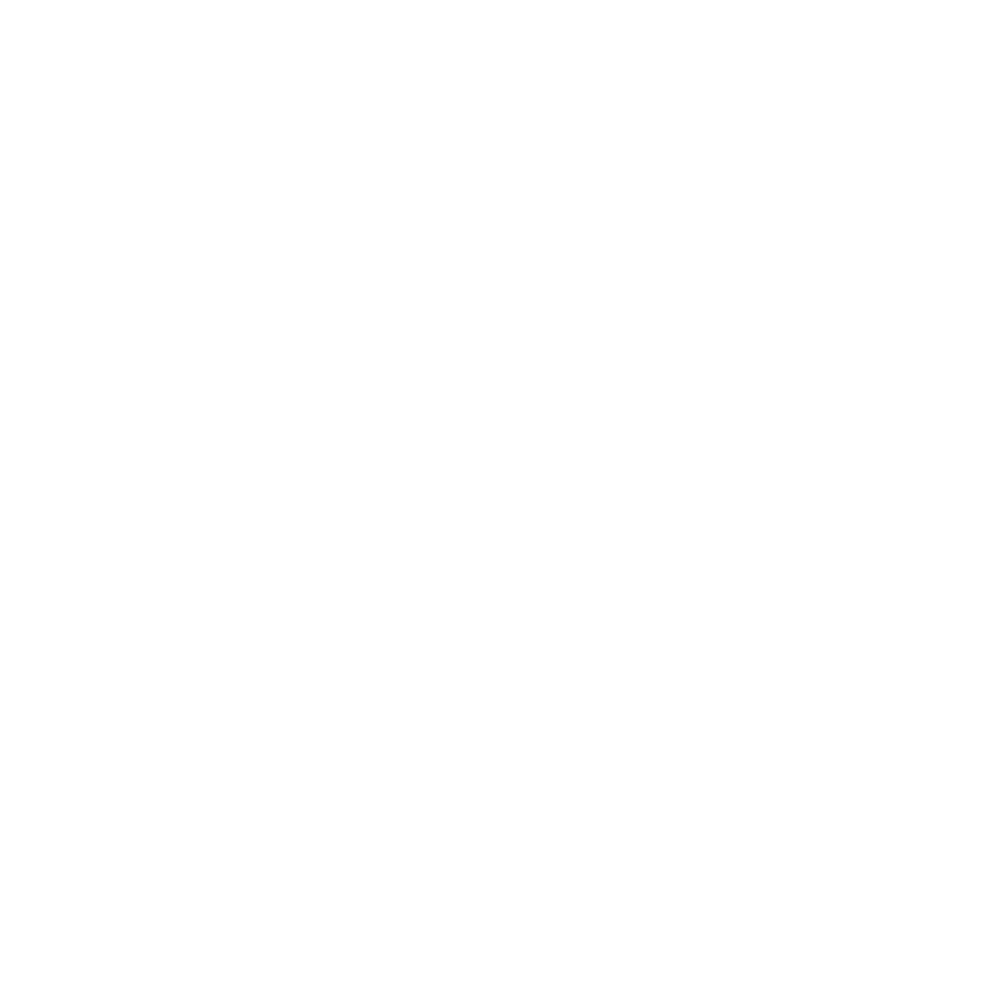

Fitting H2_647 on fov: Conv_zscan_11.tif


<IPython.core.display.Javascript object>


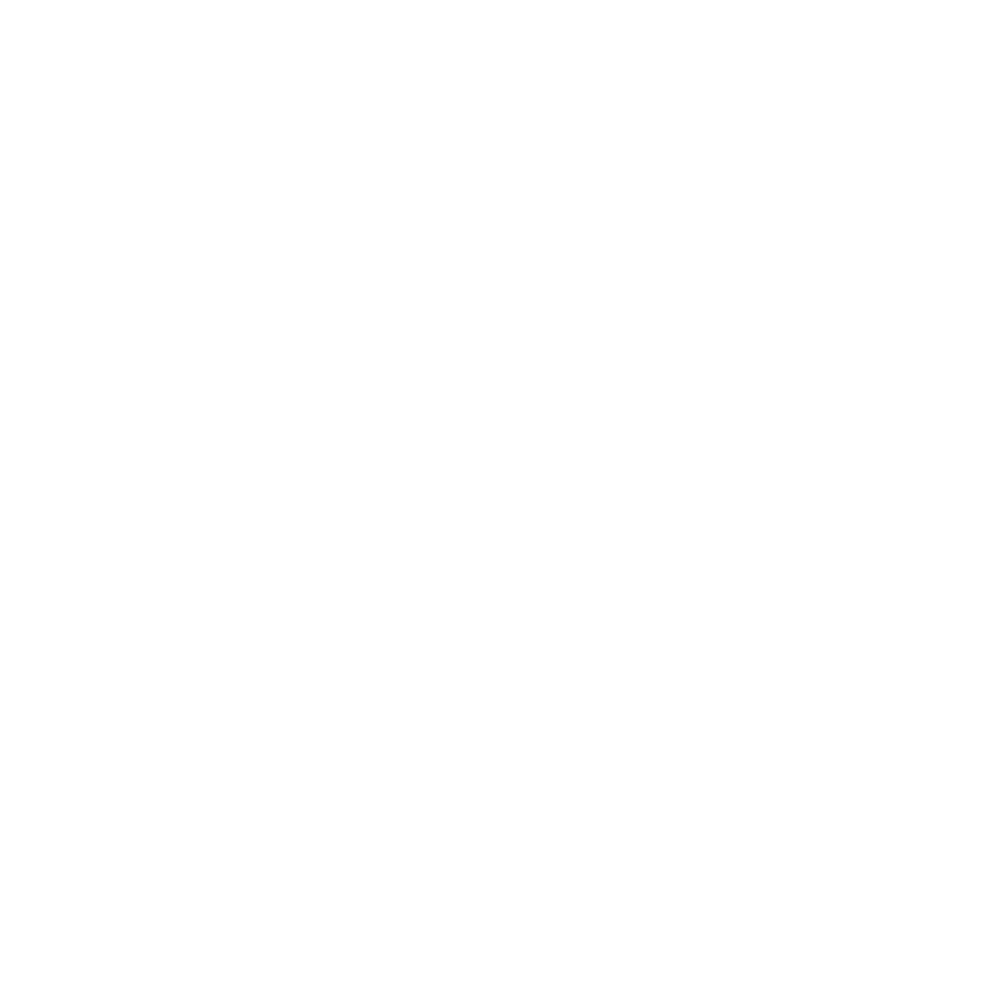

Drift correcting H3 on fov: Conv_zscan_11.tif
Fitting H3_750 on fov: Conv_zscan_11.tif


<IPython.core.display.Javascript object>


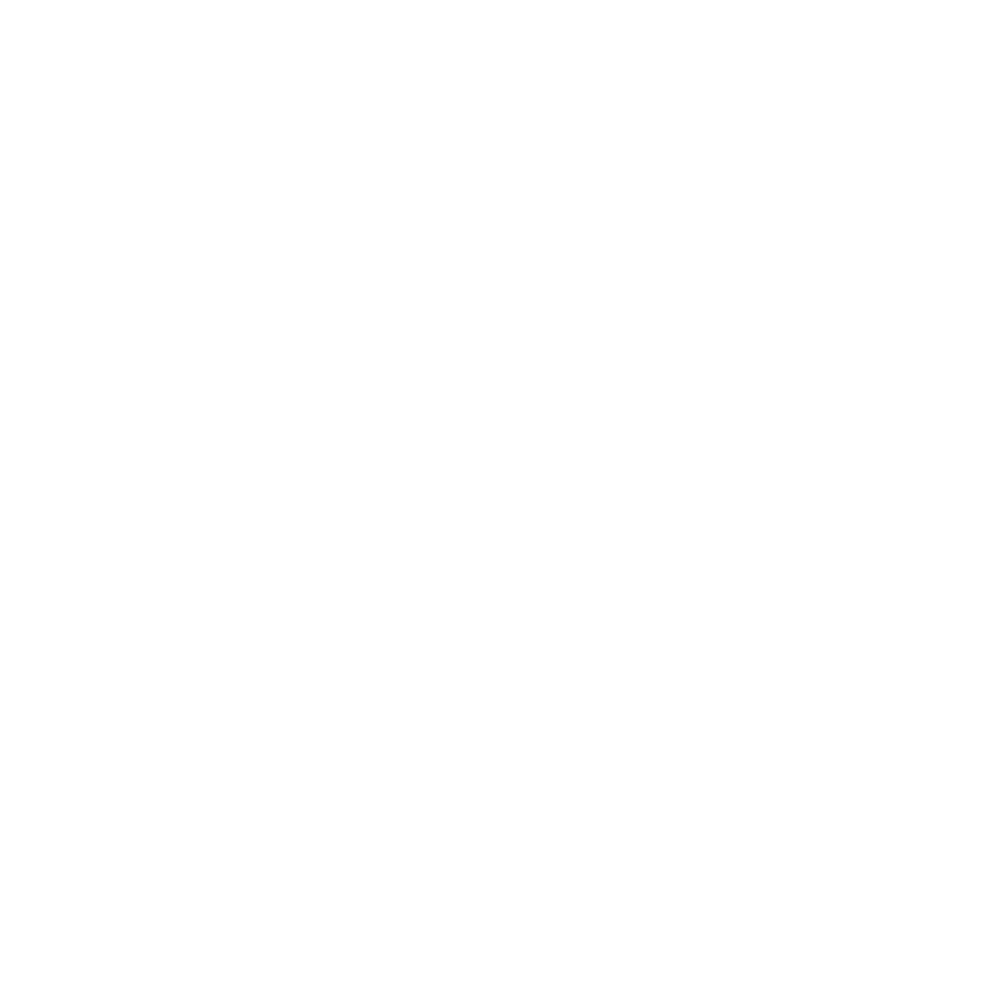

Fitting H3_647 on fov: Conv_zscan_11.tif


<IPython.core.display.Javascript object>


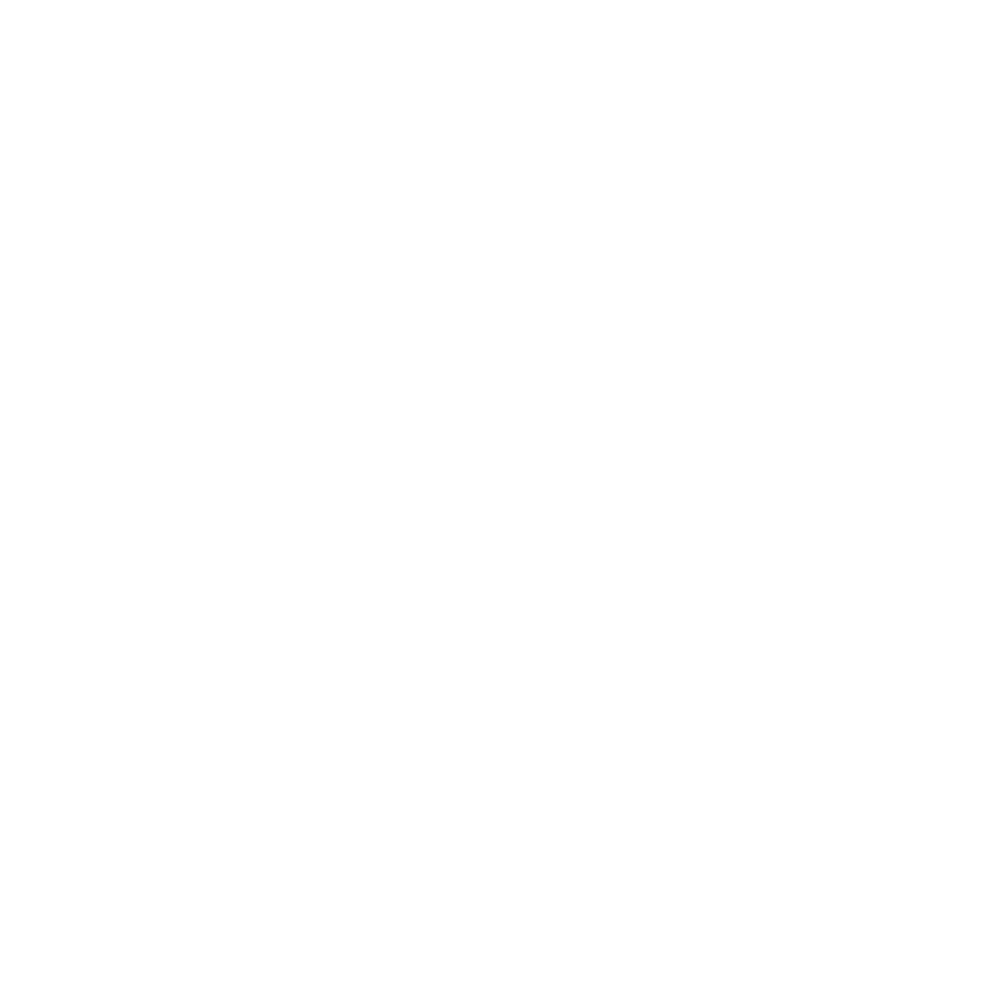

Drift correcting H4 on fov: Conv_zscan_11.tif
Fitting H4_750 on fov: Conv_zscan_11.tif


<IPython.core.display.Javascript object>


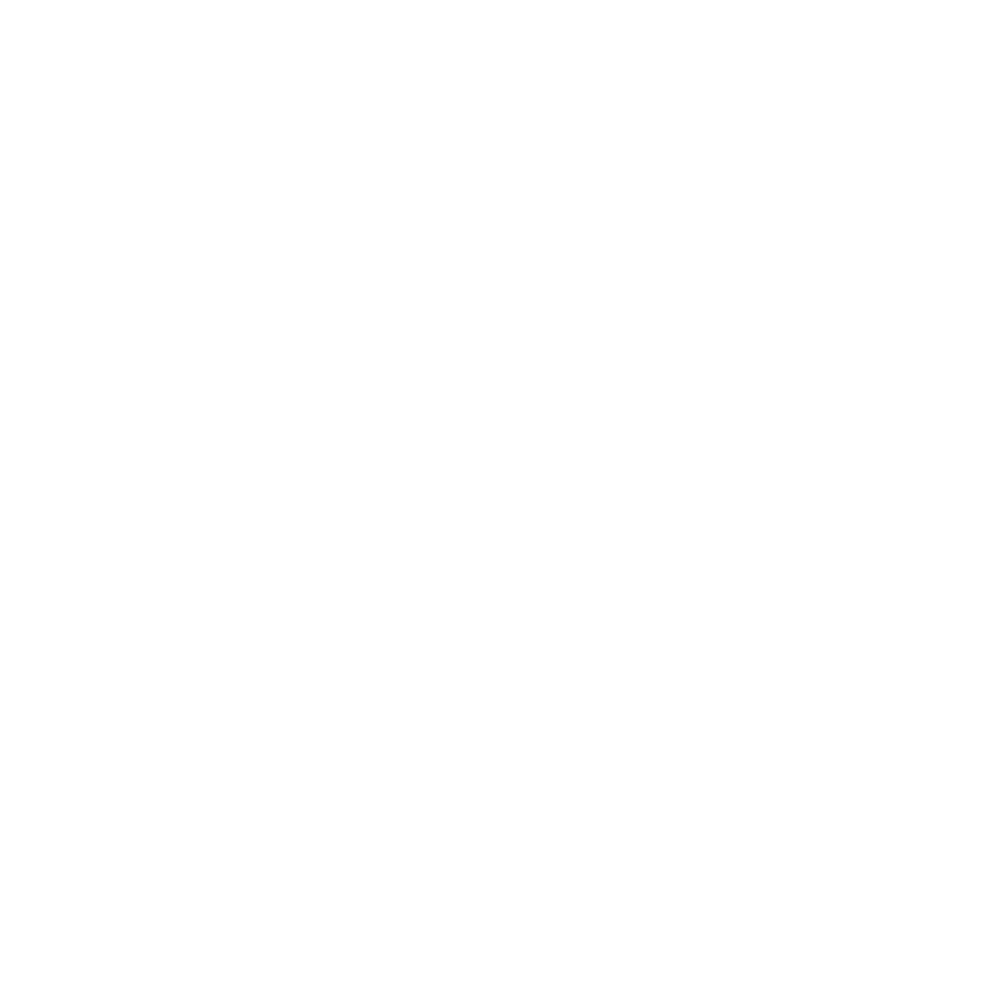

Fitting H4_647 on fov: Conv_zscan_11.tif


<IPython.core.display.Javascript object>


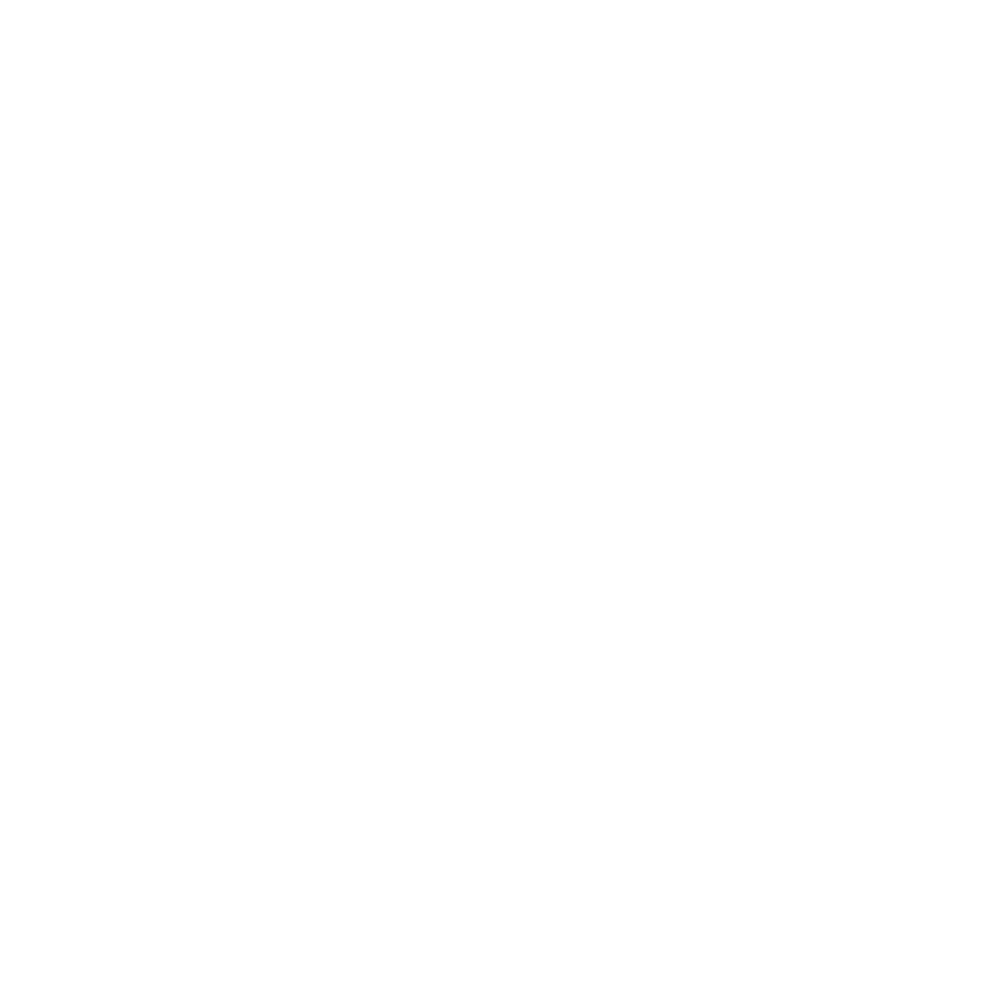

Drift correcting H5 on fov: Conv_zscan_11.tif
Fitting H5_750 on fov: Conv_zscan_11.tif


<IPython.core.display.Javascript object>


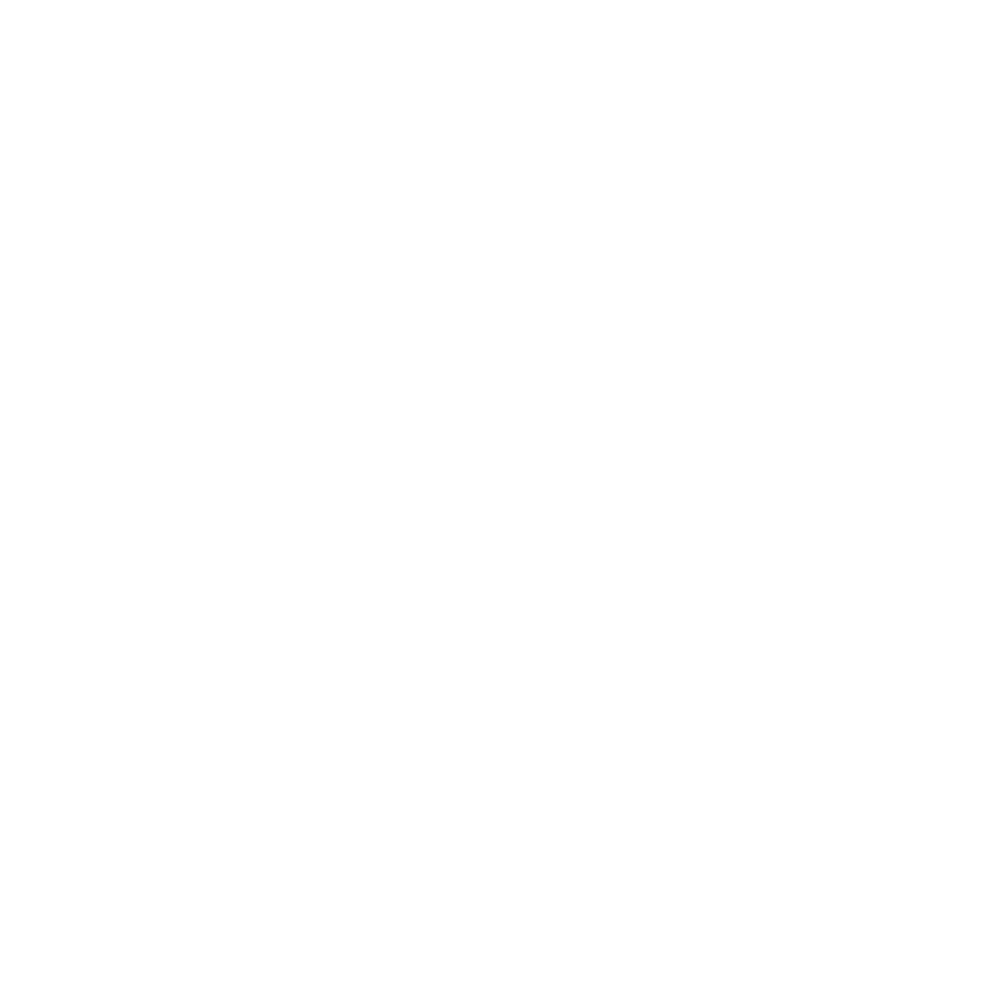

Fitting H5_647 on fov: Conv_zscan_11.tif


<IPython.core.display.Javascript object>


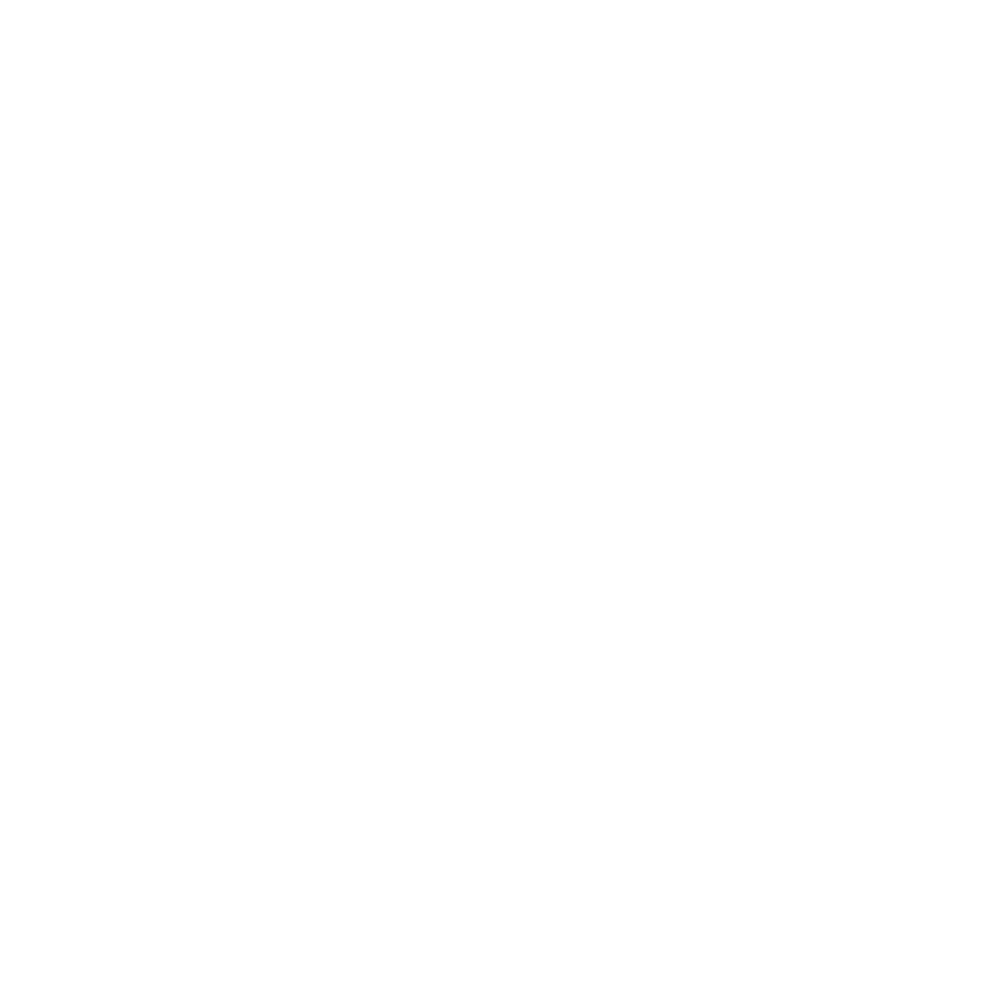

Drift correcting H6 on fov: Conv_zscan_11.tif
Fitting H6_750 on fov: Conv_zscan_11.tif


<IPython.core.display.Javascript object>


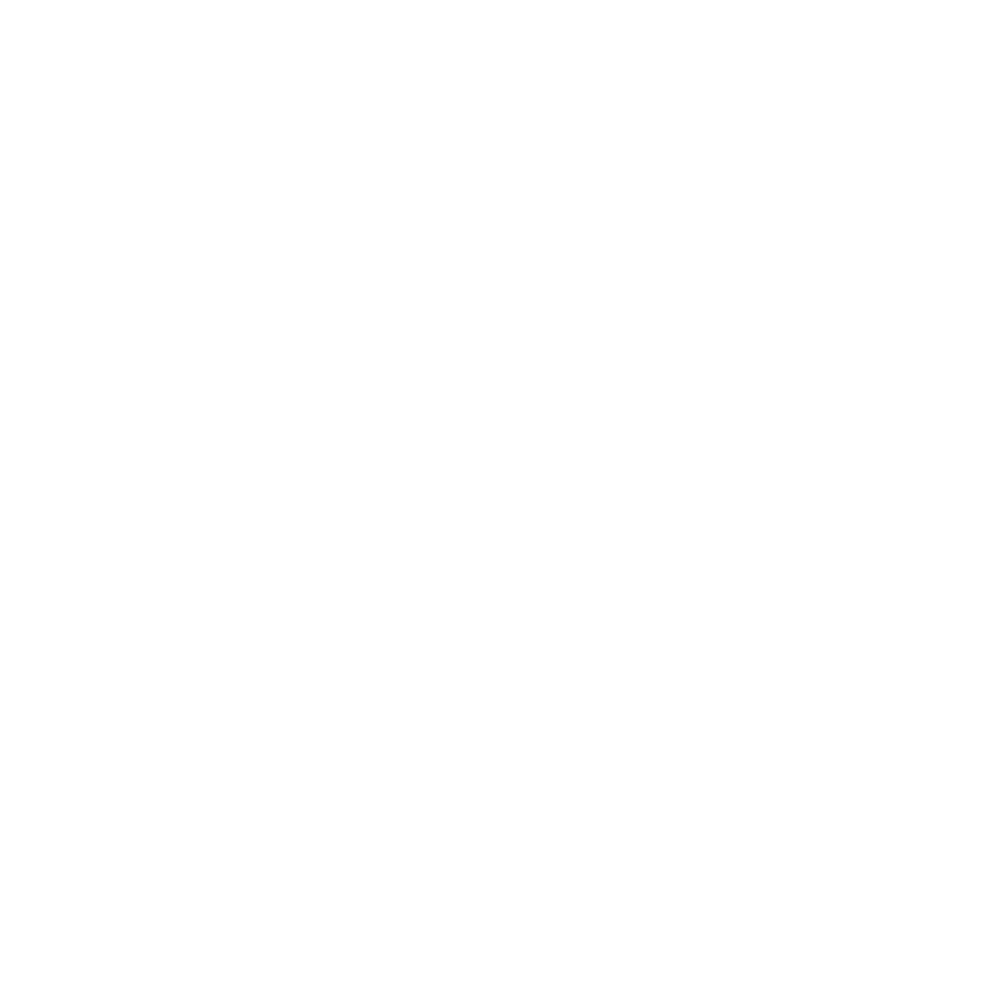

Fitting H6_647 on fov: Conv_zscan_11.tif


<IPython.core.display.Javascript object>


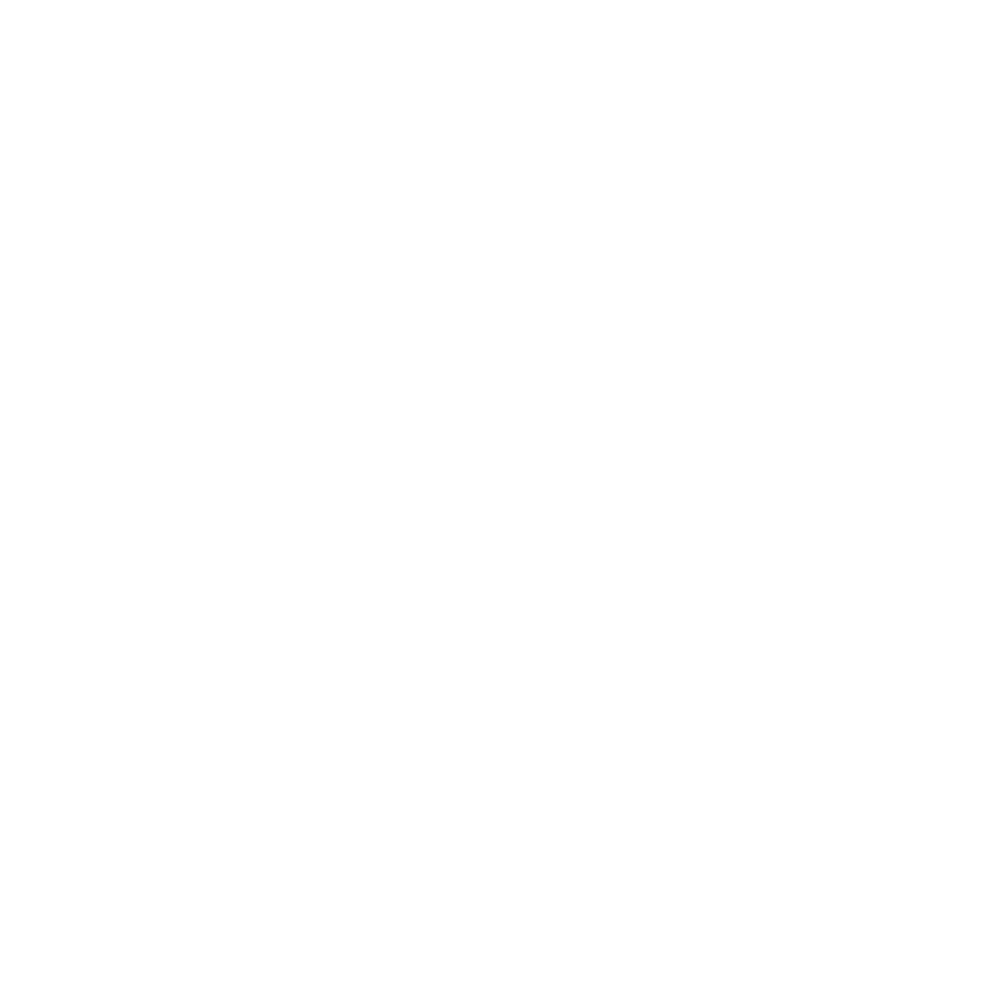

Estimating number of cells based on dapi image on fov: Conv_zscan_11.tif


<IPython.core.display.Javascript object>


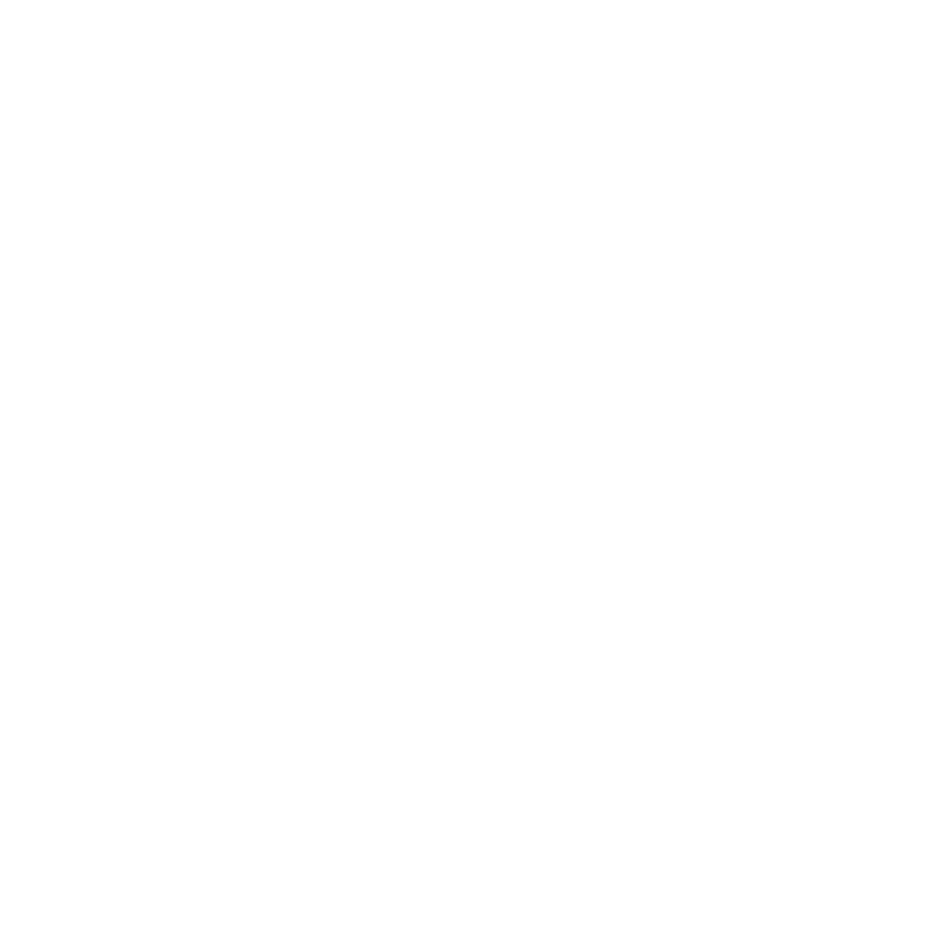

<ipython-input-27-1886a2f7fea2>:20: TqdmDeprecationWarning: This function will be removed in tqdm==5.0.0
Please use `tqdm.notebook.tqdm` instead of `tqdm.tqdm_notebook`
  for fld in tqdm(folders):



Drift correcting H1 on fov: Conv_zscan_12.tif
Fitting H1_750 on fov: Conv_zscan_12.tif


<IPython.core.display.Javascript object>


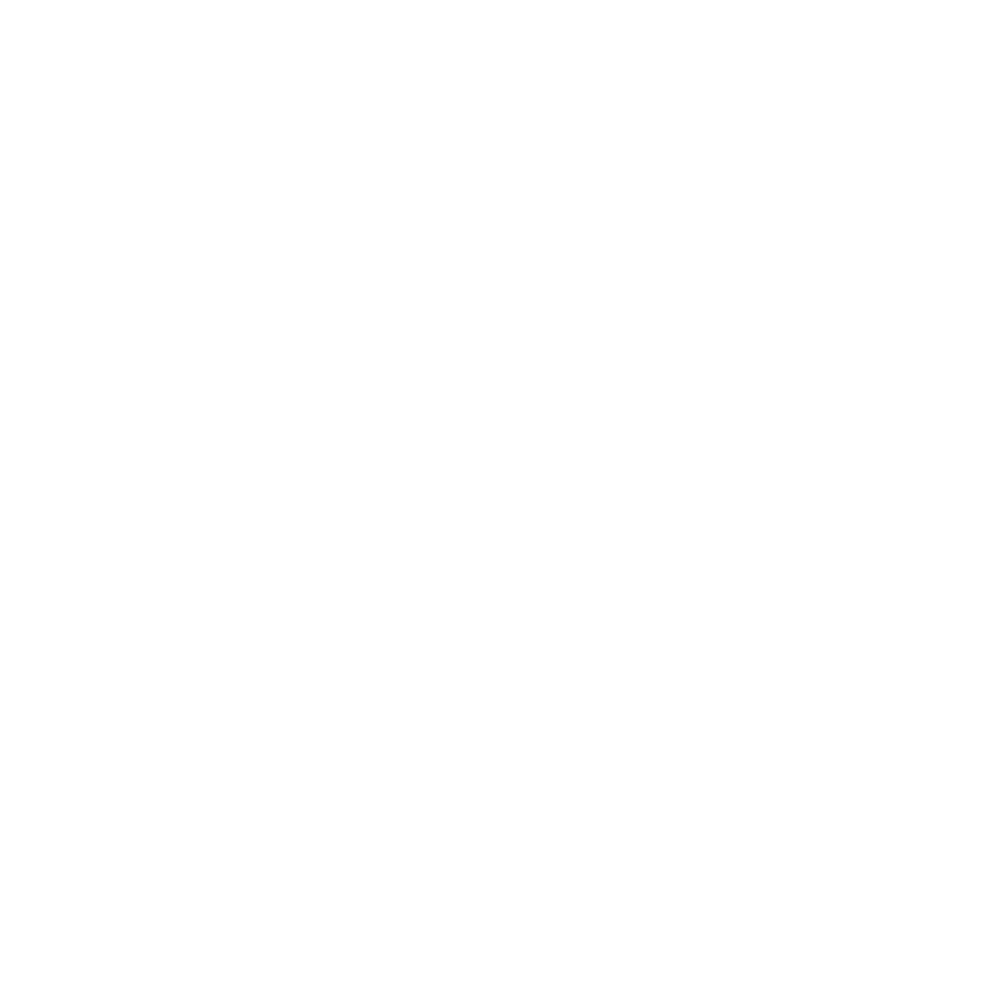

Fitting H1_647 on fov: Conv_zscan_12.tif


<IPython.core.display.Javascript object>


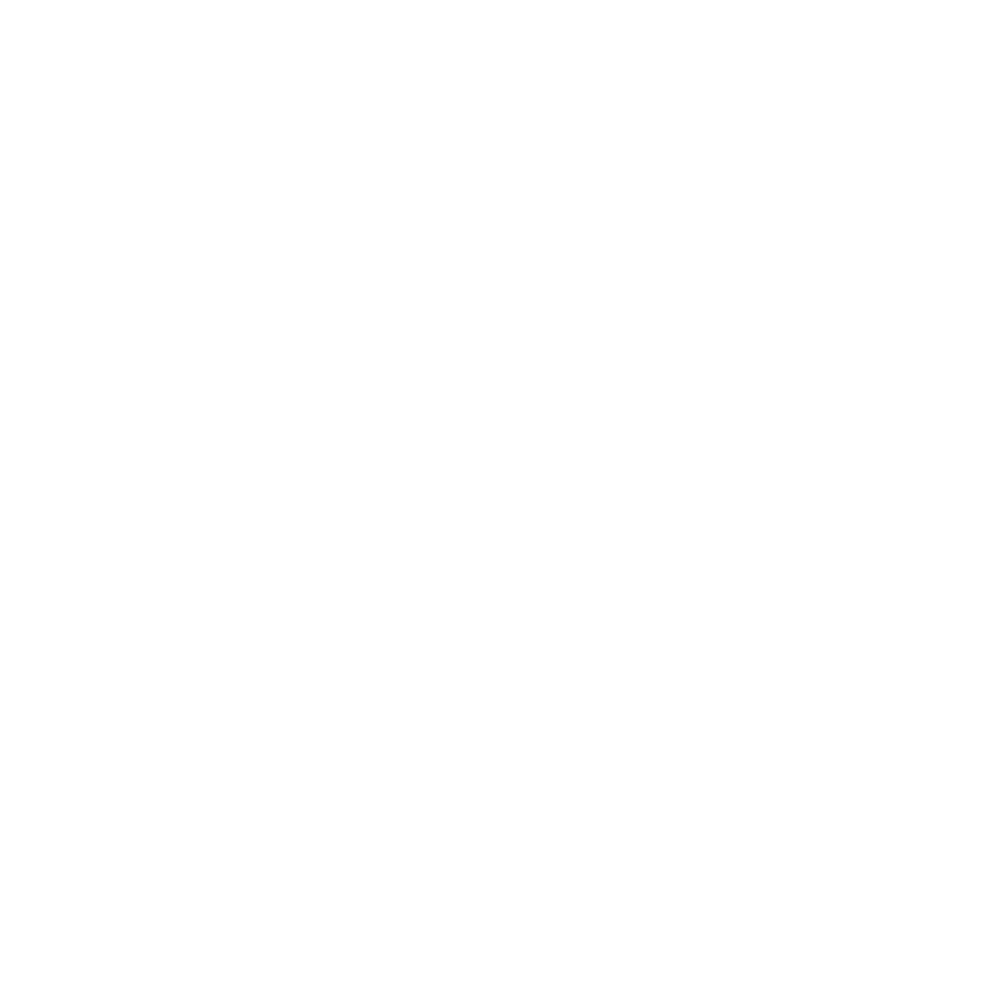

Drift correcting H2 on fov: Conv_zscan_12.tif
Fitting H2_750 on fov: Conv_zscan_12.tif


<IPython.core.display.Javascript object>


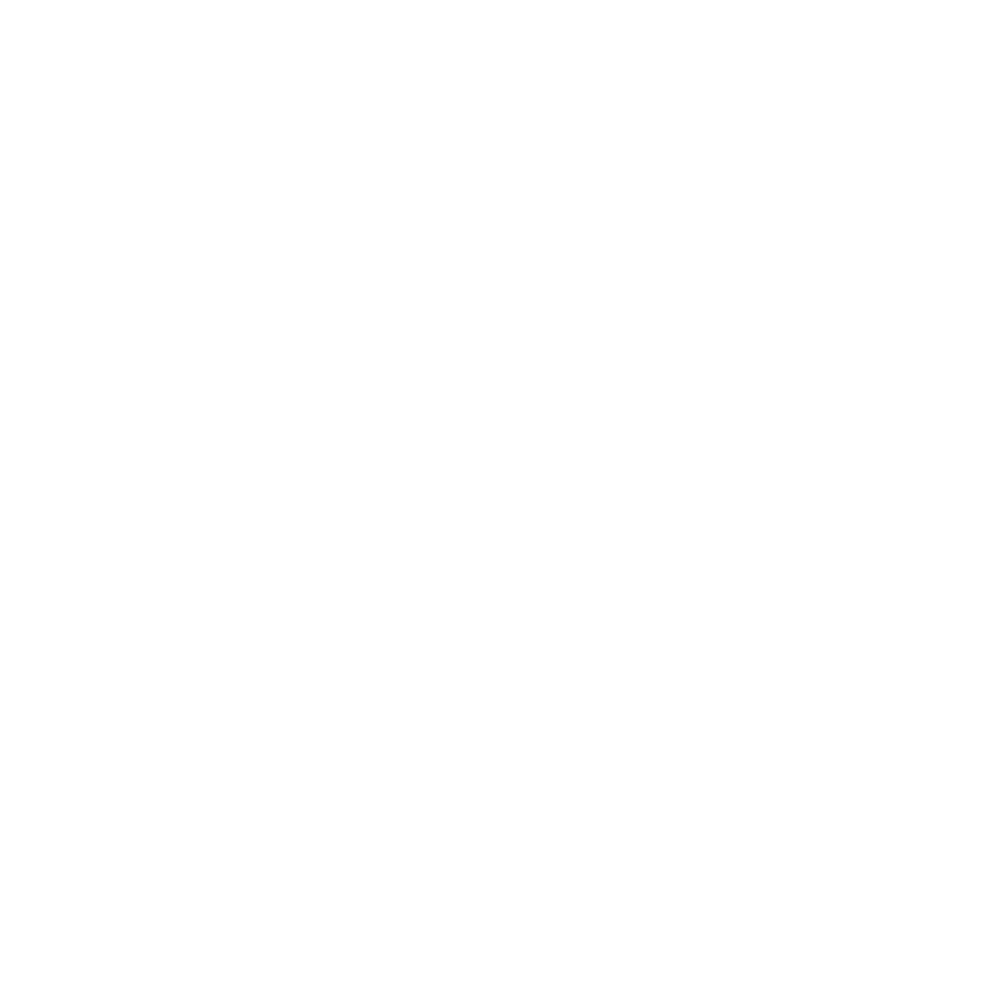

Fitting H2_647 on fov: Conv_zscan_12.tif


<IPython.core.display.Javascript object>


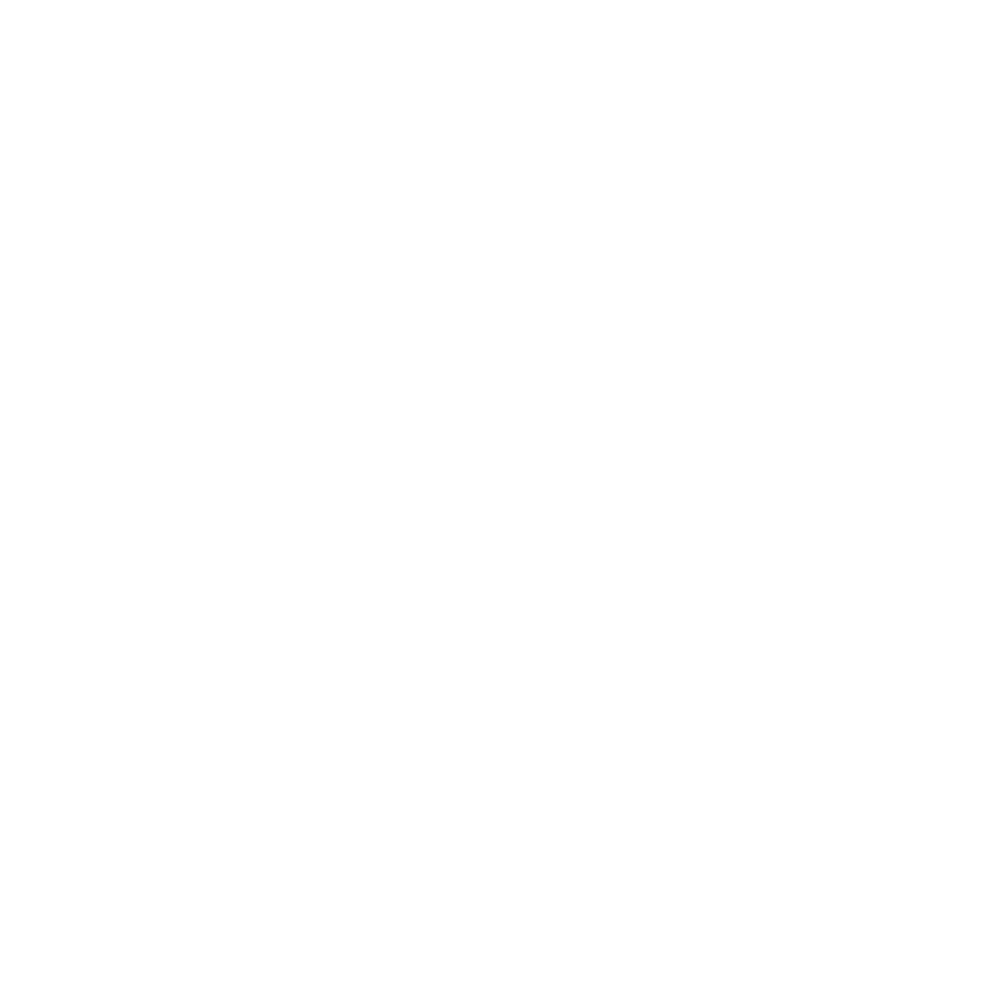

Drift correcting H3 on fov: Conv_zscan_12.tif
Fitting H3_750 on fov: Conv_zscan_12.tif


<IPython.core.display.Javascript object>


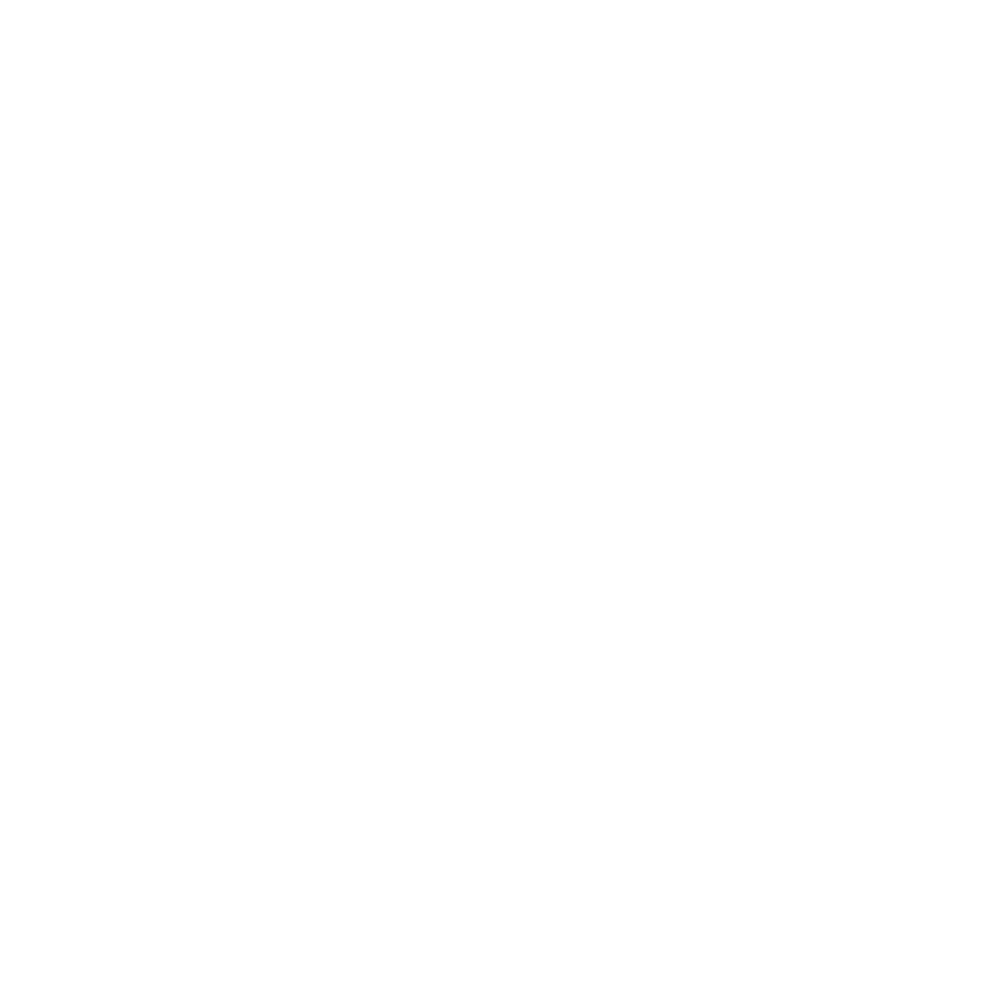

Fitting H3_647 on fov: Conv_zscan_12.tif


<IPython.core.display.Javascript object>


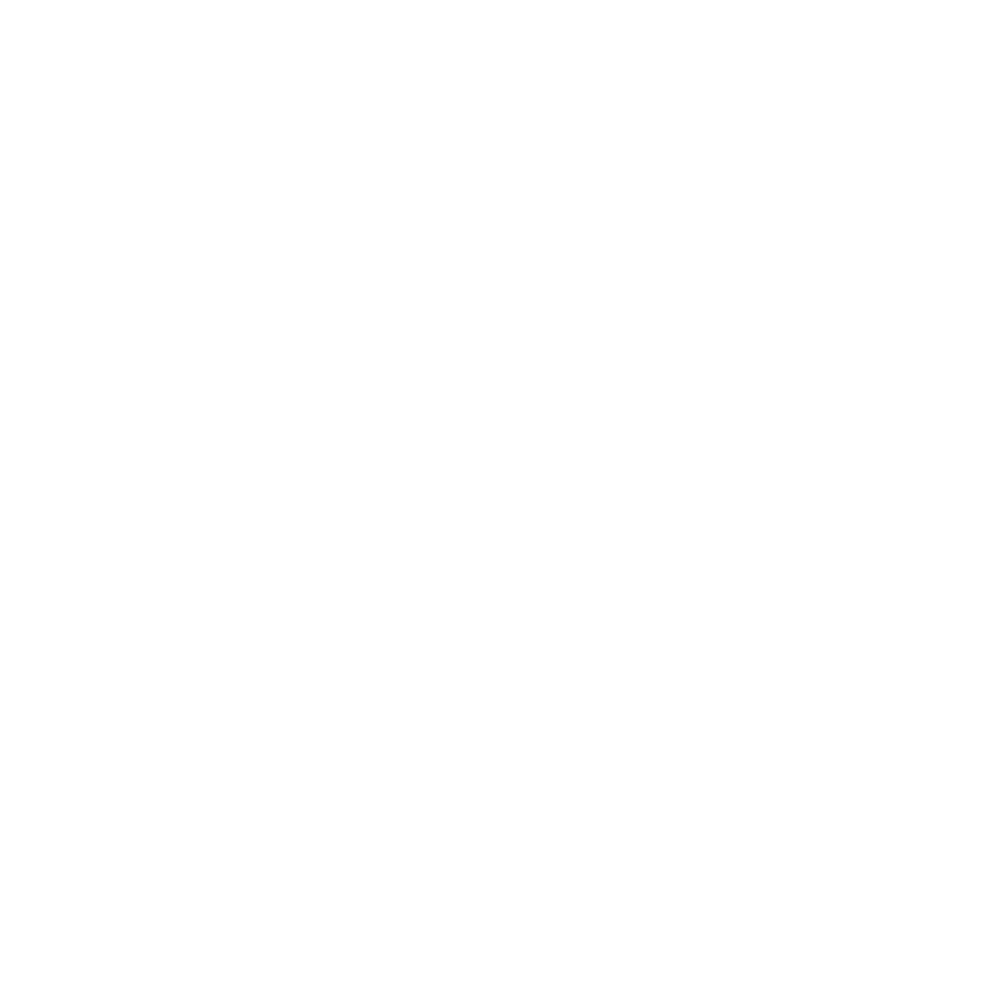

Drift correcting H4 on fov: Conv_zscan_12.tif
Fitting H4_750 on fov: Conv_zscan_12.tif


<IPython.core.display.Javascript object>


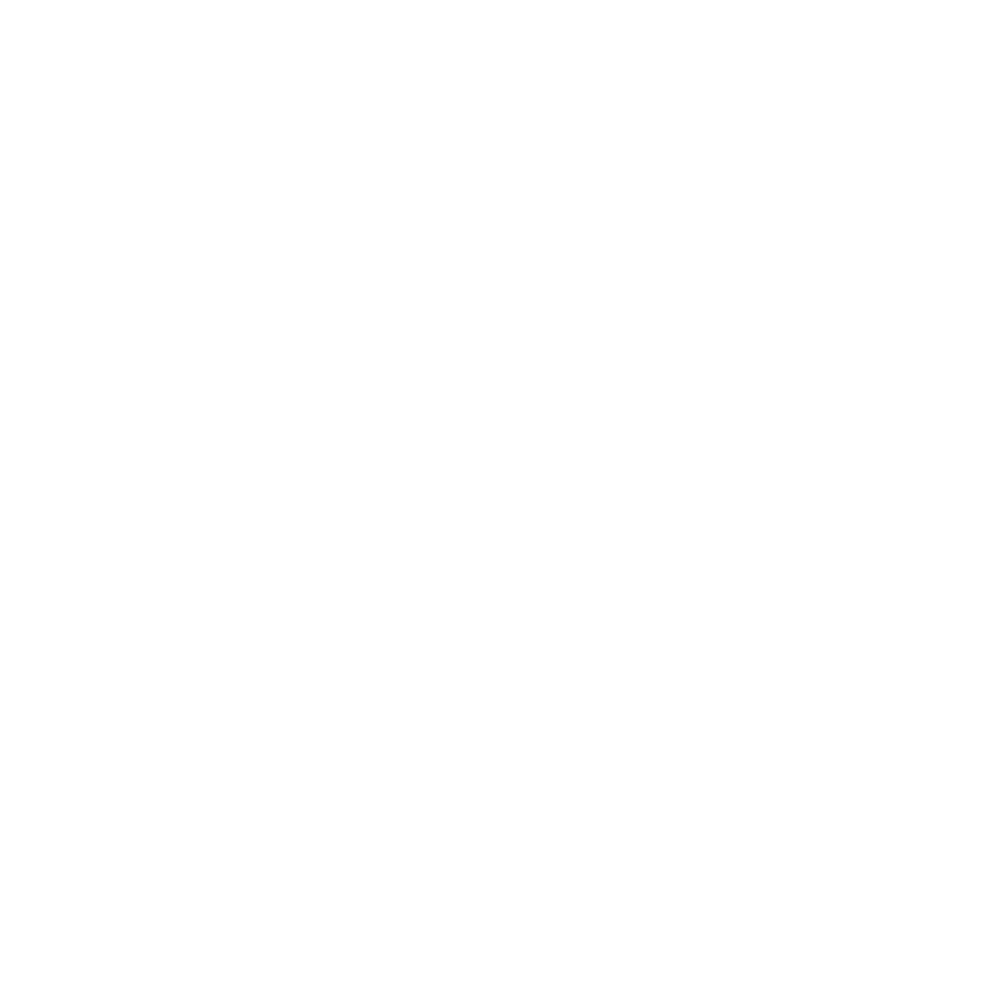

Fitting H4_647 on fov: Conv_zscan_12.tif


<IPython.core.display.Javascript object>


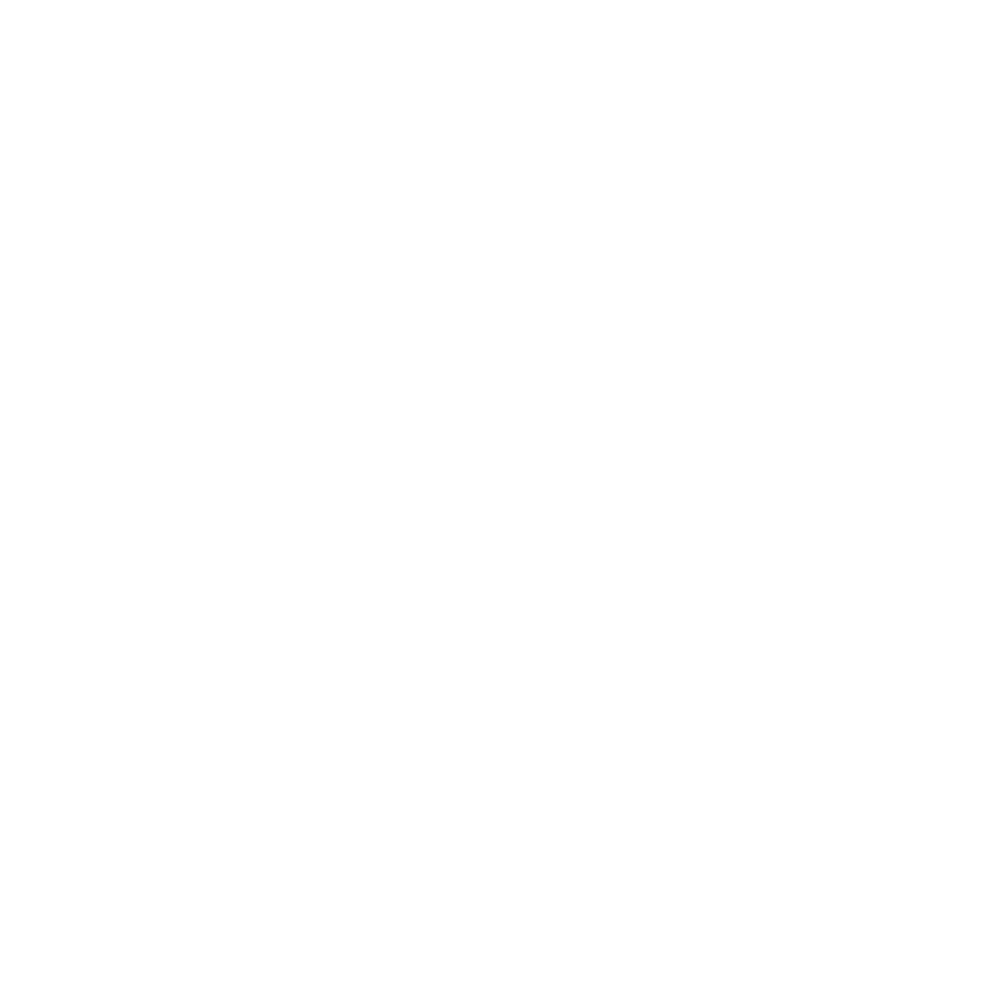

Drift correcting H5 on fov: Conv_zscan_12.tif
Fitting H5_750 on fov: Conv_zscan_12.tif


<IPython.core.display.Javascript object>


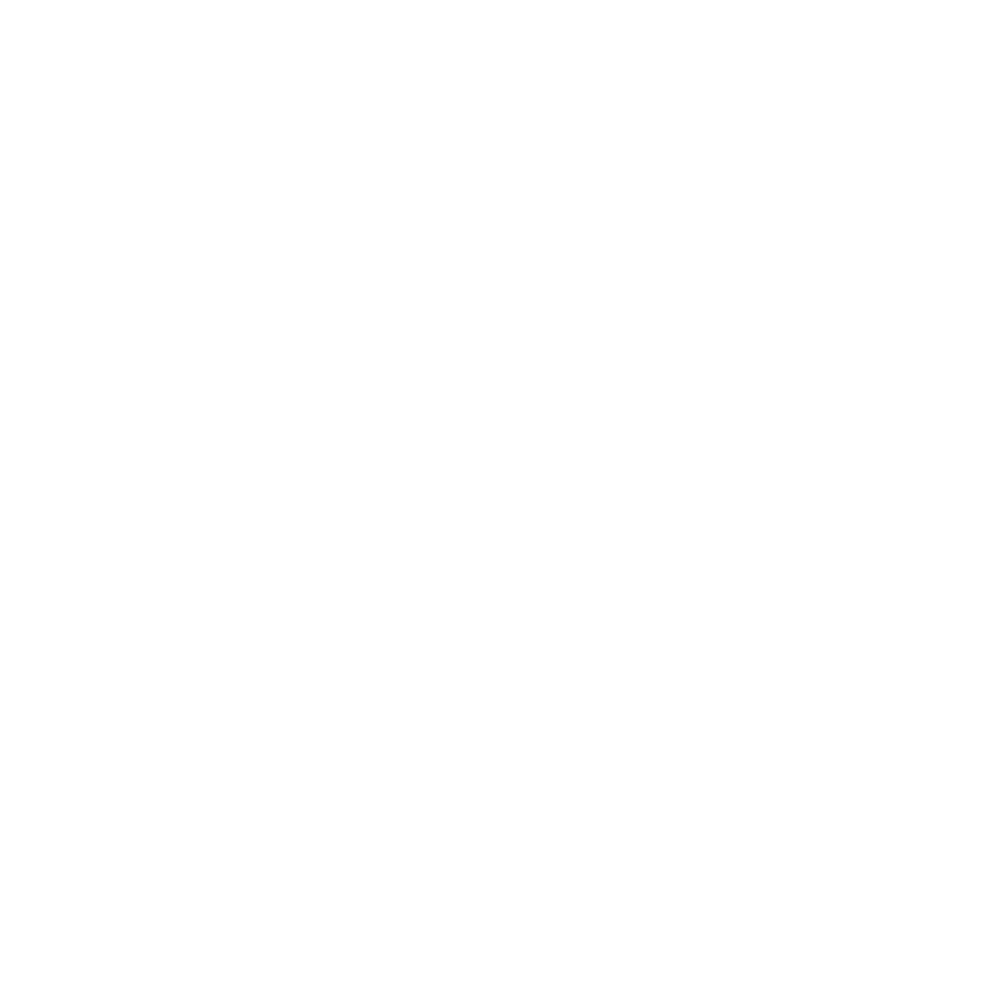

Fitting H5_647 on fov: Conv_zscan_12.tif


<IPython.core.display.Javascript object>


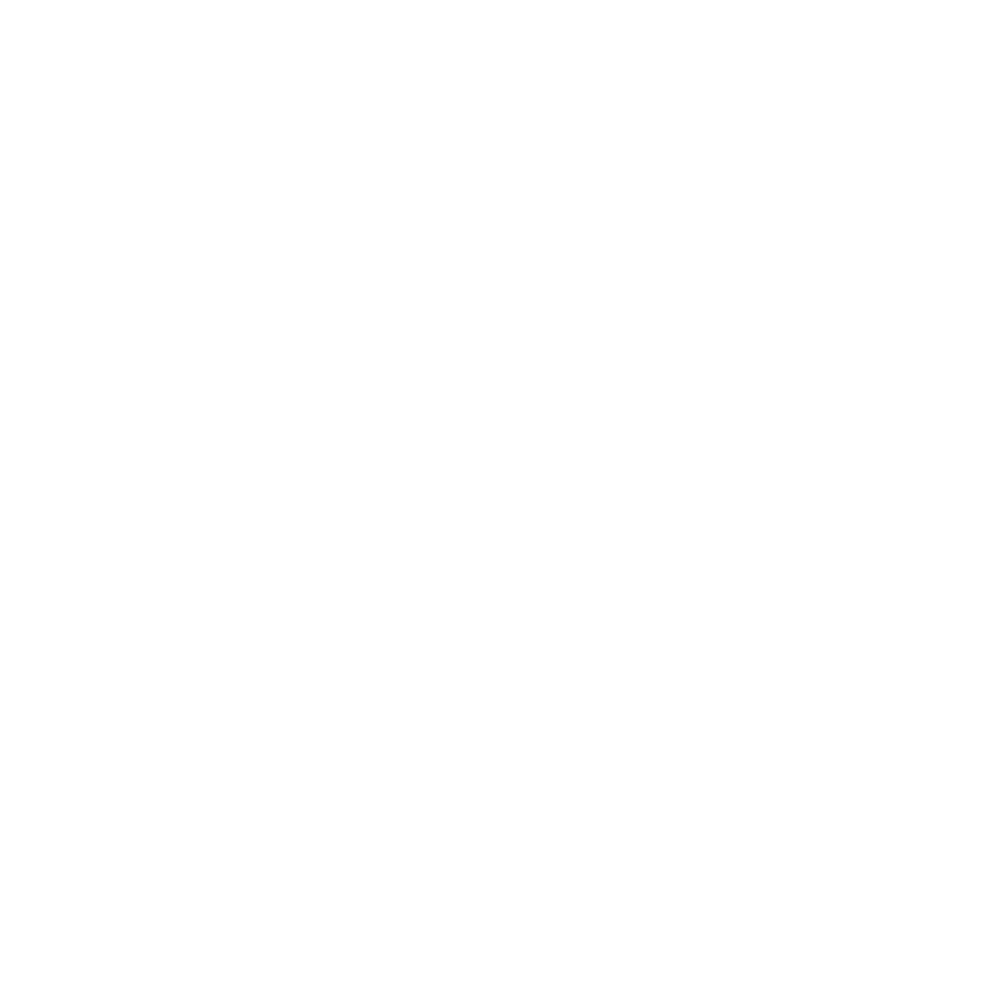

Drift correcting H6 on fov: Conv_zscan_12.tif
Fitting H6_750 on fov: Conv_zscan_12.tif


<IPython.core.display.Javascript object>


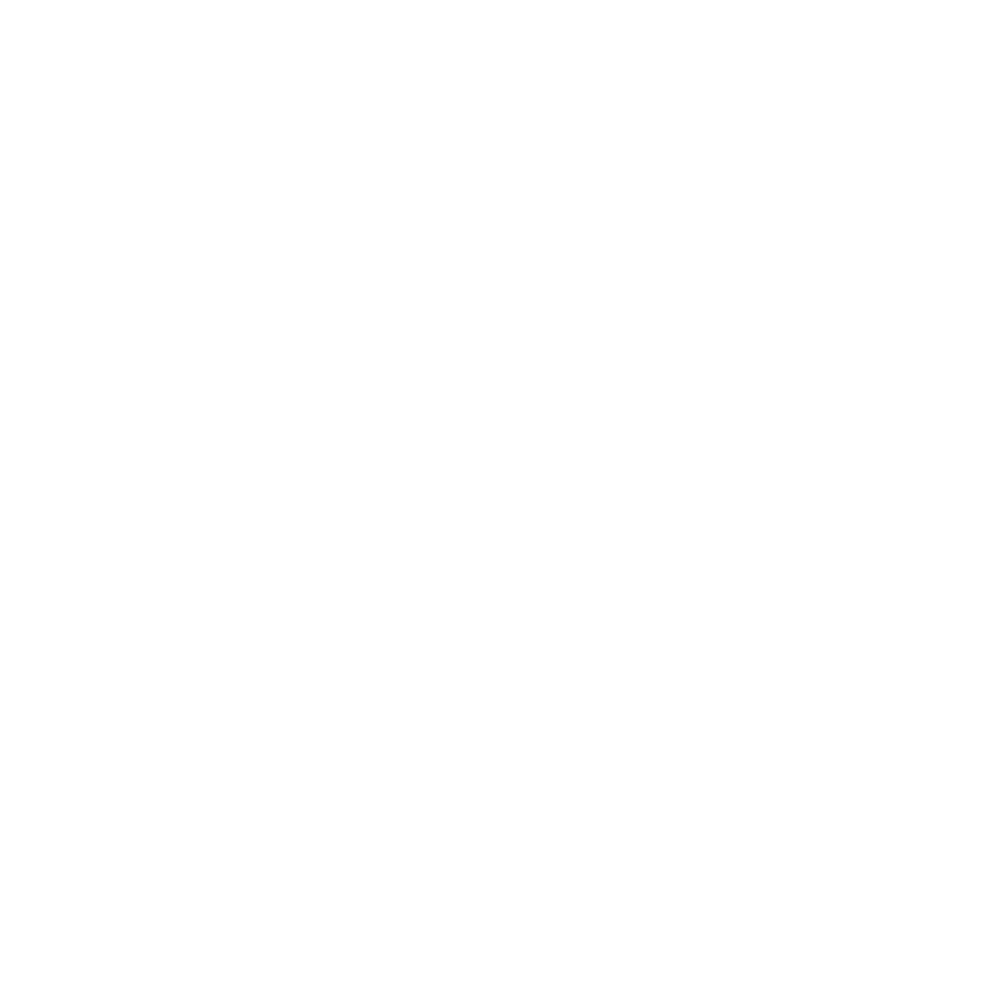

Fitting H6_647 on fov: Conv_zscan_12.tif


<IPython.core.display.Javascript object>


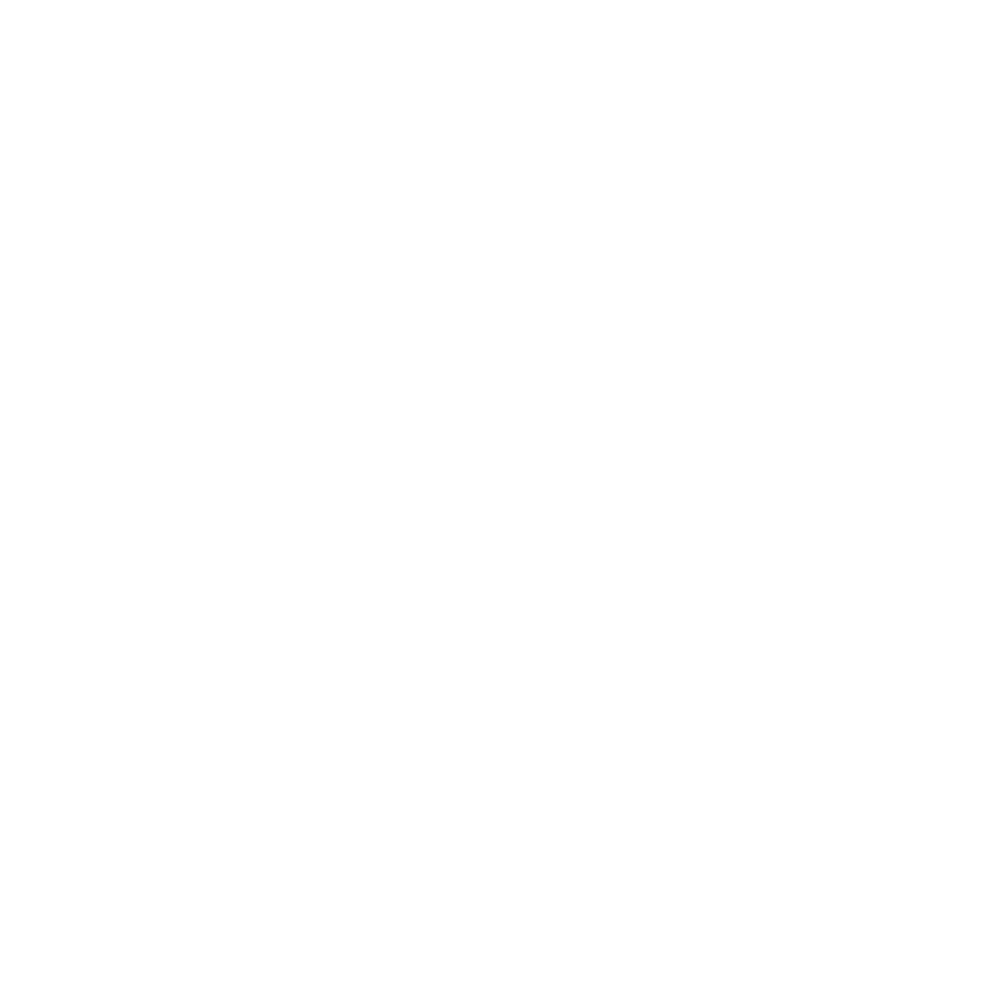

Estimating number of cells based on dapi image on fov: Conv_zscan_12.tif


<IPython.core.display.Javascript object>


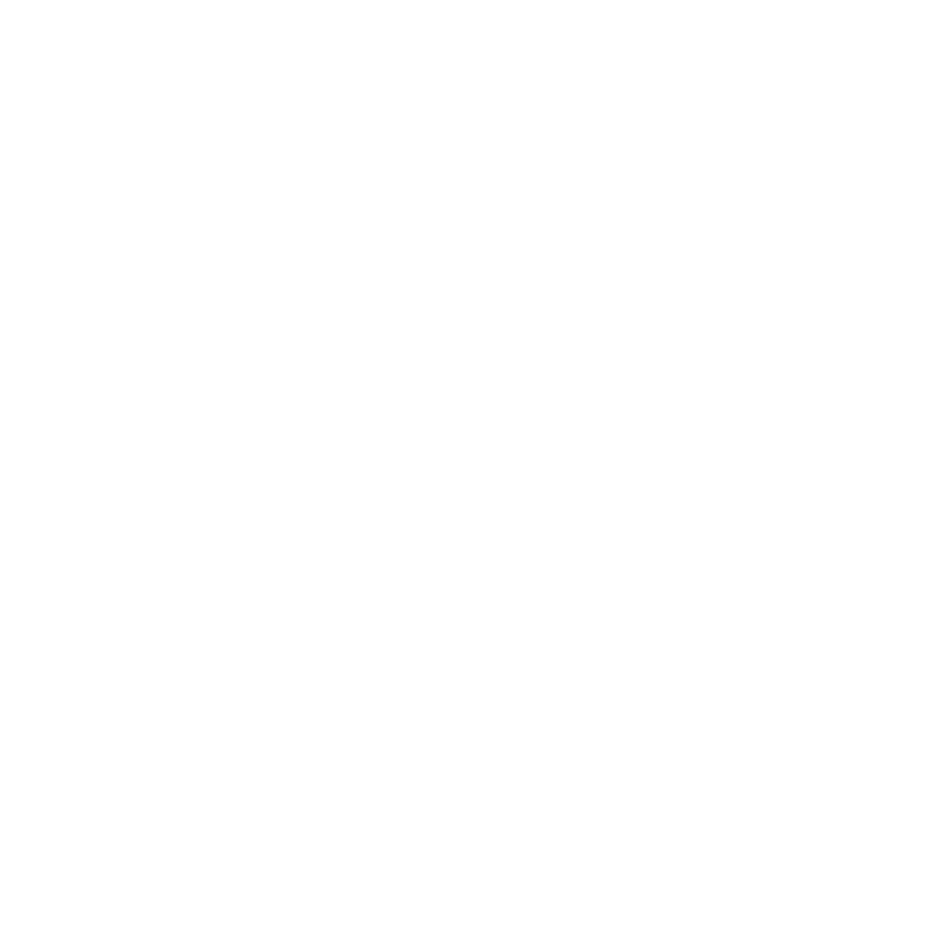

<ipython-input-27-1886a2f7fea2>:20: TqdmDeprecationWarning: This function will be removed in tqdm==5.0.0
Please use `tqdm.notebook.tqdm` instead of `tqdm.tqdm_notebook`
  for fld in tqdm(folders):



Drift correcting H1 on fov: Conv_zscan_13.tif
Fitting H1_750 on fov: Conv_zscan_13.tif


<IPython.core.display.Javascript object>


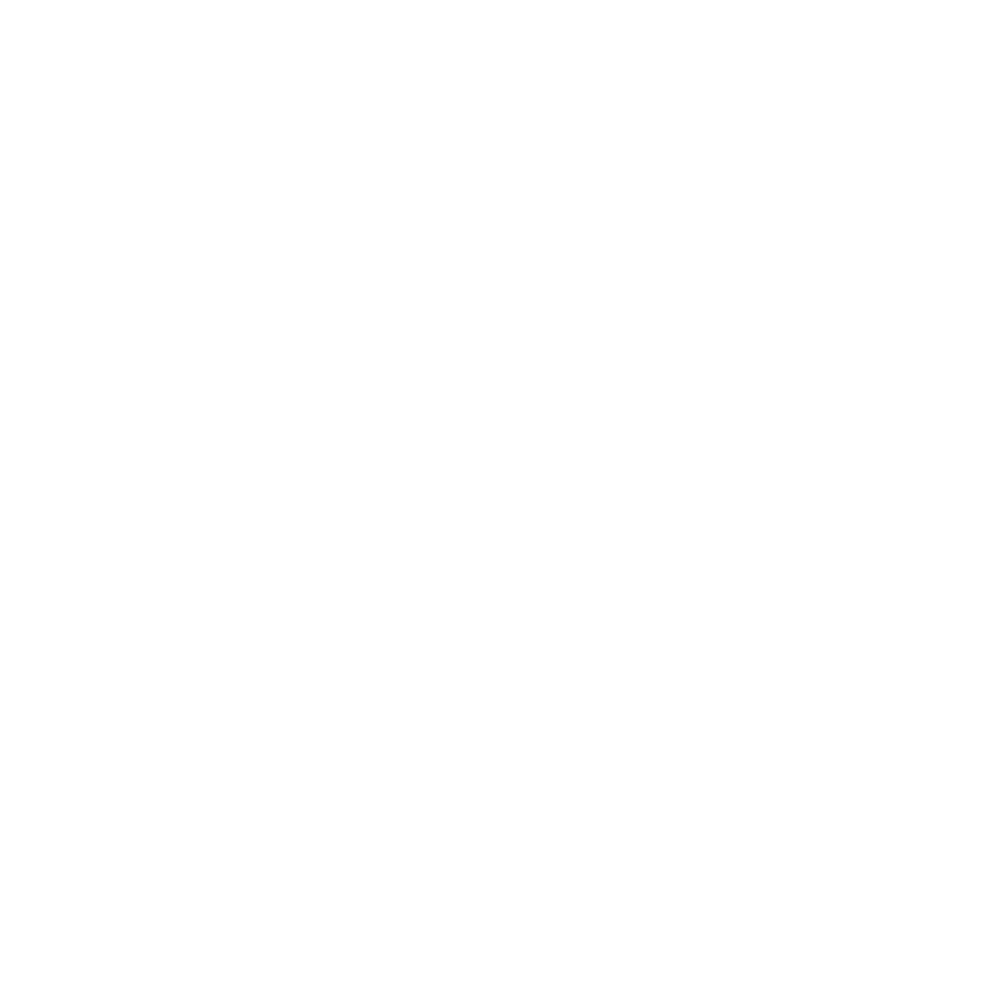

Fitting H1_647 on fov: Conv_zscan_13.tif


<IPython.core.display.Javascript object>


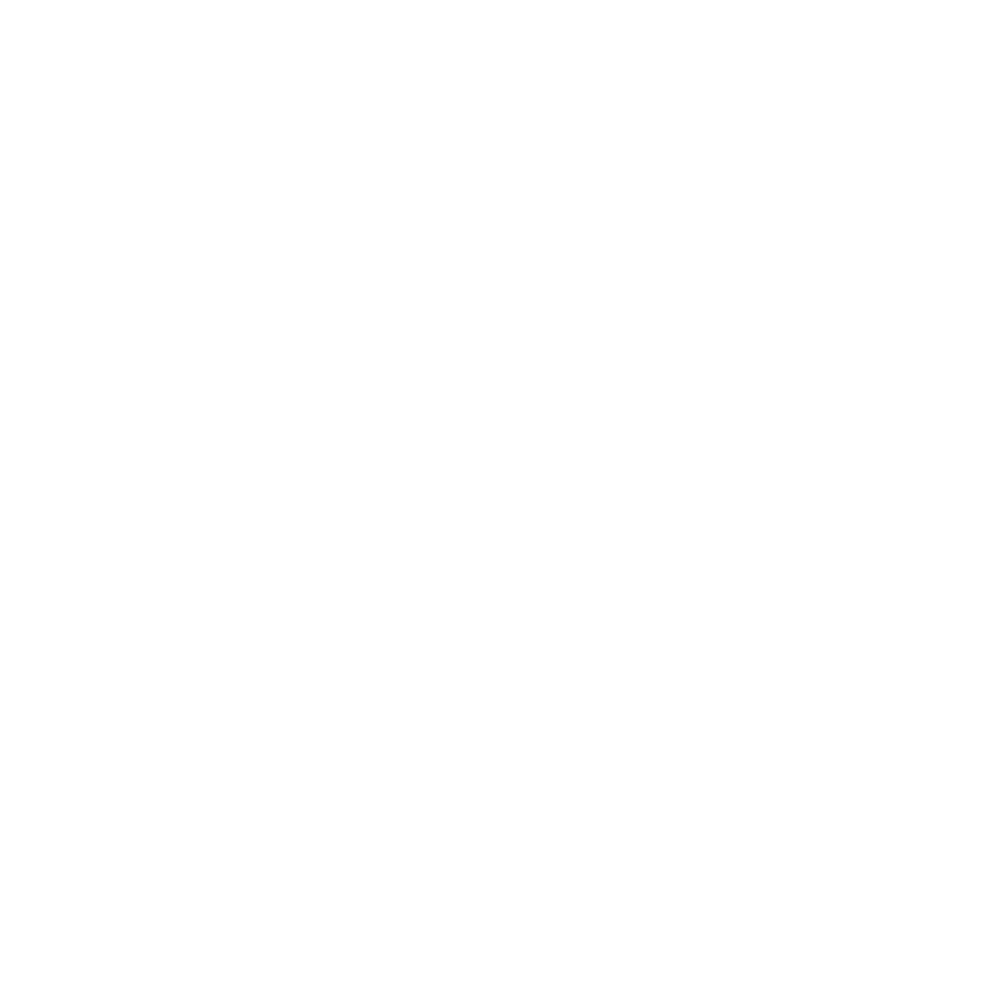

Drift correcting H2 on fov: Conv_zscan_13.tif
Fitting H2_750 on fov: Conv_zscan_13.tif


<IPython.core.display.Javascript object>


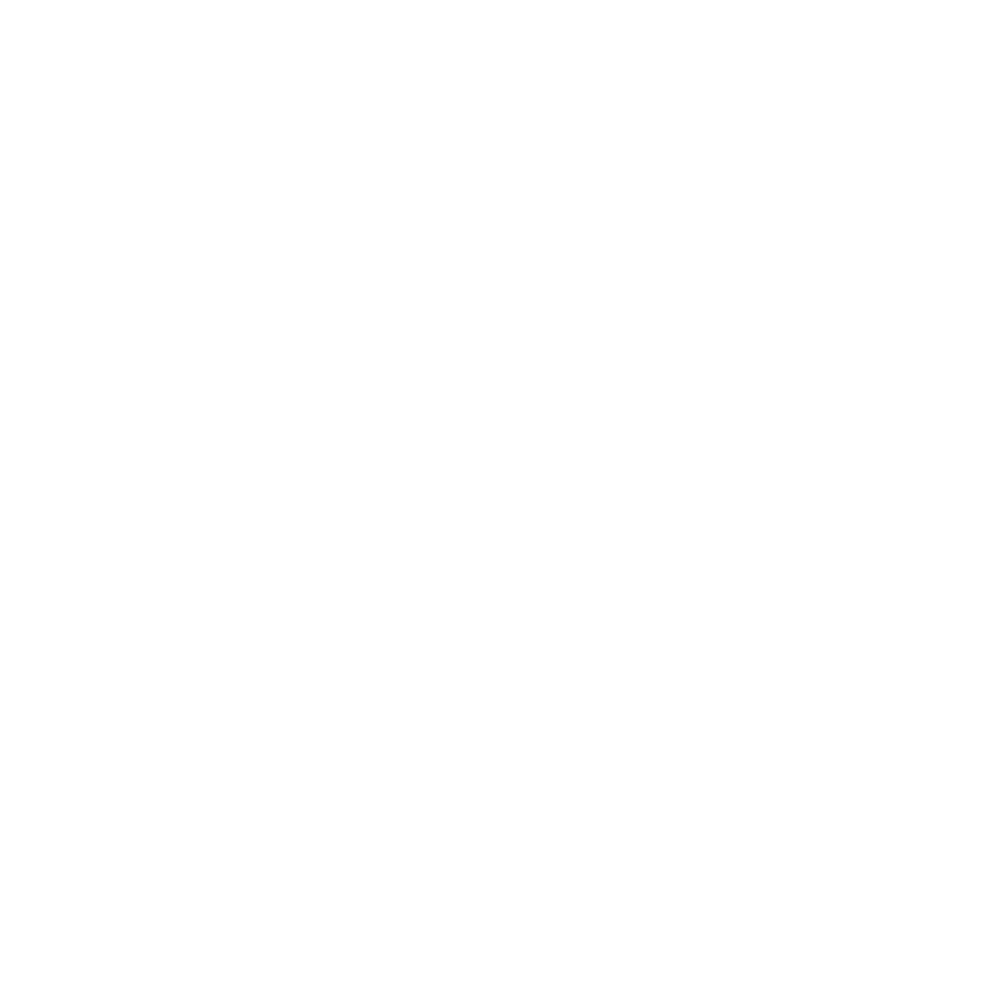

Fitting H2_647 on fov: Conv_zscan_13.tif


<IPython.core.display.Javascript object>


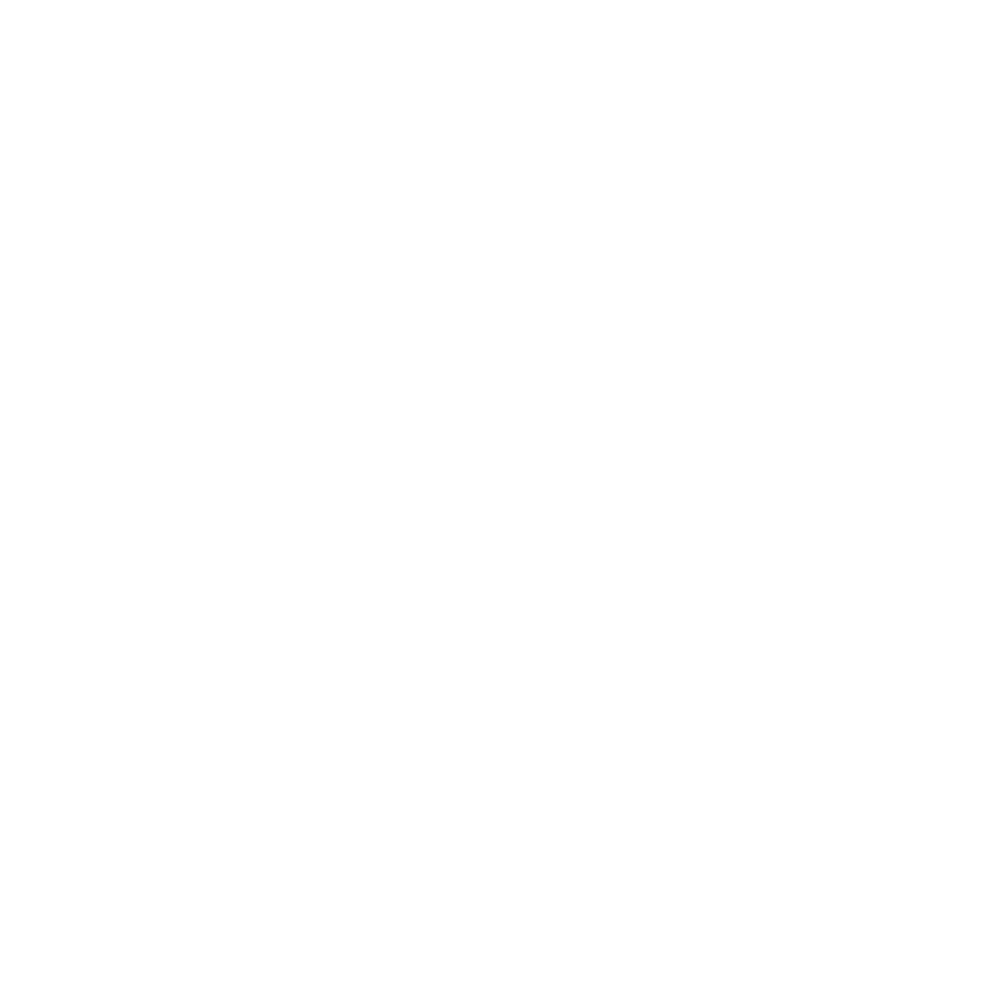

Drift correcting H3 on fov: Conv_zscan_13.tif
Fitting H3_750 on fov: Conv_zscan_13.tif


<IPython.core.display.Javascript object>


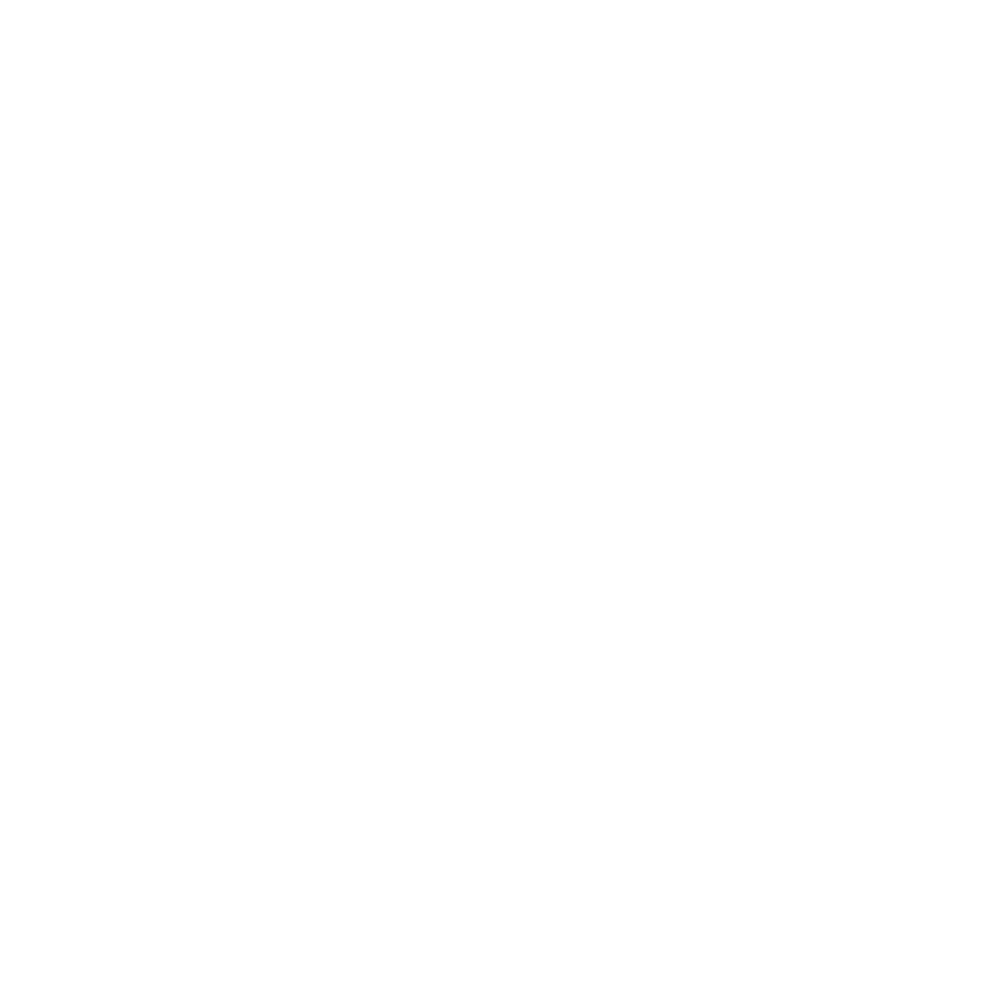

Fitting H3_647 on fov: Conv_zscan_13.tif


<IPython.core.display.Javascript object>


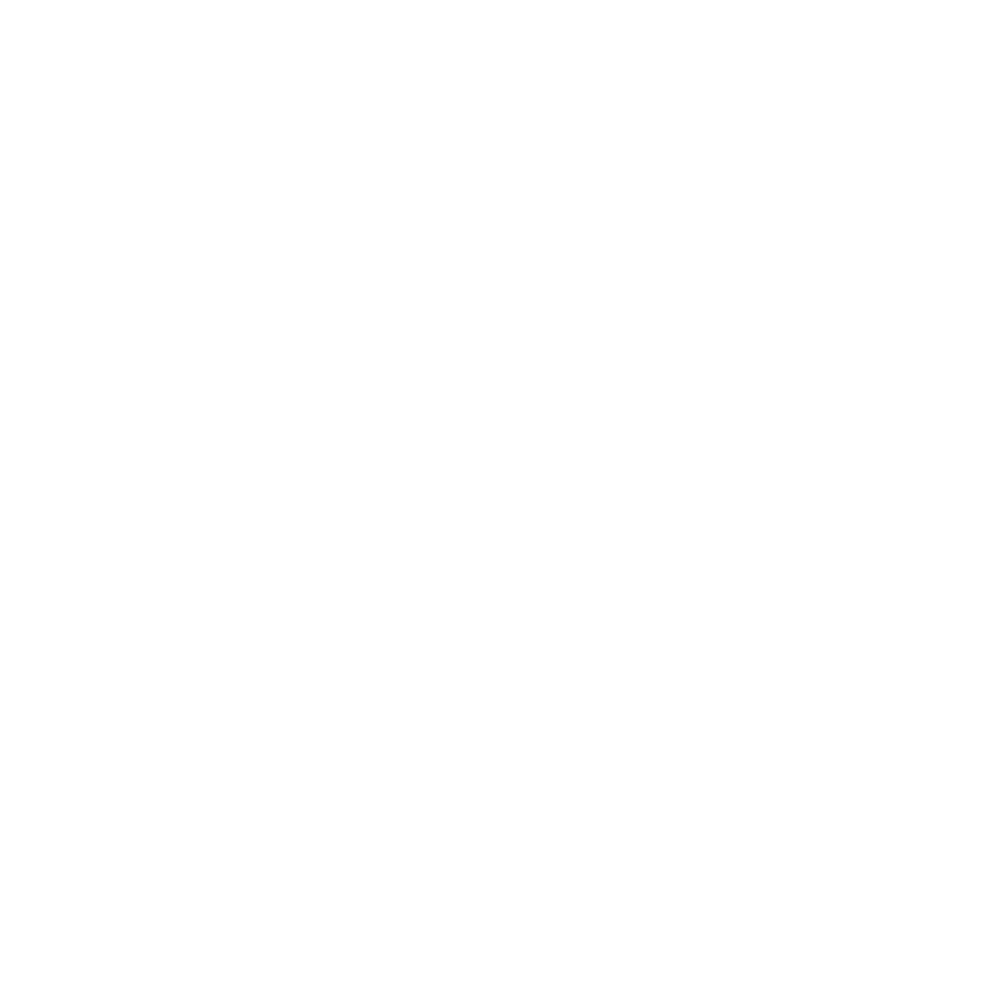

Drift correcting H4 on fov: Conv_zscan_13.tif
Fitting H4_750 on fov: Conv_zscan_13.tif


<IPython.core.display.Javascript object>


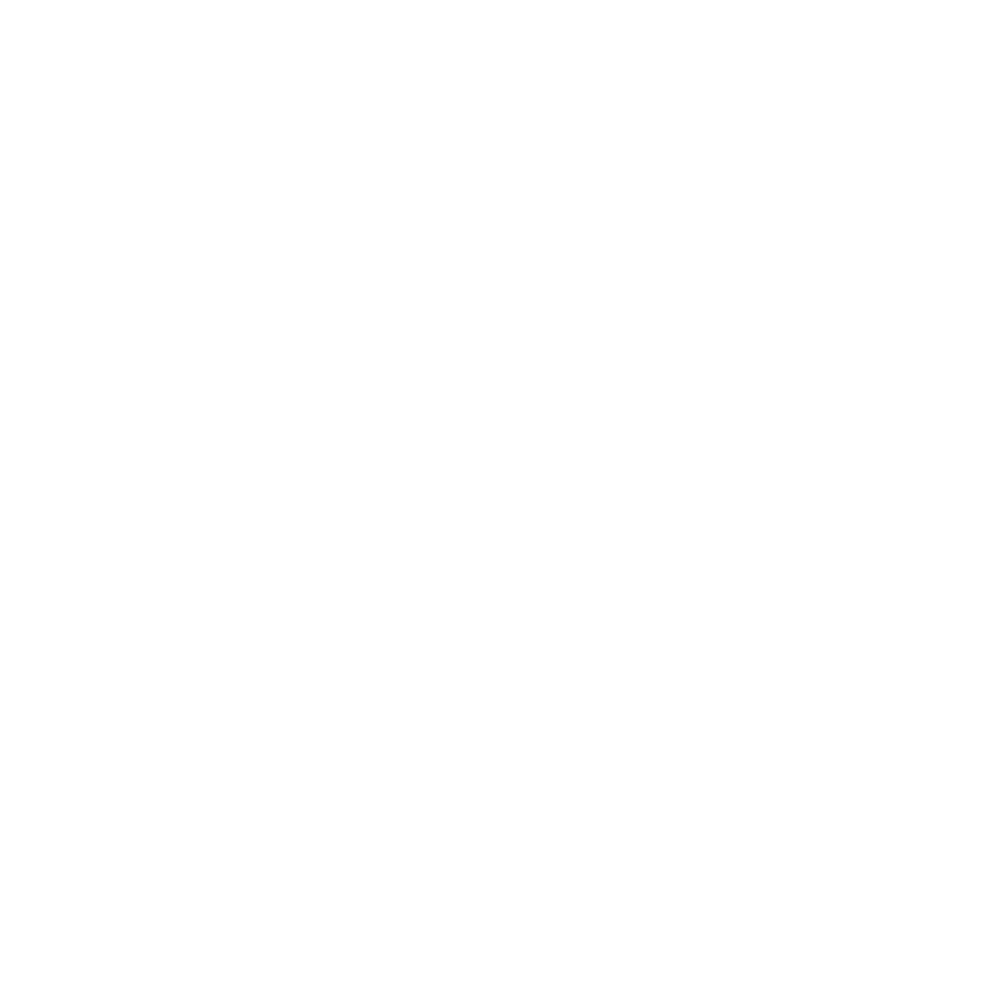

Fitting H4_647 on fov: Conv_zscan_13.tif


<IPython.core.display.Javascript object>


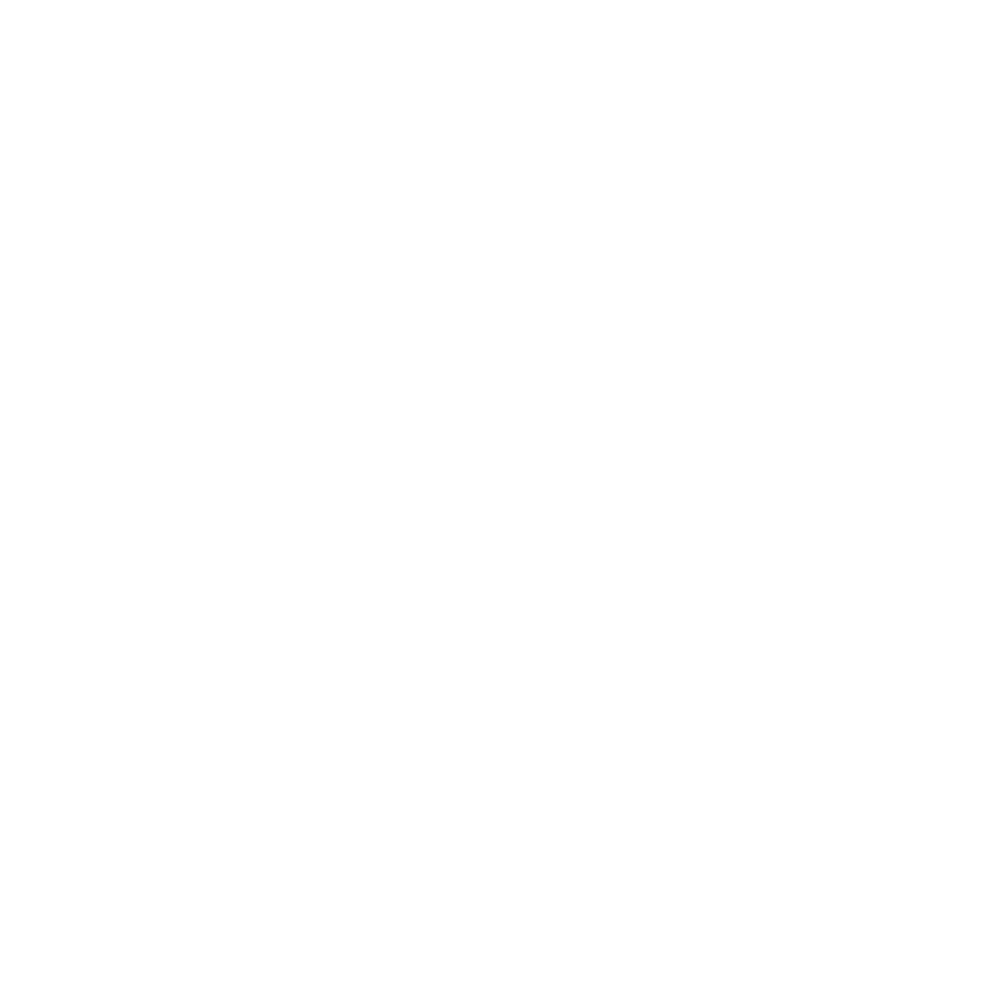

Drift correcting H5 on fov: Conv_zscan_13.tif
Fitting H5_750 on fov: Conv_zscan_13.tif


<IPython.core.display.Javascript object>


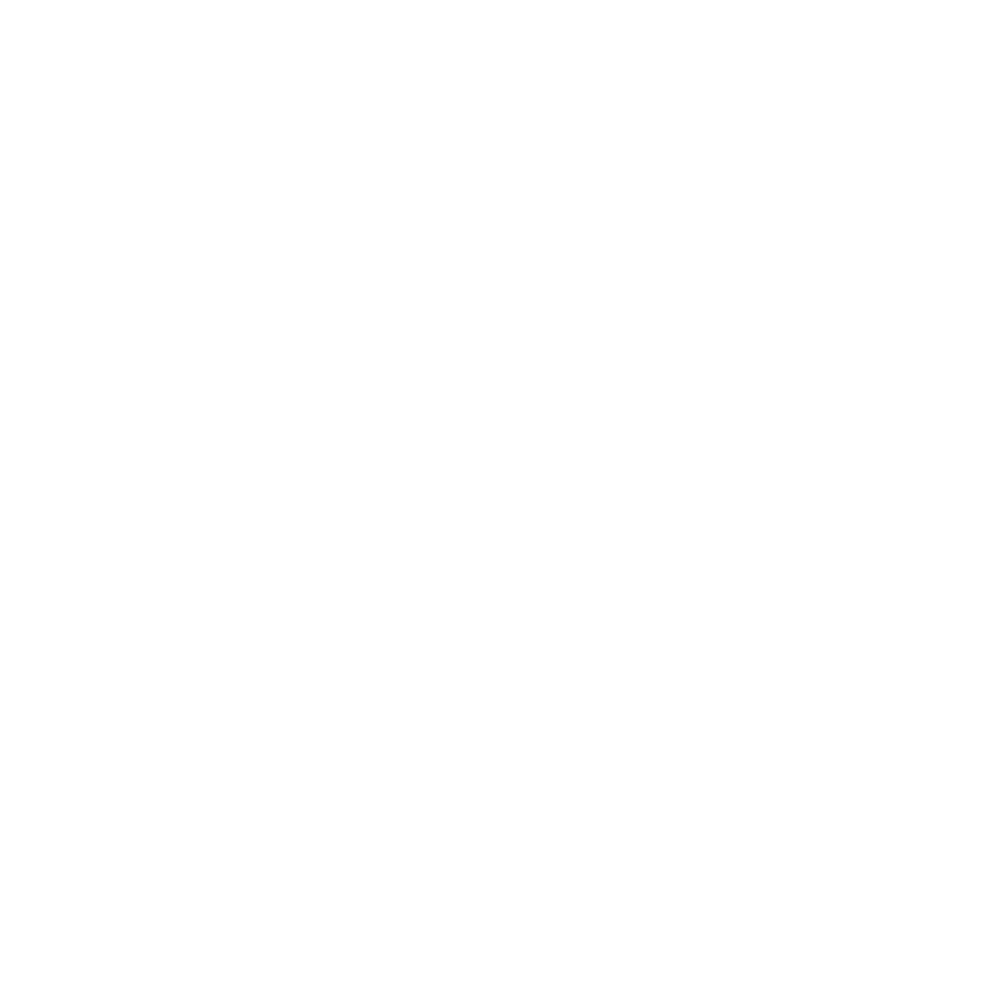

Fitting H5_647 on fov: Conv_zscan_13.tif


<IPython.core.display.Javascript object>


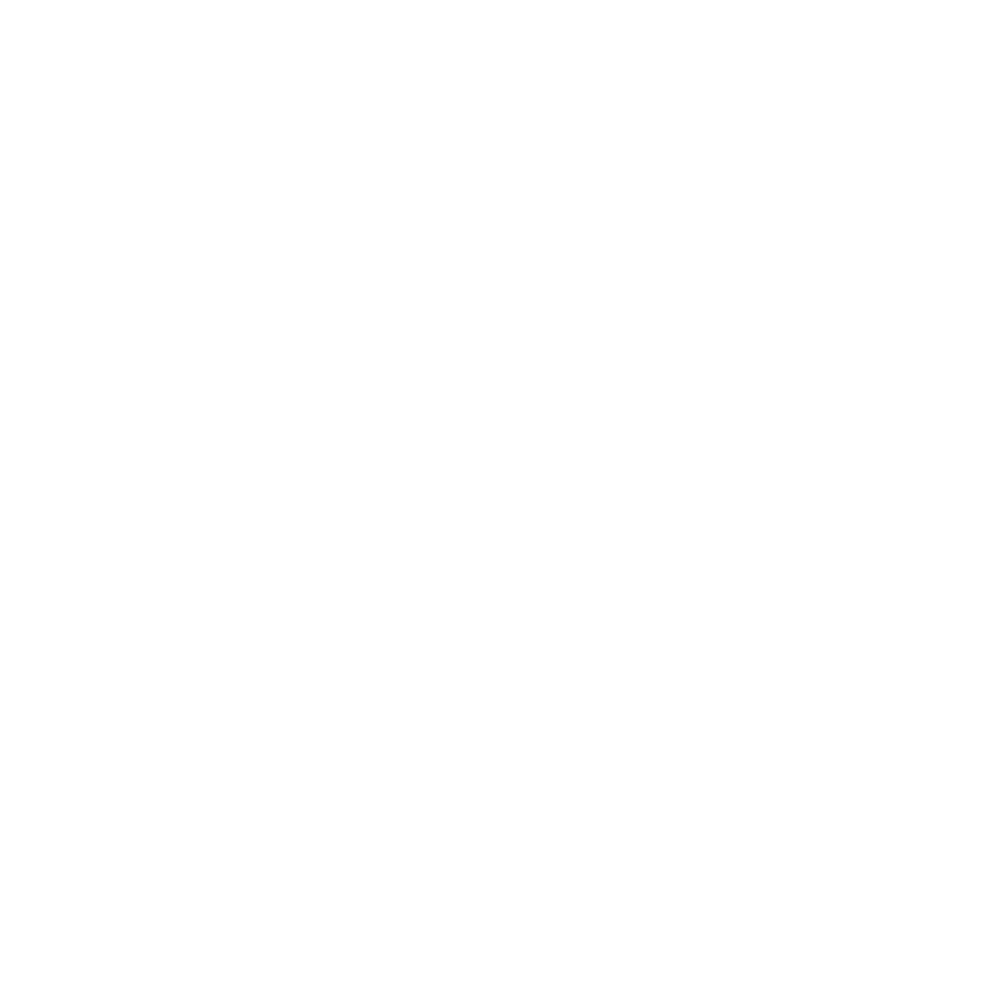

Drift correcting H6 on fov: Conv_zscan_13.tif
Fitting H6_750 on fov: Conv_zscan_13.tif


<IPython.core.display.Javascript object>


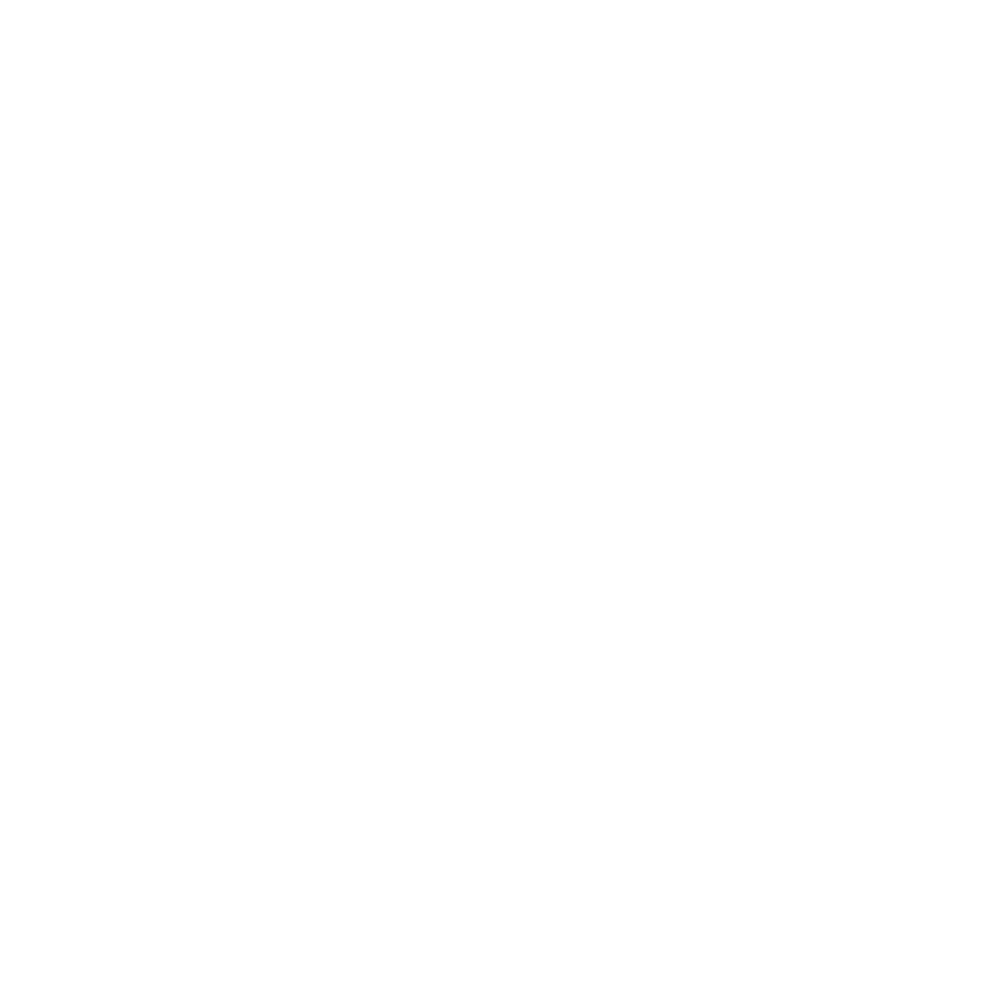

Fitting H6_647 on fov: Conv_zscan_13.tif


<IPython.core.display.Javascript object>


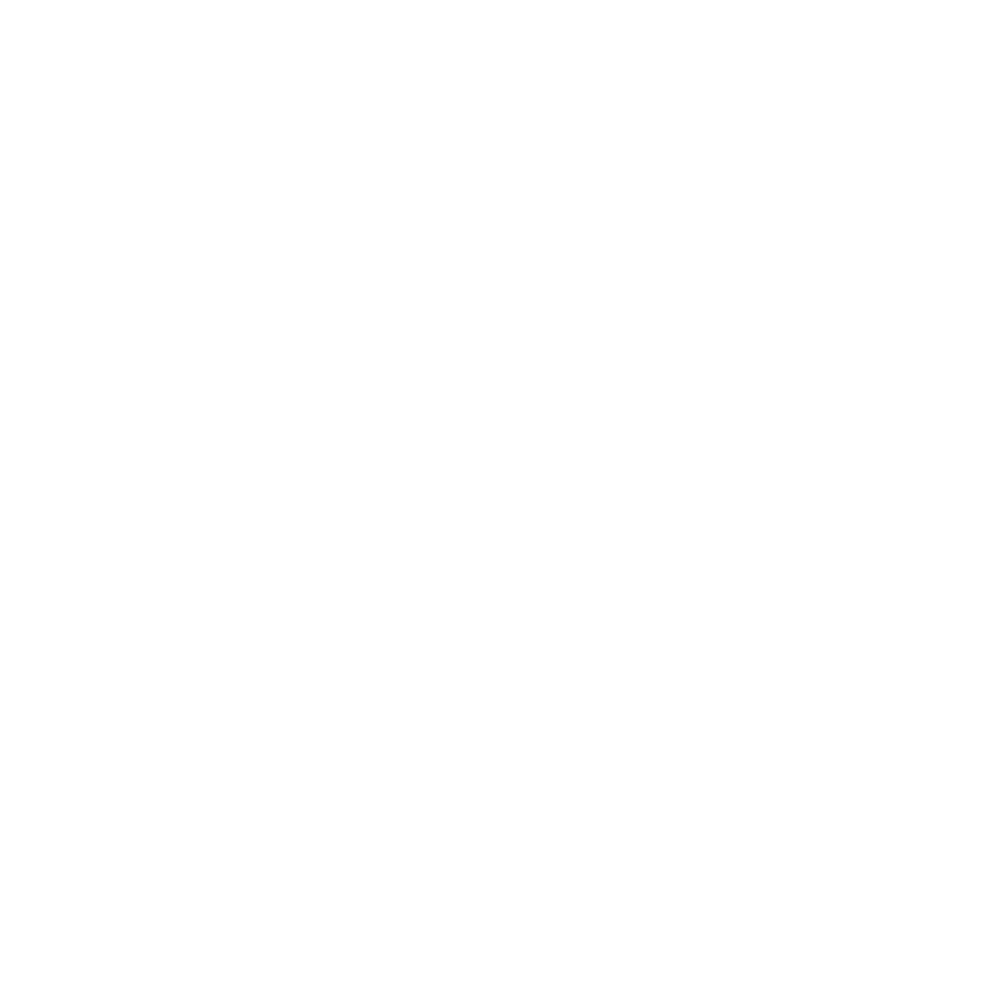

Estimating number of cells based on dapi image on fov: Conv_zscan_13.tif


<IPython.core.display.Javascript object>


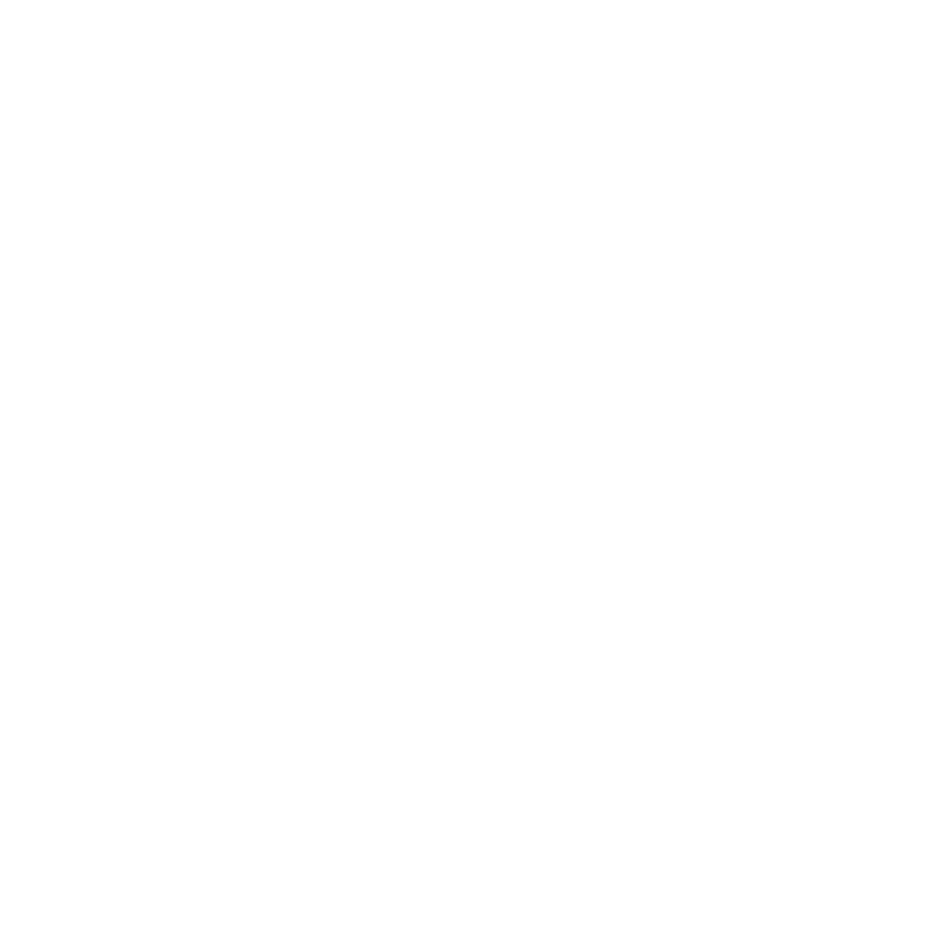

<ipython-input-27-1886a2f7fea2>:20: TqdmDeprecationWarning: This function will be removed in tqdm==5.0.0
Please use `tqdm.notebook.tqdm` instead of `tqdm.tqdm_notebook`
  for fld in tqdm(folders):



Drift correcting H1 on fov: Conv_zscan_14.tif
Fitting H1_750 on fov: Conv_zscan_14.tif


<IPython.core.display.Javascript object>


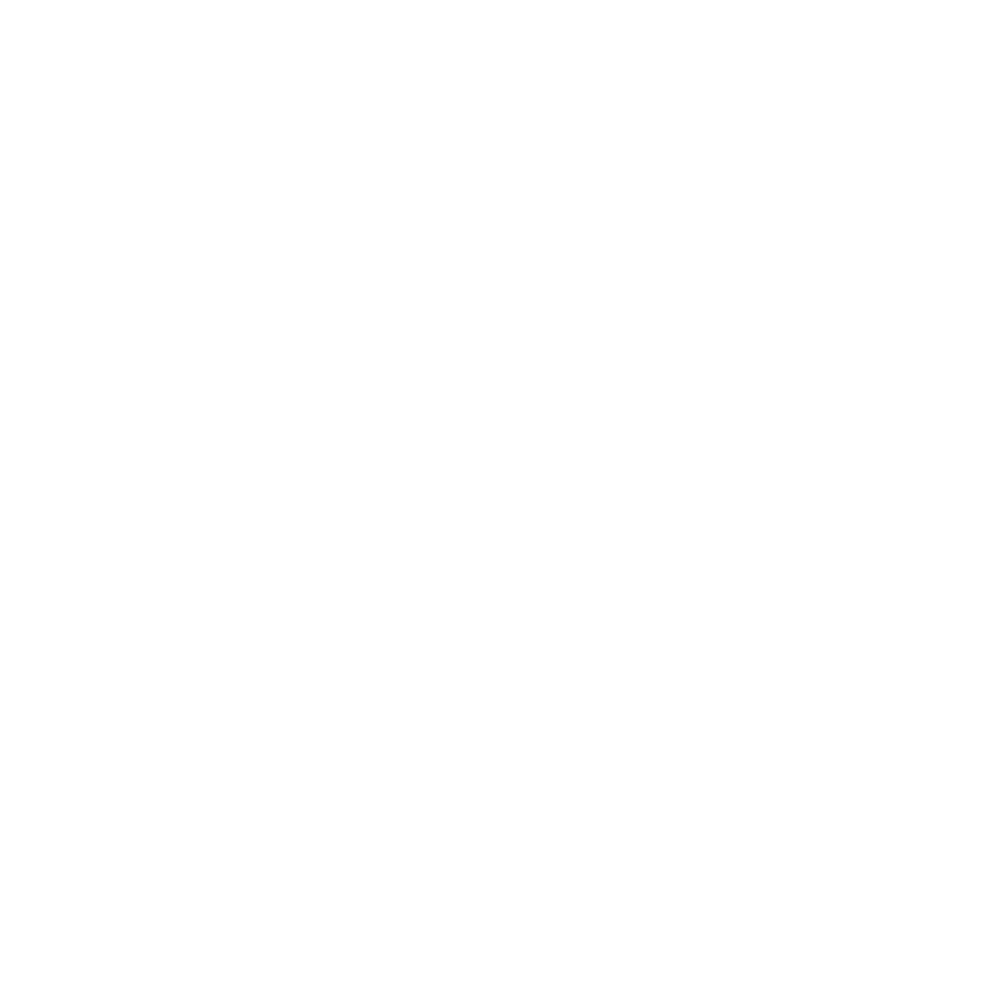

Fitting H1_647 on fov: Conv_zscan_14.tif


<IPython.core.display.Javascript object>


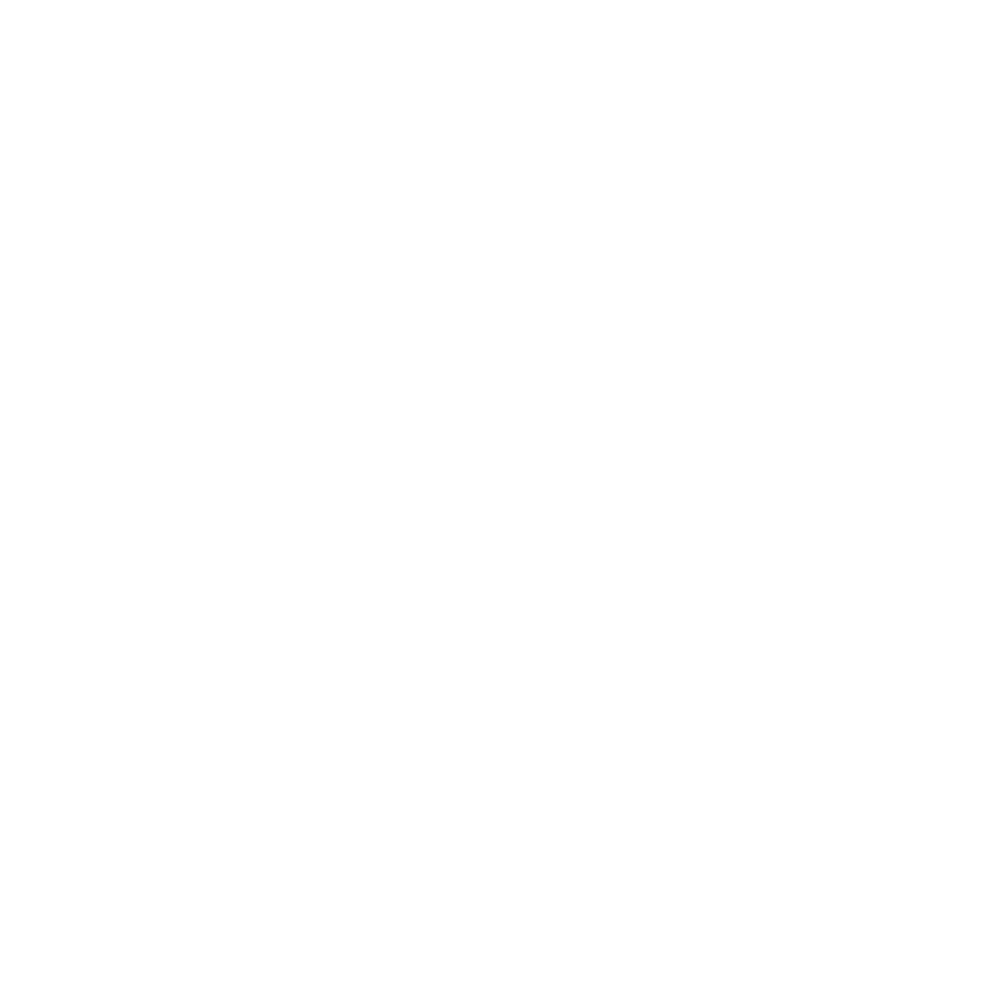

Drift correcting H2 on fov: Conv_zscan_14.tif
Fitting H2_750 on fov: Conv_zscan_14.tif


<IPython.core.display.Javascript object>


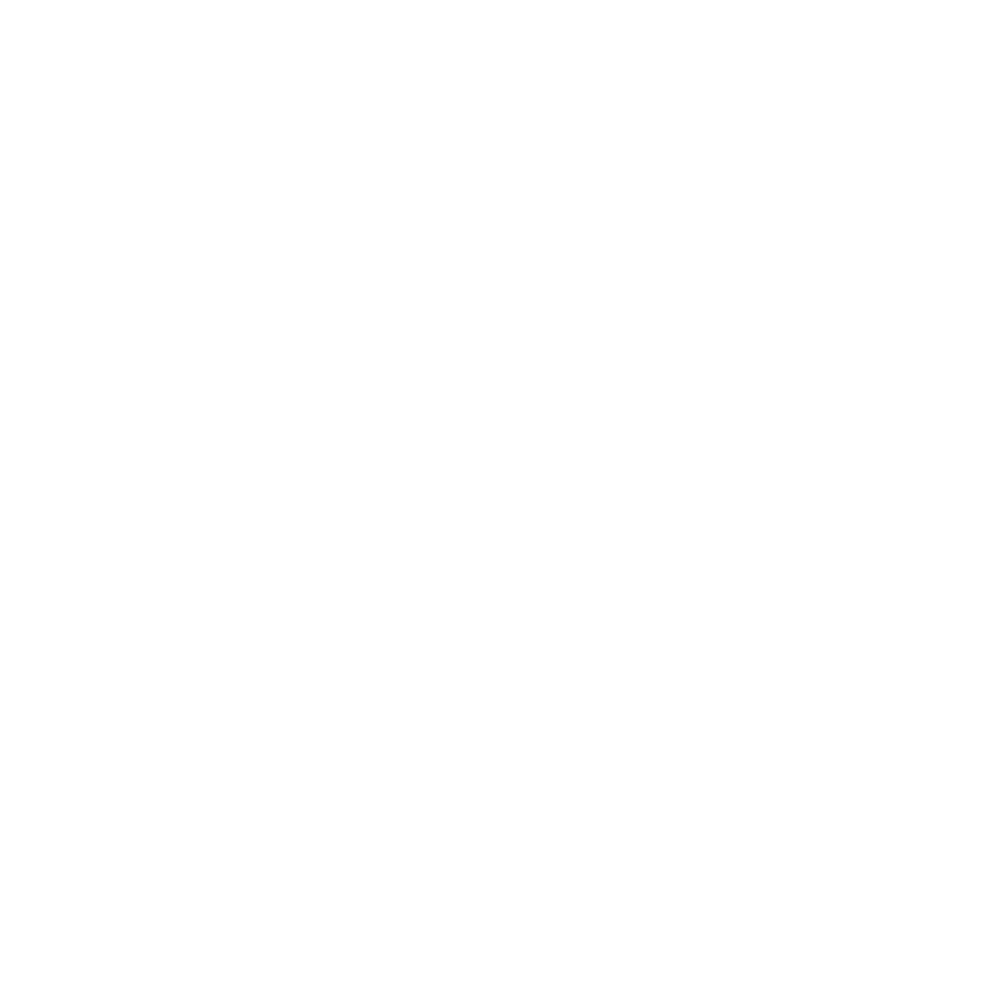

Fitting H2_647 on fov: Conv_zscan_14.tif


<IPython.core.display.Javascript object>


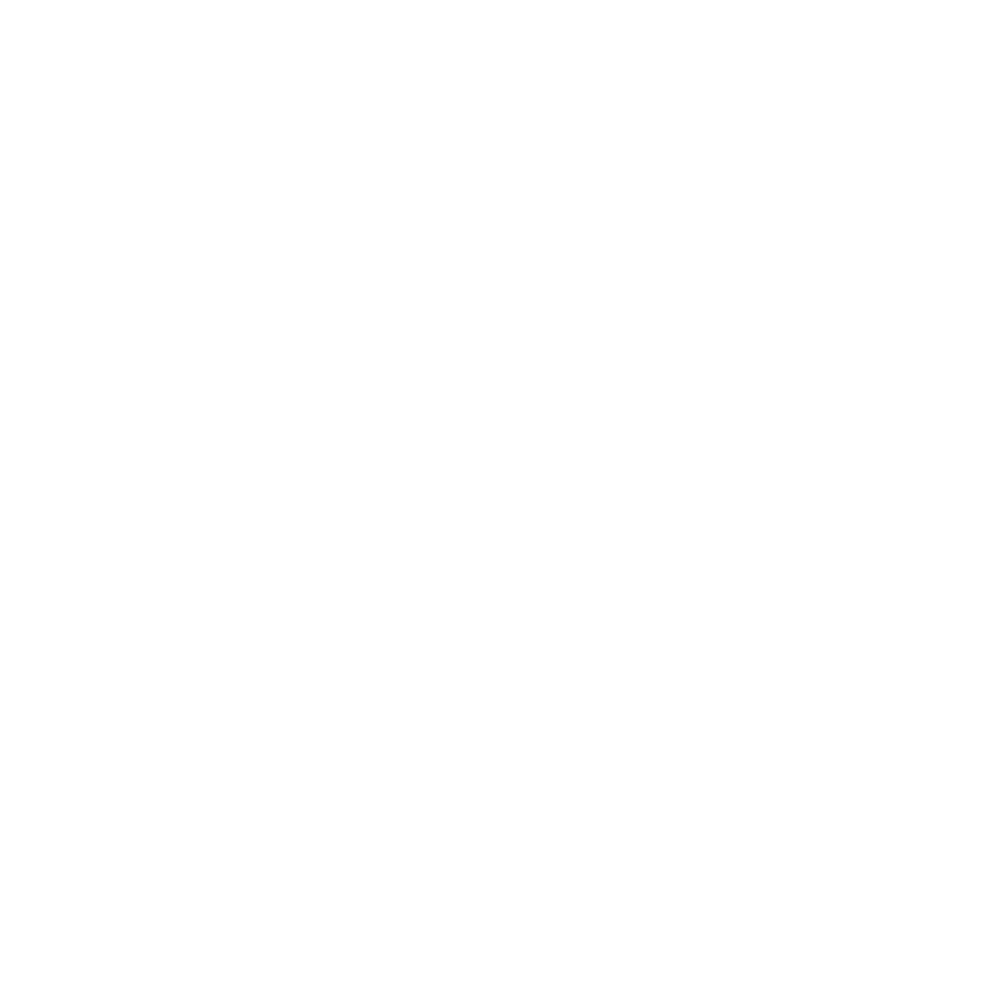

Drift correcting H3 on fov: Conv_zscan_14.tif
Fitting H3_750 on fov: Conv_zscan_14.tif


<IPython.core.display.Javascript object>


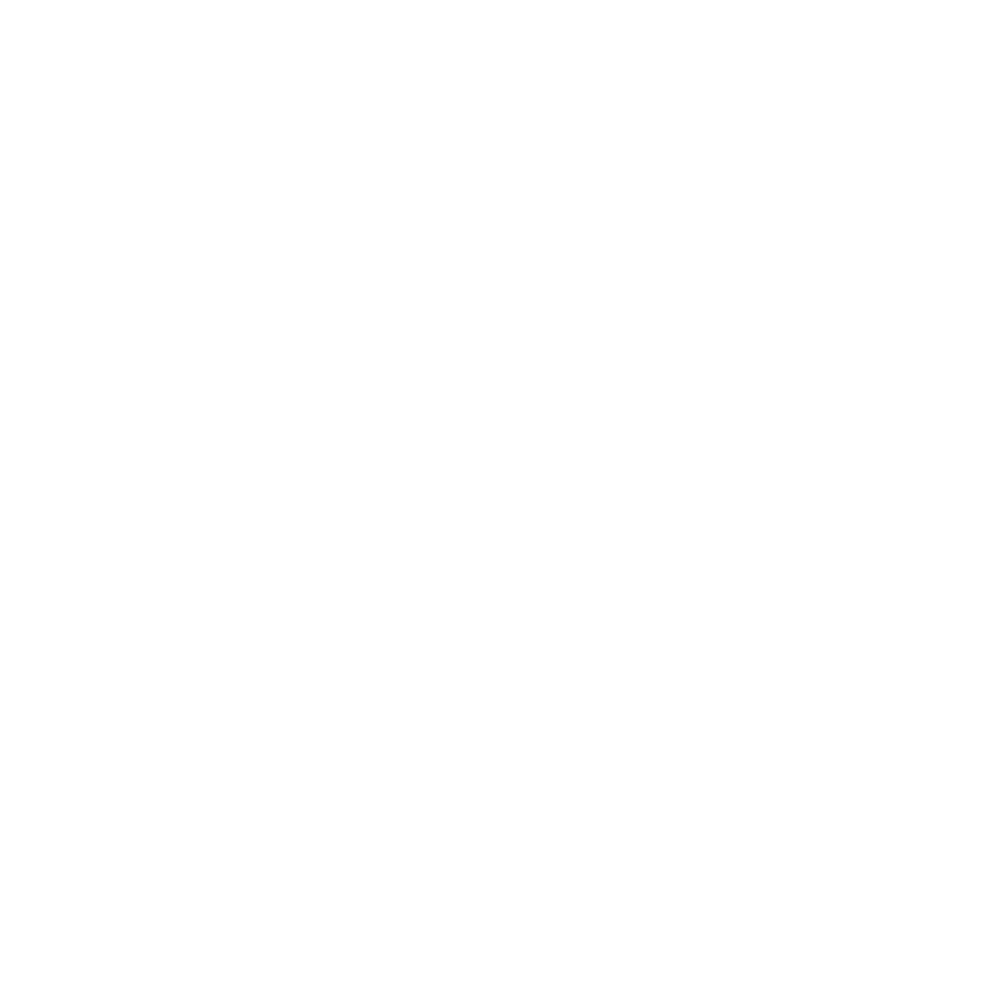

Fitting H3_647 on fov: Conv_zscan_14.tif


<IPython.core.display.Javascript object>


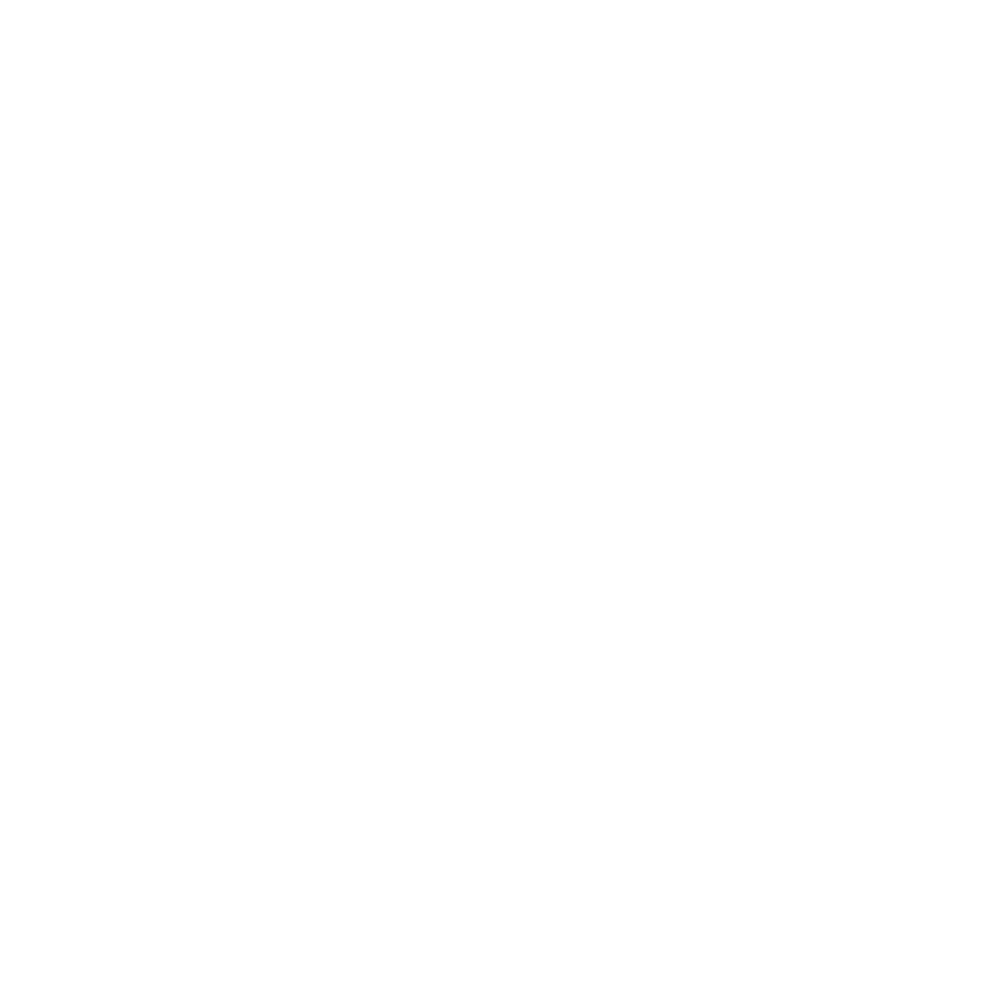

Drift correcting H4 on fov: Conv_zscan_14.tif
Fitting H4_750 on fov: Conv_zscan_14.tif


<IPython.core.display.Javascript object>


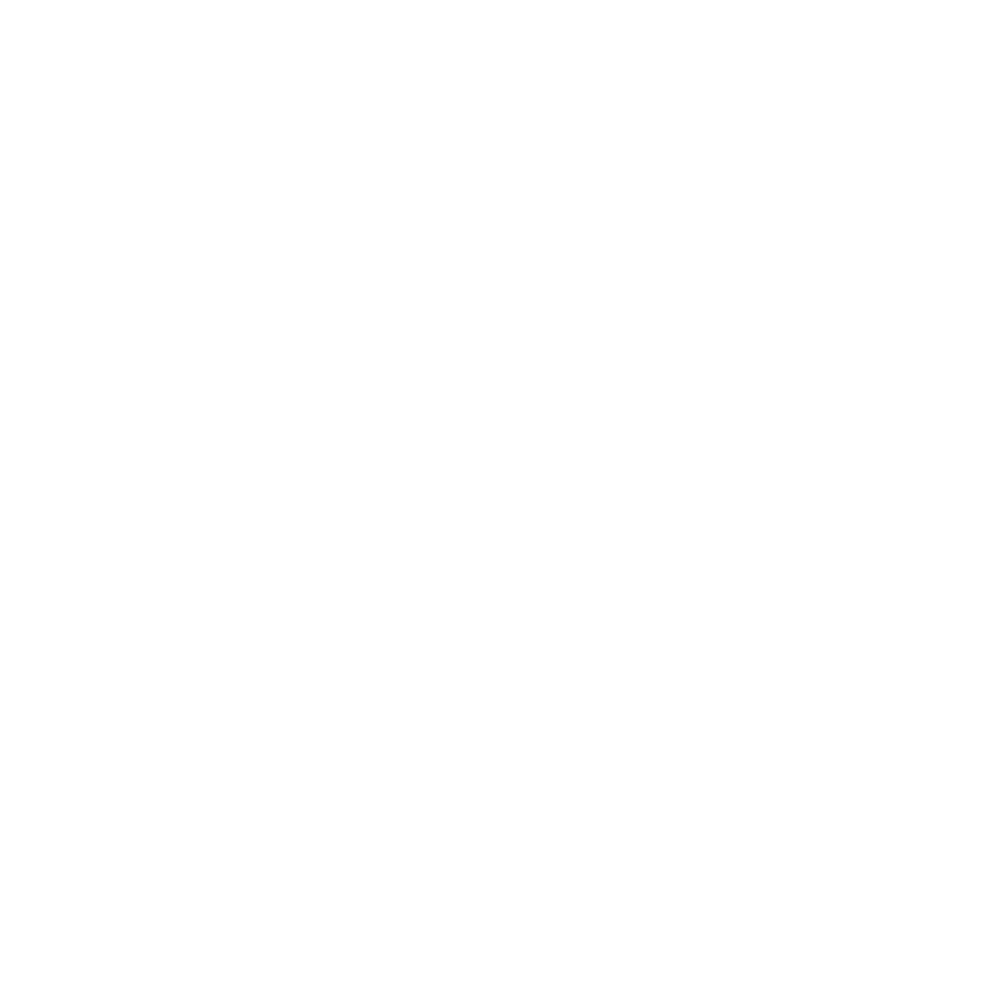

Fitting H4_647 on fov: Conv_zscan_14.tif


<IPython.core.display.Javascript object>


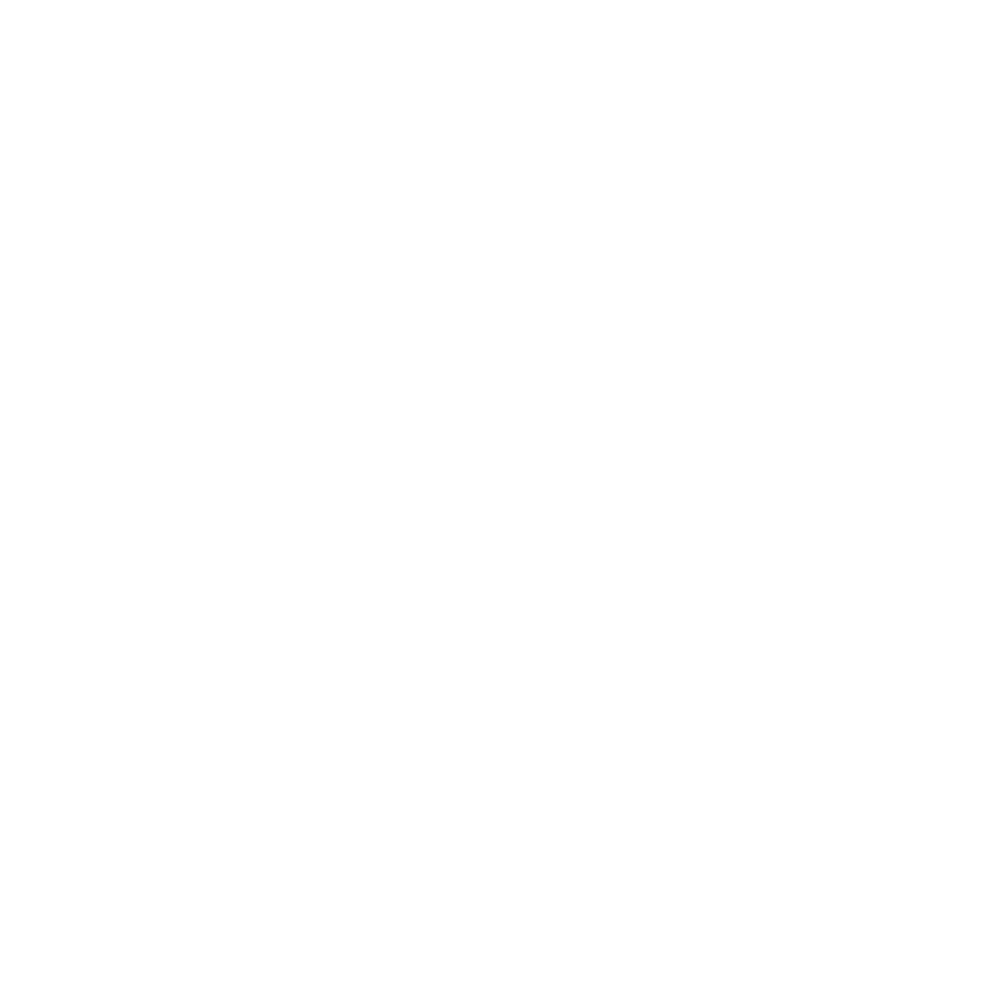

Drift correcting H5 on fov: Conv_zscan_14.tif
Fitting H5_750 on fov: Conv_zscan_14.tif


<IPython.core.display.Javascript object>


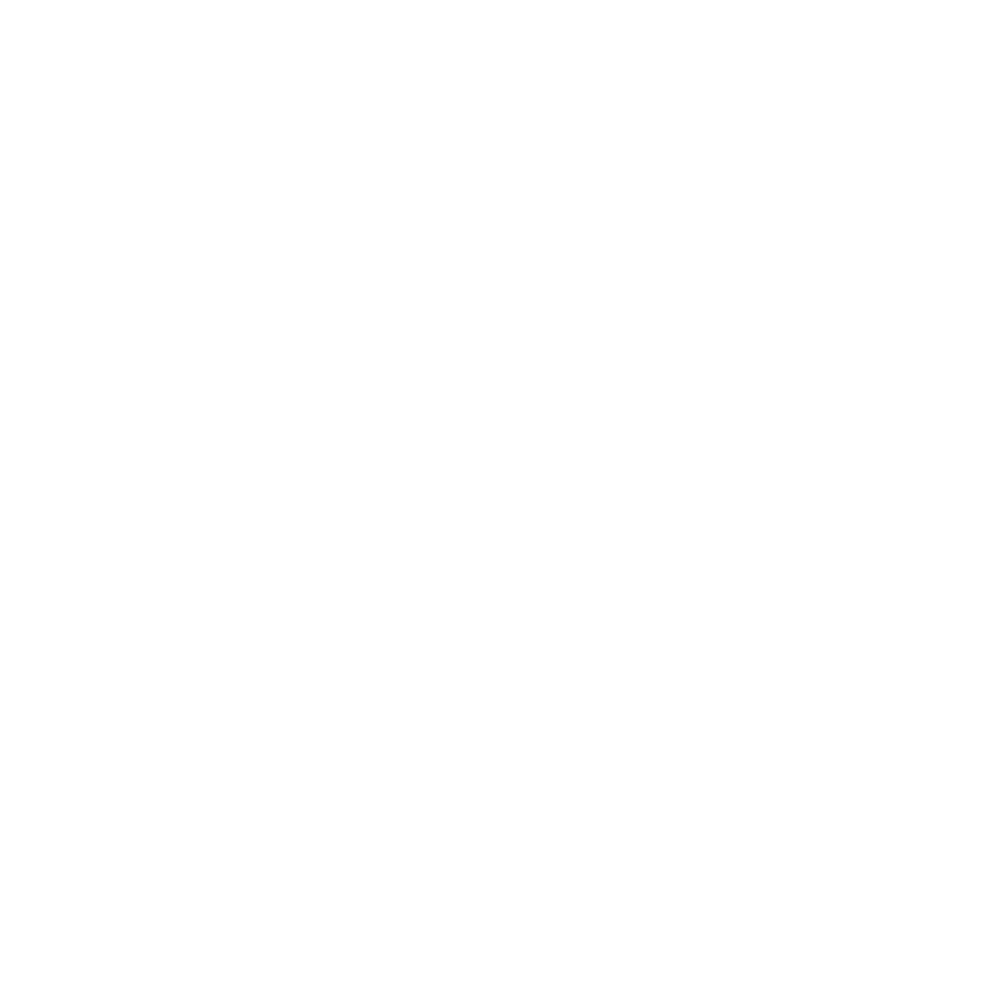

Fitting H5_647 on fov: Conv_zscan_14.tif


<IPython.core.display.Javascript object>


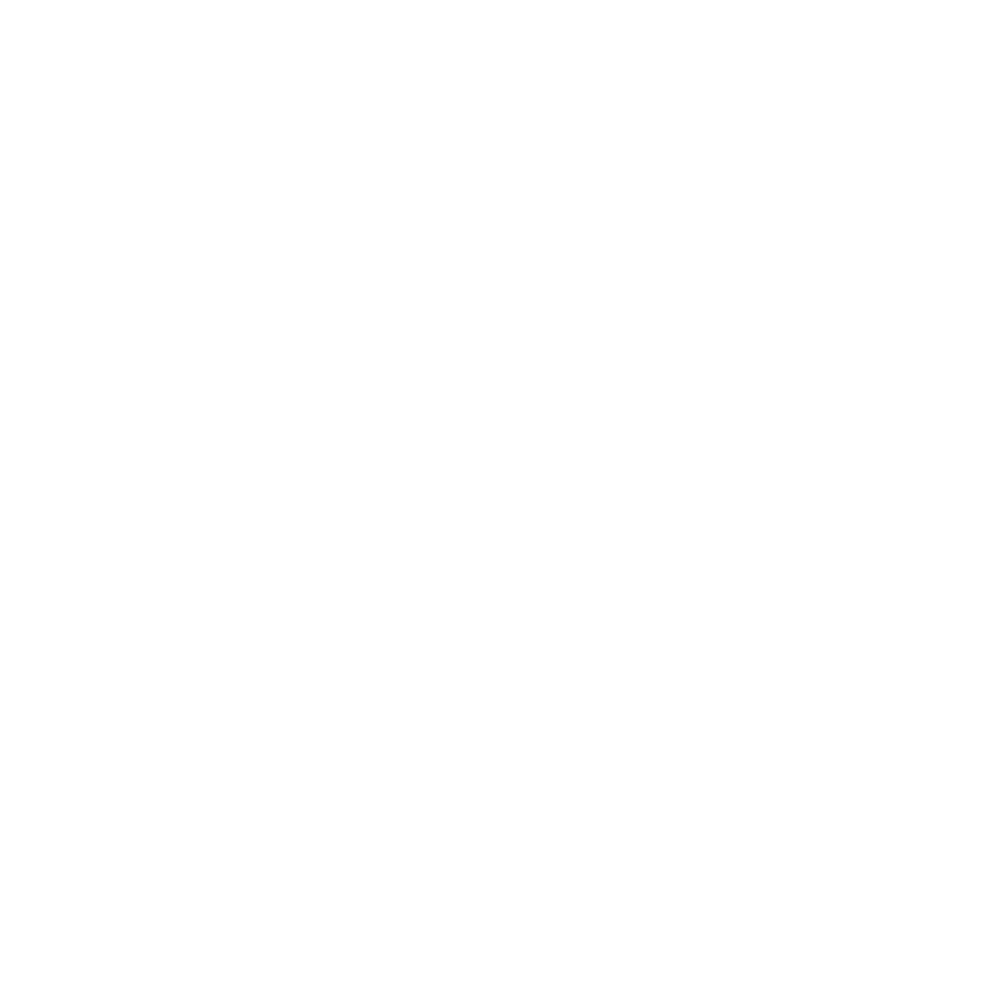

Drift correcting H6 on fov: Conv_zscan_14.tif
Fitting H6_750 on fov: Conv_zscan_14.tif


<IPython.core.display.Javascript object>


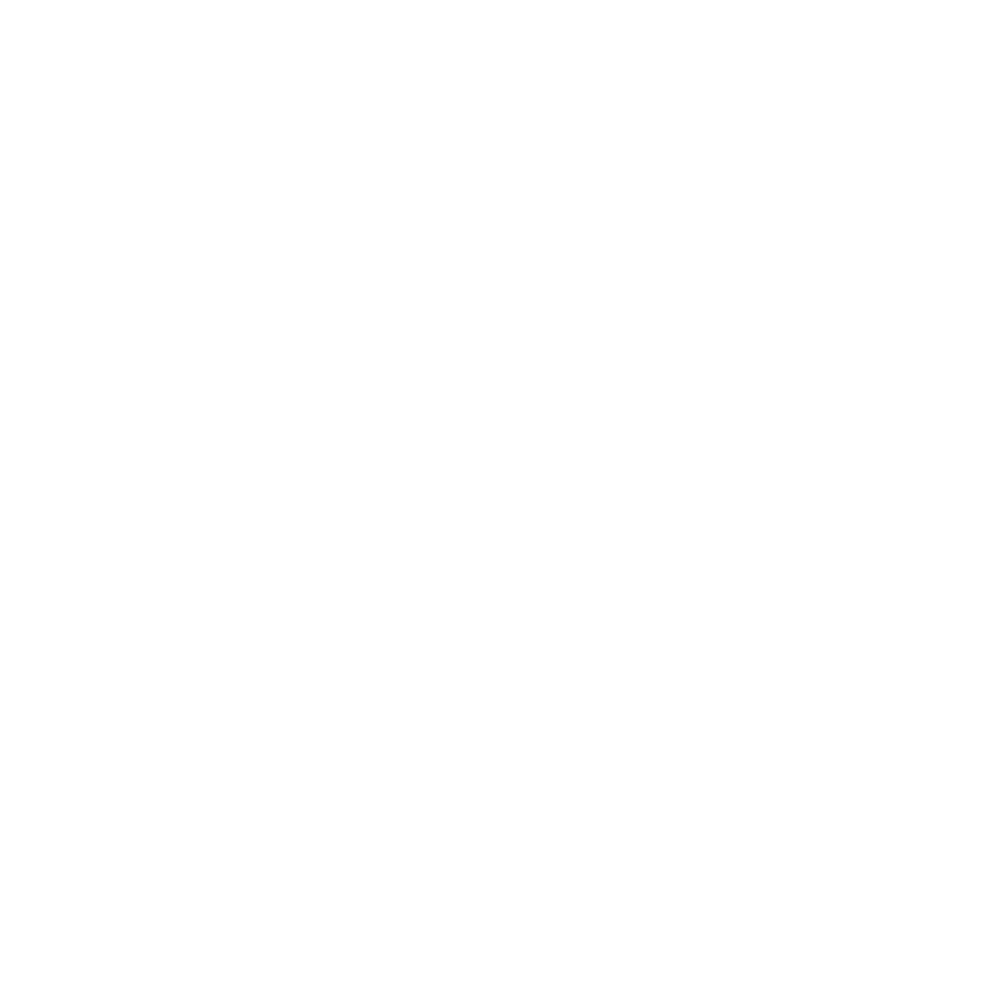

Fitting H6_647 on fov: Conv_zscan_14.tif


<IPython.core.display.Javascript object>


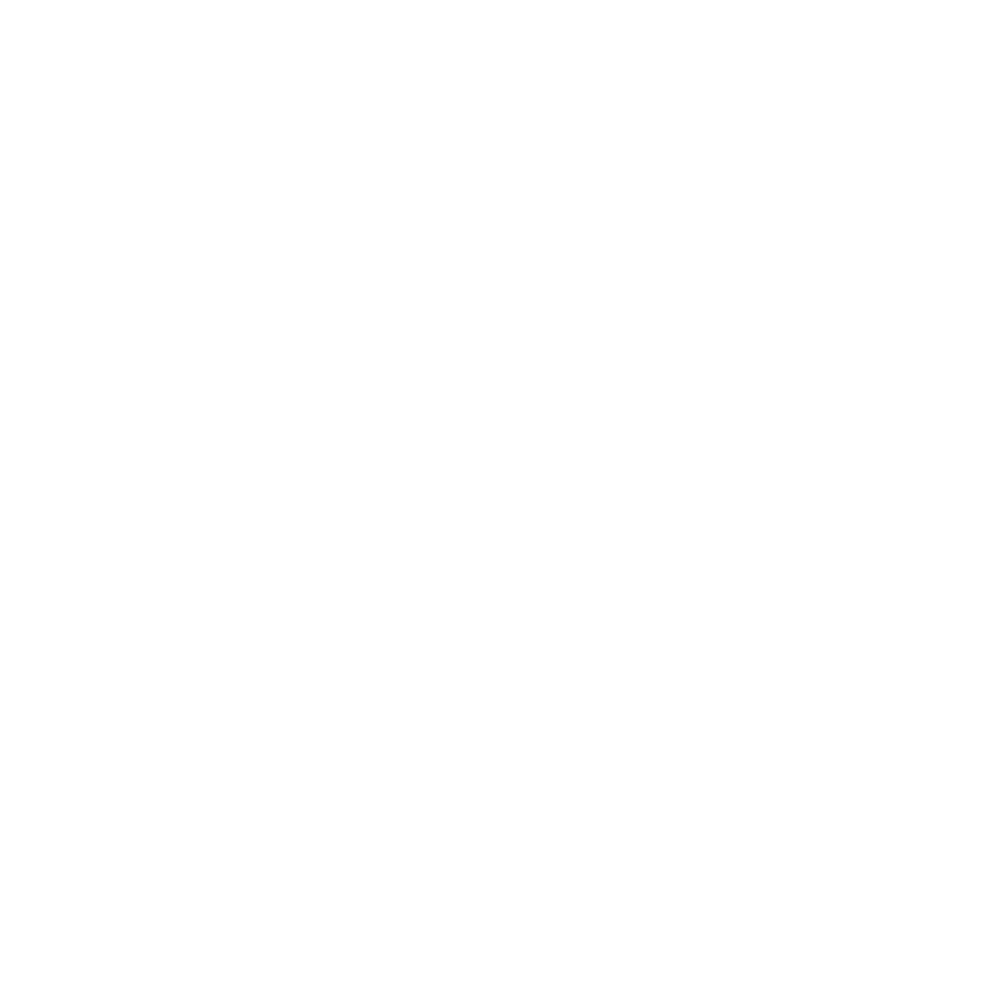

Estimating number of cells based on dapi image on fov: Conv_zscan_14.tif


<IPython.core.display.Javascript object>


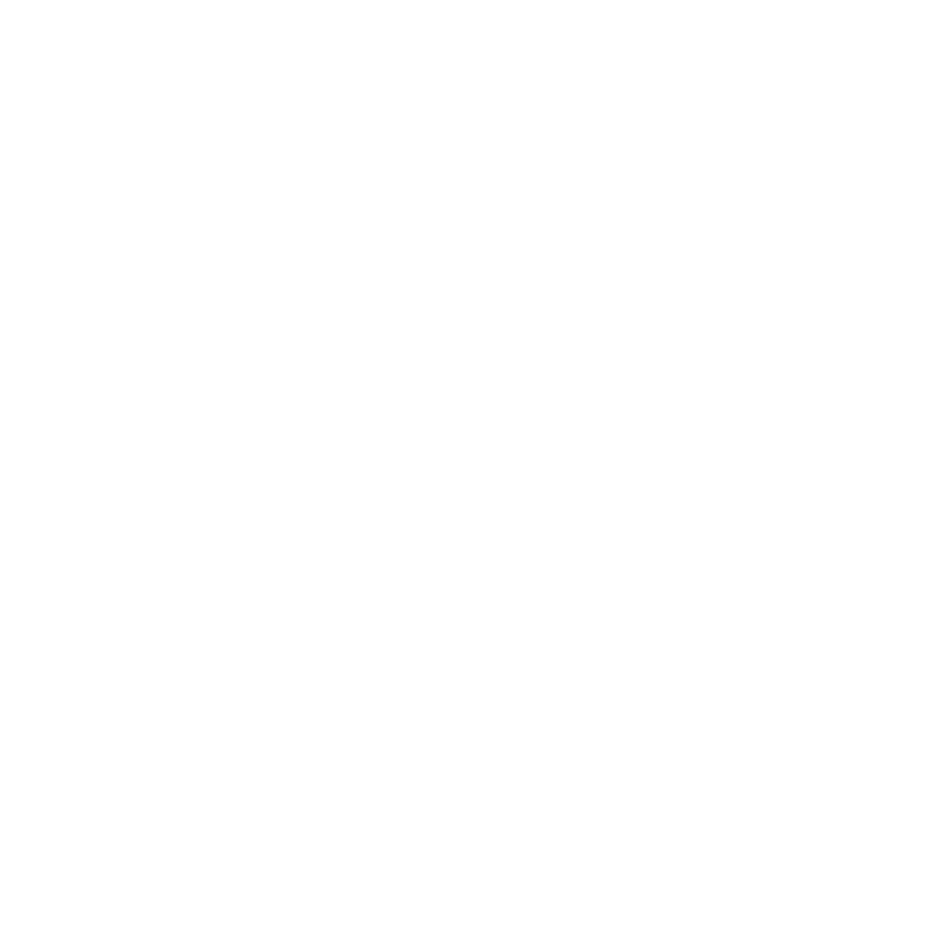

<ipython-input-27-1886a2f7fea2>:20: TqdmDeprecationWarning: This function will be removed in tqdm==5.0.0
Please use `tqdm.notebook.tqdm` instead of `tqdm.tqdm_notebook`
  for fld in tqdm(folders):



Drift correcting H1 on fov: Conv_zscan_15.tif
Fitting H1_750 on fov: Conv_zscan_15.tif


<IPython.core.display.Javascript object>


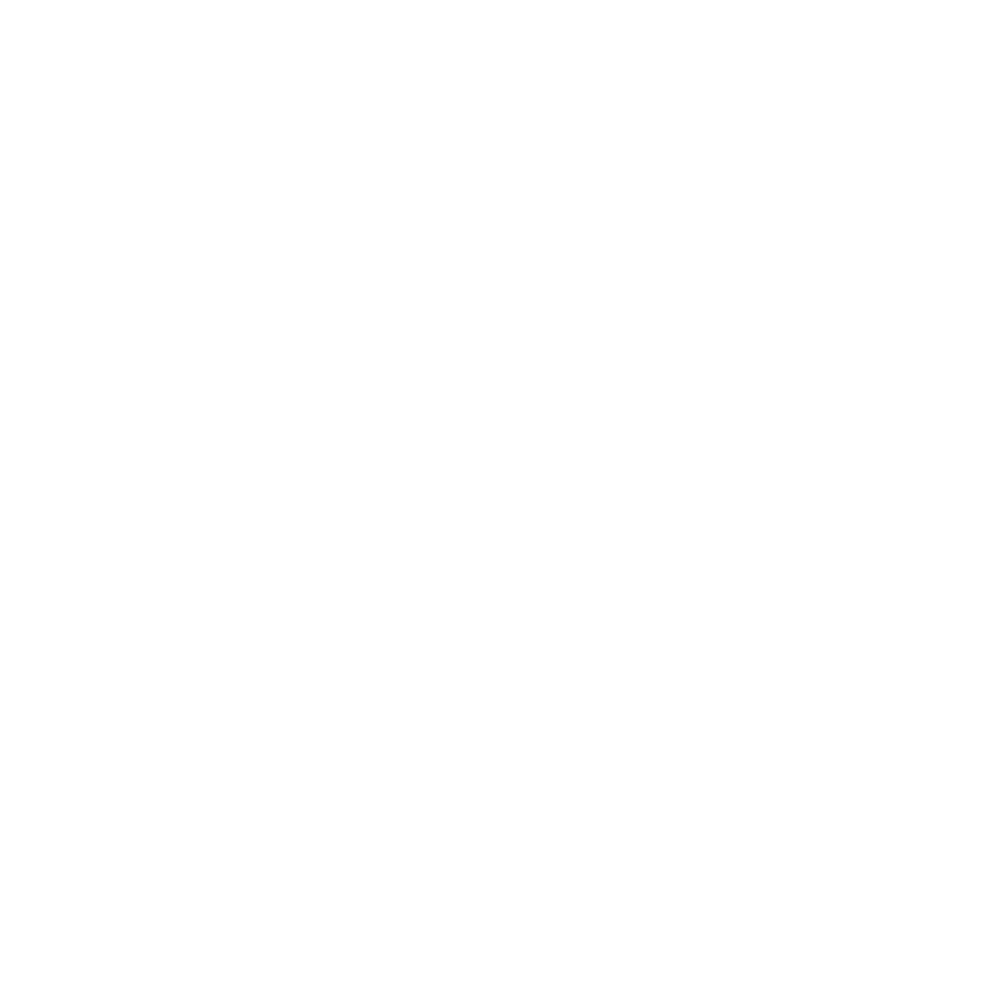

Fitting H1_647 on fov: Conv_zscan_15.tif


<IPython.core.display.Javascript object>


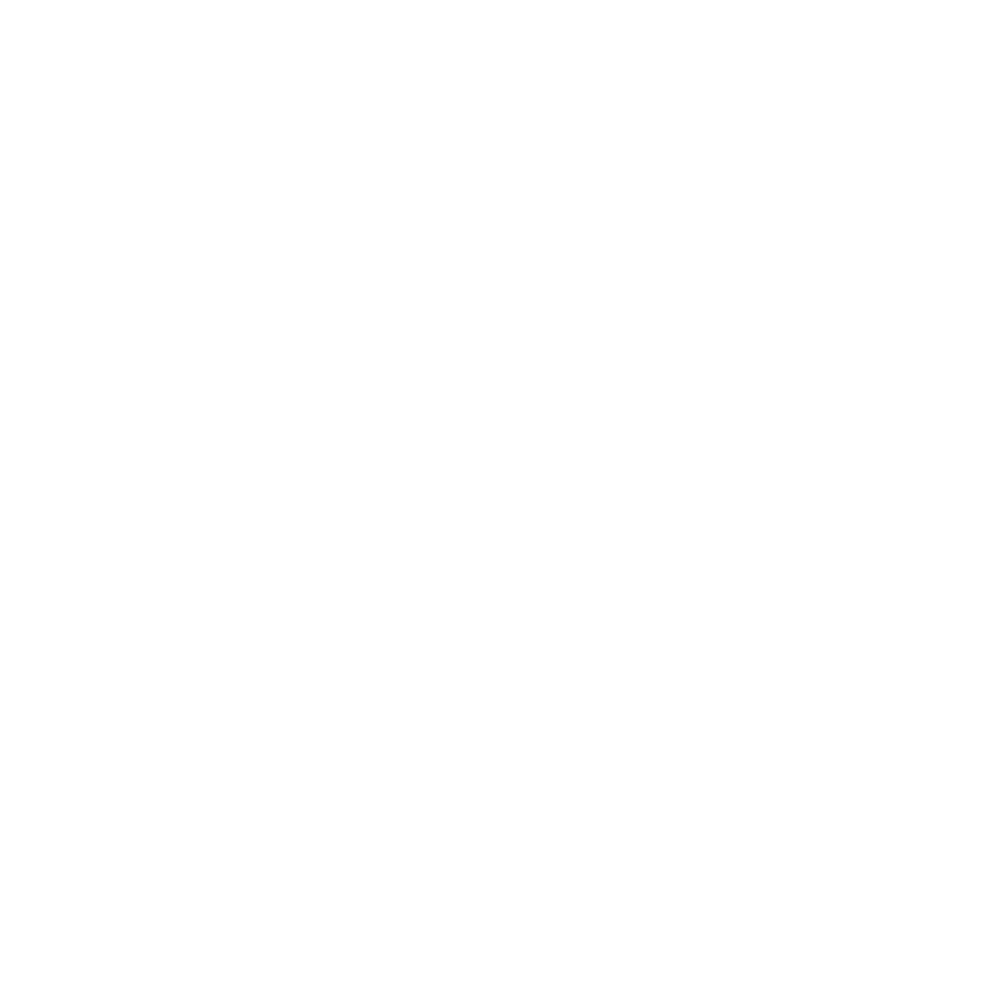

Drift correcting H2 on fov: Conv_zscan_15.tif
Fitting H2_750 on fov: Conv_zscan_15.tif


<IPython.core.display.Javascript object>


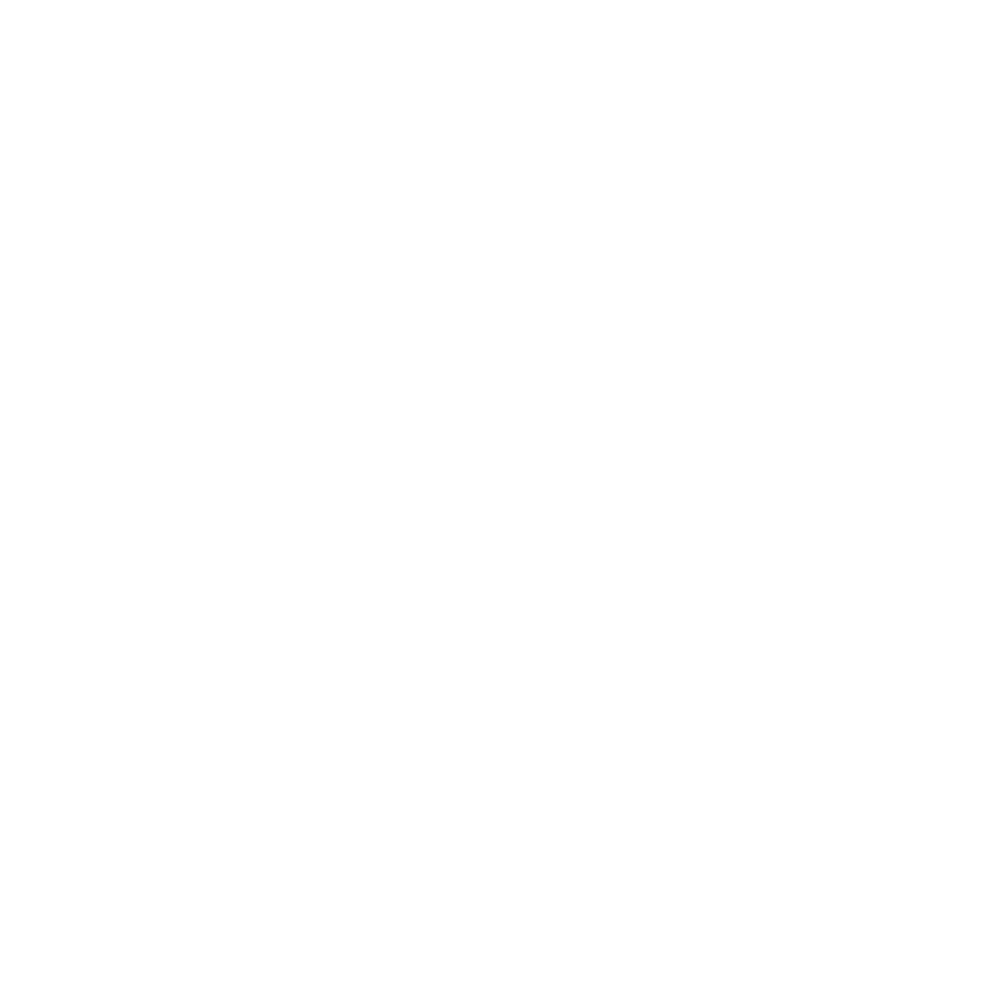

Fitting H2_647 on fov: Conv_zscan_15.tif


<IPython.core.display.Javascript object>


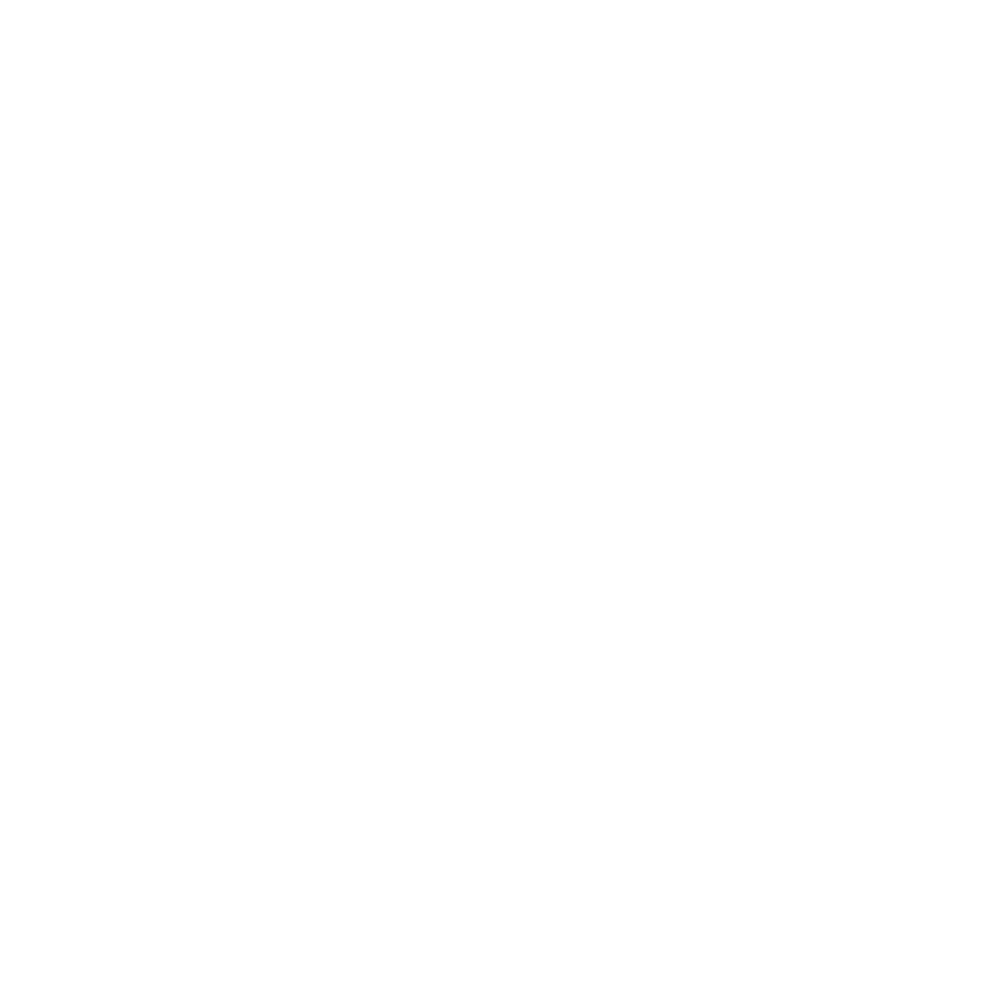

Drift correcting H3 on fov: Conv_zscan_15.tif
Fitting H3_750 on fov: Conv_zscan_15.tif


<IPython.core.display.Javascript object>


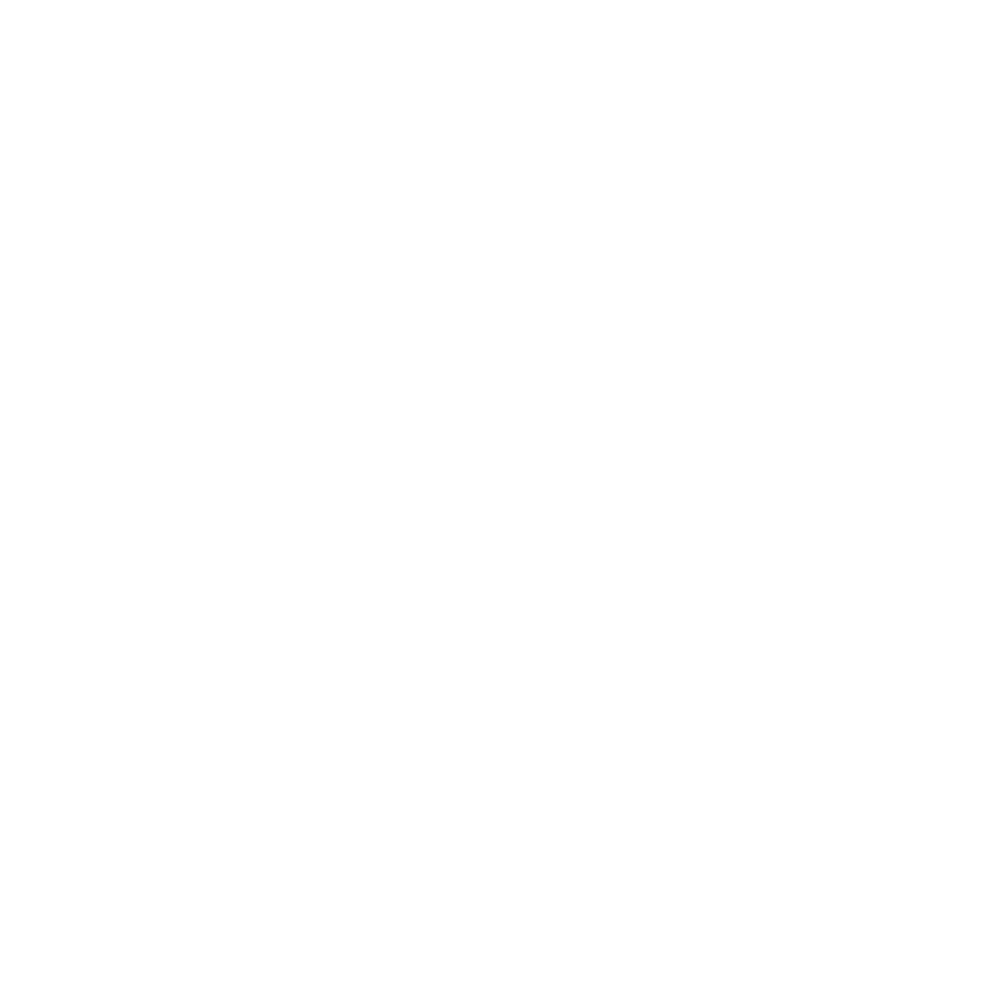

Fitting H3_647 on fov: Conv_zscan_15.tif


<IPython.core.display.Javascript object>


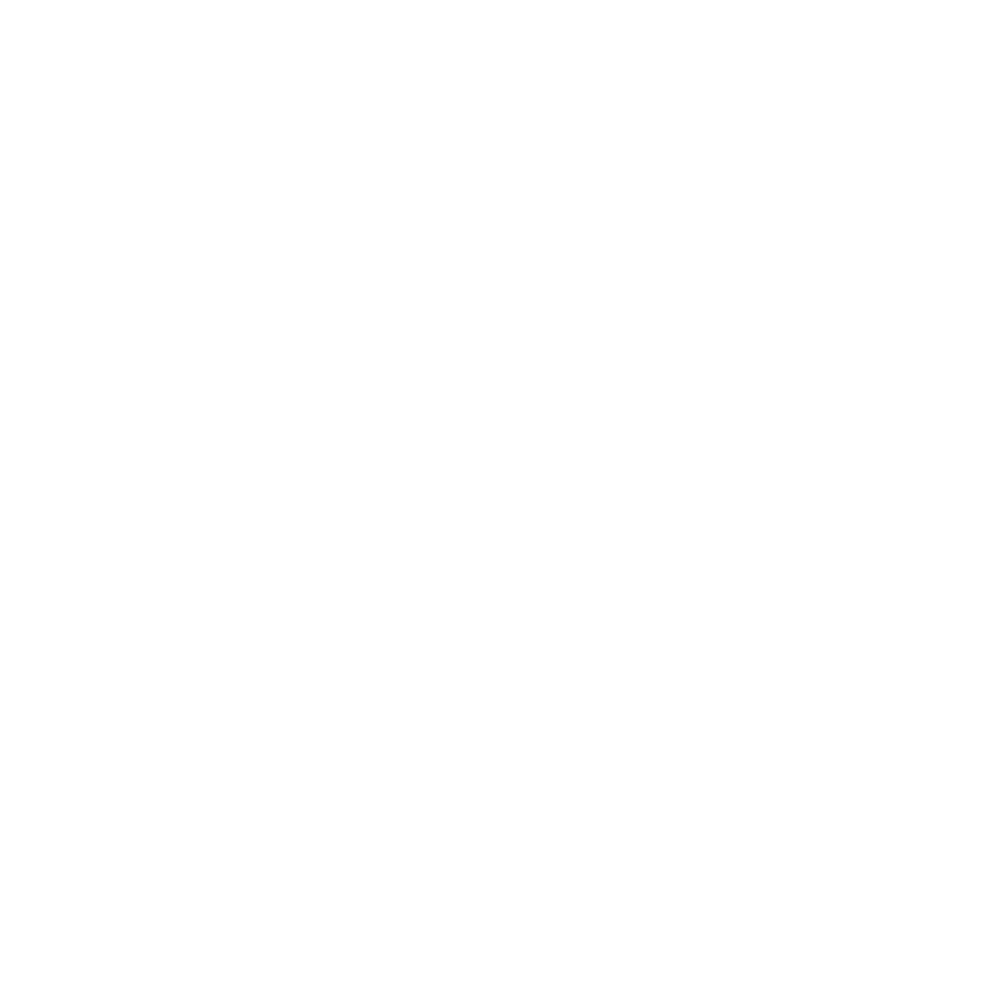

Drift correcting H4 on fov: Conv_zscan_15.tif
Fitting H4_750 on fov: Conv_zscan_15.tif


<IPython.core.display.Javascript object>


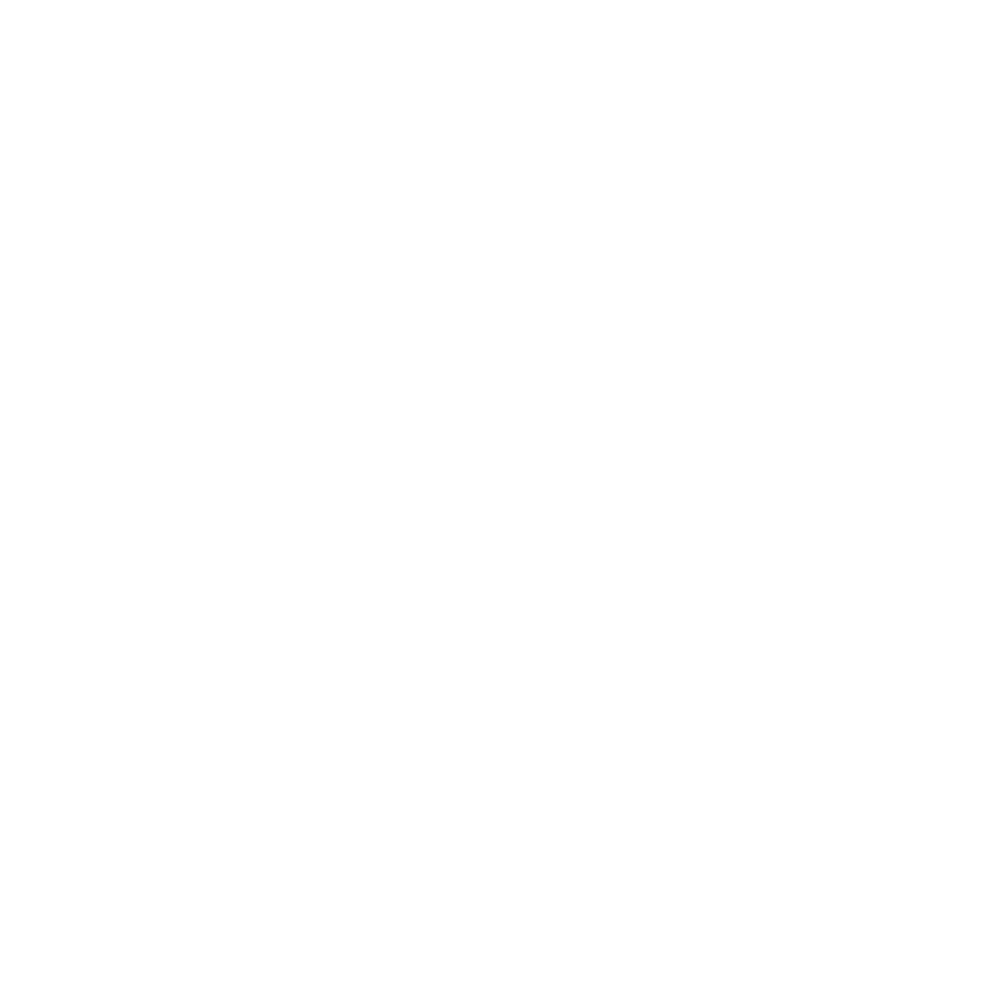

Fitting H4_647 on fov: Conv_zscan_15.tif


<IPython.core.display.Javascript object>


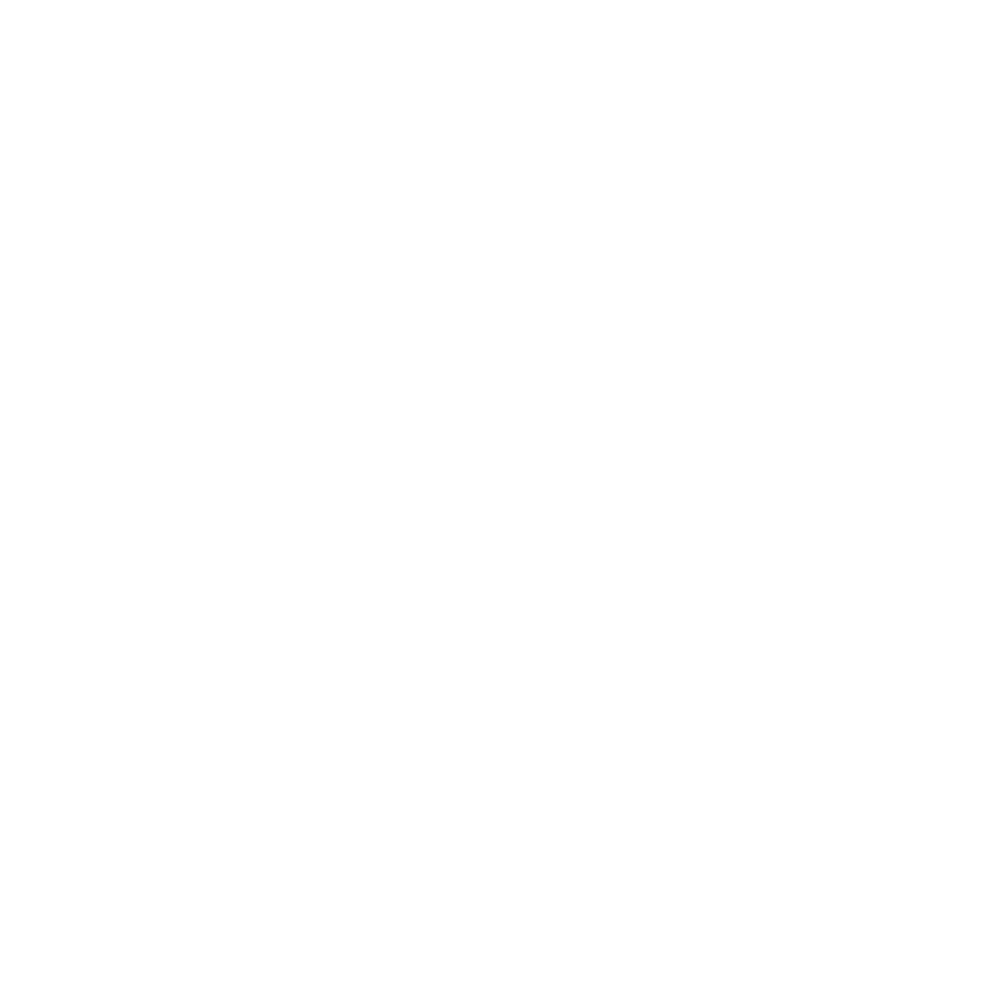

Drift correcting H5 on fov: Conv_zscan_15.tif
Fitting H5_750 on fov: Conv_zscan_15.tif


<IPython.core.display.Javascript object>


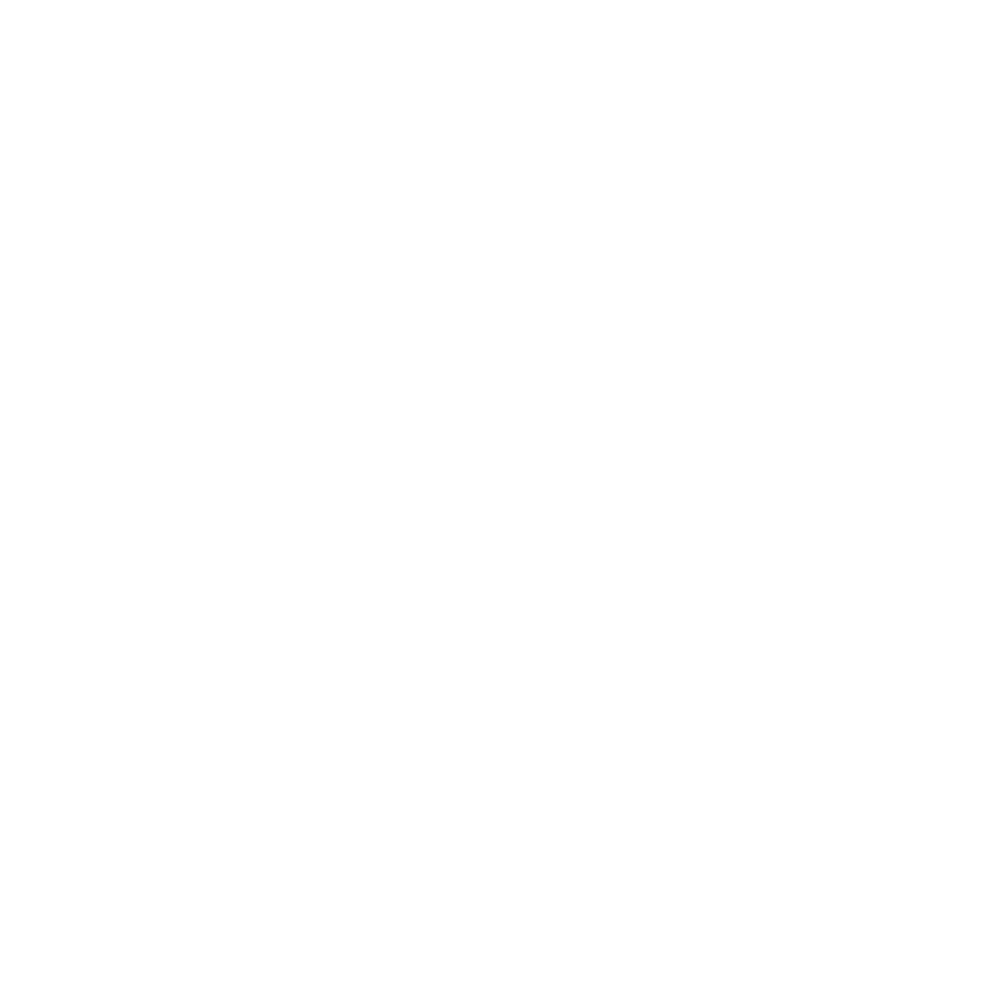

Fitting H5_647 on fov: Conv_zscan_15.tif


<IPython.core.display.Javascript object>


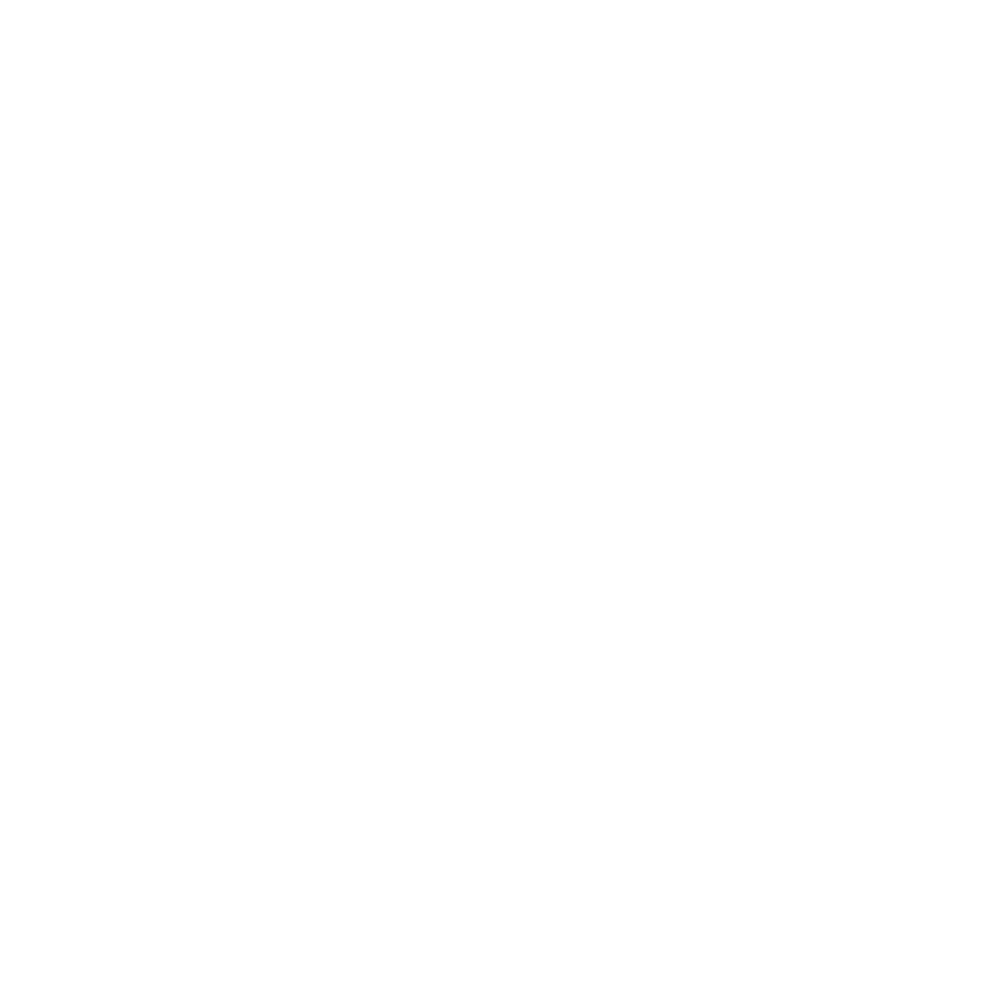

Drift correcting H6 on fov: Conv_zscan_15.tif
Fitting H6_750 on fov: Conv_zscan_15.tif


<IPython.core.display.Javascript object>


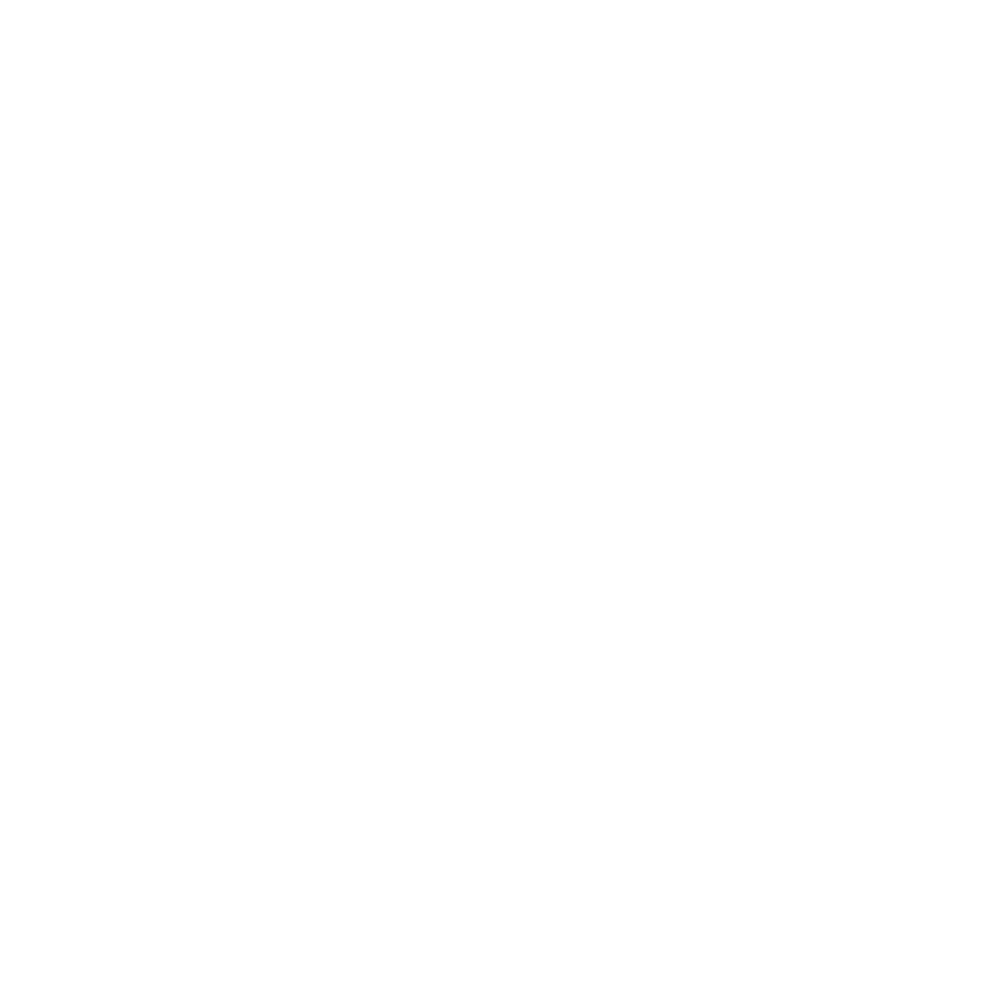

Fitting H6_647 on fov: Conv_zscan_15.tif


<IPython.core.display.Javascript object>


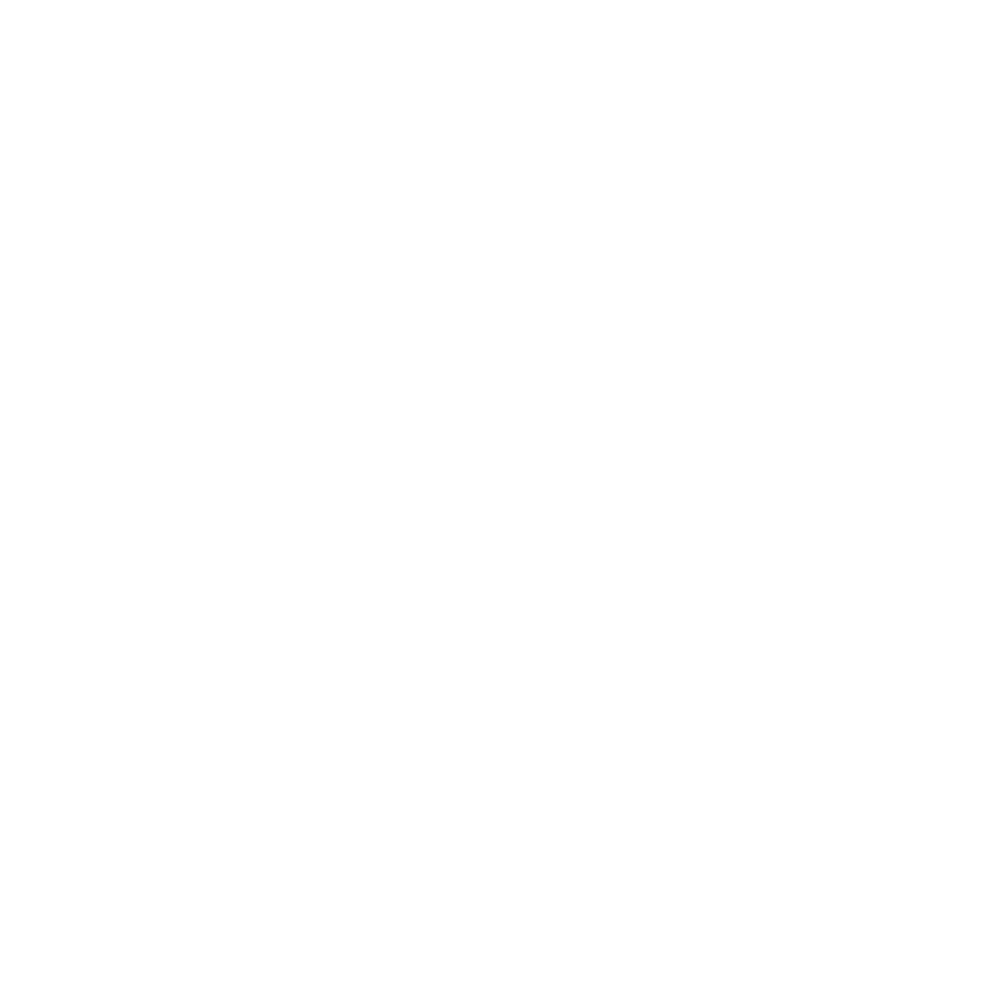

Estimating number of cells based on dapi image on fov: Conv_zscan_15.tif


<IPython.core.display.Javascript object>


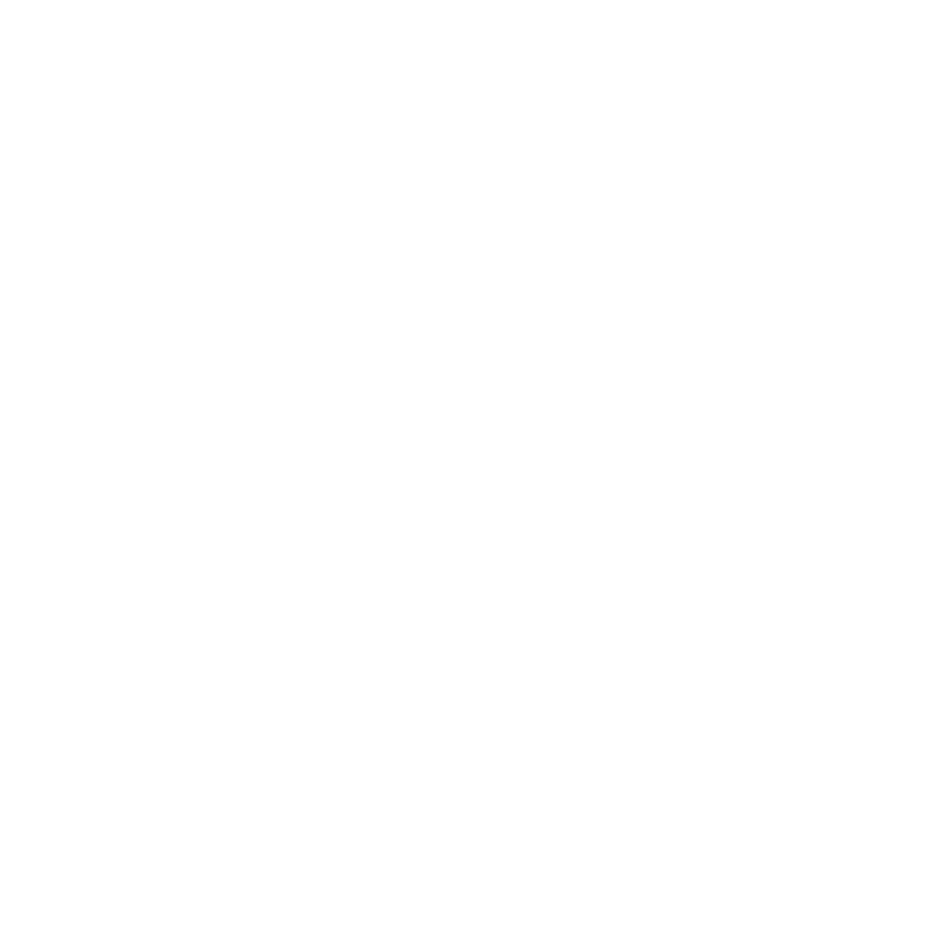

<ipython-input-27-1886a2f7fea2>:20: TqdmDeprecationWarning: This function will be removed in tqdm==5.0.0
Please use `tqdm.notebook.tqdm` instead of `tqdm.tqdm_notebook`
  for fld in tqdm(folders):



Drift correcting H1 on fov: Conv_zscan_16.tif
Fitting H1_750 on fov: Conv_zscan_16.tif


<IPython.core.display.Javascript object>


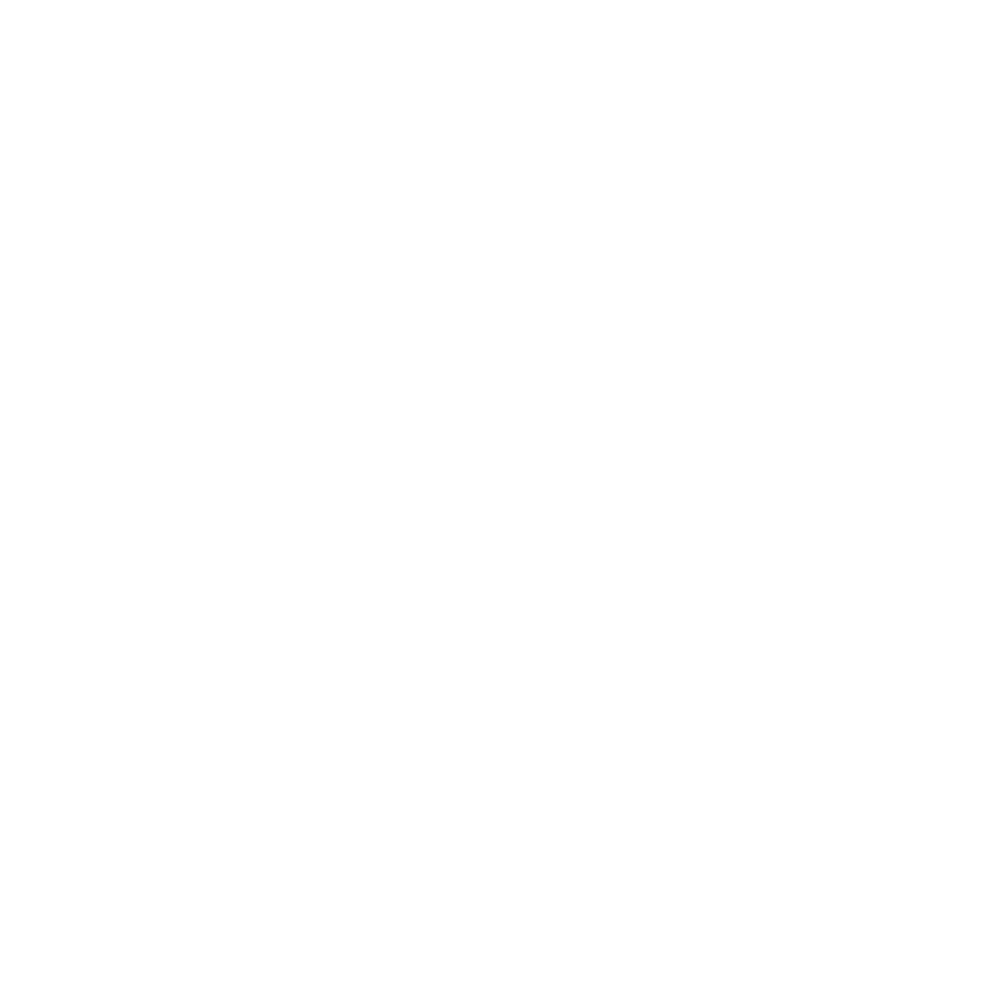

Fitting H1_647 on fov: Conv_zscan_16.tif


<IPython.core.display.Javascript object>


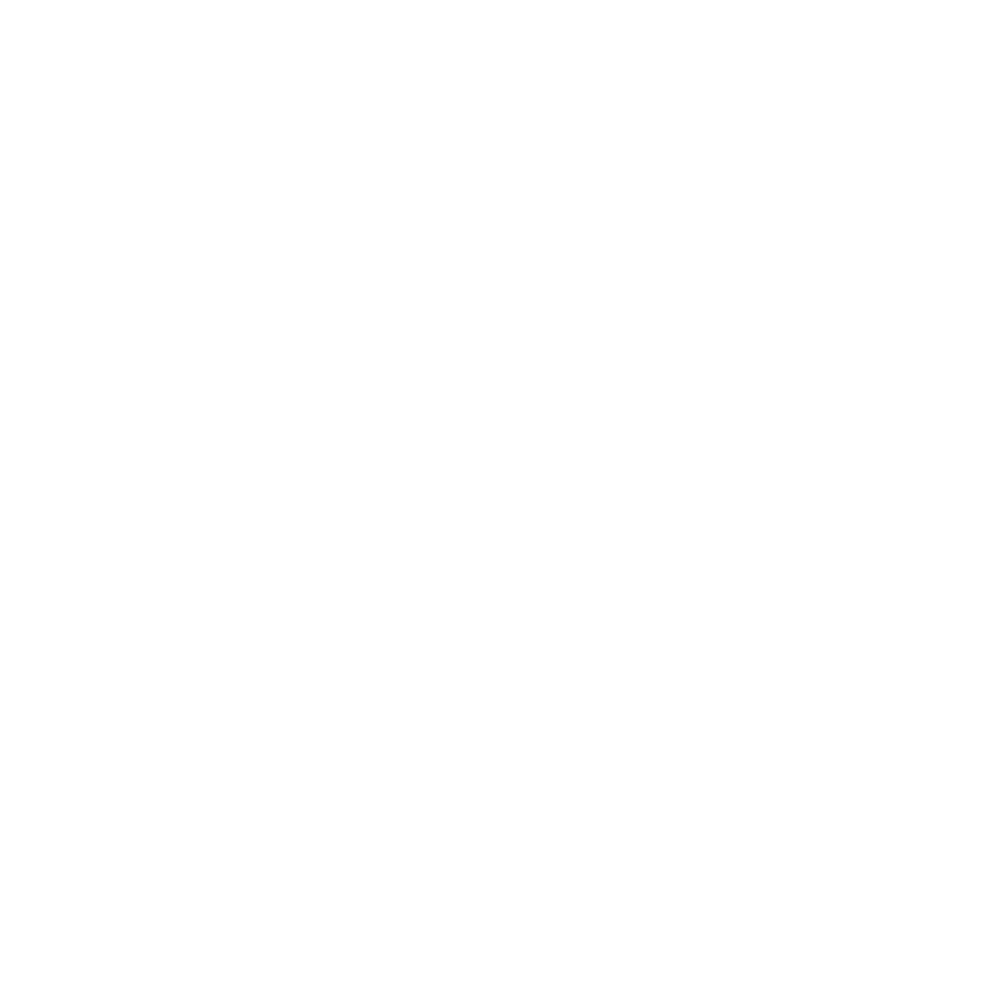

Drift correcting H2 on fov: Conv_zscan_16.tif
Fitting H2_750 on fov: Conv_zscan_16.tif


<IPython.core.display.Javascript object>


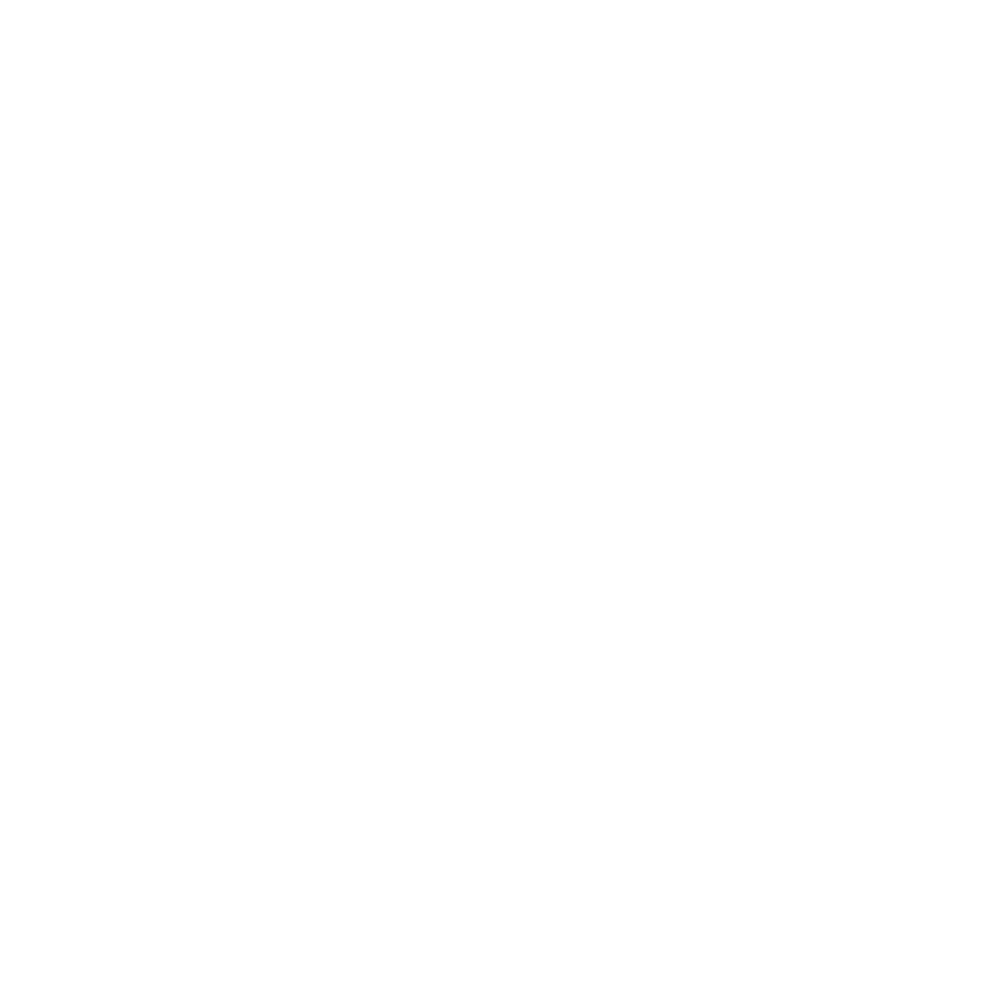

Fitting H2_647 on fov: Conv_zscan_16.tif


<IPython.core.display.Javascript object>


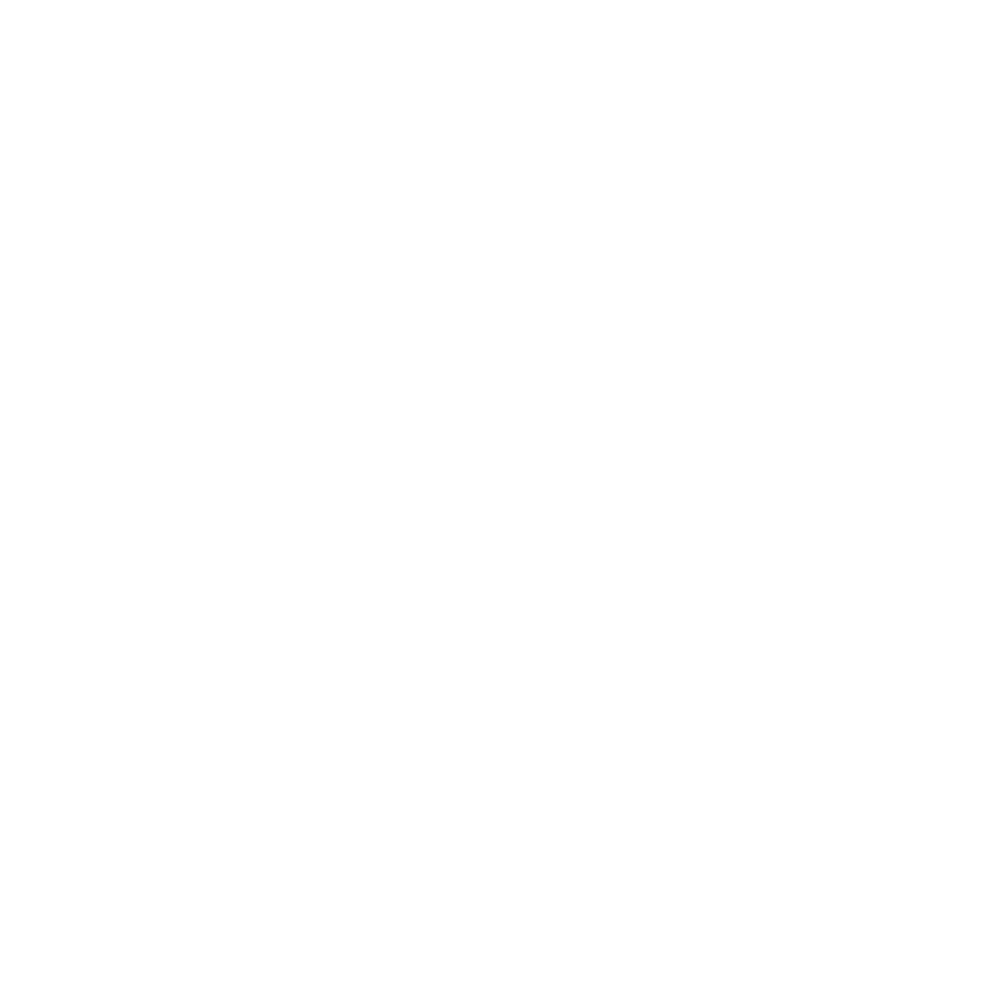

Drift correcting H3 on fov: Conv_zscan_16.tif
Fitting H3_750 on fov: Conv_zscan_16.tif


<IPython.core.display.Javascript object>


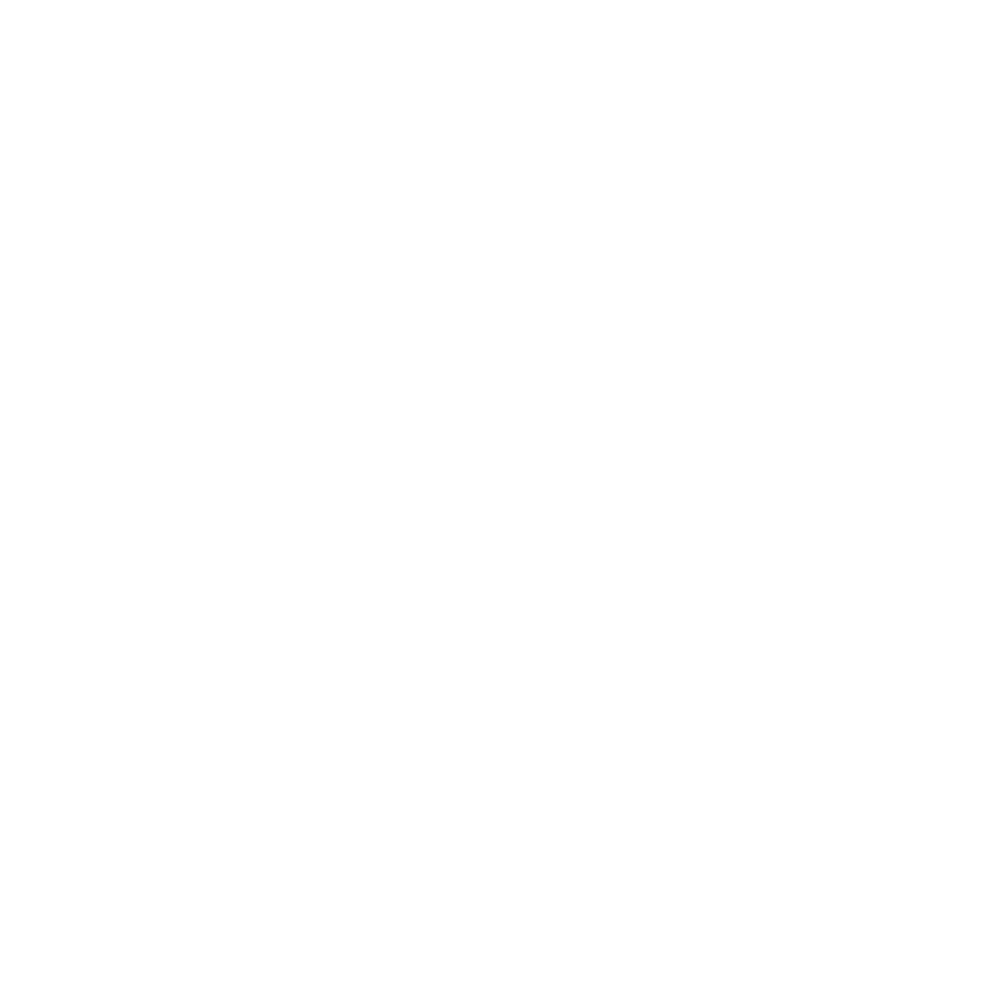

Fitting H3_647 on fov: Conv_zscan_16.tif


<IPython.core.display.Javascript object>


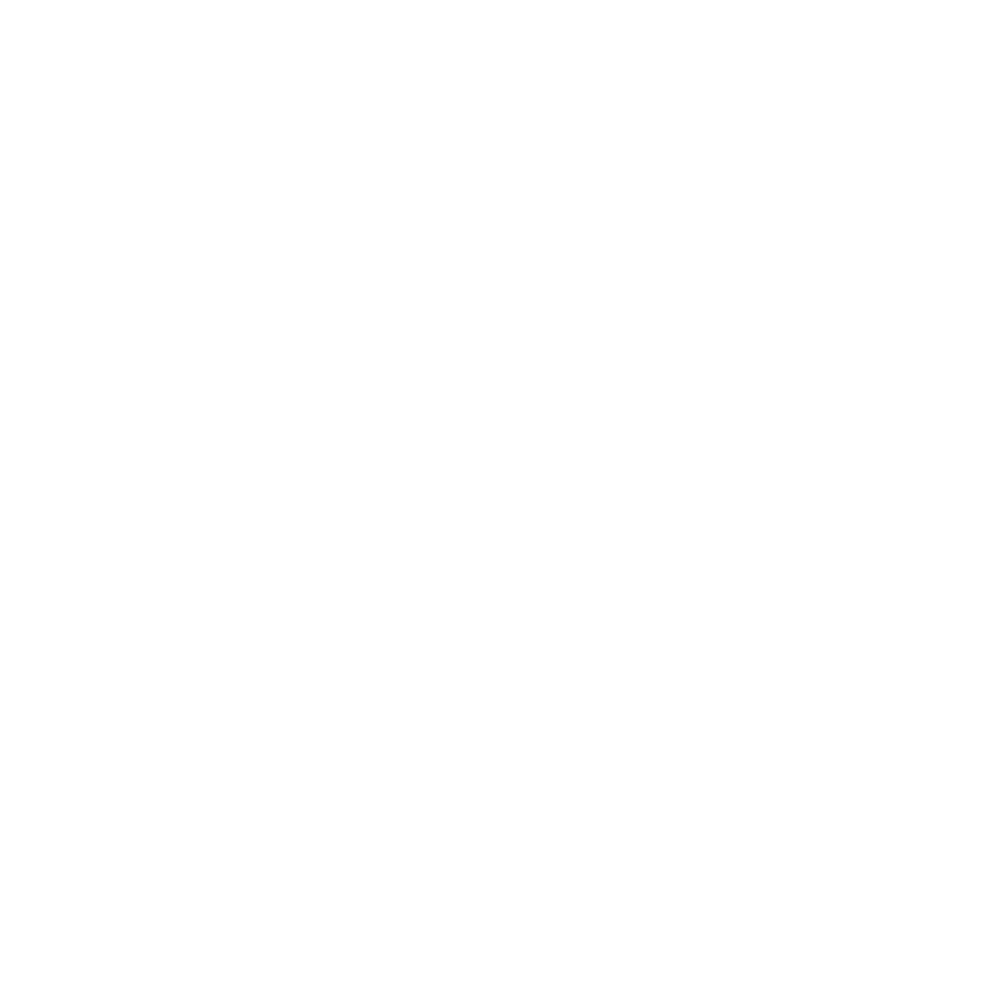

Drift correcting H4 on fov: Conv_zscan_16.tif
Fitting H4_750 on fov: Conv_zscan_16.tif


<IPython.core.display.Javascript object>


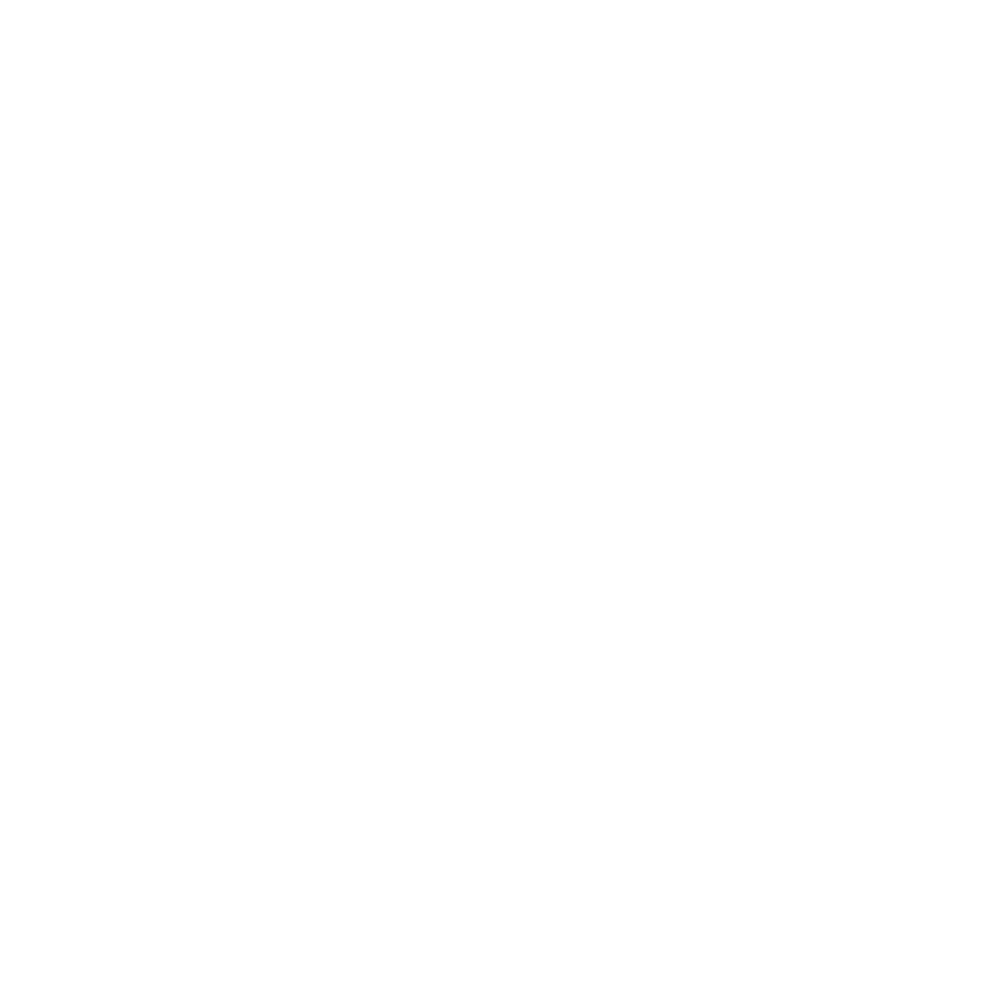

Fitting H4_647 on fov: Conv_zscan_16.tif


<IPython.core.display.Javascript object>


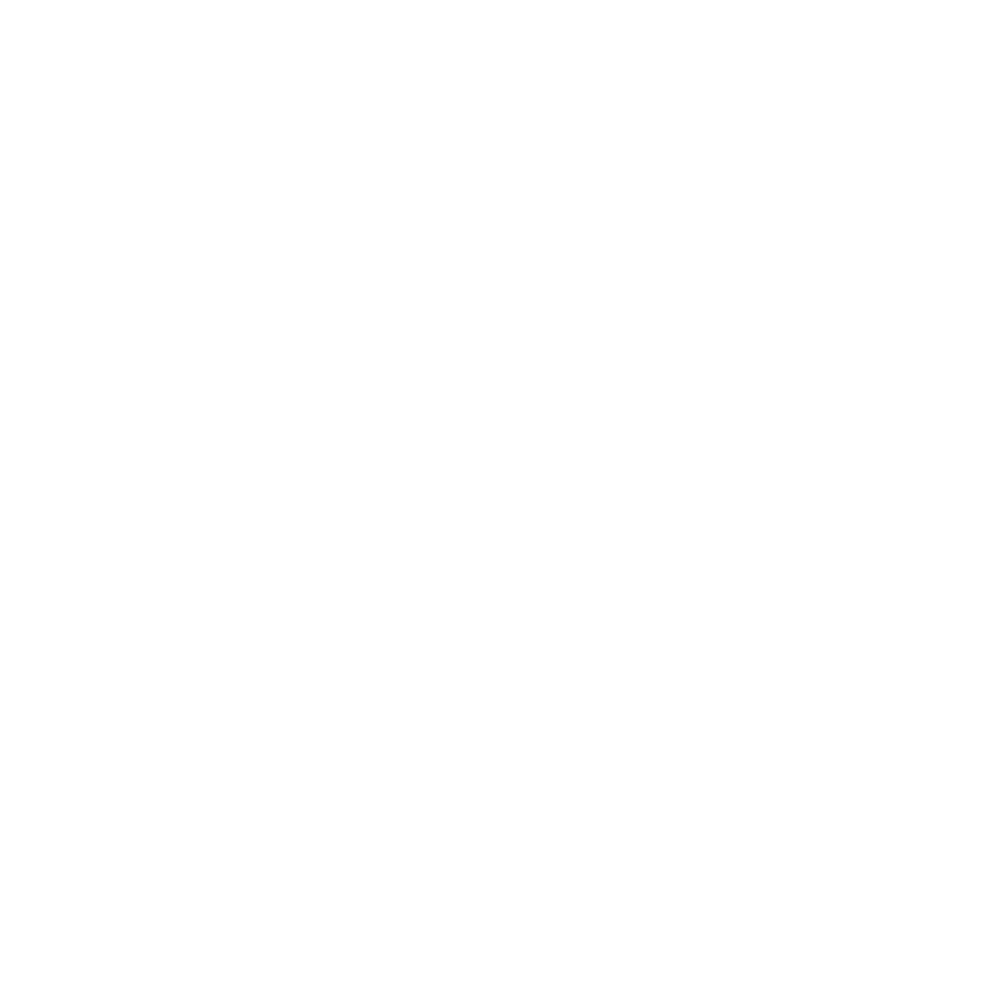

Drift correcting H5 on fov: Conv_zscan_16.tif
Fitting H5_750 on fov: Conv_zscan_16.tif


<IPython.core.display.Javascript object>


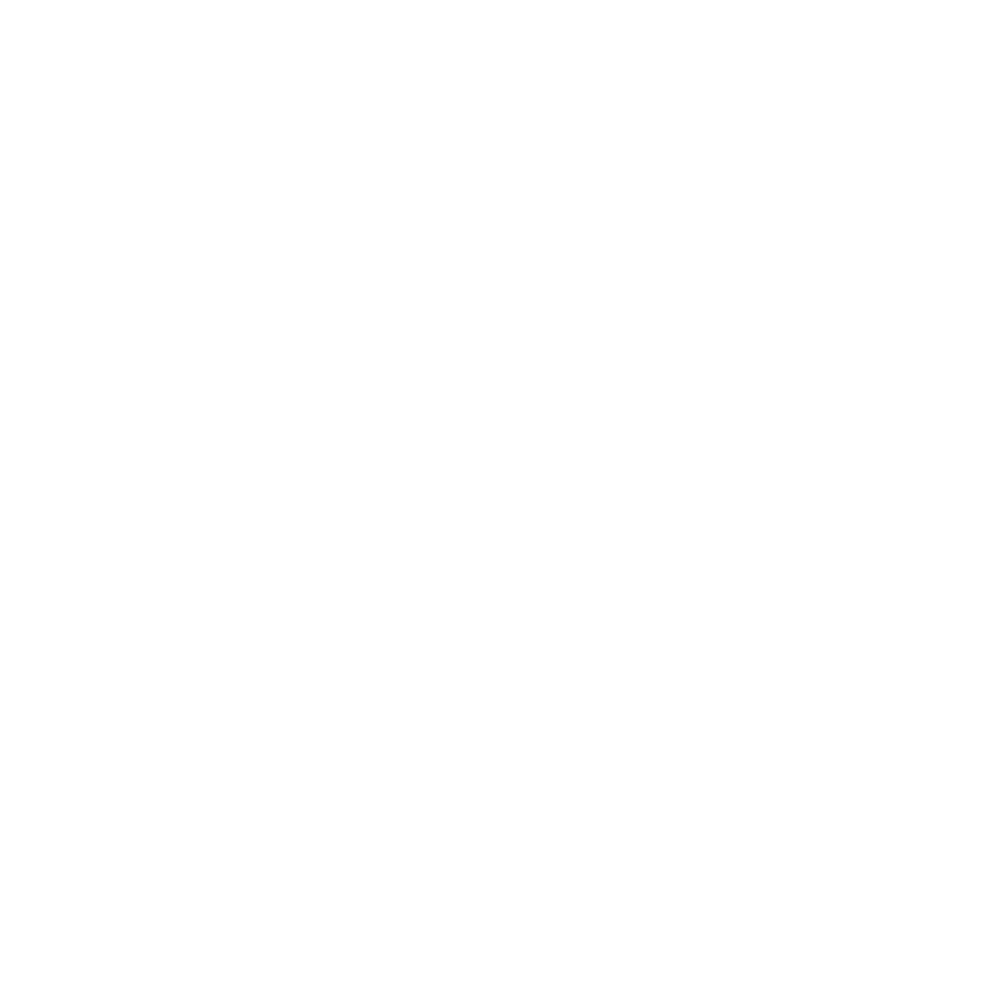

Fitting H5_647 on fov: Conv_zscan_16.tif


<IPython.core.display.Javascript object>


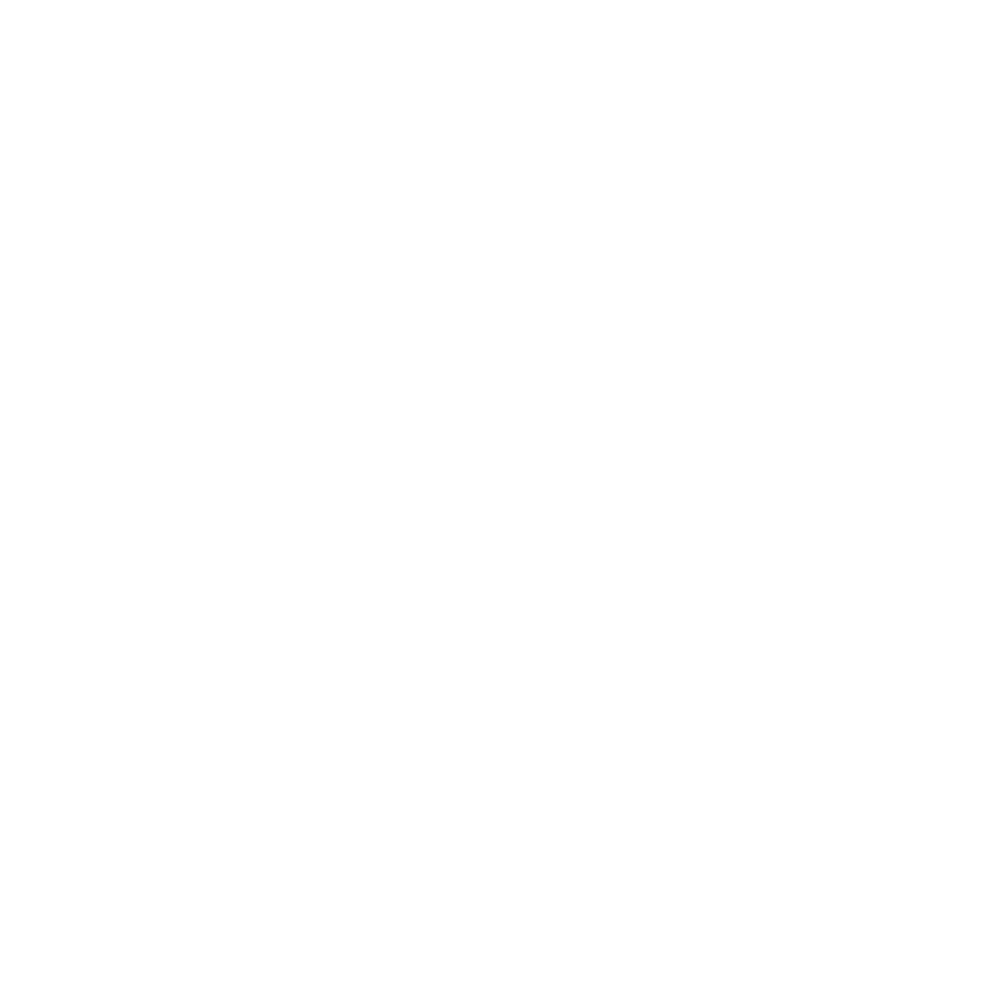

Drift correcting H6 on fov: Conv_zscan_16.tif
Fitting H6_750 on fov: Conv_zscan_16.tif


<IPython.core.display.Javascript object>


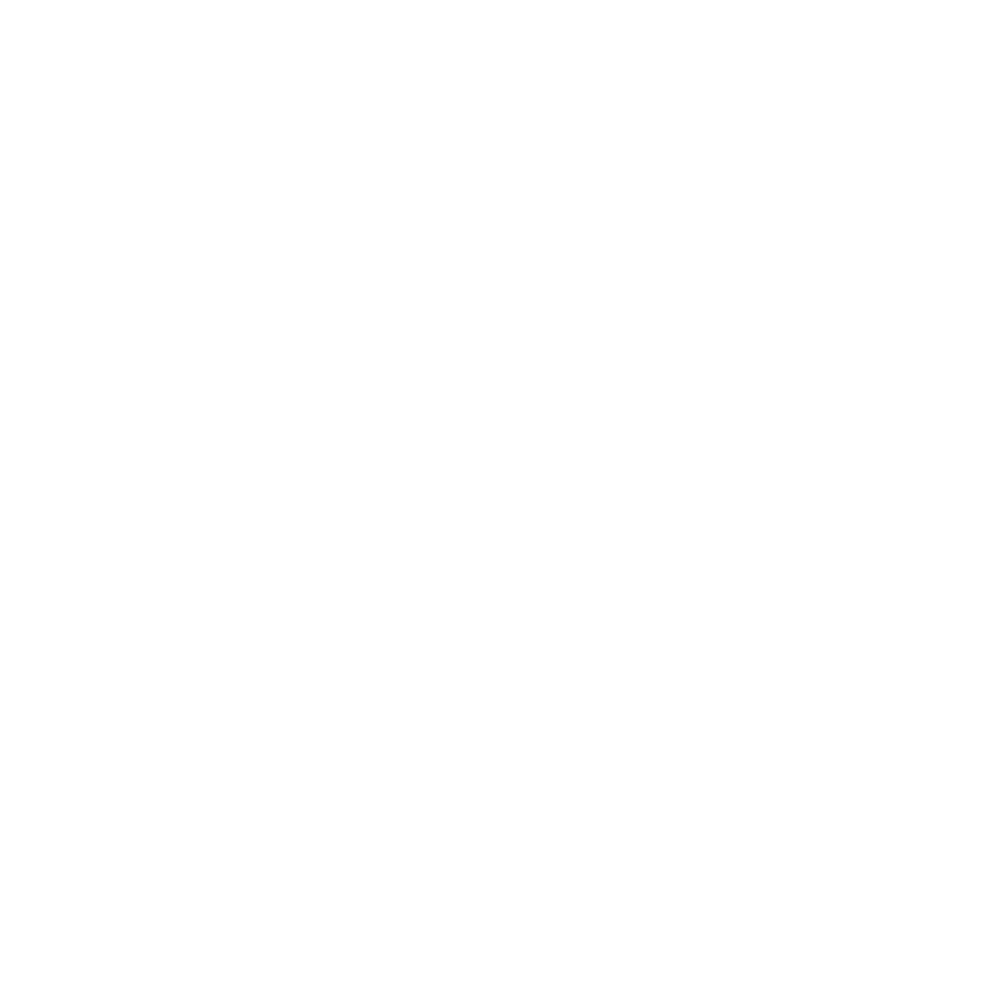

Fitting H6_647 on fov: Conv_zscan_16.tif


<IPython.core.display.Javascript object>


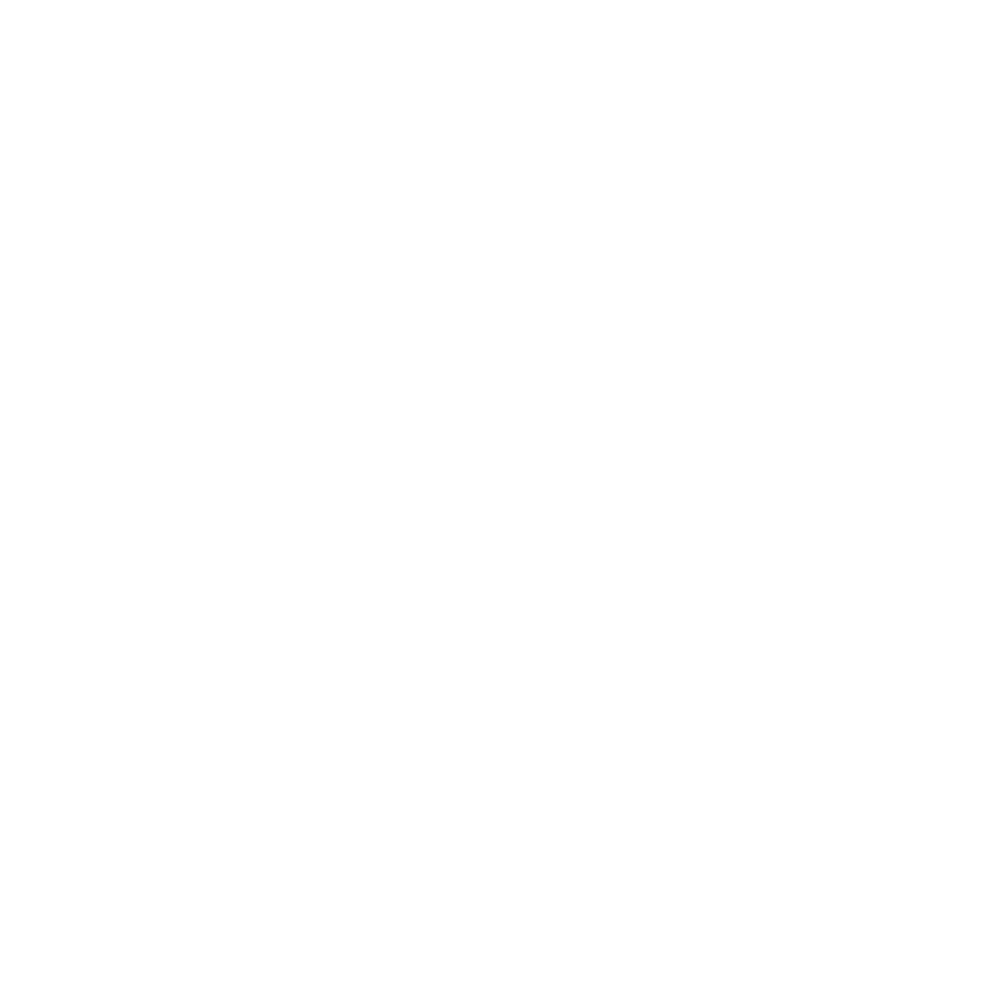

Estimating number of cells based on dapi image on fov: Conv_zscan_16.tif


<IPython.core.display.Javascript object>


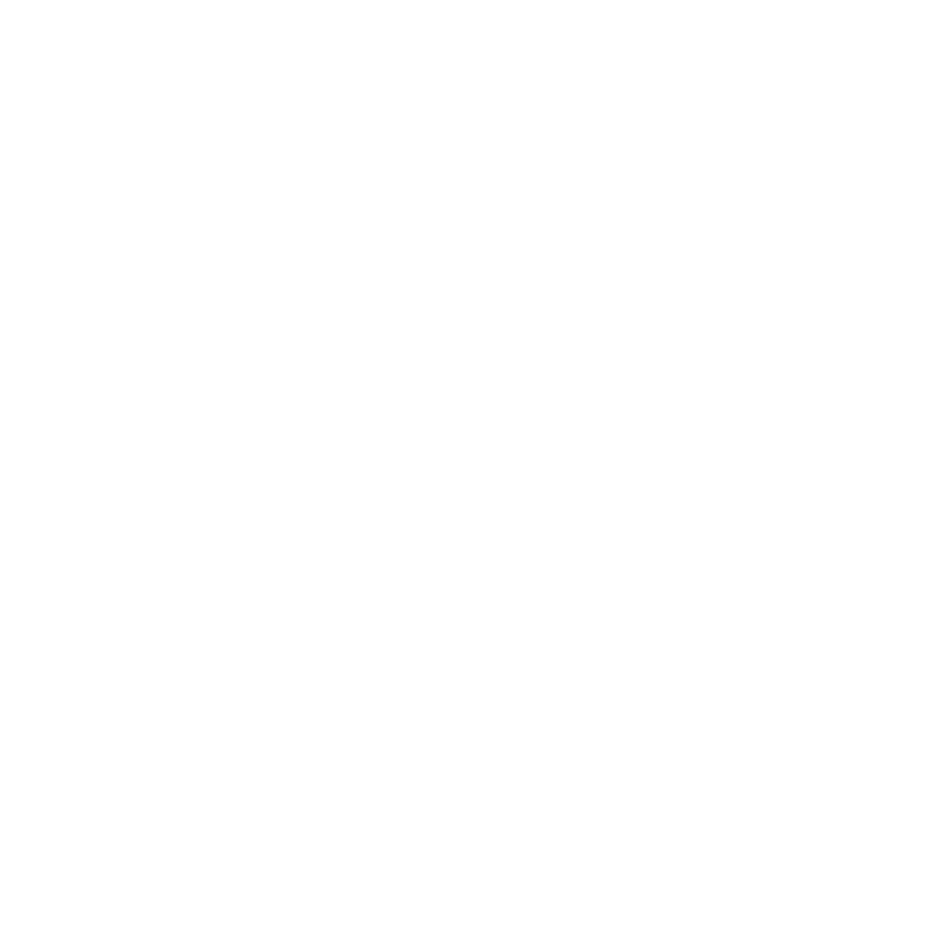

<ipython-input-27-1886a2f7fea2>:20: TqdmDeprecationWarning: This function will be removed in tqdm==5.0.0
Please use `tqdm.notebook.tqdm` instead of `tqdm.tqdm_notebook`
  for fld in tqdm(folders):



Drift correcting H1 on fov: Conv_zscan_17.tif
Fitting H1_750 on fov: Conv_zscan_17.tif


<IPython.core.display.Javascript object>


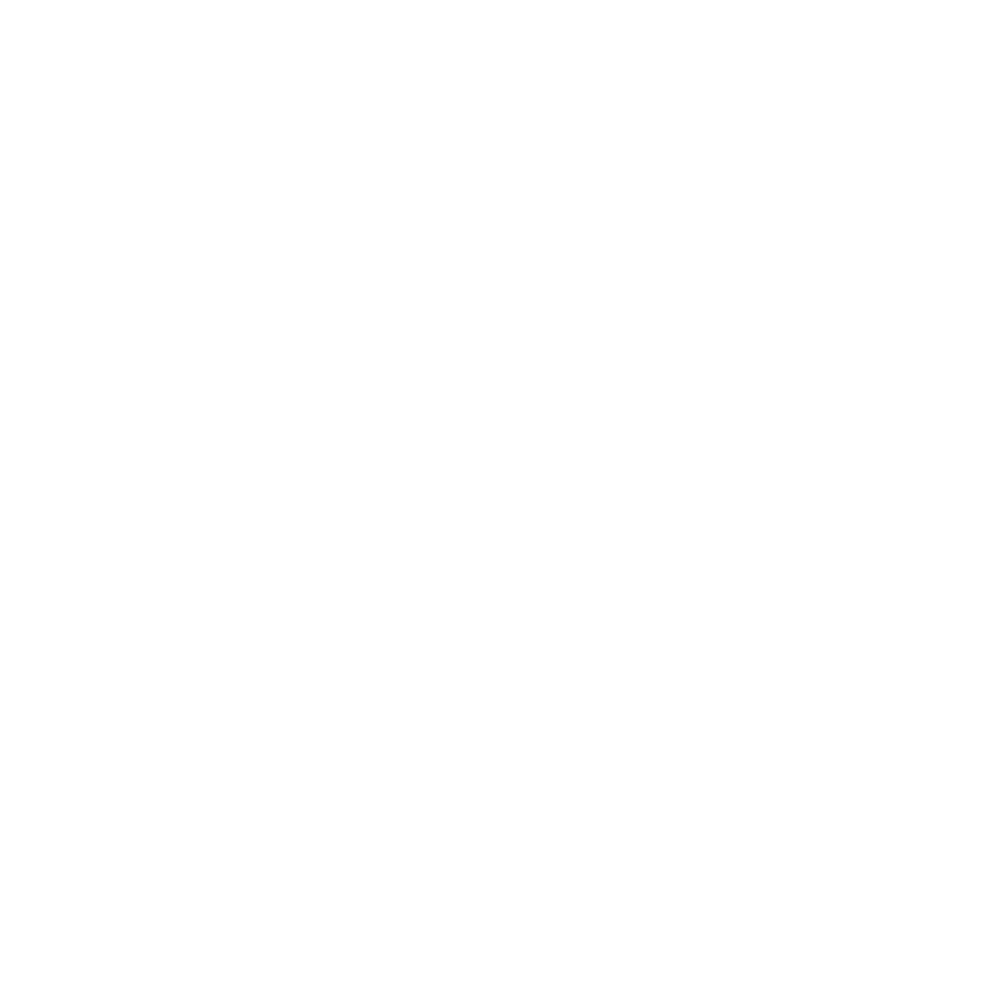

Fitting H1_647 on fov: Conv_zscan_17.tif


<IPython.core.display.Javascript object>


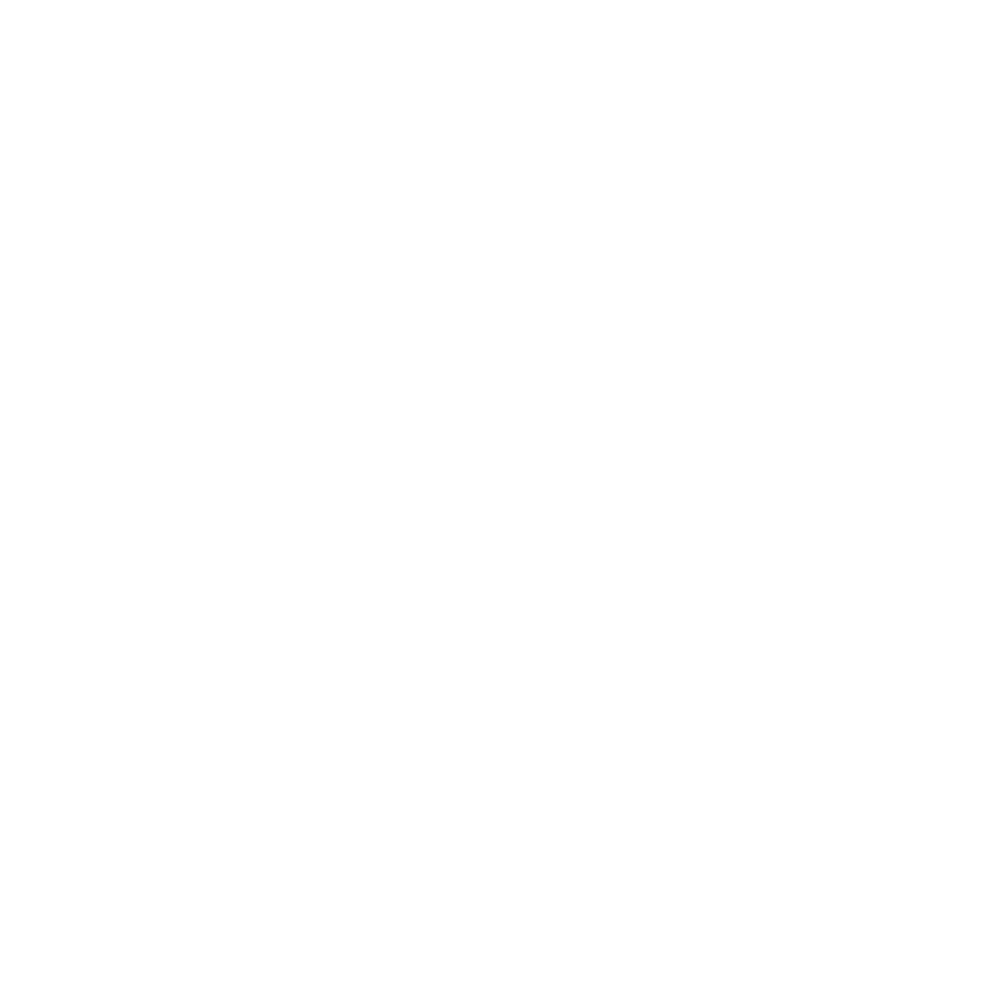

Drift correcting H2 on fov: Conv_zscan_17.tif
Fitting H2_750 on fov: Conv_zscan_17.tif


<IPython.core.display.Javascript object>


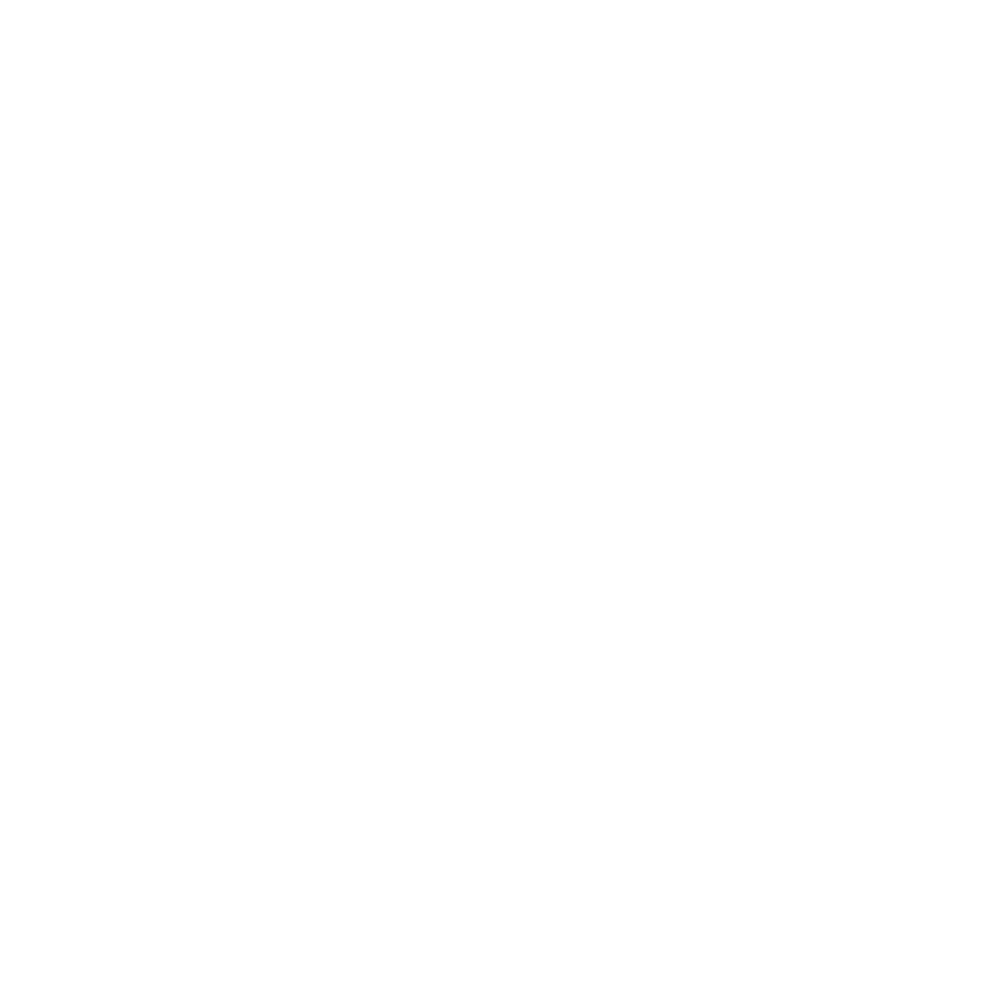

Fitting H2_647 on fov: Conv_zscan_17.tif


<IPython.core.display.Javascript object>


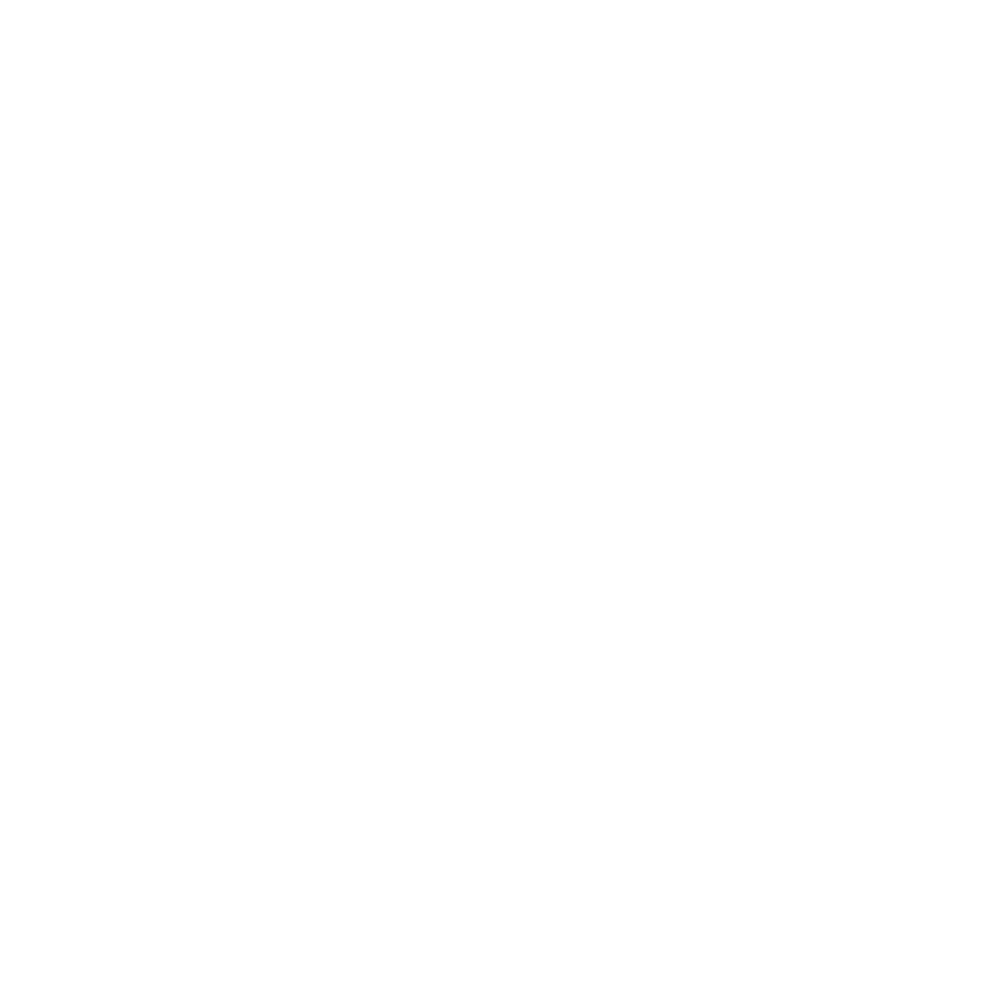

Drift correcting H3 on fov: Conv_zscan_17.tif
Fitting H3_750 on fov: Conv_zscan_17.tif


<IPython.core.display.Javascript object>


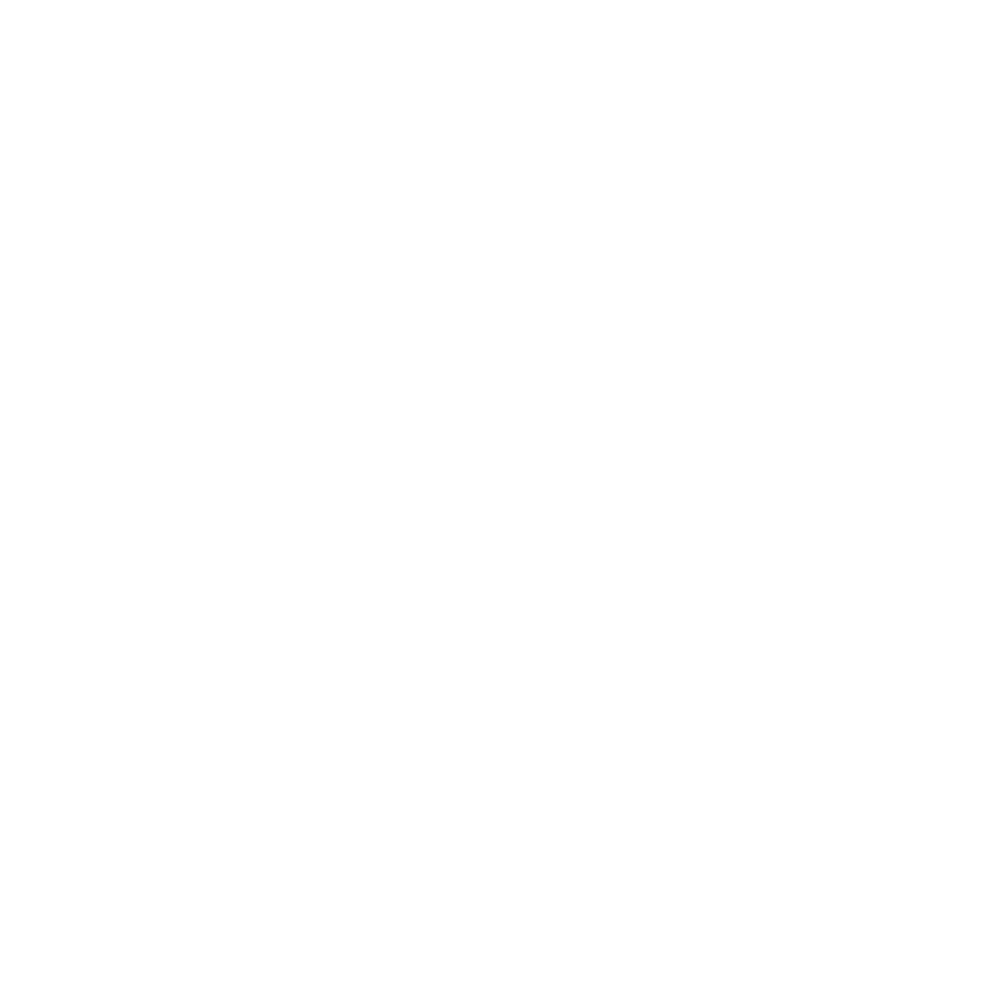

Fitting H3_647 on fov: Conv_zscan_17.tif


<IPython.core.display.Javascript object>


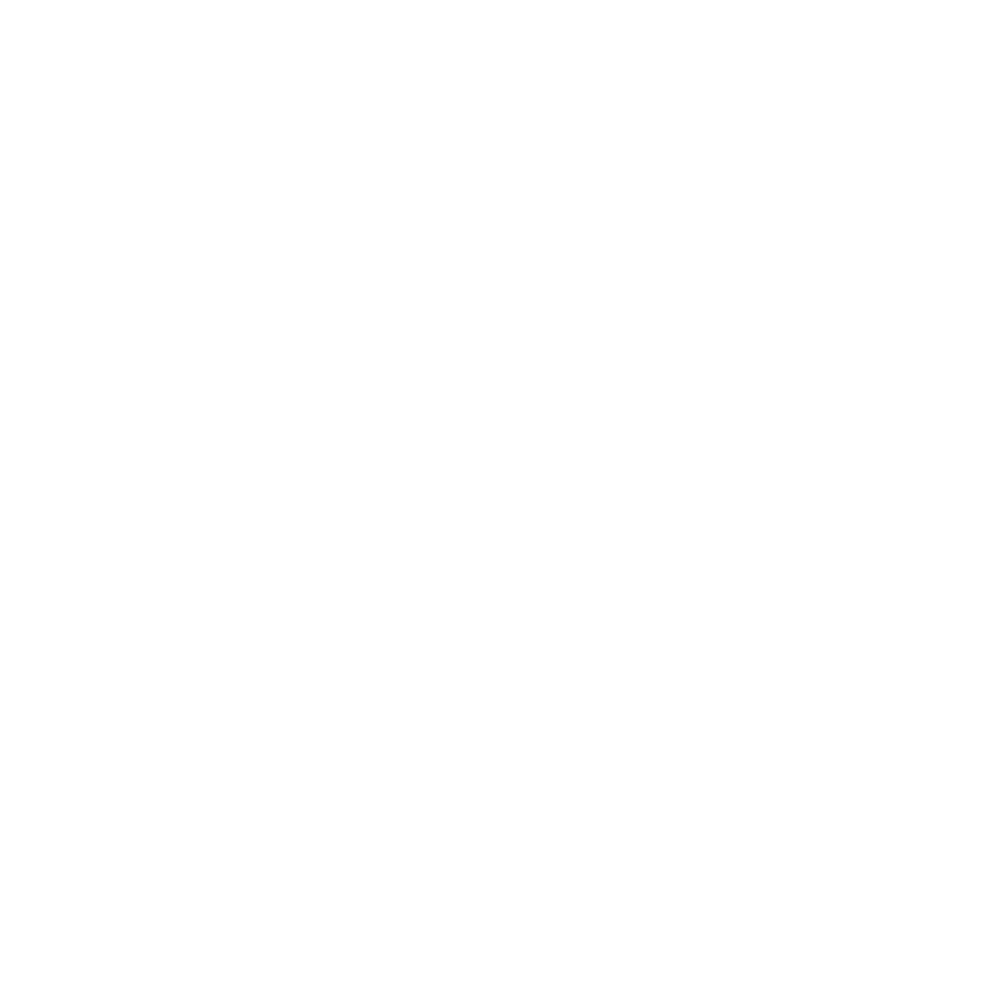

Drift correcting H4 on fov: Conv_zscan_17.tif
Fitting H4_750 on fov: Conv_zscan_17.tif


<IPython.core.display.Javascript object>


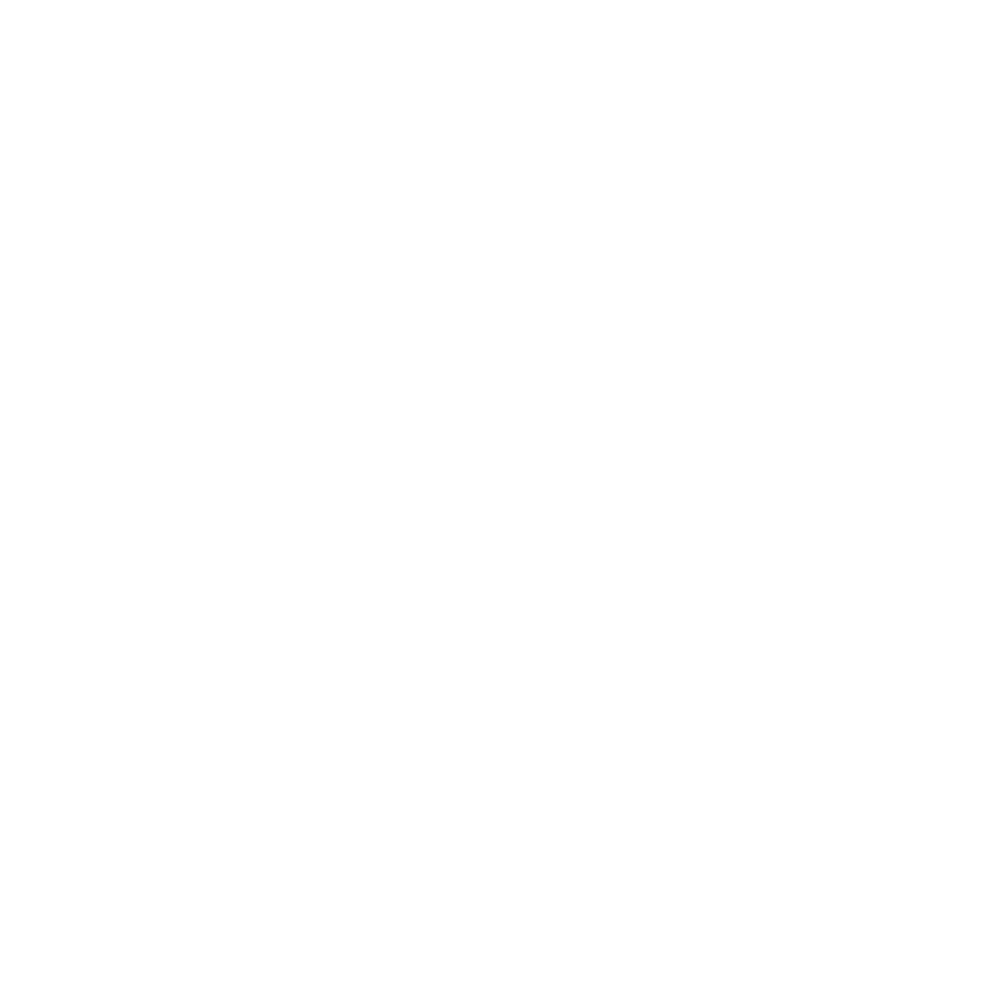

Fitting H4_647 on fov: Conv_zscan_17.tif


<IPython.core.display.Javascript object>


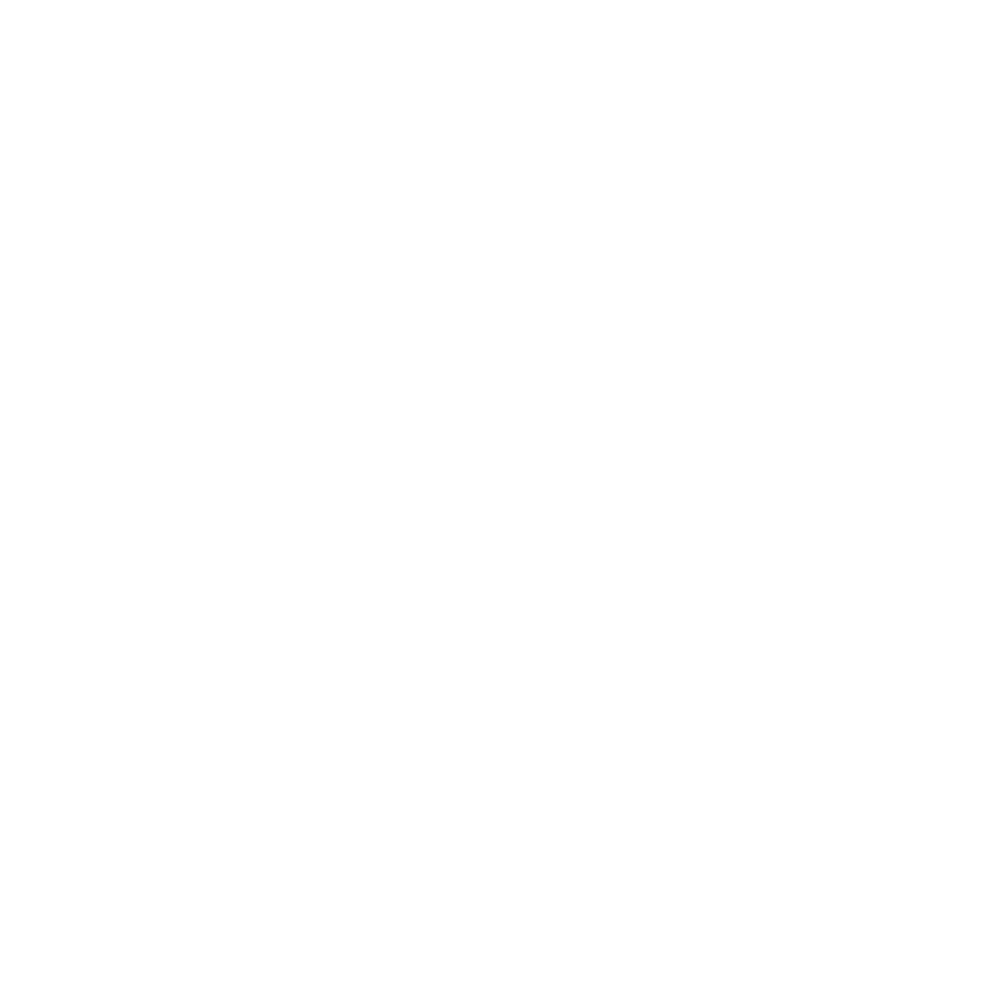

Drift correcting H5 on fov: Conv_zscan_17.tif
Fitting H5_750 on fov: Conv_zscan_17.tif


<IPython.core.display.Javascript object>


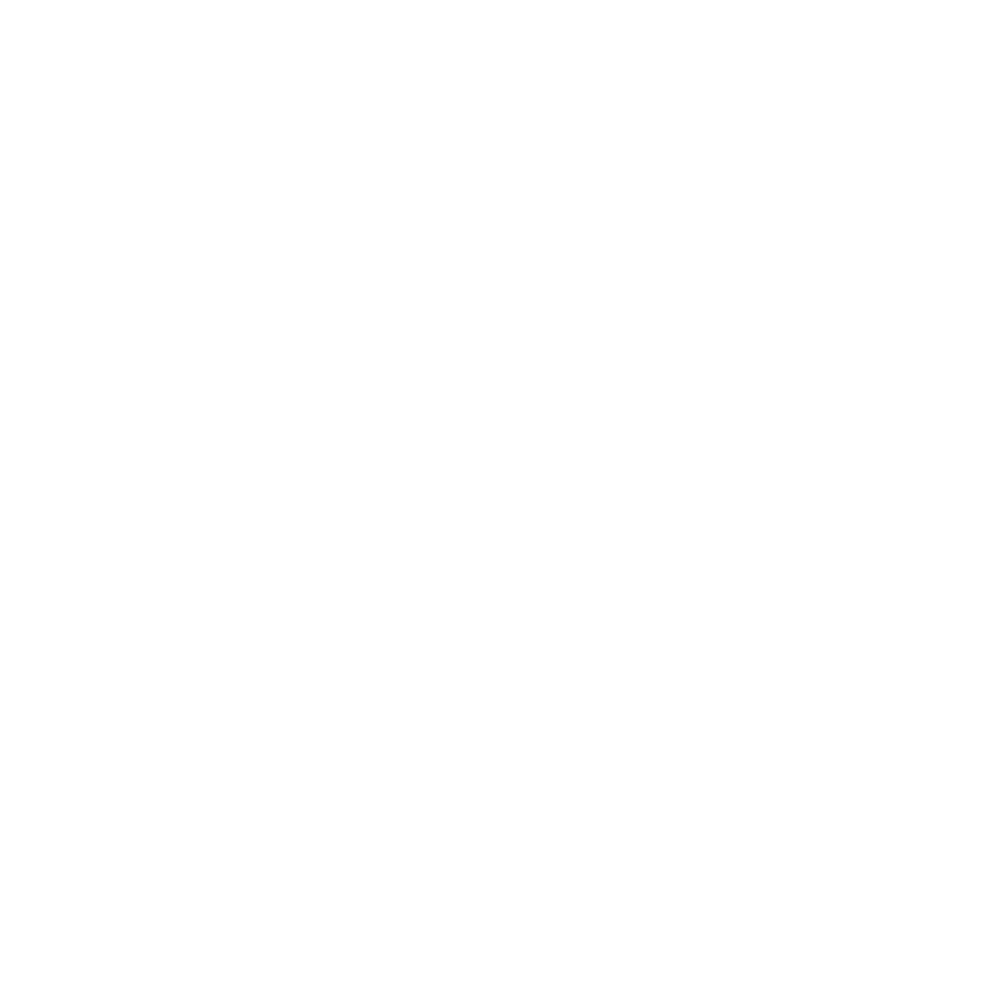

Fitting H5_647 on fov: Conv_zscan_17.tif


<IPython.core.display.Javascript object>


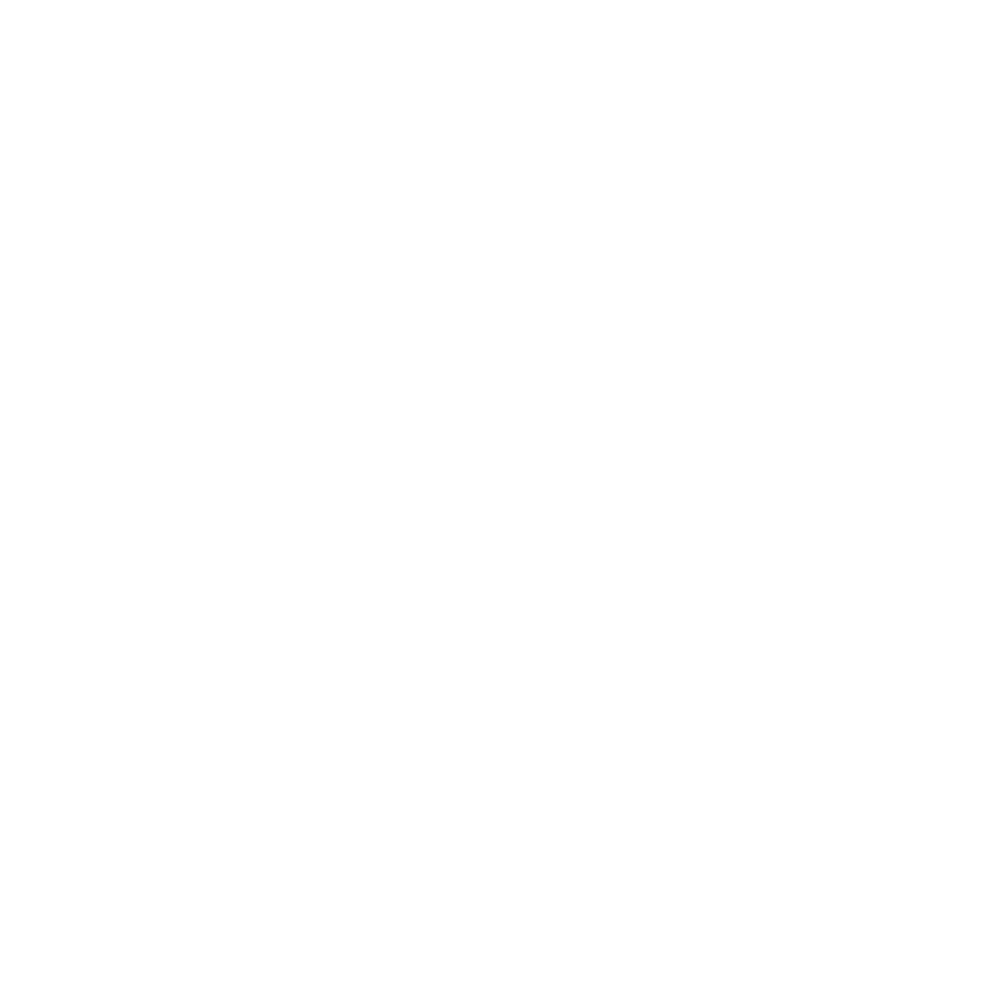

Drift correcting H6 on fov: Conv_zscan_17.tif
Fitting H6_750 on fov: Conv_zscan_17.tif


<IPython.core.display.Javascript object>


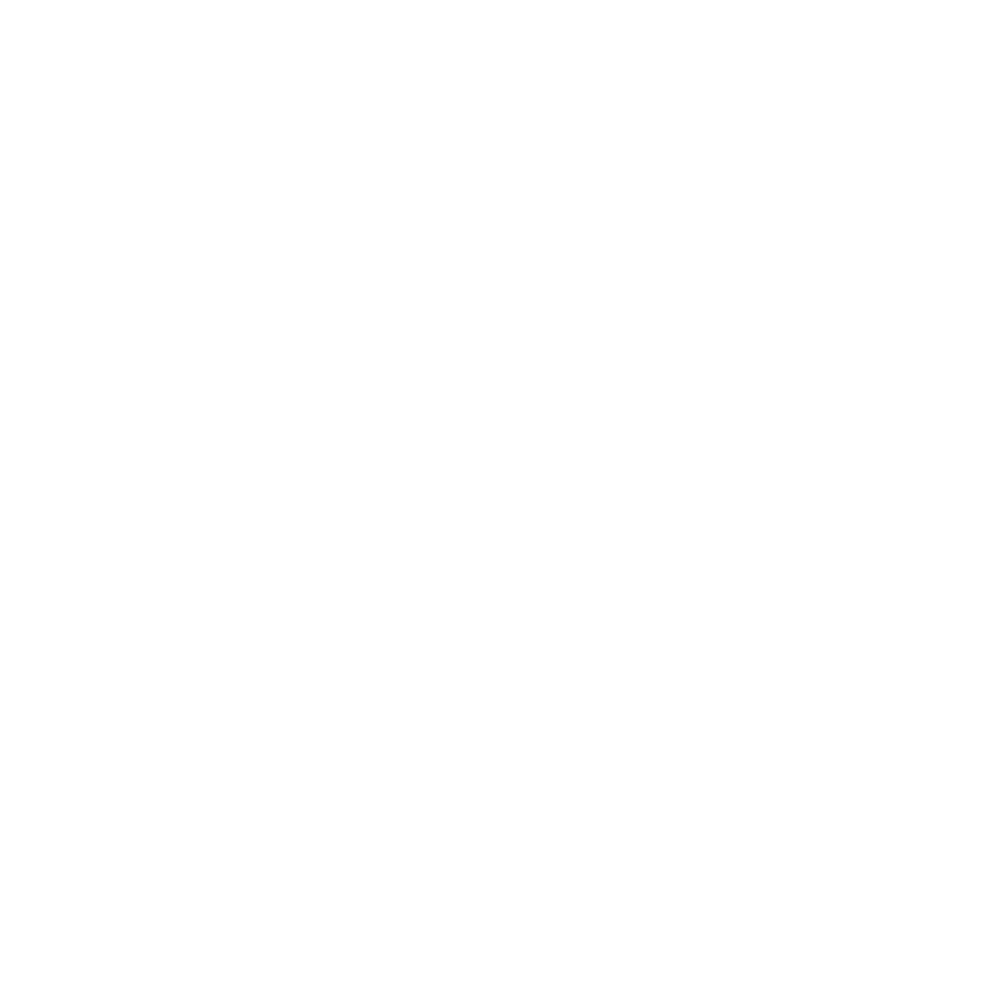

Fitting H6_647 on fov: Conv_zscan_17.tif


<IPython.core.display.Javascript object>


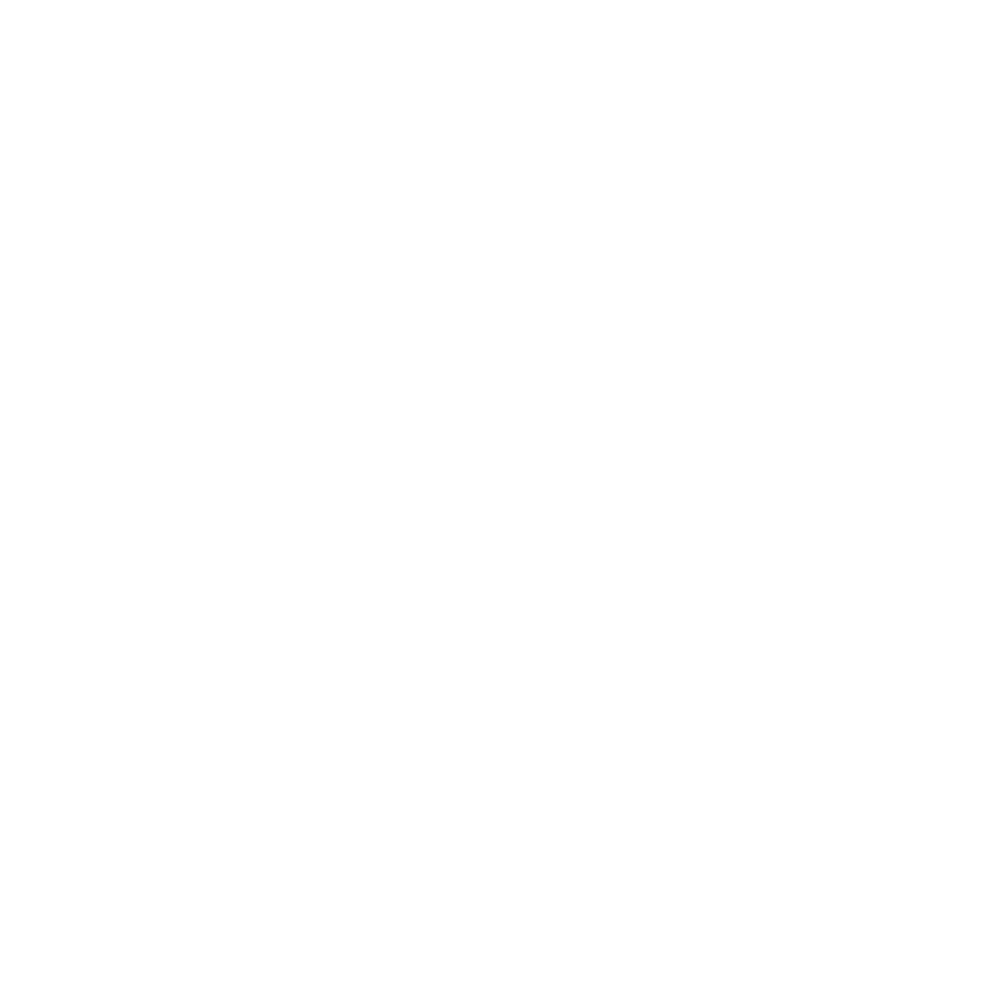

Estimating number of cells based on dapi image on fov: Conv_zscan_17.tif


<IPython.core.display.Javascript object>


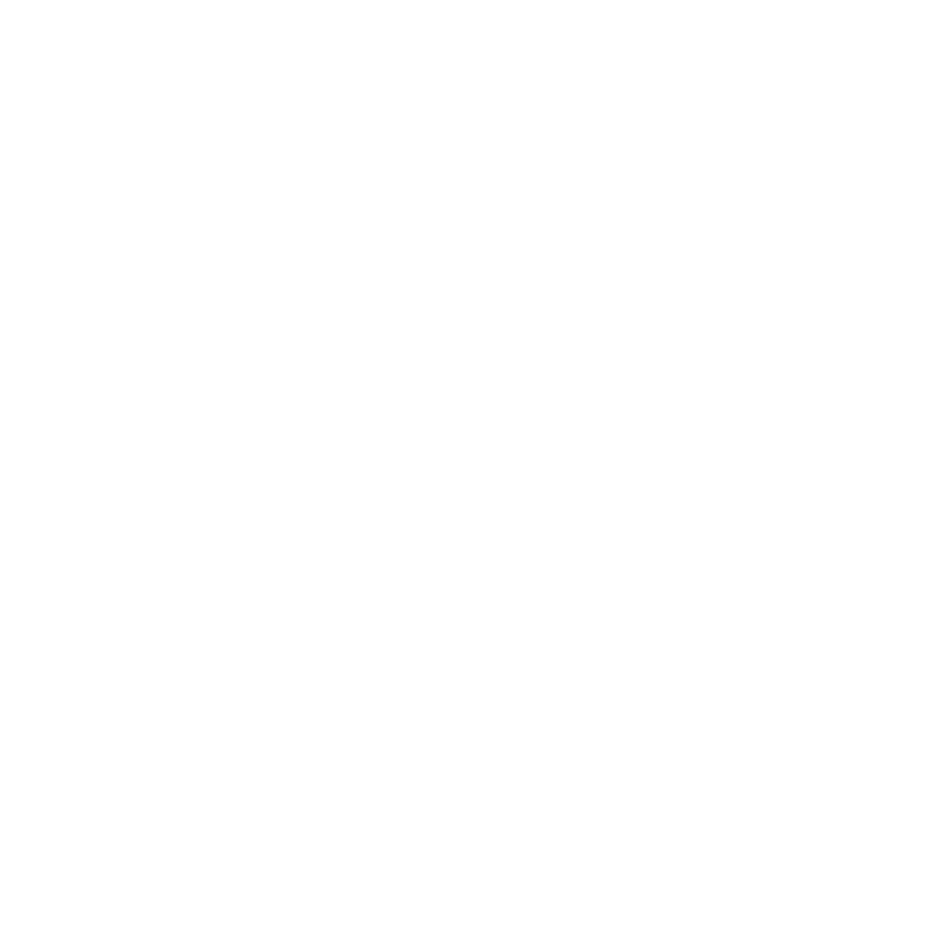

In [27]:
#Iterate trhough fovs - fit and drift correct

folder = r'D:\Data\112520_wea_rca_test4_peg'
analysis_folder = folder+os.sep+'Analysis'
if not os.path.exists(analysis_folder): os.makedirs(analysis_folder)    

ims_meds = np.load(analysis_folder+os.sep+'im_meds.npy')
ims_meds[-1] = np.ones(ims_meds[-1].shape)*np.median(ims_meds[-1])#dapi is not good given current statistics.

folders = glob.glob(folder+'\H*')
folders = [fld for fld in folders if len(glob.glob(fld+r'\*.tif'))]
fovs = [os.path.basename(fl) for fl in glob.glob(folders[0]+r'\*.tif')]
cols = ['750','647','561','405']
ncols = len(cols)

#Iterate across FOVs
for fov in fovs:#[fovs[2]]:
    #Load images into dictionary im_dic
    ims,ims_nms = [],[]
    for fld in tqdm(folders):
        fl = fld+os.sep+fov
        im = tifffile.imread(fl)
        
        for icol,col in enumerate(cols):
            ims.append(im[icol::ncols]/ims_meds[icol])
            tag = os.path.basename(os.path.dirname(fl))+'_'+col
            ims_nms.append(tag)

    im_dic = {nm:im for im,nm in zip(ims,ims_nms)}

    #Fit and drift correct
    
    names = list(im_dic.keys())
    H_nocol = np.unique(['_'.join(e.split('_')[:-1]) for e in names])
    cols_bits = ['750','647']
    col_bead = '561'
    dic_drift = {}
    dic_fits = {}
    dic_extra = {}
    #Load fitted data:
    save_base = analysis_folder+os.sep+fov.split('.')[0]
    save_fl = save_base+'_final.pkl'
    if os.path.exists(save_fl):
        dic_drift,dic_fits,dic_extra = pickle.load(open(save_fl,'rb'))
    

    
    for H in H_nocol:
        #perfor drift correction
        if H not in dic_drift:
            print("Drift correcting "+H+" on fov: "+fov)
            im1 = im_dic[H_nocol[0]+'_'+col_bead] # reference dapi image
            im2 = im_dic[H+'_'+col_bead] #current dapi image
            dic_drift[H]=series_align(im1,im2,s = 256,gb=30) #drift positions using fft
            
        #perform fitting
        for col in cols_bits:
            key = H+'_'+col
            
            if key not in dic_fits:
                print("Fitting "+H+'_'+col+" on fov: "+fov)
                im = im_dic[H+'_'+col] #current image
                im = quick_norm(im ,s=20)
                hcut = 1.75
                Xh = get_local_max(im,hcut,delta=2)
                dic_fits[H+'_'+col] = Xh
                hmax = np.percentile(Xh[:,-1],33)

                #save diagnostic plots - image with fits on top
                fig = plt.figure(figsize=(20,20))
                plt.imshow(np.max(im,0),cmap='gray',vmax = hmax)
                plt.plot(Xh[:,2],Xh[:,1],'o',markersize=12,markeredgewidth=1,markeredgecolor='y',markerfacecolor='None')
                save_fig_ = save_base+'_'+H+'_'+col+'_fit.png'
                fig.savefig(save_fig_)
                plt.close('all')
    #get number of cells
    if not dic_extra:
        print("Estimating number of cells based on dapi image on fov: "+fov)
        H=H_nocol[0]
        im2 = im_dic['H1_405']
        im2_ = at.blurnorm2d(np.max(im2,0),300)
        im_dapi = im2_>1.25
        ncells,med_area = get_number_cells(im_dapi,min_area=5000,max_area=50000)
        dic_extra={'no_cells':ncells,'area_per_cell':med_area}

        save_fig_ = save_base+'_'+H+'_'+col+'_dapi.png'
        fig = plt.figure(figsize=(10,10))
        plt.imshow(np.max(im2,0),cmap='gray')
        plt.contour(im_dapi,[0.5],colors=['r'])
        fig.savefig(save_fig_)
        plt.close('all')

    pickle.dump([dic_drift,dic_fits,dic_extra],open(save_fl,'wb'))

In [30]:
print(analysis_folder)

D:\Data\112520_wea_rca_test4_peg\Analysis


### Post-analysis

In [34]:
# import 
import sys,os,glob
sys.path.append(os.path.abspath('CommonTools'))
import tifffile
import numpy as np
import matplotlib.pylab as plt
from tqdm import tqdm_notebook as tqdm
import MaxViewer_py3 as mv
import pickle


from scipy.spatial import cKDTree as KDTree
from scipy.spatial.distance import cdist
import FittingTools_py3 as ft
def get_inters(X1,X2,dkeep=3):
    t1 =KDTree(X1)
    t2 =KDTree(X2)
    r1 = t1.query_ball_tree(t2, dkeep)
    r2 = t1.sparse_distance_matrix(t2, dkeep)
    i1_,i2_ = np.array([(ir,rs[np.argmin([r2[ir,r_] for r_ in rs])]) for ir,rs in enumerate(r1) if len(rs)>0]).T
    X1f = X1[i1_]
    X2f = X2[i2_]
    return X1f,X2f,i1_,i2_
def get_intersection_nochromatic(dic_fits,dic_drift,A,B,hre =0,dkeep=5):
    """
    get the intersection of two hybes ignoring chromatic abberation.
    This is primarily used for calculating the chromatic abberation.
    """
    z1,x1,y1,h1 =dic_fits[A].T
    z2,x2,y2,h2 =dic_fits[B].T
    X1 = np.array([z1,x1,y1]).T+dic_drift[A[:-4]][0]
    X2 = np.array([z2,x2,y2]).T+dic_drift[B[:-4]][0]

    X1f,X2f,i1_,i2_ = get_inters(X1[h1>hre],X2[h2>hre],dkeep=dkeep)
    
    return X1f,X2f#np.median(X1f-X2f,0)
def get_chrM(dic_chr,col):
    """Given a chromatic correction dictionary (see bellow on how to compute this)
    This return the matrix associated with the color indicated
    """
    col_ = col.split('_')[-1]
    keys_chr = list(dic_chr.keys())
    keys_ = [key for key in keys_chr if col_==key.split('-')[-1]]
    if len(keys_)>0:
        return dic_chr[keys_[0]]
    else:
        return None
def get_intersection_final(dic_fits,dic_drift,dic_chr,A,B,hre =2,dkeep=5,dre=3):
    M1 = get_chrM(dic_chr,A)
    M2 = get_chrM(dic_chr,B)
    z1,x1,y1,h1 =dic_fits[A].T
    z2,x2,y2,h2 =dic_fits[B].T
    drift_pix1 = dic_drift[A[:-4]][0]
    drift_pix2 = dic_drift[B[:-4]][0]
    X1 = ft.apply_colorcor(np.array([z1,x1,y1]).T,M1)+drift_pix1
    X2 = ft.apply_colorcor(np.array([z2,x2,y2]).T,M2)+drift_pix2
    #apply subpixel correction - not necessary if using beads.
    X1f,X2f,i1_,i2_ = get_inters(X1[h1>hre],X2[h2>hre],dkeep=dkeep)
    Xdif = np.mean(X1f-X2f,axis=0)
    X2_ = X2+Xdif
    X1f,X2f,i1_,i2_ = get_inters(X1,X2_,dkeep=dre)
    
    return i1_,i2_,X1,X2_,h1,h2

In [35]:
final_fls = glob.glob(r'D:\Data\112520_wea_rca_test4_peg\Analysis\*_final.pkl')


In [36]:
fl = final_fls[2]
dic_drift,dic_fits,dic_extra = pickle.load(open(fl,'rb'))
#pairs = [('H1_647','H3_750'),('H1_750','H4_647'),('H2_647','H6_647'),('H2_750','H5_647'),('H3_647','H6_750')]
hkeys = np.array(list(dic_fits.keys()))


hkeys_order =  hkeys#hkeys[np.argsort(list(map(nm_to_Ri,hkeys)))]
#pairs = [(hkeys_order[i*2],hkeys_order[i*2+1])for i in range(5)]
#pairs
hkeys_order
pairs = [['H1_647', 'H3_750'],
 ['H1_750', 'H4_647'],
 ['H2_647', 'H6_647'],
 ['H2_750', 'H5_647'],
 ['H3_647', 'H6_750']]

A,B = pairs[0]
z1,x1,y1,h1 =dic_fits[A].T
z2,x2,y2,h2 =dic_fits[B].T
X1 = np.array([z1,x1,y1]).T+dic_drift[A[:-4]][0]
X2 = np.array([z2,x2,y2]).T+dic_drift[B[:-4]][0]

### Check intersection in one fov

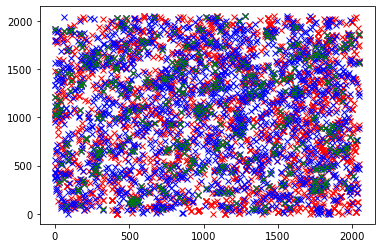

In [37]:
A,B = pairs[1]
z1,x1,y1,h1 =dic_fits[A].T
z2,x2,y2,h2 =dic_fits[B].T
X1 = np.array([z1,x1,y1]).T+dic_drift[A[:-4]][0]
X2 = np.array([z2,x2,y2]).T+dic_drift[B[:-4]][0]
#X1f,X2f,i1_,i2_ = get_inters(X1[h1>hre],X2[h2>hre],dkeep=3)
dic_chr={}
i1_,i2_,X1,X2_,h1,h2 = get_intersection_final(dic_fits,dic_drift,dic_chr,A,B,hre =2.,dkeep=5,dre=3)
plt.figure()
hre=2
keep1 = h1>hre
keep2 = h2>hre
plt.plot(X1[:,1],X1[:,2],'rx')
plt.plot(X2_[:,1],X2_[:,2],'bx')
plt.plot(X1[i1_,1],X1[i1_,2],'gx')

In [89]:
X1f.shape,i1_.shape

((3412, 3), (727,))

### Check brighnesses

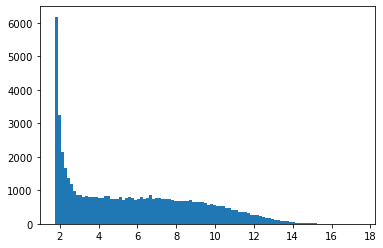

In [38]:
hs = []
for fl in final_fls:
    dic_drift,dic_fits,dic_extra = pickle.load(open(fl,'rb'))
    hs.extend(dic_fits['H1_647'][:,-1])
    
plt.figure()
plt.hist(hs,bins=100);

In [39]:
Ncells = 0
for fl in final_fls[1:]:
    dic_drift,dic_fits,dic_extra = pickle.load(open(fl,'rb'))
    Ncells += dic_extra['no_cells']
print("Number of cells:",Ncells)

Number of cells: 895.6199903782775


In [45]:
#dic_chr = pickle.load(open(analysis_folder+os.sep+'dic_chr_STORM65_40x_driftCor.pkl','rb'))

pairs = [['H1_647', 'H3_750'],
 ['H1_750', 'H4_647'],
 ['H2_647', 'H6_647'],
 ['H2_750', 'H5_647'],
 ['H3_647', 'H6_750']]

pairs_ln = [ln_ for ln in pairs for ln_ in ln]

dic_chr = {}
dic_full_XY={}
for A in pairs_ln:
    for B in tqdm(pairs_ln):
        hgood1,hbad1,hgood2,hbad2 = [],[],[],[]
        X1s,X2s,h1s,h2s,i1_s,i2_s=[],[],[],[],[],[]
        for fl in final_fls[:]:
            dic_drift,dic_fits,dic_extra = pickle.load(open(fl,'rb'))
            try:
                i1_,i2_,X1,X2_,h1,h2 = get_intersection_final(dic_fits,dic_drift,dic_chr,A,B,hre =0,dkeep=5,dre=5)
                good = np.zeros(len(X1),dtype=bool)
                good[i1_] = True
                hgood1.extend(h1[i1_])
                hbad1.extend(h1[~good])

                good = np.zeros(len(X2_),dtype=bool)
                good[i2_] = True
                hgood2.extend(h2[i2_])
                hbad2.extend(h2[~good])
            except:
                X1,X2_,h1,h2,i1_,i2_=[],[],[],[],[],[]
            X1s.append(X1)
            X2s.append(X2_)
            h1s.append(h1)
            h2s.append(h2)
            i1_s.append(i1_)
            i2_s.append(i2_)
            
        #hgood1,hbad1=np.array(hgood1),np.array(hbad1)
        #hgood2,hbad2=np.array(hgood2),np.array(hbad2)
        dic_full_XY[A+'--'+B]=[X1s,X2s,h1s,h2s,i1_s,i2_s]

<ipython-input-45-8e582258c695>:14: TqdmDeprecationWarning: This function will be removed in tqdm==5.0.0
Please use `tqdm.notebook.tqdm` instead of `tqdm.tqdm_notebook`
  for B in tqdm(pairs_ln):


In [28]:
%matplotlib inline

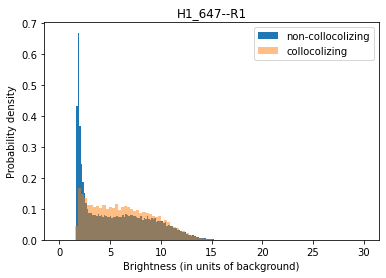

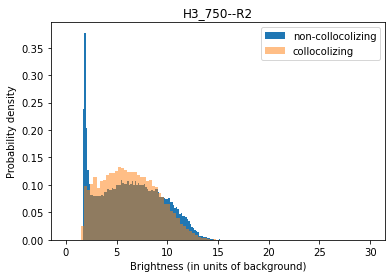

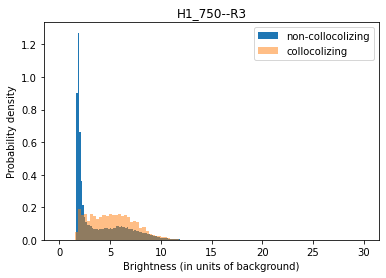

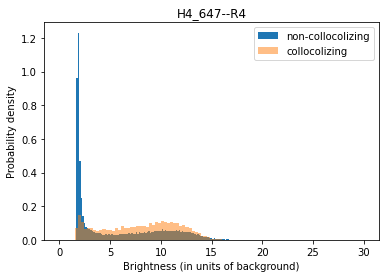

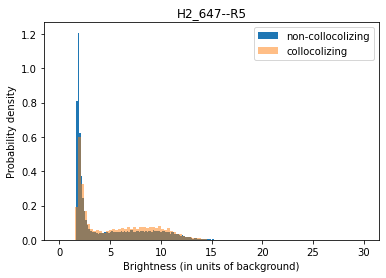

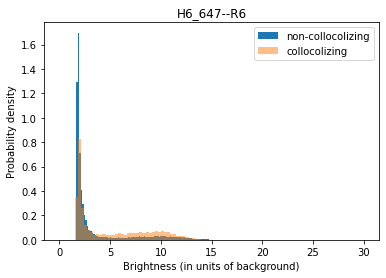

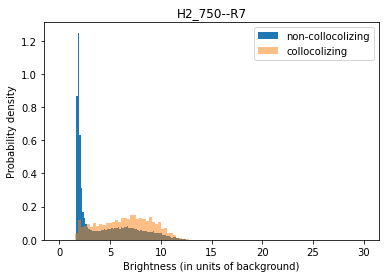

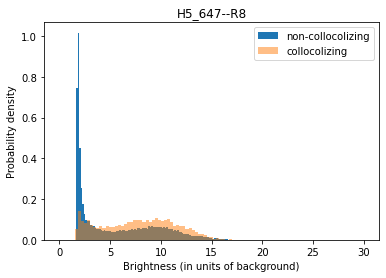

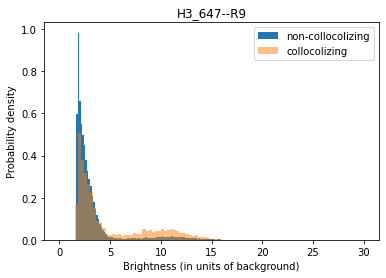

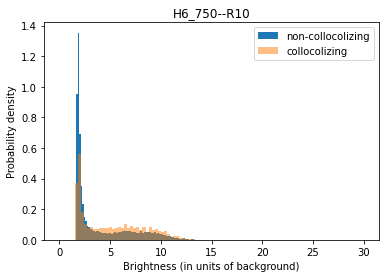

In [46]:
def flatten(lst): return np.array([e for l in lst for e in l])
pairs_ln = list(flatten(pairs))
def nm_to_Ri(key): return pairs_ln.index(key)+1
keys = np.array(pairs_ln)
dic_key = {nm_to_Ri(key):key for key in keys}

for pr in pairs[:]:
    A,B = pr
    X1s,X2s,h1s,h2s,i1_s,i2_s = dic_full_XY[A+'--'+B]
    h1s_ = np.array([x__ for x_ in h1s for x__ in x_])
    h2s_ = np.array([x__ for x_ in h2s for x__ in x_])
    is1 = [0]+list(np.cumsum(list(map(len,h1s))))
    is2 = [0]+list(np.cumsum(list(map(len,h2s))))
    i1_s_ = np.array([x__ for x_,y_ in zip(is1,i1_s) for x__ in y_+x_])
    i2_s_ = np.array([x__ for x_,y_ in zip(is2,i2_s) for x__ in y_+x_])
    good1 = np.zeros(len(h1s_),dtype=bool)
    good1[i1_s_]=True
    good2 = np.zeros(len(h2s_),dtype=bool)
    good2[i2_s_]=True
    
    plt.figure()
    plt.title(A+'--R'+str(nm_to_Ri(A)))
    plt.hist(h1s_[~good1],bins=np.linspace(0,30,200),density=True,label='non-collocolizing')
    plt.hist(h1s_[i1_s_],bins=np.linspace(0,30,100),density=True,alpha=0.5,label='collocolizing');
    plt.legend()
    plt.xlabel('Brightness (in units of background)')
    plt.ylabel('Probability density')
    #plt.hist(np.log(h1s_[~good1]),bins=np.linspace(0,np.log(30),200),normed=True)
    #plt.hist(np.log(h1s_[i1_s_]),bins=np.linspace(0,np.log(30),100),normed=True,alpha=0.5);
    
    plt.figure()
    plt.title(B+'--R'+str(nm_to_Ri(B)))
    plt.hist(h2s_[~good2],bins=np.linspace(0,30,200),density=True,label='non-collocolizing')
    plt.hist(h2s_[i2_s_],bins=np.linspace(0,30,100),density=True,alpha=0.5,label='collocolizing');
    plt.legend()
    plt.xlabel('Brightness (in units of background)')
    plt.ylabel('Probability density')
    #plt.hist(np.log(h1s_[~good1]),bins=np.linspace(0,np.log(30),200),normed=True)
    #plt.hist(np.log(h1s_[i1_s_]),bins=np.linspace(0,np.log(30),100),normed=True,alpha=0.5);

<IPython.core.display.Javascript object>


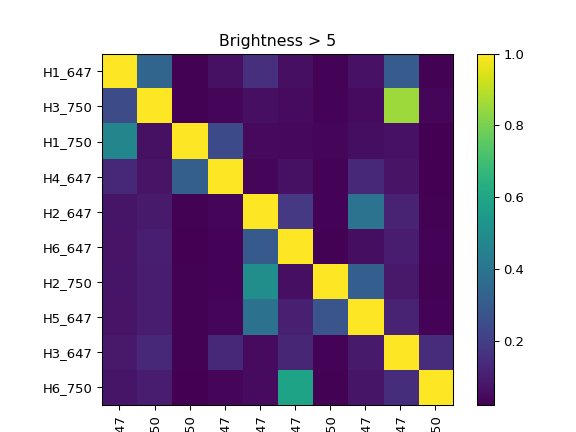

<IPython.core.display.Javascript object>


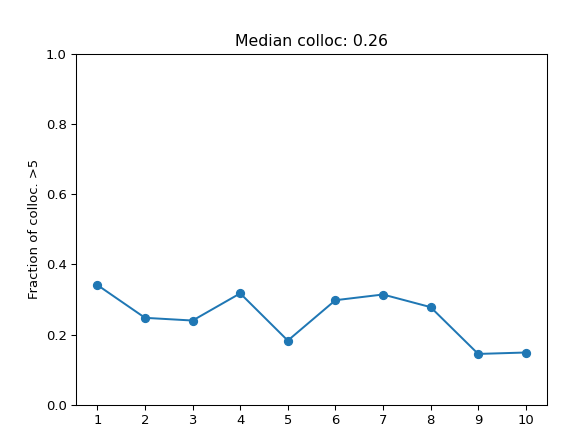

(0.0, 1.0)

In [105]:
#upairs = np.unique(pairs)
#upairs =  upairs[np.argsort(list(map(nm_to_Ri,upairs)))]
upairs = np.array(pairs_ln)
M = np.zeros([len(upairs)]*2)
MN = np.zeros([len(upairs)]*2)
for iA,A in enumerate(upairs):
    for iB,B in enumerate(upairs):
        X1s,X2s,h1s,h2s,i1_s,i2_s = dic_full_XY[A+'--'+B]
        
        h1s_ = np.array([x__ for x_ in h1s for x__ in x_])
        h2s_ = np.array([x__ for x_ in h2s for x__ in x_])
        h1_s_ = np.array([x__ for x_,y_ in zip(h1s,i1_s) if len(x_) for x__ in x_[y_]])
        h2_s_ = np.array([x__ for x_,y_ in zip(h2s,i2_s) if len(x_) for x__ in x_[y_]])
        h_ = 5
        N1 = np.sum(h1s_>h_)
        N2 = np.sum(h2s_>h_)
        Ni = np.sum((h1_s_>h_))#&(h2_s_>h_)
        M[iA,iB] = Ni/N1
        MN[iA,iB] = Ni
plt.figure()
plt.title('Brightness > '+str(h_))
plt.imshow(M)
plt.colorbar()
plt.xticks(range(len(upairs)),upairs,rotation='vertical')
plt.yticks(range(len(upairs)),upairs);

plt.figure()
frs_ = [x__ for x_ in zip([M[i*2,i*2+1] for i in range(5)],[M[i*2+1,i*2] for i in range(5)]) for x__ in x_]
plt.title('Median colloc: '+str(np.round(np.median(frs_),2)))
plt.plot(frs_,'o-')
plt.xticks(np.arange(10),np.arange(10)+1)
plt.xlabel('Readouts')
plt.ylabel('Fraction of colloc. >'+str(h_))
plt.ylim([0,1])

<IPython.core.display.Javascript object>


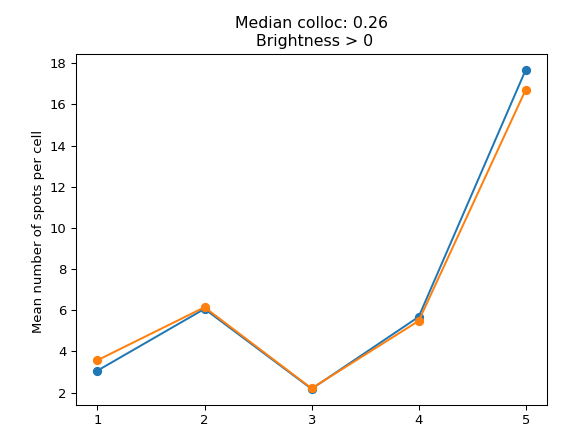

Text(0, 0.5, 'Mean number of spots per cell ')

In [94]:
Ncells

plt.figure()
MERFISH_data = [('ANKRD52', 33.48245614035088, 15.832492566489945),
('ZNF592', 5.0891812865497075, 3.02609507063012),
('SIPA1L3', 4.361111111111111, 3.12058004513002),
('LRP1', 5.9451754385964914, 5.09994325145405),
('TLN1', 45.6937134502924, 21.006450310115213)]
data_MERFISH = [ln[1] for ln in MERFISH_data]
bb_order = [ln[0] for ln in MERFISH_data]
wea_order = np.array([ln.split('=')for ln in '''H1_647 = TLN1
H1_750 = LRP1
H2_647 = ANKRD52
H2_750 = ZNF592
H3_647 = SIPA1L3'''.replace(' ','').split('\n')])
wea_order = list(wea_order[:,-1])
reorder = [wea_order.index(gn) for gn in bb_order]

frs_ = [x__ for x_ in zip([M[i*2,i*2+1] for i in range(5)],[M[i*2+1,i*2] for i in range(5)]) for x__ in x_]

nspots_ = np.array([x__ for x_ in zip([MN[i*2,i*2+1] for i in range(5)],[MN[i*2+1,i*2] for i in range(5)]) for x__ in x_])/Ncells

plt.title('Median colloc: '+str(np.round(np.median(frs_),2))+'\n Brightness > '+str(h_))
plt.plot(nspots_[1::2][reorder],'o-')
plt.plot(nspots_[::2][reorder],'o-')
plt.plot()
plt.xticks(np.arange(5),np.arange(5)+1)
plt.xlabel('Gene')
plt.ylabel('Mean number of spots per cell ')
#plt.ylim([0,1])

<IPython.core.display.Javascript object>


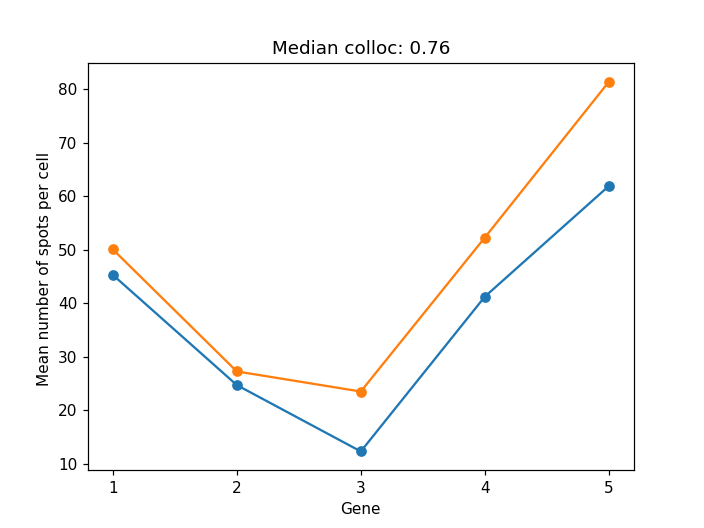

Text(0, 0.5, 'Mean number of spots per cell ')

In [960]:
Ncells

plt.figure()
frs_ = [x__ for x_ in zip([M[i*2,i*2+1] for i in range(5)],[M[i*2+1,i*2] for i in range(5)]) for x__ in x_]
nspots_ = np.array([x__ for x_ in zip([MN[i*2,i*2+1] for i in range(5)],[MN[i*2+1,i*2] for i in range(5)]) for x__ in x_])/Ncells
plt.title('Median colloc: '+str(np.round(np.median(frs_),2)))
plt.plot(nspots_[1::2],'o-')
plt.plot(nspots_[::2],'o-')
plt.xticks(np.arange(5),np.arange(5)+1)
plt.xlabel('Gene')
plt.ylabel('Mean number of spots per cell ')
#plt.ylim([0,1])

In [970]:
list(zip(nspots_[1::2],nspots_[0::2]))

[(45.304266252921366, 50.07102973963491),
 (24.708936989716282, 27.258791580032707),
 (12.303071140468958, 23.501781427336724),
 (41.22613634625404, 52.27429332070747),
 (61.9042471890948, 81.38066059568582)]

<IPython.core.display.Javascript object>


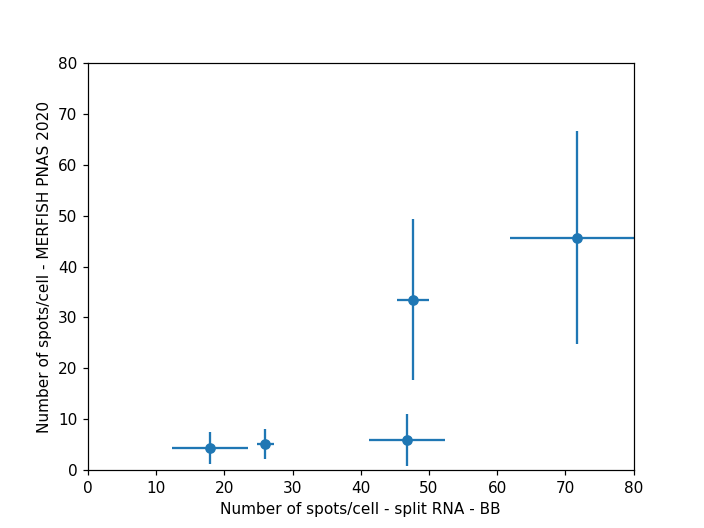

Text(0, 0.5, 'Number of spots/cell - MERFISH PNAS 2020')

In [973]:
plt.figure()
plt.errorbar((nspots_[1::2]+nspots_[0::2])/2.,data_MERFISH,fmt='o',yerr=[ln[2] for ln in MERFISH_data],
             xerr=np.abs(nspots_[1::2]-nspots_[0::2])/2)
plt.xlim([0,80])
plt.ylim([0,80])
plt.xlabel('Number of spots/cell - split RNA - BB')
plt.ylabel('Number of spots/cell - MERFISH PNAS 2020')

In [963]:
?plt.errorbar

In [ ]:
fl = r'C:\Users\Bogdan\Downloads\pnas.1912459116.sd12.csv' #doanloaded from PNA paper
lines = [ln.split(',') for ln in open(fl,'r')]
dic_cts = {ln[0]:np.array(ln[1:],dtype=float)for ln in lines[1:]}

In [61]:
print(analysis_folder)

D:\Data\112520_wea_rca_test4_peg\Analysis


### Check colocalizing hybes

In [62]:
folder = r'D:\Data\112520_wea_rca_test4_peg'
analysis_folder = folder+os.sep+'Analysis'
if not os.path.exists(analysis_folder): os.makedirs(analysis_folder)    

ims_meds = np.load(analysis_folder+os.sep+'im_meds.npy')
ims_meds[-1] = np.ones(ims_meds[-1].shape)*np.median(ims_meds[-1])#dapi is not good given current statistics.

folders = glob.glob(folder+'\H*')
folders = [fld for fld in folders if len(glob.glob(fld+r'\*.tif'))]
fovs = [os.path.basename(fl) for fl in glob.glob(folders[0]+r'\*.tif')]
cols = ['750','561','647','405']
ncols = len(cols)

#Iterate across FOVs
#for fov in fovs:
ifov = 4
fov = fovs[ifov]
#Load images into dictionary im_dic
ims,ims_nms = [],[]
for fld in tqdm(folders):
    fl = fld+os.sep+fov
    im = tifffile.imread(fl)

    for icol,col in enumerate(cols):
        ims.append(im[icol::ncols]/ims_meds[icol])
        tag = os.path.basename(os.path.dirname(fl))+'_'+col
        ims_nms.append(tag)

im_dic = {nm:im for im,nm in zip(ims,ims_nms)}

<ipython-input-62-3fd6a9f7b65f>:20: TqdmDeprecationWarning: This function will be removed in tqdm==5.0.0
Please use `tqdm.notebook.tqdm` instead of `tqdm.tqdm_notebook`
  for fld in tqdm(folders):


In [64]:
%matplotlib notebook

<IPython.core.display.Javascript object>


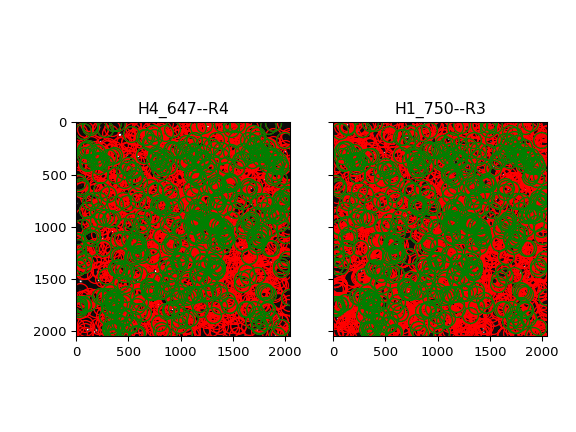

Text(0.5, 1.0, 'H1_750--R3')

In [70]:
A,B = pairs[1][::-1]

X1s,X2s,h1s,h2s,i1_s,i2_s = dic_full_XY[A+'--'+B]



fig,(ax1,ax2)=plt.subplots(1,2,sharex=True,sharey=True)
A_ = A
ifov_ = ifov
X1_ = X1s[ifov_]
h1_ = h1s[ifov_]
i1_ = i1_s[ifov_]
h_ = 0
h = h1_[i1_][h1_[i1_]>h_]
im = quick_norm(im_dic[A_])
X = X1_[h1_>h_]
#X = X1_
ax1.plot(X[:,2],X[:,1],'o',markersize=12,markeredgewidth=1,markeredgecolor='r',markerfacecolor='None')
X = X1_[i1_][h1_[i1_]>h_]
#X = X1_
ax1.plot(X[:,2],X[:,1],'o',markersize=12,markeredgewidth=1,markeredgecolor='g',markerfacecolor='None')
ax1.imshow(np.max(im,axis=0),vmax=np.percentile(h,20),cmap='gray')

A_ = B
ifov_ = ifov
X1_ = X2s[ifov_]
h1_ = h2s[ifov_]
i1_ = i2_s[ifov_]

h = h1_[i1_][h1_[i1_]>h_]
im = quick_norm(im_dic[A_])
X = X1_[h1_>h_]

ax2.plot(X[:,2],X[:,1],'o',markersize=12,markeredgewidth=1,markeredgecolor='r',markerfacecolor='None')

X = X1_[i1_][h1_[i1_]>h_]
ax2.plot(X[:,2],X[:,1],'o',markersize=12,markeredgewidth=1,markeredgecolor='g',markerfacecolor='None')
ax2.imshow(np.max(im,axis=0),vmax=np.percentile(h,50),cmap='gray')

ax1.set_title(A+'--R'+str(nm_to_Ri(A)))
ax2.set_title(B+'--R'+str(nm_to_Ri(B)))

Text(0.5, 1.0, 'H1R1,2,3;TEGR1_561--R3')

In [764]:
dic_chr = pickle.load(open(analysis_folder+os.sep+'dic_chr_STORM65_40x_driftCor.pkl','rb'))
dic_full={}
for A in np.unique(pairs):
    for B in tqdm(np.unique(pairs)):
        hgood1,hbad1,hgood2,hbad2 = [],[],[],[]
        for fl in final_fls[1:]:
            dic_drift,dic_fits,dic_extra = pickle.load(open(fl,'rb'))

            i1_,i2_,X1,X2_,h1,h2 = get_intersection_final(dic_fits,dic_drift,dic_chr,A,B,hre =5,dkeep=5,dre=2)
            good = np.zeros(len(X1),dtype=bool)
            good[i1_] = True
            hgood1.extend(h1[good])
            hbad1.extend(h1[~good])

            good = np.zeros(len(X2_),dtype=bool)
            good[i2_] = True
            hgood2.extend(h2[good])
            hbad2.extend(h2[~good])
        hgood1,hbad1=np.array(hgood1),np.array(hbad1)
        hgood2,hbad2=np.array(hgood2),np.array(hbad2)
        dic_full[A+'--'+B+'--'+A]=[hgood1,hbad1]
        dic_full[A+'--'+B+'--'+B]=[hgood2,hbad2]

In [803]:
upairs = np.unique(pairs)
upairs =  upairs[np.argsort(list(map(nm_to_Ri,upairs)))]
M = np.zeros([len(upairs)]*2)
for iA,A in enumerate(upairs):
    for iB,B in enumerate(upairs):
        hgood1,hbad1 = dic_full[A+'--'+B+'--'+A]
        hgood2,hbad2 = dic_full[A+'--'+B+'--'+B]
        h_ = 7.5
        N1 = np.sum(hgood1>h_)+np.sum(hbad1>h_)
        N2 = np.sum(hgood2>h_)+np.sum(hbad2>h_)
        M[iA,iB] = np.sum((hgood1>h_)&(hgood2>h_))/N1
        
plt.figure()
plt.imshow(M)
plt.colorbar()
plt.xticks(range(len(upairs)),upairs,rotation='vertical')
plt.yticks(range(len(upairs)),upairs)

ValueError: operands could not be broadcast together with shapes (132653,) (132557,) 

In [748]:
NAs,NBs,NABis = [],[],[]
for A,B in pairs_non:
    hgood1,hbad1 = dic_hinters_non[A]
    hgood2,hbad2 = dic_hinters_non[B]
    NA = len(hgood1)+len(hbad1)
    NB = len(hgood2)+len(hbad2)
    NABi = len(hgood1)
    NAs.append(NA)
    NBs.append(NB)
    NABis.append(NABi)

In [755]:
NABis,NAs

([36105, 30366, 28604, 17968, 38602], [702332, 433757, 727848, 441413, 784697])

In [753]:
kK = np.mean(NABis/np.array(NAs)/NBs)

kK*

<IPython.core.display.Javascript object>


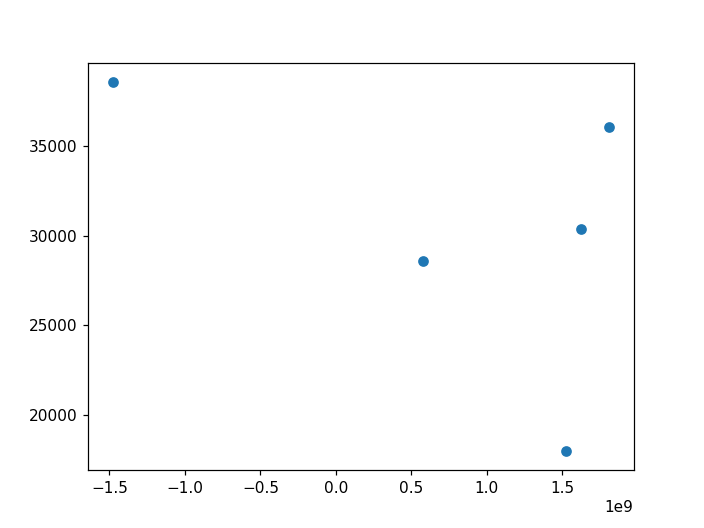

In [749]:
plt.figure()
plt.plot(np.array(NAs)*NBs,NABis,'o')

<IPython.core.display.Javascript object>


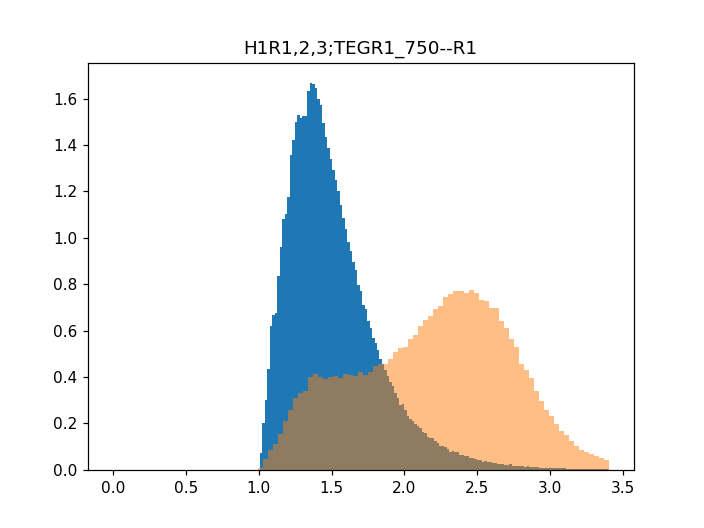

0.6816722551187844


<IPython.core.display.Javascript object>


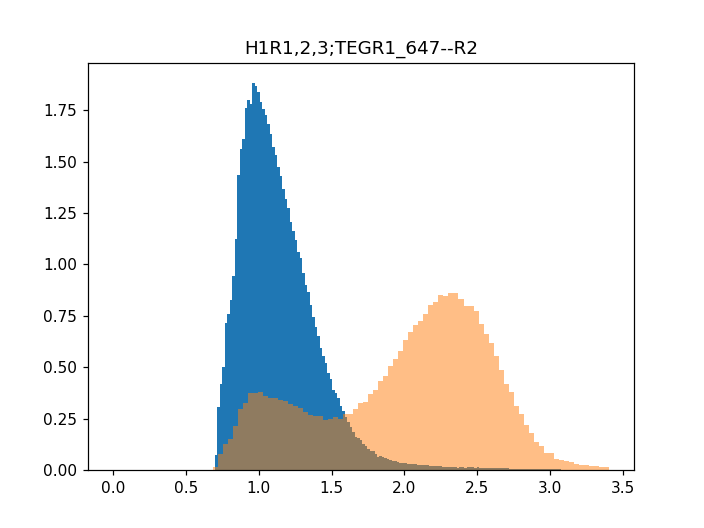

0.8984143984726071


<IPython.core.display.Javascript object>


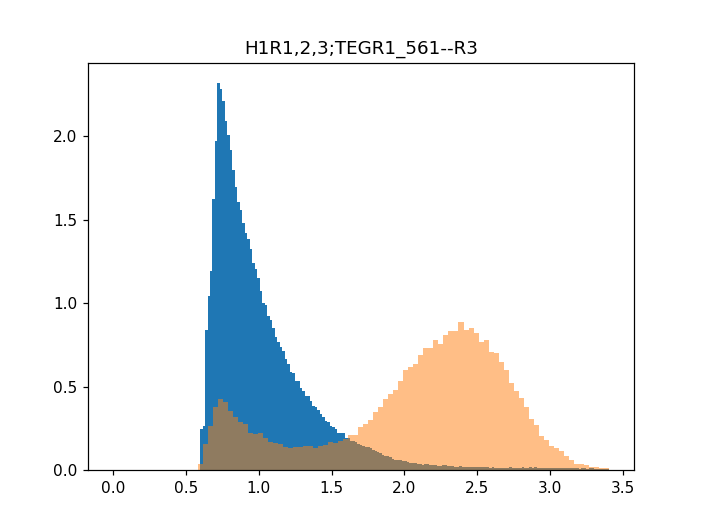

0.8324538483870417


<IPython.core.display.Javascript object>


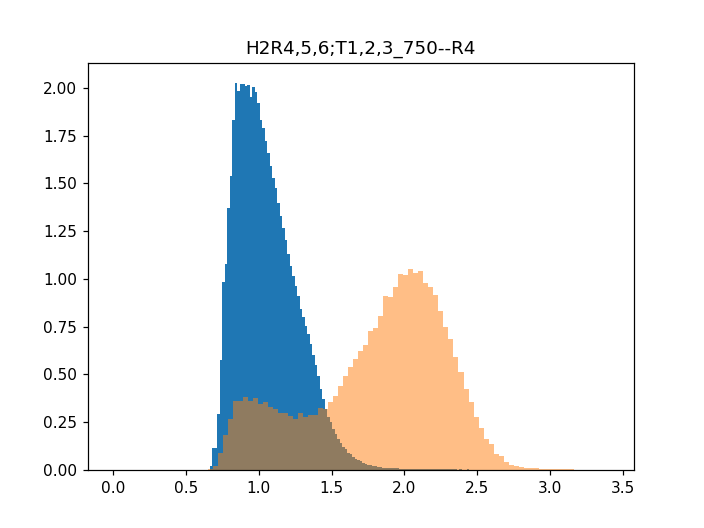

0.9394503381103047


<IPython.core.display.Javascript object>


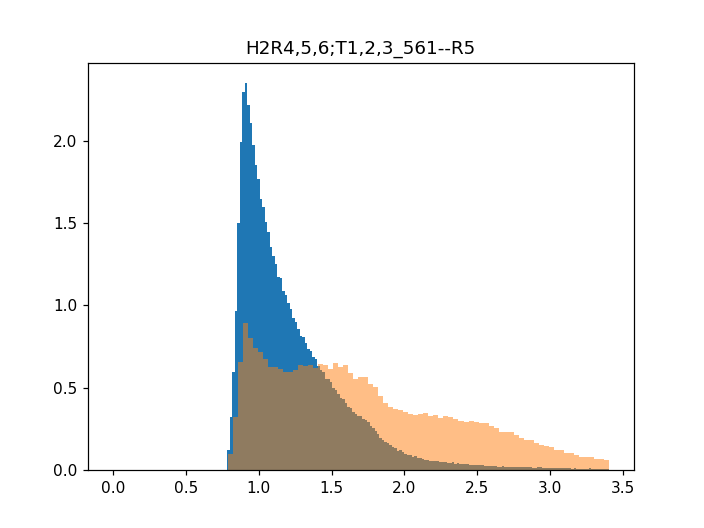

0.5610371530496824


<IPython.core.display.Javascript object>


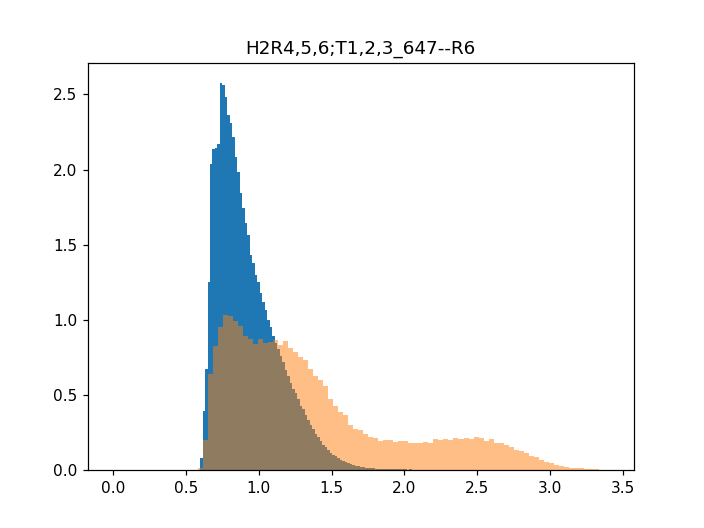

0.9390722853200297


<IPython.core.display.Javascript object>


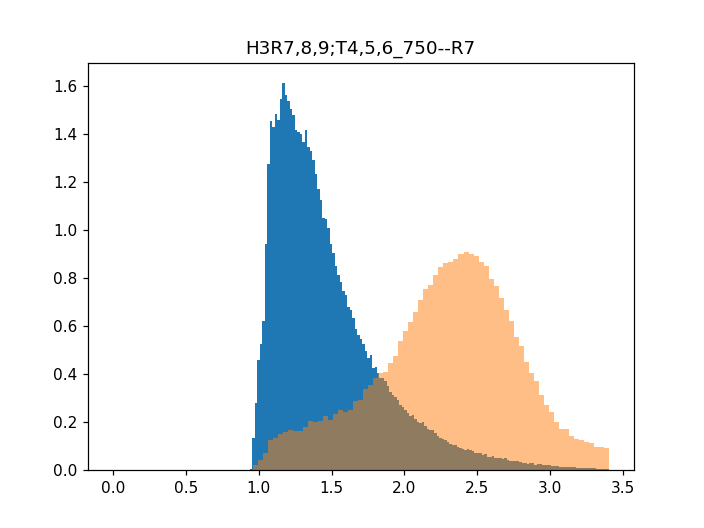

0.7641520017950444


<IPython.core.display.Javascript object>


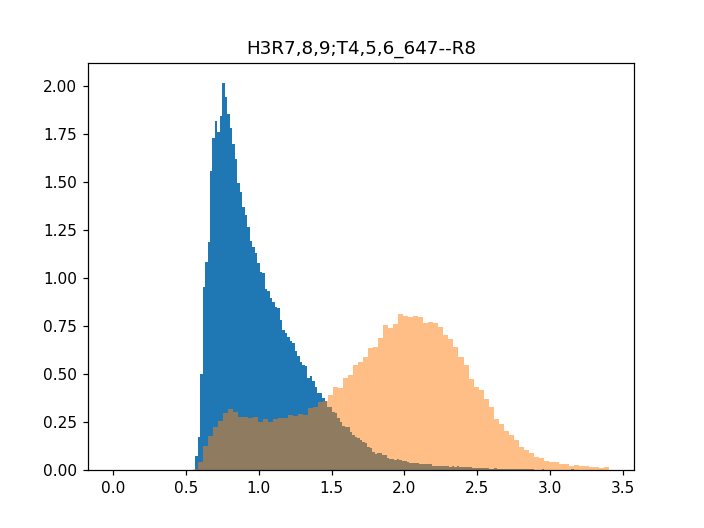

0.9480560973969193


<IPython.core.display.Javascript object>


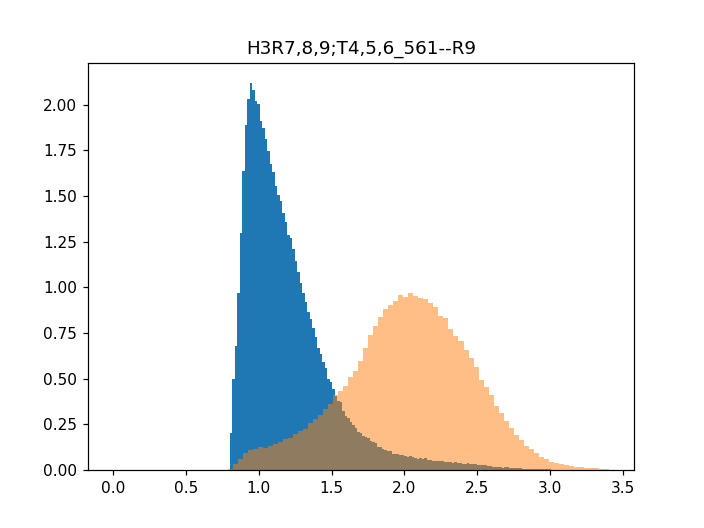

0.8642132857724921


<IPython.core.display.Javascript object>


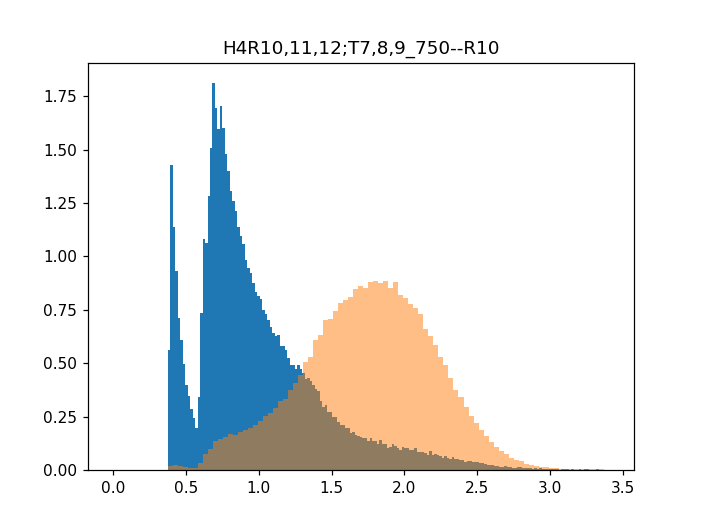

0.8765220592399615


In [690]:
np.exp(2)

7.38905609893065

<IPython.core.display.Javascript object>


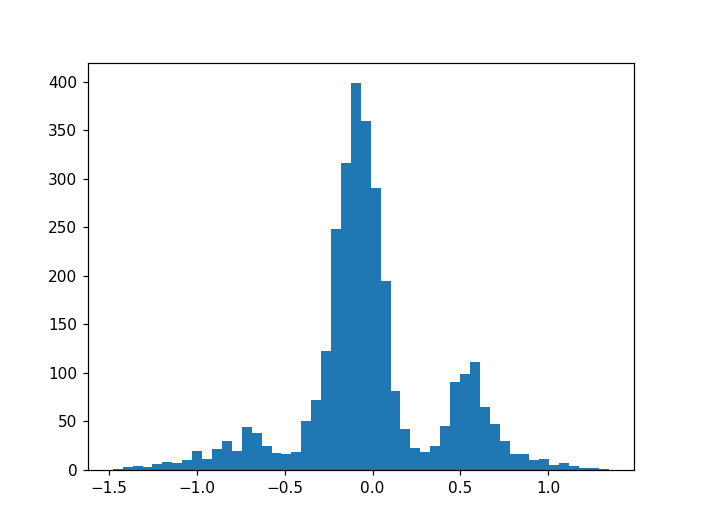

(array([  1.,   3.,   4.,   3.,   6.,   8.,   7.,  10.,  19.,  11.,  22.,
         30.,  20.,  44.,  38.,  25.,  17.,  16.,  18.,  50.,  72., 123.,
        248., 316., 399., 360., 290., 195.,  81.,  42.,  23.,  18.,  25.,
         45.,  91.,  99., 111.,  65.,  47.,  30.,  16.,  16.,  10.,  11.,
          5.,   7.,   4.,   2.,   2.,   1.]),
 array([-1.47844414, -1.42198809, -1.36553205, -1.309076  , -1.25261996,
        -1.19616391, -1.13970787, -1.08325182, -1.02679578, -0.97033973,
        -0.91388369, -0.85742764, -0.8009716 , -0.74451555, -0.68805951,
        -0.63160346, -0.57514742, -0.51869137, -0.46223533, -0.40577928,
        -0.34932324, -0.29286719, -0.23641114, -0.1799551 , -0.12349905,
        -0.06704301, -0.01058696,  0.04586908,  0.10232513,  0.15878117,
         0.21523722,  0.27169326,  0.32814931,  0.38460535,  0.4410614 ,
         0.49751744,  0.55397349,  0.61042953,  0.66688558,  0.72334162,
         0.77979767,  0.83625371,  0.89270976,  0.9491658 ,  1.00562185,
 

In [591]:
plt.figure()
plt.hist((X1_[i1_]-X2[i2_])[:,0],bins=50)

In [517]:
   
get_chrM(dic_chr,A)

In [487]:
ft.apply_colorcor(X2f,dic_chr)

[('H1R1,2,3;TEGR1_750', 'H1R1,2,3;TEGR1_647'),
 ('H1R1,2,3;TEGR1_561', 'H2R4,5,6;T1,2,3_750'),
 ('H2R4,5,6;T1,2,3_561', 'H2R4,5,6;T1,2,3_647'),
 ('H3R7,8,9;T4,5,6_750', 'H3R7,8,9;T4,5,6_647'),
 ('H3R7,8,9;T4,5,6_561', 'H4R10,11,12;T7,8,9_750')]

In [488]:
X1fs,X2fs=[],[]
dic_chr = pickle.load(open(analysis_folder+os.sep+'dic_chr_STORM65_40x_driftCor.pkl','rb'))
for fl in final_fls[1:]:
    dic_drift,dic_fits,dic_extra = pickle.load(open(fl,'rb'))
    #A,B = pairs[0]
    B,A = pairs[0]
    X1f,X2f = get_intersection(dic_fits,dic_drift,A,B,hre =5,dre=5)
    Xdif = np.mean(X1f-X2f,axis=0)
    X1f-=Xdif
    
    X1fs.extend(X1f)
    X2fs.extend(X2f)
X1fs = np.array(X1fs)
X2fs = np.array(X2fs)
print(len(X1fs),A,B)

104228 H1R1,2,3;TEGR1_647 H1R1,2,3;TEGR1_750


In [502]:
#load chromatic abberation
dic_chr = pickle.load(open(analysis_folder+os.sep+'dic_chr_STORM65_40x_driftCor.pkl','rb'))

In [ ]:
dic_drift,dic_fits,dic_extra = pickle.load(open(fl,'rb'))
    #A,B = pairs[0]
    B,A = pairs[1]
    X1f,X2f = get_intersection(dic_fits,dic_drift,A,B,hre =5,dre=5)
    Xdif = np.mean(X1f-X2f,axis=0)

### Compute chromatic aberation -- Each setup and objective need their own chromatic aberation

In [496]:
X1fs,X2fs=[],[]
for fl in final_fls[1:]:
    dic_drift,dic_fits,dic_extra = pickle.load(open(fl,'rb'))
    #A,B = pairs[0]
    B,A = pairs[2]
    X1f,X2f = get_intersection_nochromatic(dic_fits,dic_drift,A,B,hre =5,dre=5)
    Xdif = np.mean(X1f-X2f,axis=0)
    X1f-=Xdif
    X1fs.extend(X1f)
    X2fs.extend(X2f)
X1fs = np.array(X1fs)
X2fs = np.array(X2fs)
print(len(X1fs),A,B)

25664 H2R4,5,6;T1,2,3_647 H2R4,5,6;T1,2,3_561


<IPython.core.display.Javascript object>


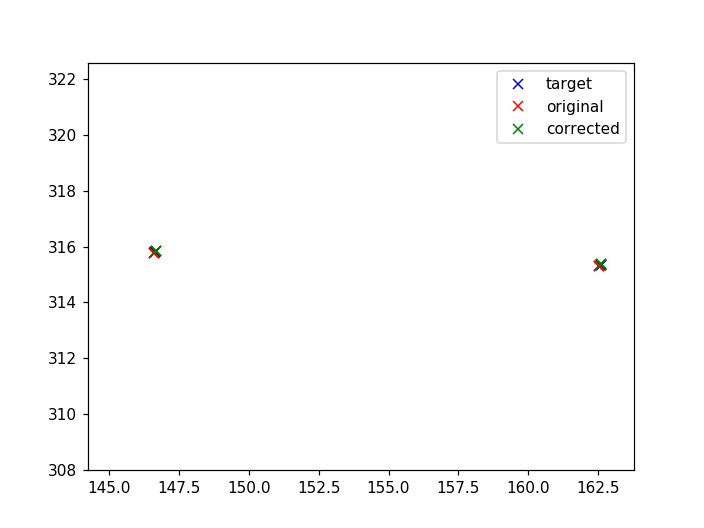

(-79.24795642593412, 2128.0120626193952, -80.586968167014, 2128.405864430731)

In [497]:
res = 10
t = KDTree(X1fs)
zM,xM,yM = np.max(X1fs,axis=0)
Xcs = []
for z_ in (np.arange(0,zM,res)+res/2).astype(int):
    for x_ in (np.arange(0,xM,res)+res/2).astype(int):
        for y_ in (np.arange(0,yM,res)+res/2).astype(int):
            Xcs.append([z_,x_,y_])
Xcs = np.array(Xcs)

X1fs_,X2fs_=[],[]
for lst in t.query_ball_point(Xcs,50,p=np.inf):
    if len(lst)>0:
        X1fs_.append(np.mean(X1fs[lst],axis=0))
        X2fs_.append(np.mean(X2fs[lst],axis=0))
X1fs_ = np.array(X1fs_)
X2fs_ = np.array(X2fs_)

import FittingTools_py3 as ft
M = ft.calc_color_matrix(X1fs_,X2fs_,order=2)
X2fs__ = ft.apply_colorcor(X2fs_,M)
plt.figure()
plt.plot(X1fs_[:,2],X1fs_[:,1],'bx',label='target')
plt.plot(X2fs_[:,2],X2fs_[:,1],'rx',label='original')
plt.plot(X2fs__[:,2],X2fs__[:,1],'gx',label ='corrected')
plt.legend()
plt.axis('equal')


In [492]:
np.median(X2fs_-X1fs_,0)

array([ 0.00049757,  0.00460868, -0.00636945])

In [463]:
#dic_chr={}
#key = A.split('_')[-1]+'-'+B.split('_')[-1]
#dic_chr[key]=M
#key

'750-647'

In [498]:
#dic_chr3 = {}
key = A.split('_')[-1]+'-'+B.split('_')[-1]
dic_chr3[key]=M
pickle.dump(dic_chr3,open(analysis_folder+os.sep+'dic_chr_STORM65_40x_driftCor.pkl','wb'))

[0.09713398 0.02003945 0.00472467]


<IPython.core.display.Javascript object>


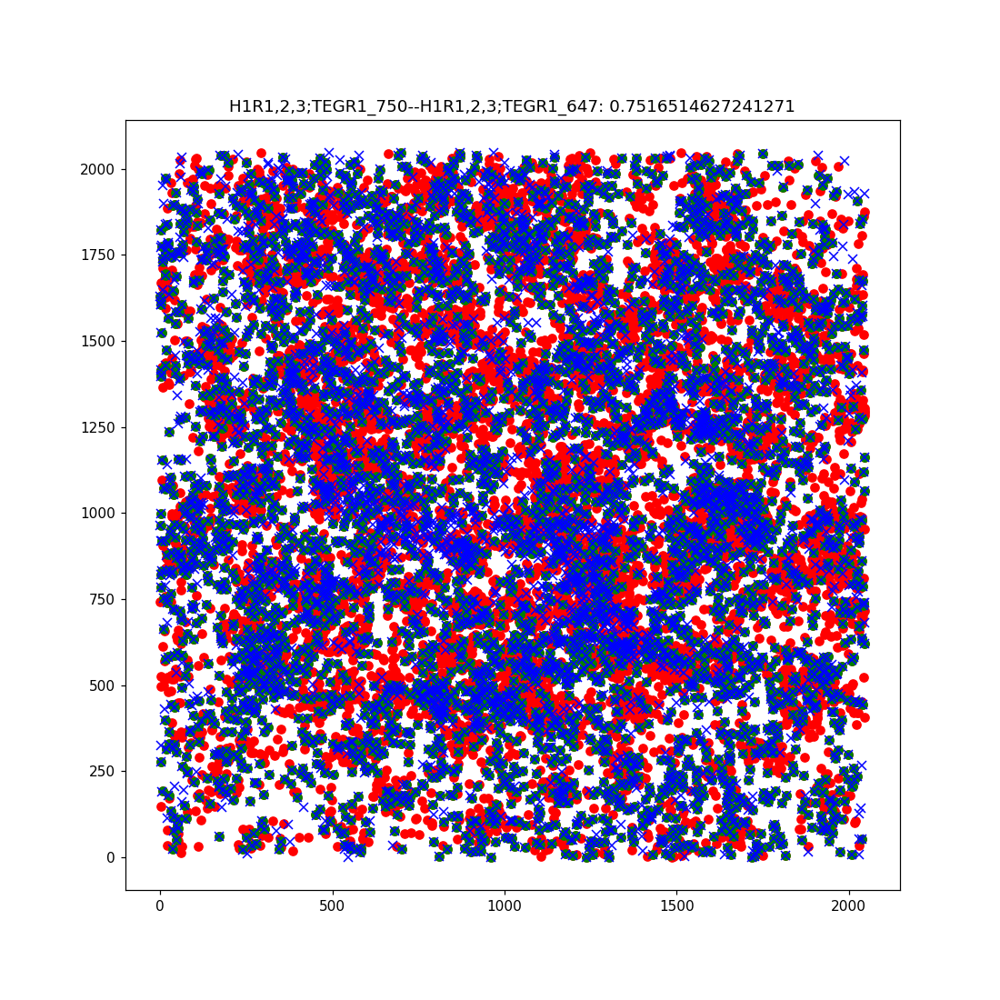

In [291]:
for A,B in [pairs[0]]:
    z1,x1,y1,h1 =dic_fits[A].T
    z2,x2,y2,h2 =dic_fits[B].T
    keep1 = h1>5
    z1,x1,y1,h1 = z1[keep1],x1[keep1],y1[keep1],h1[keep1]
    keep2 = h2>5
    z2,x2,y2,h2 = z2[keep2],x2[keep2],y2[keep2],h2[keep2]
    from scipy.spatial.distance import cdist
    X1 = np.array([z1,x1,y1]).T+dic_drift[A[:-4]][0]
    X2 = np.array([z2,x2,y2]).T+dic_drift[B[:-4]][0]
    
    dkeep = 5
    
    
    t1 =KDTree(X1)
    t2 =KDTree(X2)
    r1 = t1.query_ball_tree(t2, dkeep)
    r2 = t1.sparse_distance_matrix(t2, dkeep)
    i1_,i2_ = np.array([(ir,rs[np.argmin([r2[ir,r_] for r_ in rs])]) for ir,rs in enumerate(r1) if len(rs)>0]).T
    M = cdist(X1,X2)

    X1f = X1[i1_]
    X2f = X2[i2_]
    print(np.median(X1f-X2f,axis=0))
    intersection = float(len(X1f))/np.min([len(X2),len(X1)])
    
    plt.figure(figsize=(10,10))
    plt.title(A+'--'+B+': '+str(intersection))
    plt.plot(x1,y1,'ro')
    plt.plot(x1[i1_],y1[i1_],'go')
    plt.plot(x2,y2,'bx')
    plt.axis('equal')
    #np.median(1./h1[i1_]*h2[i2_])

In [290]:
#np.median(X1f-X2f,axis=0)
np.max(M[i1_,i2_])

4.998543309909434

### check the intersection between all possible combinations

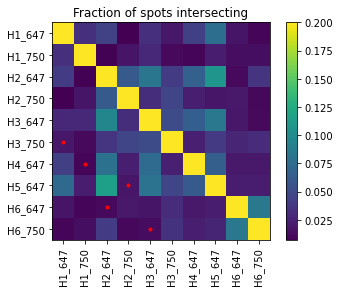

In [35]:
Is = []
for A in np.unique(pairs):
    Is_ = []
    for B in np.unique(pairs):
        z1,x1,y1,h1 =dic_fits[A].T
        z2,x2,y2,h2 =dic_fits[B].T
        from scipy.spatial.distance import cdist
        X1 = np.array([z1,x1,y1]).T+dic_drift[A[:-4]][0]
        X2 = np.array([z2,x2,y2]).T+dic_drift[B[:-4]][0]
        M = cdist(X1,X2)
        dists_ = np.min(M,axis=0)
        i1 = np.argmin(M,axis=0)
        i2 = np.arange(len(X2))
        keep = dists_<7
        i1_ = i1[keep]
        i2_ = i2[keep]
        intersection = np.sum(keep)/np.min([len(X2),len(X1)])
        Is_.append(intersection)
    Is.append(Is_)
tags = list(np.unique(pairs))
plt.figure()
plt.title('Fraction of spots intersecting')
plt.imshow(Is,vmax=0.2)
plt.colorbar()
plt.xticks(range(len(tags)),tags,rotation='vertical')
plt.yticks(range(len(tags)),tags)
for A,B in pairs:
    plt.plot([tags.index(A)],[tags.index(B)],'.r')
plt.show()

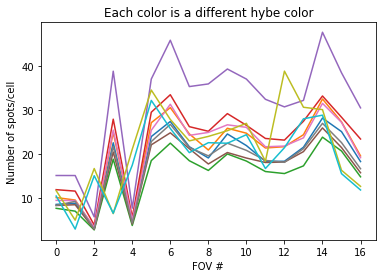

In [62]:
final_fls = glob.glob(r'D:\Data\wea_RCA_test\Analysis\*_final.pkl')
dics_drift,dics_fits,dics_extra=[],[],[]
for fl in final_fls:
    dic_drift,dic_fits,dic_extra = pickle.load(open(fl,'rb'))
    dics_drift.append(dic_drift)
    dics_fits.append(dic_fits)
    dics_extra.append(dic_extra)
pairs = [('H1_647','H3_750'),('H1_750','H4_647'),('H2_647','H6_647'),('H2_750','H5_647'),('H3_647','H6_750')]
tags = list(np.unique(pairs))
nRNA_per_cell = [[len(dic_[tag])/dic_extr['no_cells'] for tag in tags] for dic_,dic_extr in zip(dics_fits,dics_extra)]
nRNA_per_cell = np.array(nRNA_per_cell)
plt.figure()
plt.title('Each color is a different hybe color')
plt.ylabel('Number of spots/cell')
plt.xlabel("FOV #")
plt.plot(nRNA_per_cell)

Text(0, 0.5, 'Number of spots/cell')

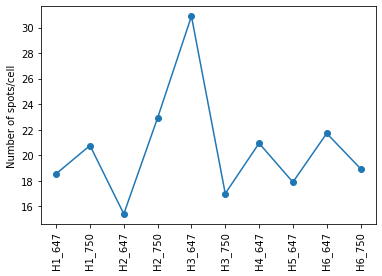

In [60]:
plt.figure()
plt.plot(np.mean(nRNA_per_cell,0),'o-')
plt.xticks(range(len(tags)),tags,rotation='vertical');
plt.ylabel('Number of spots/cell')

In [42]:
dics_extra

[{'no_cells': 76.34455974270283, 'area_per_cell': 16479.0},
 {'no_cells': 88.04741648942824, 'area_per_cell': 15986.0},
 {'no_cells': 88.63233570863025, 'area_per_cell': 15787.5},
 {'no_cells': 60.537062795579274, 'area_per_cell': 19770.5},
 {'no_cells': 81.0406207211319, 'area_per_cell': 16432.5},
 {'no_cells': 56.300319659030365, 'area_per_cell': 18770.0},
 {'no_cells': 64.27210812523099, 'area_per_cell': 18941.0},
 {'no_cells': 73.77274303548722, 'area_per_cell': 17302.0},
 {'no_cells': 69.34030720338983, 'area_per_cell': 18880.0},
 {'no_cells': 64.83260146711679, 'area_per_cell': 19698.5},
 {'no_cells': 66.99965247610773, 'area_per_cell': 17265.0},
 {'no_cells': 78.78532927820771, 'area_per_cell': 16604.5},
 {'no_cells': 67.28834290858066, 'area_per_cell': 18885.5},
 {'no_cells': 61.932883240667195, 'area_per_cell': 17626.0},
 {'no_cells': 60.314056306535214, 'area_per_cell': 19678.0},
 {'no_cells': 71.19309937120438, 'area_per_cell': 18607.0},
 {'no_cells': 59.38755220628291, 'are

In [39]:
dics_fits[0]

{'H1': (array([0., 0., 0.]),
  [array([0, 0, 0]),
   array([0, 0, 0]),
   array([0, 0, 0]),
   array([0, 0, 0]),
   array([0, 0, 0]),
   array([0, 0, 0]),
   array([0, 0, 0]),
   array([0, 0, 0]),
   array([0, 0, 0]),
   array([0, 0, 0]),
   array([0, 0, 0]),
   array([0, 0, 0]),
   array([0, 0, 0]),
   array([0, 0, 0]),
   array([0, 0, 0]),
   array([0, 0, 0]),
   array([0, 0, 0]),
   array([0, 0, 0]),
   array([0, 0, 0]),
   array([0, 0, 0]),
   array([0, 0, 0]),
   array([0, 0, 0]),
   array([0, 0, 0]),
   array([0, 0, 0]),
   array([0, 0, 0]),
   array([0, 0, 0]),
   array([0, 0, 0]),
   array([0, 0, 0]),
   array([0, 0, 0]),
   array([0, 0, 0]),
   array([0, 0, 0]),
   array([0, 0, 0]),
   array([0, 0, 0]),
   array([0, 0, 0]),
   array([0, 0, 0]),
   array([0, 0, 0]),
   array([0, 0, 0]),
   array([0, 0, 0]),
   array([0, 0, 0]),
   array([0, 0, 0]),
   array([0, 0, 0]),
   array([0, 0, 0]),
   array([0, 0, 0]),
   array([0, 0, 0]),
   array([0, 0, 0]),
   array([0, 0, 0]),
   ar

In [3]:
%matplotlib inline

### Using H2 check the efficiency of cleaving

<ipython-input-125-fdbd6095b643>:18: TqdmDeprecationWarning: This function will be removed in tqdm==5.0.0
Please use `tqdm.notebook.tqdm` instead of `tqdm.tqdm_notebook`
  for fld in tqdm(folders):
<ipython-input-125-fdbd6095b643>:18: TqdmDeprecationWarning: This function will be removed in tqdm==5.0.0
Please use `tqdm.notebook.tqdm` instead of `tqdm.tqdm_notebook`
  for fld in tqdm(folders):



Drift correcting H2 on fov: Conv_zscan_10.tif

Drift correcting H2 on fov: Conv_zscan_10.tif
Fitting H2_647 on fov: Conv_zscan_10.tif
Fitting H2_647 on fov: Conv_zscan_10.tif


<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>


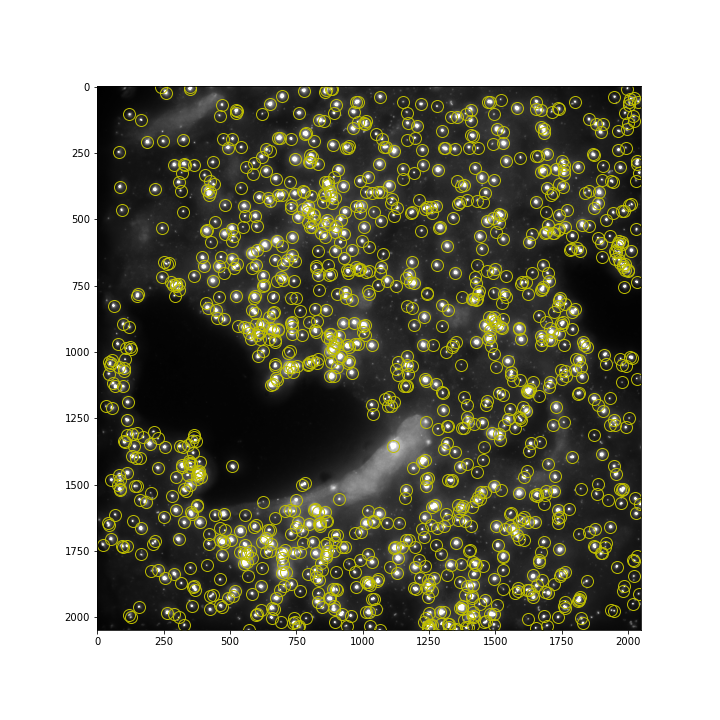

Fitting H2_750 on fov: Conv_zscan_10.tif
Fitting H2_750 on fov: Conv_zscan_10.tif


<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>


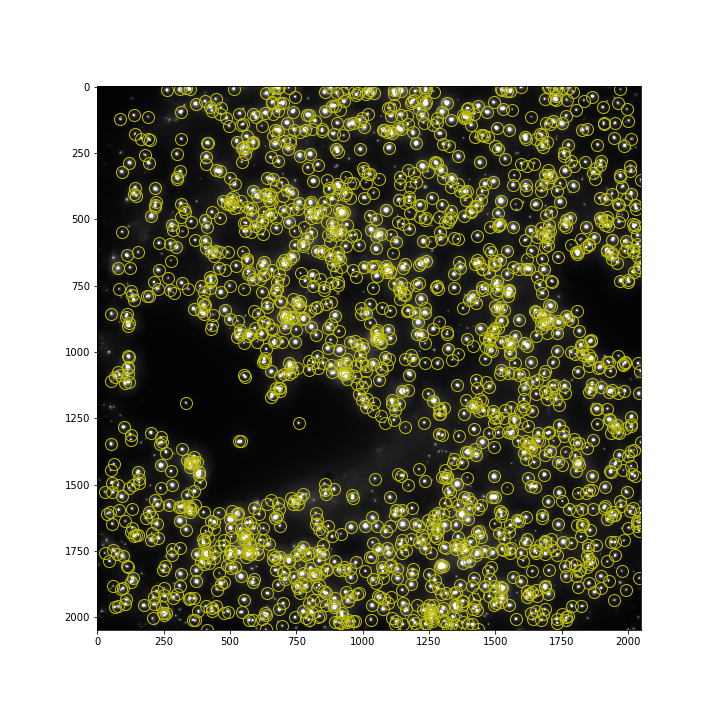

Drift correcting H2_high on fov: Conv_zscan_10.tif
Drift correcting H2_high on fov: Conv_zscan_10.tif


C:\Users\MERFISH8\Scripts\CommonTools\AlignmentTools_py3.py:164: RuntimeWarning: invalid value encountered in true_divide
  im2_/=np.std(im2_)
C:\Users\MERFISH8\Scripts\CommonTools\AlignmentTools_py3.py:183: RuntimeWarning: invalid value encountered in greater
  if np.sum(im_cor>0)>0:
C:\Users\MERFISH8\Scripts\CommonTools\AlignmentTools_py3.py:164: RuntimeWarning: invalid value encountered in true_divide
  im2_/=np.std(im2_)
C:\Users\MERFISH8\Scripts\CommonTools\AlignmentTools_py3.py:183: RuntimeWarning: invalid value encountered in greater
  if np.sum(im_cor>0)>0:


Fitting H2_high_647 on fov: Conv_zscan_10.tif
Fitting H2_high_647 on fov: Conv_zscan_10.tif


<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>


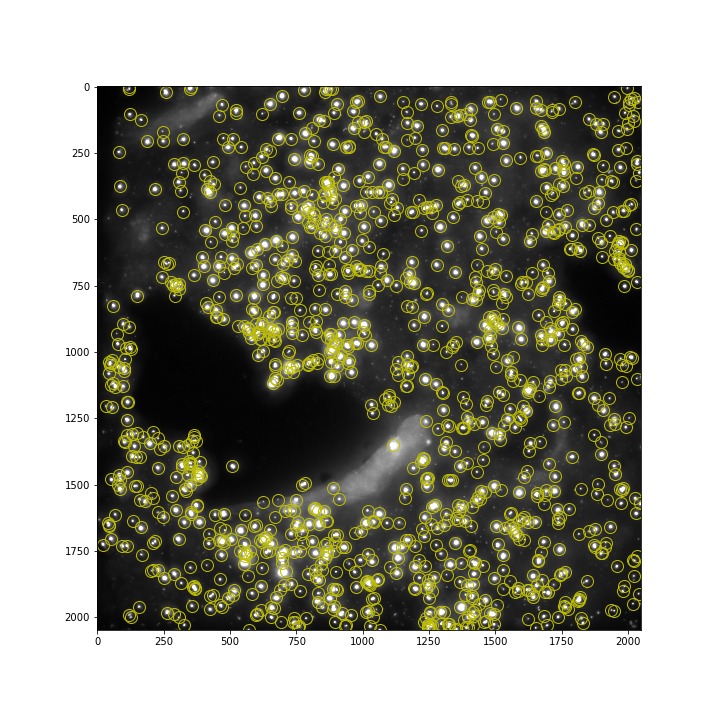

Fitting H2_high_750 on fov: Conv_zscan_10.tif
Fitting H2_high_750 on fov: Conv_zscan_10.tif


<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>


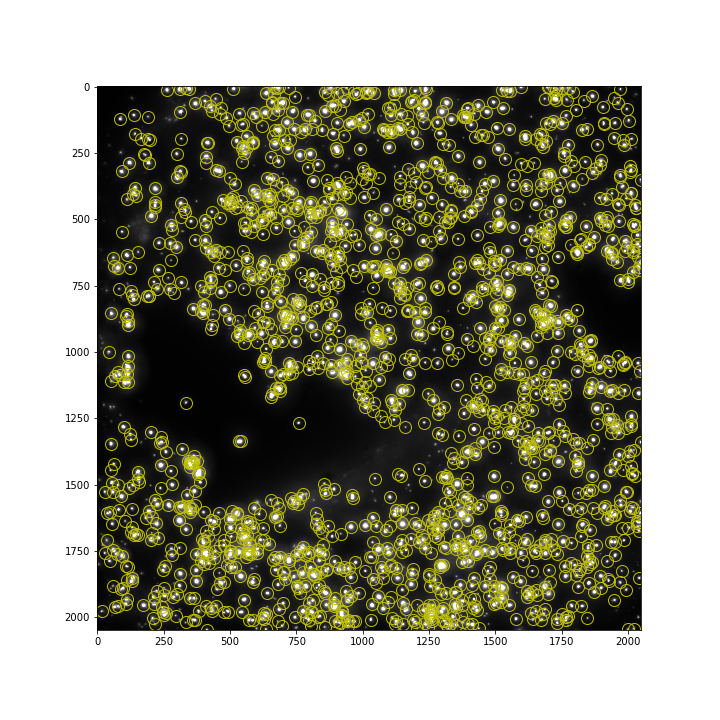

Drift correcting H2_postCleave on fov: Conv_zscan_10.tif
Drift correcting H2_postCleave on fov: Conv_zscan_10.tif


C:\Users\MERFISH8\Scripts\CommonTools\AlignmentTools_py3.py:164: RuntimeWarning: invalid value encountered in true_divide
  im2_/=np.std(im2_)
C:\Users\MERFISH8\Scripts\CommonTools\AlignmentTools_py3.py:183: RuntimeWarning: invalid value encountered in greater
  if np.sum(im_cor>0)>0:
C:\Users\MERFISH8\Scripts\CommonTools\AlignmentTools_py3.py:164: RuntimeWarning: invalid value encountered in true_divide
  im2_/=np.std(im2_)
C:\Users\MERFISH8\Scripts\CommonTools\AlignmentTools_py3.py:183: RuntimeWarning: invalid value encountered in greater
  if np.sum(im_cor>0)>0:


Fitting H2_postCleave_647 on fov: Conv_zscan_10.tif
Fitting H2_postCleave_647 on fov: Conv_zscan_10.tif


<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>


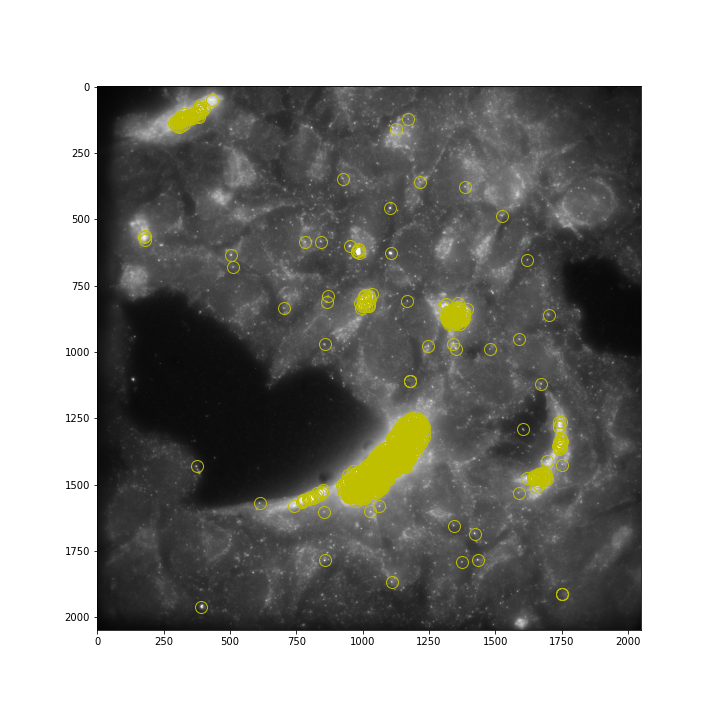

Fitting H2_postCleave_750 on fov: Conv_zscan_10.tif
Fitting H2_postCleave_750 on fov: Conv_zscan_10.tif


<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>


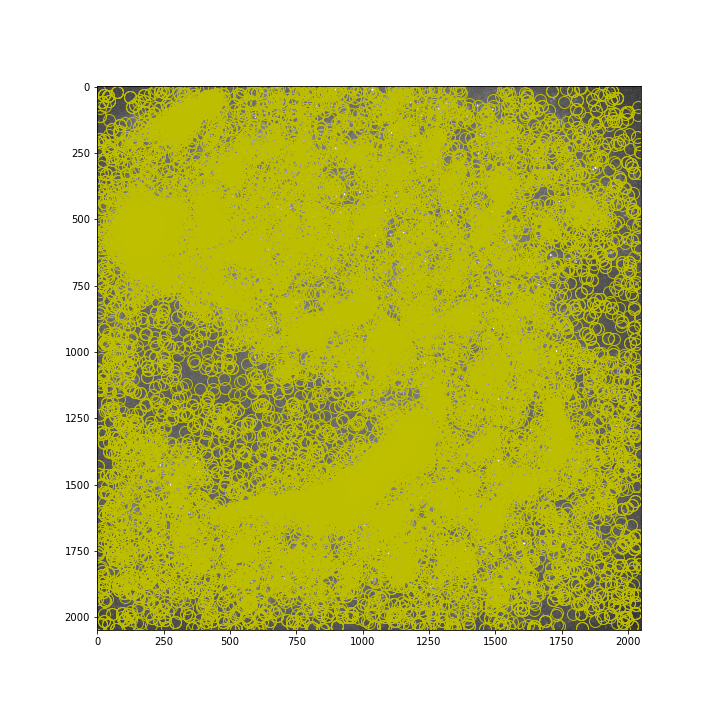

Drift correcting H2_postCleave_high on fov: Conv_zscan_10.tif
Drift correcting H2_postCleave_high on fov: Conv_zscan_10.tif


C:\Users\MERFISH8\Scripts\CommonTools\AlignmentTools_py3.py:164: RuntimeWarning: invalid value encountered in true_divide
  im2_/=np.std(im2_)
C:\Users\MERFISH8\Scripts\CommonTools\AlignmentTools_py3.py:183: RuntimeWarning: invalid value encountered in greater
  if np.sum(im_cor>0)>0:
C:\Users\MERFISH8\Scripts\CommonTools\AlignmentTools_py3.py:164: RuntimeWarning: invalid value encountered in true_divide
  im2_/=np.std(im2_)
C:\Users\MERFISH8\Scripts\CommonTools\AlignmentTools_py3.py:183: RuntimeWarning: invalid value encountered in greater
  if np.sum(im_cor>0)>0:


Fitting H2_postCleave_high_647 on fov: Conv_zscan_10.tif
Fitting H2_postCleave_high_647 on fov: Conv_zscan_10.tif


<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>


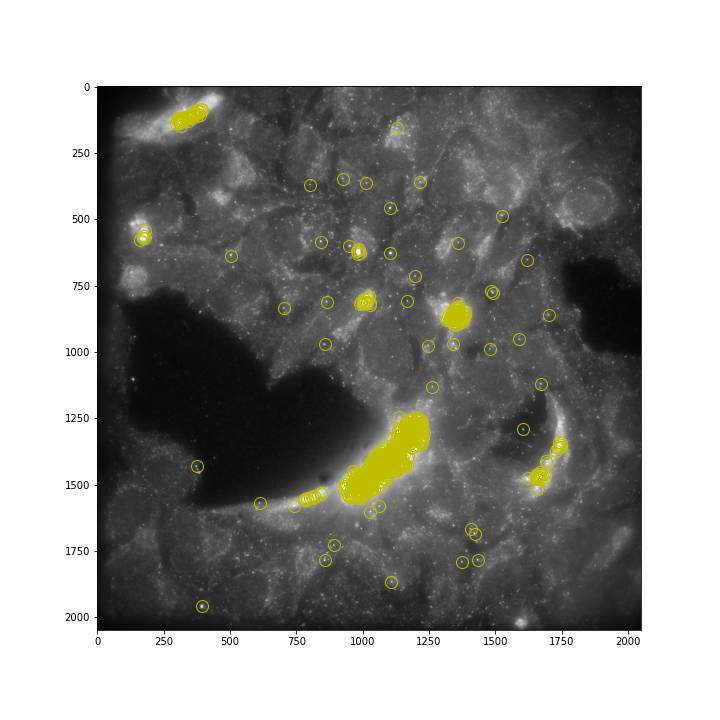

Fitting H2_postCleave_high_750 on fov: Conv_zscan_10.tif
Fitting H2_postCleave_high_750 on fov: Conv_zscan_10.tif


<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>


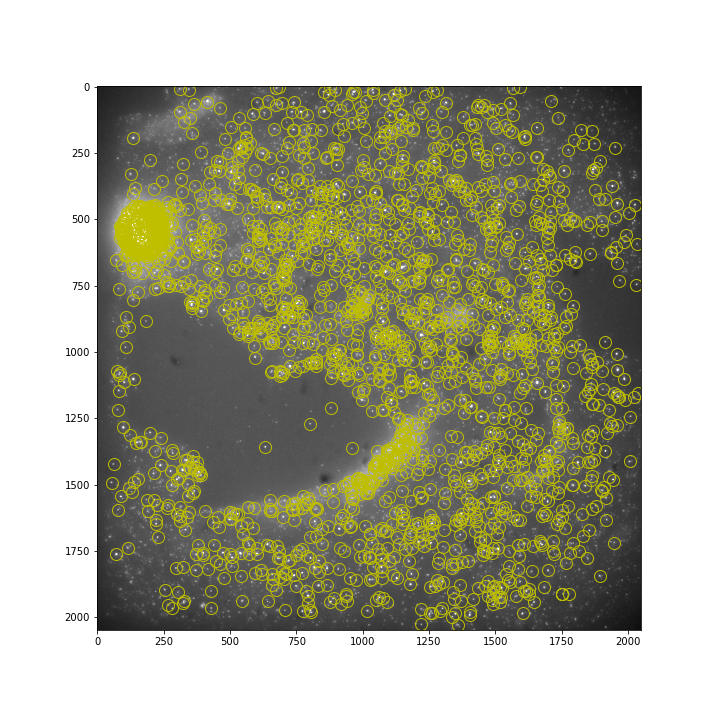

Estimating number of cells based on dapi image on fov: Conv_zscan_10.tif
Estimating number of cells based on dapi image on fov: Conv_zscan_10.tif


<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>


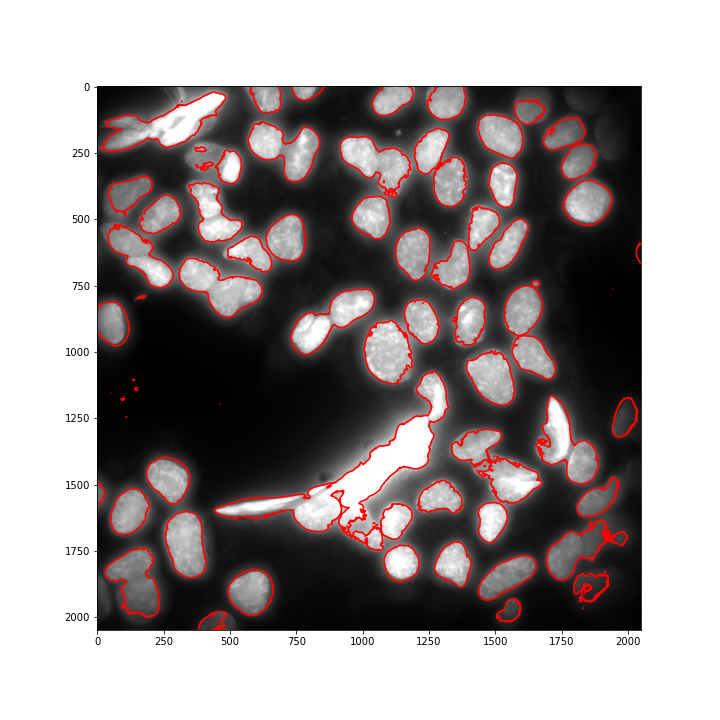

In [125]:
#Iterate trhough fovs - fit and drift correct

folder = r'D:\Data\wea_RCA_test'
analysis_folder = folder+os.sep+'Analysis'
if not os.path.exists(analysis_folder):
    os.makedirs(analysis_folder)
folders = glob.glob(folder+'\H*')
folders = [fld for fld in folders if len(glob.glob(fld+r'\*.tif')) and ('H2' in os.path.basename(fld))]
fovs = [os.path.basename(fl) for fl in glob.glob(folders[0]+r'\*.tif')]
cols = ['750','647','405']



#Iterate across FOVs
for fov in [fovs[10]]:
    #Load images into dictionary im_dic
    ims,ims_nms = [],[]
    for fld in tqdm(folders):
        fl = fld+os.sep+fov
        im = tifffile.imread(fl)
        ncols = len(cols)
        for icol,col in enumerate(cols):
            ims.append(im[icol::ncols])
            tag = os.path.basename(os.path.dirname(fl))+'_'+col
            ims_nms.append(tag)

    im_dic = {nm:im for im,nm in zip(ims,ims_nms)}

    #Fit and drift correct
    
    names = list(im_dic.keys())
    H_nocol = np.unique(['_'.join(e.split('_')[:-1]) for e in names])
    #cols = np.unique([e.split('_')[-1]for e in names])
    cols_bits = ['647', '750']
    col_bead = '405'
    dic_drift = {}
    dic_fits = {}
    dic_extra = {}
    #Load fitted data:
    #save_fl = save_base+'_final.pkl'
    #if os.path.exists(save_fl):
    #    dic_drift,dic_fits,dic_extra = pickle.load(open(save_fl,'rb'))
    

    save_base = analysis_folder+os.sep+fov.split('.')[0]
    for H in H_nocol:
        #perfor drift correction
        if H not in dic_drift:
            print("Drift correcting "+H+" on fov: "+fov)
            im1 = im_dic[H_nocol[0]+'_'+col_bead] # reference dapi image
            im2 = im_dic[H+'_'+col_bead] #current dapi image
            dic_drift[H]=series_align(im1,im2,s = 256,gb=30) #drift positions using fft
            
        #perform fitting
        for col in cols_bits:
            key = H+'_'+col
            
            if key not in dic_fits:
                print("Fitting "+H+'_'+col+" on fov: "+fov)
                im = im_dic[H+'_'+col] #current image
                std_ = np.std(im)
                hcut = np.median(im)+std_*5
                hmax = np.median(im)+std_*5 #keep 5 std above median - empirically this looked reasonable for the big spots.
                Xh = get_local_max(im,hcut,delta=3)
                dic_fits[H+'_'+col] = Xh


                #save diagnostic plots - image with fits on top
                fig = plt.figure(figsize=(10,10))
                plt.imshow(np.max(im,0),cmap='gray',vmax = hmax)
                plt.plot(Xh[:,2],Xh[:,1],'o',markersize=12,markeredgewidth=1,markeredgecolor='y',markerfacecolor='None')
                save_fig_ = save_base+'_'+H+'_'+col+'_fit.png'
                #fig.savefig(save_fig_)
                #plt.close('all')
    #get number of cells
    if not dic_extra:
        print("Estimating number of cells based on dapi image on fov: "+fov)
        H=H_nocol[0]
        im2 = im_dic[H+'_'+col_bead]
        im2_ = at.blurnorm2d(np.max(im2,0),300)
        im_dapi = im2_>1.25
        ncells,med_area = get_number_cells(im_dapi,min_area=5000,max_area=50000)
        dic_extra={'no_cells':ncells,'area_per_cell':med_area}

        save_fig_ = save_base+'_'+H+'_'+col+'_dapi.png'
        fig = plt.figure(figsize=(10,10))
        plt.imshow(np.max(im2,0),cmap='gray')
        plt.contour(im_dapi,[0.5],colors=['r'])
        #fig.savefig(save_fig_)
        #plt.close('all')

    #pickle.dump([dic_drift,dic_fits,dic_extra],open(save_fl,'wb'))

In [35]:
%matplotlib notebook

In [100]:
dic_drift[A[:-4]][0]

array([0., 0., 0.])

array([0., 0., 0.])

### Check the residual of the cleaving

In [120]:
#dic_fits['H2']

A,B = ['H2_750','H2_postCleave_750']
#A,B = ['H2_647','H2_postCleave_647']
z1,x1,y1,h1 =dic_fits[A].T
z2,x2,y2,h2 =dic_fits[B].T
from scipy.spatial.distance import cdist
X1 = np.array([z1,x1,y1]).T+dic_drift[A[:-4]][0]
X2 = np.array([z2,x2,y2]).T+dic_drift[B[:-4]][0]
M = cdist(X1,X2)
dists_ = np.min(M,axis=0)
i1 = np.argmin(M,axis=0)
i2 = np.arange(len(X2))
keep = dists_<5
i1_ = i1[keep]
i2_ = i2[keep]
np.median(X1[i1_]-X2[i2_],axis=0)
#plt.figure()
#plt.plot(x1[i1_],y1[i1_],'o')
#plt.plot(x2[i2_],y2[i2_],'x')
np.median(1./h1[i1_]*h2[i2_])

0.018920156948653274

0.018920156948653274

### 2% cleaving residual

In [128]:
#dic_fits['H2']

A,B = ['H2_750','H2_postCleave_750']
#A,B = ['H2_647','H2_postCleave_647']
z1,x1,y1,h1 =dic_fits[A].T
z2,x2,y2,h2 =dic_fits[B].T
from scipy.spatial.distance import cdist
X1 = np.array([z1,x1,y1]).T+dic_drift[A[:-4]][0]
X2 = np.array([z2,x2,y2]).T+dic_drift[B[:-4]][0]
print(dic_drift[A[:-4]][0],dic_drift[B[:-4]][0])
M = cdist(X1,X2)
dists_ = np.min(M,axis=0)
i1 = np.argmin(M,axis=0)
i2 = np.arange(len(X2))
keep = dists_<5
i1_ = i1[keep]
i2_ = i2[keep]
np.median(X1[i1_]-X2[i2_],axis=0)
#plt.figure()
#plt.plot(x1[i1_],y1[i1_],'o')
#plt.plot(x2[i2_],y2[i2_],'x')
np.median(1./h1[i1_]*h2[i2_])

[0. 0. 0.] [0. 0. 2.]
[0. 0. 0.] [0. 0. 2.]


0.01694434677098903

0.01694434677098903

In [80]:
dic_drift['H2'][1]

[array([0, 0, 0]),
 array([0, 0, 0]),
 array([0, 0, 0]),
 array([0, 0, 0]),
 array([0, 0, 0]),
 array([0, 0, 0]),
 array([0, 0, 0]),
 array([0, 0, 0]),
 array([0, 0, 0]),
 array([0, 0, 0]),
 array([0, 0, 0]),
 array([0, 0, 0]),
 array([0, 0, 0]),
 array([0, 0, 0]),
 array([0, 0, 0]),
 array([0, 0, 0]),
 array([0, 0, 0]),
 array([0, 0, 0]),
 array([0, 0, 0]),
 array([0, 0, 0]),
 array([0, 0, 0]),
 array([0, 0, 0]),
 array([0, 0, 0]),
 array([0, 0, 0]),
 array([0, 0, 0]),
 array([0, 0, 0]),
 array([0, 0, 0]),
 array([0, 0, 0]),
 array([0, 0, 0]),
 array([0, 0, 0]),
 array([0, 0, 0]),
 array([0, 0, 0]),
 array([0, 0, 0]),
 array([0, 0, 0]),
 array([0, 0, 0]),
 array([0, 0, 0]),
 array([0, 0, 0]),
 array([0, 0, 0]),
 array([0, 0, 0]),
 array([0, 0, 0]),
 array([0, 0, 0]),
 array([0, 0, 0]),
 array([0, 0, 0]),
 array([0, 0, 0]),
 array([0, 0, 0]),
 array([0, 0, 0]),
 array([0, 0, 0]),
 array([0, 0, 0]),
 array([0, 0, 0]),
 array([0, 0, 0]),
 array([0, 0, 0]),
 array([0, 0, 0]),
 array([0, 0

[array([0, 0, 0]),
 array([0, 0, 0]),
 array([0, 0, 0]),
 array([0, 0, 0]),
 array([0, 0, 0]),
 array([0, 0, 0]),
 array([0, 0, 0]),
 array([0, 0, 0]),
 array([0, 0, 0]),
 array([0, 0, 0]),
 array([0, 0, 0]),
 array([0, 0, 0]),
 array([0, 0, 0]),
 array([0, 0, 0]),
 array([0, 0, 0]),
 array([0, 0, 0]),
 array([0, 0, 0]),
 array([0, 0, 0]),
 array([0, 0, 0]),
 array([0, 0, 0]),
 array([0, 0, 0]),
 array([0, 0, 0]),
 array([0, 0, 0]),
 array([0, 0, 0]),
 array([0, 0, 0]),
 array([0, 0, 0]),
 array([0, 0, 0]),
 array([0, 0, 0]),
 array([0, 0, 0]),
 array([0, 0, 0]),
 array([0, 0, 0]),
 array([0, 0, 0]),
 array([0, 0, 0]),
 array([0, 0, 0]),
 array([0, 0, 0]),
 array([0, 0, 0]),
 array([0, 0, 0]),
 array([0, 0, 0]),
 array([0, 0, 0]),
 array([0, 0, 0]),
 array([0, 0, 0]),
 array([0, 0, 0]),
 array([0, 0, 0]),
 array([0, 0, 0]),
 array([0, 0, 0]),
 array([0, 0, 0]),
 array([0, 0, 0]),
 array([0, 0, 0]),
 array([0, 0, 0]),
 array([0, 0, 0]),
 array([0, 0, 0]),
 array([0, 0, 0]),
 array([0, 0

In [22]:
"""
H1_647 (1) = H3_750 (6)
H1_750 (2) = H4_647 (7)
H2_647 (4) = H6_647 (11) #H5_750 (9) N/A
H2_750 (3) = H5_647 (10) #H4_750 (8) N/A
H3_647 (5) =  H6_750 (12)
"""

'\nH1_647 (1) = H3_750 (6)\nH1_750 (2) = H4_647 (7)\nH2_647 (4) = H6_647 (11) #H5_750 (9) N/A\nH2_750 (3) = H5_647 (10) #H4_750 (8) N/A\nH3_647 (5) =  H6_750 (12)\n'

'\nH1_647 (1) = H3_750 (6)\nH1_750 (2) = H4_647 (7)\nH2_647 (4) = H6_647 (11) #H5_750 (9) N/A\nH2_750 (3) = H5_647 (10) #H4_750 (8) N/A\nH3_647 (5) =  H6_750 (12)\n'

<IPython.core.display.Javascript object>


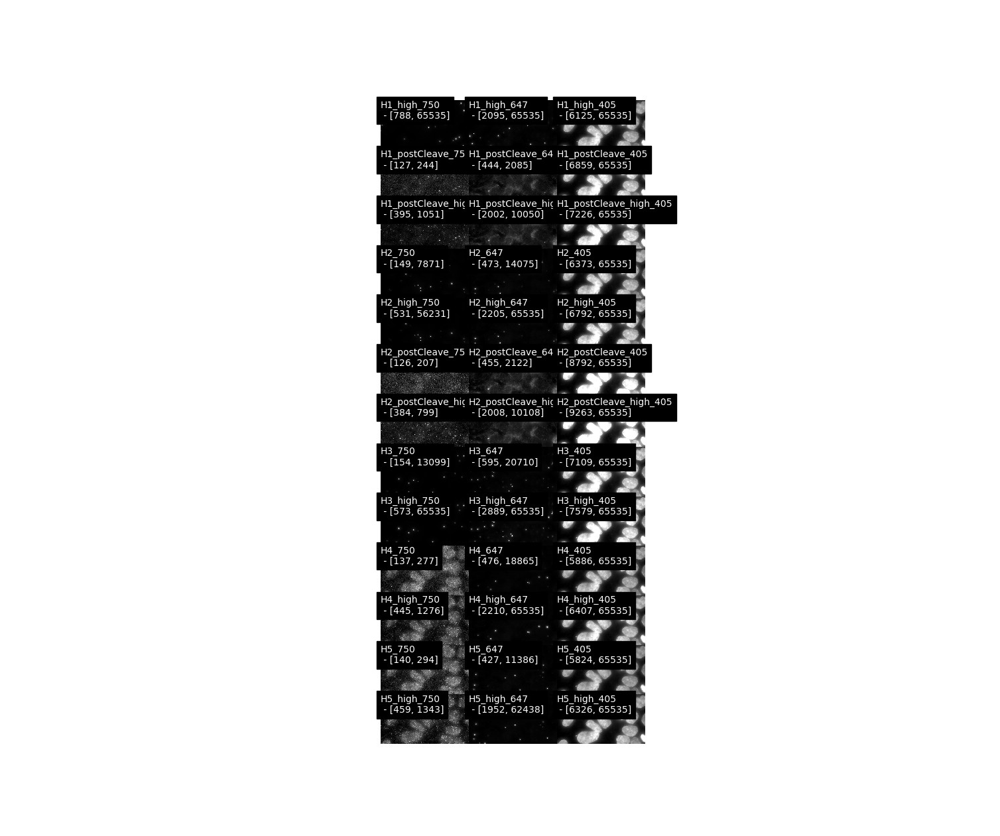

(-0.5, 2885.5, 7032.5, -0.5)

In [43]:
z_min,z_max,x_min,x_max,y_min,y_max =obj.get_limits()
ims_sm = [im_[z_min:z_max,x_min:x_max,y_min:y_max] for im_ in ims]

iimax = len(ims_sm)
col_row = 1.25
nrow = int(np.sqrt(iimax)/col_row)

nrow=3
ncol = int(np.ceil(iimax/float(nrow)))

nrow,ncol = ncol,nrow
ssz,ssx,ssy = ims_sm[0].shape
imf = np.zeros([ssx*nrow,ssy*ncol])
iim=0

def nm_to_R(nm_sm,cols = ['405','647','750']):
    return nm_sm

txts=[]
for irow in range(nrow):
    for icol in range(ncol):

        if iim<len(ims_sm):
            ims_sm_ = ims_sm[iim]
            nm_sm = ims_nms[iim]
            
            txt = nm_to_R(nm_sm)
            
            
            #if 'dapi' in txt: ims_sm_=[ims_sm_[int(len(ims_sm_)/2)]]
            
            im_plt,min_,max_ = mv.minmax(np.max(ims_sm_,0),percmax=99.95,pecmin=.5)
            imf[irow*ssx:(irow+1)*ssx,icol*ssy:(icol+1)*ssy]=im_plt
            txt+='\n - '+str([int(min_),int(max_)])
            txts.append([txt,irow*ssx,icol*ssy])
            iim+=1
            
import matplotlib.pylab as plt
fig = plt.figure(figsize=(12,7))
for txt,xtxt,ytxt in txts:
    plt.text(ytxt,xtxt,txt,color='white',backgroundcolor='k',horizontalalignment='left',verticalalignment='top',fontsize=10)
plt.imshow(imf,interpolation='nearest',cmap='gray')
plt.axis('off')